# Influence of outdoor weather data on indoors sensor data
- sensor data from Firebase db
- weather data from OpenWeather api

In [2]:
import pandas as pd 
import matplotlib.pyplot as plt
import pandas_profiling as pp
import seaborn as sns
from datetime import datetime as dt
sns.set() 
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
import catboost
from catboost import CatBoost, Pool, CatBoostRegressor, cv 
import pickle
import requests


ModuleNotFoundError: No module named 'pandas_profiling'

## Data Analysis

In [1]:
df = pd.read_csv('Data/sensor_data.csv')

NameError: name 'pd' is not defined

In [95]:
df 

,serialNumber,iaq,timestamp,eVOC,bearing,pressure,humidity,altitude,batteryPercent,eCO2,deviceId,luminance,iaqAccuracy,temperature,userId
0,fKuASomCxPUz,238.82520,1601676015176,5.668798,-159,94129,55.13599,617.1189,85,1856.2810,I1t2t86ZQoGIAv1i30r9,0,3,22.11985,ztx11HwFoJPuDJd1p7lLilvvkjg2
1,fKuASomCxPUz,25.00000,1601468131186,0.500000,171,96762,43.78288,387.0218,100,500.0000,I1t2t86ZQoGIAv1i30r9,699,0,26.01985,ztx11HwFoJPuDJd1p7lLilvvkjg2
2,fKuASomCxPUz,25.66664,1602404424738,0.507928,152,97294,54.54848,341.1472,48,504.1630,I1t2t86ZQoGIAv1i30r9,186,2,23.01985,ztx11HwFoJPuDJd1p7lLilvvkjg2
3,m3wjc22wyh88,54.74592,1599305715168,0.757911,103,97083,45.53238,359.3173,97,610.0677,fFrU8brLxN5Wea7PQwJg,1730,3,26.06485,ztx11HwFoJPuDJd1p7lLilvvkjg2
4,m3wjc22wyh88,105.09960,1600445101549,1.393267,112,97273,38.55331,342.9540,97,927.9365,fFrU8brLxN5Wea7PQwJg,2512,3,31.05985,ztx11HwFoJPuDJd1p7lLilvvkjg2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1267,fKuASomCxPUz,25.00000,1600576518373,0.500000,152,96709,62.99857,391.6028,78,500.0000,I1t2t86ZQoGIAv1i30r9,0,2,21.78985,ztx11HwFoJPuDJd1p7lLilvvkjg2
1268,m3wjc22wyh88,113.79820,1599976217116,1.222781,108,97784,61.69254,299.0734,97,841.5912,fFrU8brLxN5Wea7PQwJg,334,3,20.88485,ztx11HwFoJPuDJd1p7lLilvvkjg2
1269,wthsftyK5vgu,206.18010,1601796315720,2.218808,-54,95306,56.89602,513.6255,65,1235.7600,UefkqbOojs07AR21i0ix,332,1,19.13985,ztx11HwFoJPuDJd1p7lLilvvkjg2
1270,m3wjc22wyh88,93.30641,1598736915134,0.784979,100,95970,58.39550,455.6953,97,619.3532,fFrU8brLxN5Wea7PQwJg,0,1,24.54485,ztx11HwFoJPuDJd1p7lLilvvkjg2


<AxesSubplot:>

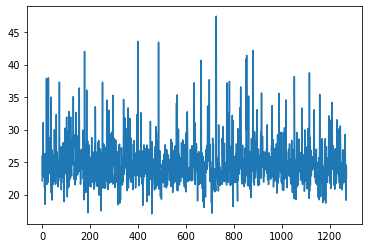

In [7]:
df.temperature.plot()

In [160]:
df['time'] = pd.to_datetime(df['timestamp'], unit='ms')

In [161]:
df.isna().sum()

serialNumber      55
iaq                0
timestamp          0
eVOC               0
bearing            0
pressure           0
humidity           0
altitude           0
batteryPercent     0
eCO2               0
deviceId           5
luminance          0
iaqAccuracy        0
temperature        0
userId             5
time               0
dtype: int64

In [31]:
pp.ProfileReport(df)

-----

### filling the missing values: we only care about the deviceID, not the userId nor the serial number. 

In [162]:
df[df['deviceId'].isna()].altitude.mean()

368.37145999999996

In [163]:
df.deviceId.unique()

array(['I1t2t86ZQoGIAv1i30r9', 'fFrU8brLxN5Wea7PQwJg',
       'UefkqbOojs07AR21i0ix', 'SAGvj9Ar25aG4i3Xxta1',
       'So15xXTTj0GAoVeomUCA', 'gbeSfksDVEIUEEz60y87', nan], dtype=object)

In [164]:
df.groupby('deviceId')['altitude'].mean()

deviceId
I1t2t86ZQoGIAv1i30r9    425.841930
SAGvj9Ar25aG4i3Xxta1    400.820003
So15xXTTj0GAoVeomUCA    365.792739
UefkqbOojs07AR21i0ix    429.038366
fFrU8brLxN5Wea7PQwJg    365.926171
gbeSfksDVEIUEEz60y87    344.366947
Name: altitude, dtype: float64

In [165]:
df.groupby(['deviceId', 'userId'])['altitude'].mean()

deviceId              userId                      
I1t2t86ZQoGIAv1i30r9  ztx11HwFoJPuDJd1p7lLilvvkjg2    425.841930
SAGvj9Ar25aG4i3Xxta1  ztx11HwFoJPuDJd1p7lLilvvkjg2    400.820003
So15xXTTj0GAoVeomUCA  ztx11HwFoJPuDJd1p7lLilvvkjg2    365.792739
UefkqbOojs07AR21i0ix  ztx11HwFoJPuDJd1p7lLilvvkjg2    429.038366
fFrU8brLxN5Wea7PQwJg  ztx11HwFoJPuDJd1p7lLilvvkjg2    365.926171
gbeSfksDVEIUEEz60y87  U6rvFKB7l8gOFQca1lMf8zP0i8X2    344.366947
Name: altitude, dtype: float64

there are only two user IDs, and we can see that the mean altitude from the Nan of the device Id is very close to two deviceIDs. But these two device Ids have the same userId. So I think tose devices are in the same house. Theresfore, we oly care about the deviceID for knowing the general location. SO we will replace the Nan with the deviceId: fFrU8brLxN5Wea7PQwJg 

In [166]:
df.deviceId.fillna('fFrU8brLxN5Wea7PQwJg', inplace=True)

------ 

In [167]:
df.sort_values(by ='timestamp')

,serialNumber,iaq,timestamp,eVOC,bearing,pressure,humidity,altitude,batteryPercent,eCO2,deviceId,luminance,iaqAccuracy,temperature,userId,time
1264,NaN,25.00000,1598266510410,0.500000,180,97025,38.03350,364.3173,0,500.0000,SAGvj9Ar25aG4i3Xxta1,996,0,23.85000,ztx11HwFoJPuDJd1p7lLilvvkjg2,2020-08-24 10:55:10.410
952,NaN,25.00000,1598270107009,0.500000,-26,97015,36.14250,365.1798,0,500.0000,SAGvj9Ar25aG4i3Xxta1,1337,0,24.28500,ztx11HwFoJPuDJd1p7lLilvvkjg2,2020-08-24 11:55:07.009
121,NaN,25.00000,1598271902186,0.500000,-135,96990,34.53550,367.3358,0,500.0000,SAGvj9Ar25aG4i3Xxta1,1206,0,24.91000,ztx11HwFoJPuDJd1p7lLilvvkjg2,2020-08-24 12:25:02.186
1127,NaN,25.00000,1598273408375,0.500000,-135,96974,34.73250,368.7163,0,500.0000,SAGvj9Ar25aG4i3Xxta1,1101,0,24.90500,ztx11HwFoJPuDJd1p7lLilvvkjg2,2020-08-24 12:50:08.375
31,NaN,25.00000,1598274308303,0.500000,-1515870811,96937,29.42500,371.9086,0,500.0000,SAGvj9Ar25aG4i3Xxta1,717,0,26.24000,ztx11HwFoJPuDJd1p7lLilvvkjg2,2020-08-24 13:05:08.303
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
497,m3wjc22wyh88,173.94340,1603434617714,4.505736,117,96834,61.68655,380.8005,98,1704.3760,fFrU8brLxN5Wea7PQwJg,111,3,22.15985,ztx11HwFoJPuDJd1p7lLilvvkjg2,2020-10-23 06:30:17.714
1090,fKuASomCxPUz,25.00000,1603641617268,0.500000,153,95990,38.97186,453.9557,49,500.0000,I1t2t86ZQoGIAv1i30r9,97,1,26.10985,ztx11HwFoJPuDJd1p7lLilvvkjg2,2020-10-25 16:00:17.268
953,fKuASomCxPUz,31.21753,1603650625081,0.520955,158,96041,41.09187,449.5208,69,510.8640,I1t2t86ZQoGIAv1i30r9,41,1,25.81985,ztx11HwFoJPuDJd1p7lLilvvkjg2,2020-10-25 18:30:25.081
760,fKuASomCxPUz,125.23490,1603661420659,1.361588,159,95819,45.79691,468.8408,97,912.7219,I1t2t86ZQoGIAv1i30r9,43,3,24.11485,ztx11HwFoJPuDJd1p7lLilvvkjg2,2020-10-25 21:30:20.659


#### getting the device location : no need, all the devices are in Zurich

------

----


In [75]:
df.sort_values(by = 'timestamp')

,serialNumber,iaq,timestamp,eVOC,bearing,pressure,humidity,altitude,batteryPercent,eCO2,deviceId,luminance,iaqAccuracy,temperature,userId,location
1264,NaN,25.00000,2020-08-24 10:55:10.410,0.500000,180,97025,38.03350,364.3173,0,500.0000,SAGvj9Ar25aG4i3Xxta1,996,0,23.85000,ztx11HwFoJPuDJd1p7lLilvvkjg2,Zurich
952,NaN,25.00000,2020-08-24 11:55:07.009,0.500000,-26,97015,36.14250,365.1798,0,500.0000,SAGvj9Ar25aG4i3Xxta1,1337,0,24.28500,ztx11HwFoJPuDJd1p7lLilvvkjg2,Zurich
121,NaN,25.00000,2020-08-24 12:25:02.186,0.500000,-135,96990,34.53550,367.3358,0,500.0000,SAGvj9Ar25aG4i3Xxta1,1206,0,24.91000,ztx11HwFoJPuDJd1p7lLilvvkjg2,Zurich
1127,NaN,25.00000,2020-08-24 12:50:08.375,0.500000,-135,96974,34.73250,368.7163,0,500.0000,SAGvj9Ar25aG4i3Xxta1,1101,0,24.90500,ztx11HwFoJPuDJd1p7lLilvvkjg2,Zurich
31,NaN,25.00000,2020-08-24 13:05:08.303,0.500000,-1515870811,96937,29.42500,371.9086,0,500.0000,SAGvj9Ar25aG4i3Xxta1,717,0,26.24000,ztx11HwFoJPuDJd1p7lLilvvkjg2,Zurich
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
497,m3wjc22wyh88,173.94340,2020-10-23 06:30:17.714,4.505736,117,96834,61.68655,380.8005,98,1704.3760,fFrU8brLxN5Wea7PQwJg,111,3,22.15985,ztx11HwFoJPuDJd1p7lLilvvkjg2,Zurich
1090,fKuASomCxPUz,25.00000,2020-10-25 16:00:17.268,0.500000,153,95990,38.97186,453.9557,49,500.0000,I1t2t86ZQoGIAv1i30r9,97,1,26.10985,ztx11HwFoJPuDJd1p7lLilvvkjg2,Zurich
953,fKuASomCxPUz,31.21753,2020-10-25 18:30:25.081,0.520955,158,96041,41.09187,449.5208,69,510.8640,I1t2t86ZQoGIAv1i30r9,41,1,25.81985,ztx11HwFoJPuDJd1p7lLilvvkjg2,Zurich
760,fKuASomCxPUz,125.23490,2020-10-25 21:30:20.659,1.361588,159,95819,45.79691,468.8408,97,912.7219,I1t2t86ZQoGIAv1i30r9,43,3,24.11485,ztx11HwFoJPuDJd1p7lLilvvkjg2,Zurich


deviceId
I1t2t86ZQoGIAv1i30r9    AxesSubplot(0.125,0.2;0.775x0.68)
SAGvj9Ar25aG4i3Xxta1    AxesSubplot(0.125,0.2;0.775x0.68)
So15xXTTj0GAoVeomUCA    AxesSubplot(0.125,0.2;0.775x0.68)
UefkqbOojs07AR21i0ix    AxesSubplot(0.125,0.2;0.775x0.68)
fFrU8brLxN5Wea7PQwJg    AxesSubplot(0.125,0.2;0.775x0.68)
gbeSfksDVEIUEEz60y87    AxesSubplot(0.125,0.2;0.775x0.68)
dtype: object

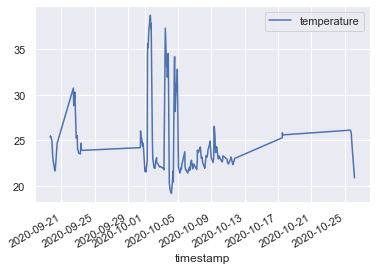

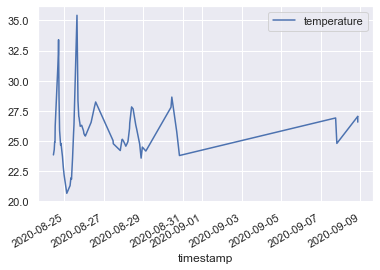

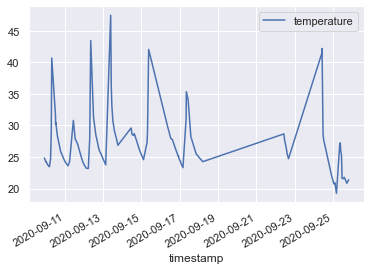

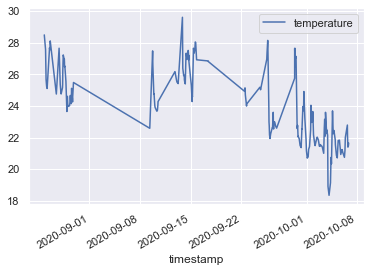

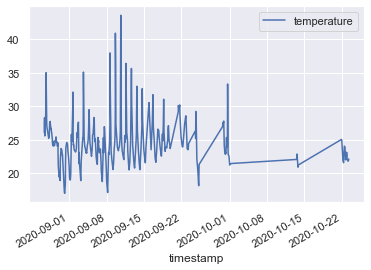

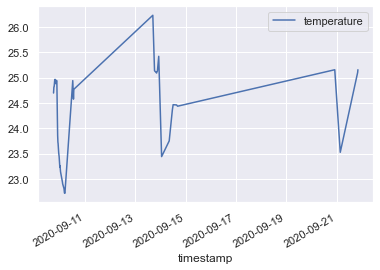

In [85]:
df.groupby('deviceId').plot.line(x='timestamp', y='temperature')

## Historical Weather Data

In [5]:
hist_data = pd.read_csv('Data/hist_zurich.csv')

In [499]:
hist_data

,dt,dt_iso,timezone,city_name,lat,lon,temp,feels_like,temp_min,temp_max,...,wind_deg,rain_1h,rain_3h,snow_1h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,1483228800,2017-01-01 00:00:00 +0000 UTC,3600,Zurich,47.376887,8.541694,-3.27,-6.08,-5.02,-1.89,...,250,NaN,NaN,NaN,NaN,21,801,Clouds,few clouds,02n
1,1483232400,2017-01-01 01:00:00 +0000 UTC,3600,Zurich,47.376887,8.541694,-3.37,-6.55,-5.40,-0.40,...,200,NaN,NaN,NaN,NaN,26,802,Clouds,scattered clouds,03n
2,1483236000,2017-01-01 02:00:00 +0000 UTC,3600,Zurich,47.376887,8.541694,-3.46,-6.98,-5.59,-0.40,...,180,NaN,NaN,NaN,NaN,16,801,Clouds,few clouds,02n
3,1483239600,2017-01-01 03:00:00 +0000 UTC,3600,Zurich,47.376887,8.541694,-3.69,-7.25,-5.90,-1.93,...,220,NaN,NaN,NaN,NaN,20,801,Clouds,few clouds,02n
4,1483243200,2017-01-01 04:00:00 +0000 UTC,3600,Zurich,47.376887,8.541694,-3.65,-6.84,-6.70,0.50,...,250,NaN,NaN,NaN,NaN,14,801,Clouds,few clouds,02n
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33701,1603738800,2020-10-26 19:00:00 +0000 UTC,3600,Zurich,47.376887,8.541694,4.56,0.79,1.63,6.11,...,130,NaN,NaN,NaN,NaN,40,802,Clouds,scattered clouds,03n
33702,1603742400,2020-10-26 20:00:00 +0000 UTC,3600,Zurich,47.376887,8.541694,4.62,0.51,2.09,6.00,...,150,NaN,NaN,NaN,NaN,40,802,Clouds,scattered clouds,03n
33703,1603746000,2020-10-26 21:00:00 +0000 UTC,3600,Zurich,47.376887,8.541694,4.76,1.72,2.09,6.11,...,160,NaN,NaN,NaN,NaN,100,804,Clouds,overcast clouds,04n
33704,1603749600,2020-10-26 22:00:00 +0000 UTC,3600,Zurich,47.376887,8.541694,4.74,2.67,2.09,6.11,...,0,NaN,NaN,NaN,NaN,90,804,Clouds,overcast clouds,04n


In [302]:
hist_data['time'] = pd.to_datetime(hist_data['dt'], unit='s')

In [500]:
hist_data.columns

Index(['dt', 'dt_iso', 'timezone', 'city_name', 'lat', 'lon', 'temp',
       'feels_like', 'temp_min', 'temp_max', 'pressure', 'sea_level',
       'grnd_level', 'humidity', 'wind_speed', 'wind_deg', 'rain_1h',
       'rain_3h', 'snow_1h', 'snow_3h', 'clouds_all', 'weather_id',
       'weather_main', 'weather_description', 'weather_icon'],
      dtype='object')

## Matching the time stamps between historical weather data and sensor data

In [207]:
hist_data.time 

0       2017-01-01 00:00:00
1       2017-01-01 01:00:00
2       2017-01-01 02:00:00
3       2017-01-01 03:00:00
4       2017-01-01 04:00:00
                ...        
33701   2020-10-26 19:00:00
33702   2020-10-26 20:00:00
33703   2020-10-26 21:00:00
33704   2020-10-26 22:00:00
33705   2020-10-26 23:00:00
Name: time, Length: 33706, dtype: datetime64[ns]

In [219]:
df['time'] = pd.to_datetime(df['time'])

In [220]:
df['time'] = df['time'].apply(lambda t: t.replace(second=0))

In [221]:
df['time'] = df['time'].apply(lambda t: t.strftime('%Y-%m-%d %H:%M:%S'))

In [222]:
df.time 

0       2020-10-02 22:00:00
1       2020-09-30 12:15:00
2       2020-10-11 08:20:00
3       2020-09-05 11:35:00
4       2020-09-18 16:05:00
               ...         
1267    2020-09-20 04:35:00
1268    2020-09-13 05:50:00
1269    2020-10-04 07:25:00
1270    2020-08-29 21:35:00
1271    2020-10-07 07:35:00
Name: time, Length: 1272, dtype: object

### option 1: in my sensor data, replace the minutes by 00 so that they match the exct time from the sweather dabsata

In [223]:
df_minutes = df.copy()

In [224]:
df_minutes['time'] = pd.to_datetime(df_minutes['time'])

In [225]:
df_minutes['time'] = df_minutes['time'].apply(lambda t: t.replace(minute=0))

In [226]:
df_minutes = df_minutes.merge(hist_data, left_on='time', right_on='time')

In [186]:
df_minutes.columns 

Index(['serialNumber', 'iaq', 'timestamp', 'eVOC', 'bearing', 'pressure_x',
       'humidity_x', 'altitude', 'batteryPercent', 'eCO2', 'deviceId',
       'luminance', 'iaqAccuracy', 'temperature', 'userId', 'time', 'dt',
       'dt_iso', 'timezone', 'city_name', 'lat', 'lon', 'temp', 'feels_like',
       'temp_min', 'temp_max', 'pressure_y', 'sea_level', 'grnd_level',
       'humidity_y', 'wind_speed', 'wind_deg', 'rain_1h', 'rain_3h', 'snow_1h',
       'snow_3h', 'clouds_all', 'weather_id', 'weather_main',
       'weather_description', 'weather_icon'],
      dtype='object')

In [228]:
df_minutes.isna().sum()

serialNumber             55
iaq                       0
timestamp                 0
eVOC                      0
bearing                   0
pressure_x                0
humidity_x                0
altitude                  0
batteryPercent            0
eCO2                      0
deviceId                  0
luminance                 0
iaqAccuracy               0
temperature               0
userId                    5
time                      0
dt                        0
dt_iso                    0
timezone                  0
city_name                 0
lat                       0
lon                       0
temp                      0
feels_like                0
temp_min                  0
temp_max                  0
pressure_y                0
sea_level              1282
grnd_level             1282
humidity_y                0
wind_speed                0
wind_deg                  0
rain_1h                1047
rain_3h                1282
snow_1h                1282
snow_3h             

#### Preparing the df for the machine learning

In [177]:
hist_data.columns 

Index(['dt', 'dt_iso', 'timezone', 'city_name', 'lat', 'lon', 'temp',
       'feels_like', 'temp_min', 'temp_max', 'pressure', 'sea_level',
       'grnd_level', 'humidity', 'wind_speed', 'wind_deg', 'rain_1h',
       'rain_3h', 'snow_1h', 'snow_3h', 'clouds_all', 'weather_id',
       'weather_main', 'weather_description', 'weather_icon', 'time'],
      dtype='object')

In [728]:
df_minutes[['time','temp', 'feels_like', 'pressure_y', 'humidity_y', 'wind_speed', 'wind_deg', 'clouds_all', 'temperature']]

,time,temp,feels_like,pressure_y,humidity_y,wind_speed,wind_deg,clouds_all,temperature
0,2020-10-02 22:00:00,12.24,10.15,977,87,3.1,320,75,22.11985
1,2020-09-30 12:00:00,14.87,14.40,1015,76,1.0,0,40,26.01985
2,2020-09-30 12:00:00,14.87,14.40,1015,76,1.0,0,40,23.96985
3,2020-09-30 12:00:00,14.87,14.40,1015,76,1.0,0,40,23.91985
4,2020-09-30 12:00:00,14.87,14.40,1015,76,1.0,0,40,25.65985
...,...,...,...,...,...,...,...,...,...
1277,2020-09-01 12:00:00,17.11,16.55,1015,59,0.5,0,40,25.52985
1278,2020-09-09 09:00:00,17.81,18.60,1024,87,1.5,0,13,23.33985
1279,2020-08-24 10:00:00,19.30,17.44,1010,49,2.1,290,40,23.85000
1280,2020-09-13 14:00:00,26.24,24.64,1025,47,4.1,40,0,29.24485


In [178]:
df_minutes.columns 

Index(['serialNumber', 'iaq', 'timestamp', 'eVOC', 'bearing', 'pressure_x',
       'humidity_x', 'altitude', 'batteryPercent', 'eCO2', 'deviceId',
       'luminance', 'iaqAccuracy', 'temperature', 'userId', 'time', 'dt',
       'dt_iso', 'timezone', 'city_name', 'lat', 'lon', 'temp', 'feels_like',
       'temp_min', 'temp_max', 'pressure_y', 'sea_level', 'grnd_level',
       'humidity_y', 'wind_speed', 'wind_deg', 'rain_1h', 'rain_3h', 'snow_1h',
       'snow_3h', 'clouds_all', 'weather_id', 'weather_main',
       'weather_description', 'weather_icon'],
      dtype='object')

In [229]:
# keep the columns that I want to have as features 
X = df_minutes[['temp', 'feels_like', 'pressure_y', 'humidity_y', 'wind_speed', 'wind_deg', 'clouds_all']]

In [230]:
X

,temp,feels_like,pressure_y,humidity_y,wind_speed,wind_deg,clouds_all
0,12.24,10.15,977,87,3.1,320,75
1,14.87,14.40,1015,76,1.0,0,40
2,14.87,14.40,1015,76,1.0,0,40
3,14.87,14.40,1015,76,1.0,0,40
4,14.87,14.40,1015,76,1.0,0,40
...,...,...,...,...,...,...,...
1277,17.11,16.55,1015,59,0.5,0,40
1278,17.81,18.60,1024,87,1.5,0,13
1279,19.30,17.44,1010,49,2.1,290,40
1280,26.24,24.64,1025,47,4.1,40,0


In [231]:
X.isna().sum()

temp          0
feels_like    0
pressure_y    0
humidity_y    0
wind_speed    0
wind_deg      0
clouds_all    0
dtype: int64

In [232]:
Y_temp = df_minutes['temperature']

In [233]:
Y_hum = df_minutes['humidity_x']

In [234]:
Y_light = df_minutes['luminance']

In [235]:
Y_air = df_minutes['iaqAccuracy']

In [236]:
Y_co2 = df_minutes['eCO2']

### option 2: if the sensor data is not measured at the exact hour, then create function to modify the input from the weather data so it matches the time in the sensor data

- in the sensor data, collect only pertinent info for clarity: 'temperature', 'humidity_x', 'luminance', 'iaqAccuracy', 'eCO2', 'time'
- make sure the timestamp of both df are indexes
- concat on indexes
- input new data by linear interpolation 

In [325]:
df_av = df.copy()

In [326]:
df_av['time'] = pd.to_datetime(df_av['time'])

In [327]:
#in the sensor data, collect only pertinent info for clarity
df_av = df_av[['temperature', 'humidity', 'luminance', 'iaqAccuracy', 'eCO2', 'time']]

In [363]:
df_av.time

0      2020-10-02 22:00:00
1      2020-09-30 12:15:00
2      2020-10-11 08:20:00
3      2020-09-05 11:35:00
4      2020-09-18 16:05:00
               ...        
1267   2020-09-20 04:35:00
1268   2020-09-13 05:50:00
1269   2020-10-04 07:25:00
1270   2020-08-29 21:35:00
1271   2020-10-07 07:35:00
Name: time, Length: 1272, dtype: datetime64[ns]

In [364]:
hist_data

,temp_hist,feels_like,pressure,humidity_hist,wind_speed,wind_deg,clouds_all,time
0,-3.27,-6.08,1031,97,0.5,250,21,2017-01-01 00:00:00
1,-3.37,-6.55,1031,97,1.0,200,26,2017-01-01 01:00:00
2,-3.46,-6.98,1030,98,1.5,180,16,2017-01-01 02:00:00
3,-3.69,-7.25,1029,97,1.5,220,20,2017-01-01 03:00:00
4,-3.65,-6.84,1029,98,1.0,250,14,2017-01-01 04:00:00
...,...,...,...,...,...,...,...,...
33701,4.56,0.79,1010,86,3.1,130,40,2020-10-26 19:00:00
33702,4.62,0.51,1010,86,3.6,150,40,2020-10-26 20:00:00
33703,4.76,1.72,1010,86,2.1,160,100,2020-10-26 21:00:00
33704,4.74,2.67,1010,93,1.0,0,90,2020-10-26 22:00:00


In [328]:
#in the historical data , collect only the pertinent info 
hist_data = hist_data[['temp', 'feels_like', 'pressure', 'humidity', 'wind_speed', 'wind_deg', 'clouds_all', 'time']]

KeyError: "['humidity', 'temp'] not in index"

In [310]:
#rename the hist_data column temperature and humidity fto avoid confusion:
hist_data = hist_data.rename(columns={"temp": "temp_hist", "humidity": "humidity_hist"})

In [336]:
# concat both df on indexes
data = df_av.set_index('time').join(hist_data.set_index('time'), how='outer')

In [337]:
#select only the relevant time in the data data :  from 26.08.2020 to 26.10.2020
data = data.loc['2020-08-24':'2020-10-26']

In [338]:
data

,temperature,humidity,luminance,iaqAccuracy,eCO2,temp_hist,feels_like,pressure,humidity_hist,wind_speed,wind_deg,clouds_all
time,,,,,,,,,,,,
2020-08-24 00:00:00,NaN,NaN,NaN,NaN,NaN,15.30,13.95,1019.0,72.0,2.10,120.0,90.0
2020-08-24 01:00:00,NaN,NaN,NaN,NaN,NaN,15.24,14.96,1012.0,72.0,0.55,334.0,75.0
2020-08-24 02:00:00,NaN,NaN,NaN,NaN,NaN,14.65,14.18,1011.0,77.0,1.00,90.0,75.0
2020-08-24 03:00:00,NaN,NaN,NaN,NaN,NaN,14.08,14.02,1009.0,82.0,0.57,11.0,75.0
2020-08-24 04:00:00,NaN,NaN,NaN,NaN,NaN,13.54,13.33,1018.0,82.0,0.57,11.0,20.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-26 19:00:00,NaN,NaN,NaN,NaN,NaN,4.56,0.79,1010.0,86.0,3.10,130.0,40.0
2020-10-26 20:00:00,NaN,NaN,NaN,NaN,NaN,4.62,0.51,1010.0,86.0,3.60,150.0,40.0
2020-10-26 21:00:00,NaN,NaN,NaN,NaN,NaN,4.76,1.72,1010.0,86.0,2.10,160.0,100.0


In [339]:
data.index.is_unique

False

In [340]:
data = data.sort_index()

In [365]:
data.loc['2020-08-24':'2020-08-25']

,temperature,humidity,luminance,iaqAccuracy,eCO2,temp_hist,feels_like,pressure,humidity_hist,wind_speed,wind_deg,clouds_all
time,,,,,,,,,,,,
2020-08-24 00:00:00,NaN,NaN,NaN,NaN,NaN,15.30,13.95,1019.0,72.0,2.10,120.0,90.0
2020-08-24 01:00:00,NaN,NaN,NaN,NaN,NaN,15.24,14.96,1012.0,72.0,0.55,334.0,75.0
2020-08-24 02:00:00,NaN,NaN,NaN,NaN,NaN,14.65,14.18,1011.0,77.0,1.00,90.0,75.0
2020-08-24 03:00:00,NaN,NaN,NaN,NaN,NaN,14.08,14.02,1009.0,82.0,0.57,11.0,75.0
2020-08-24 04:00:00,NaN,NaN,NaN,NaN,NaN,13.54,13.33,1018.0,82.0,0.57,11.0,20.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2020-08-25 22:46:00,27.56500,51.30650,200.0,0.0,500.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-08-25 23:00:00,NaN,NaN,NaN,NaN,NaN,18.20,17.05,1002.0,68.0,2.61,233.0,75.0
2020-08-25 23:15:00,26.91061,36.49125,201.0,0.0,500.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [366]:
data.loc['2020-10-02 22:00:00']

temperature        22.11985
humidity           55.13599
luminance           0.00000
iaqAccuracy         3.00000
eCO2             1856.28100
temp_hist          12.24000
feels_like         10.15000
pressure          977.00000
humidity_hist      87.00000
wind_speed          3.10000
wind_deg          320.00000
clouds_all         75.00000
Name: 2020-10-02 22:00:00, dtype: float64

In [371]:
filled = data.interpolate(method='time')

In [372]:
filled.isna().sum()

temperature      11
humidity         11
luminance        11
iaqAccuracy      11
eCO2             11
temp_hist         0
feels_like        0
pressure          0
humidity_hist     0
wind_speed        0
wind_deg          0
clouds_all        0
dtype: int64

In [373]:
#drop the first rows that are nan
filled = filled.dropna()

In [376]:
filled

,temperature,humidity,luminance,iaqAccuracy,eCO2,temp_hist,feels_like,pressure,humidity_hist,wind_speed,wind_deg,clouds_all
time,,,,,,,,,,,,
2020-08-24 10:55:00,23.850000,38.033500,996.000000,0.0,500.000,20.390833,18.246667,1017.333333,46.25,2.558333,24.166667,21.666667
2020-08-24 11:00:00,23.886250,37.875917,1024.416667,0.0,500.000,20.490000,18.320000,1018.000000,46.00,2.600000,0.000000,20.000000
2020-08-24 11:55:00,24.285000,36.142500,1337.000000,0.0,500.000,20.893333,17.302500,1018.000000,43.25,4.433333,293.333333,38.333333
2020-08-24 12:00:00,24.389167,35.874667,1315.166667,0.0,500.000,20.930000,17.210000,1018.000000,43.00,4.600000,320.000000,40.000000
2020-08-24 12:25:00,24.910000,34.535500,1206.000000,0.0,500.000,21.021667,17.322500,1017.583333,43.00,4.600000,303.333333,40.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-26 19:00:00,20.869850,57.179010,1.000000,3.0,2421.254,4.560000,0.790000,1010.000000,86.00,3.100000,130.000000,40.000000
2020-10-26 20:00:00,20.869850,57.179010,1.000000,3.0,2421.254,4.620000,0.510000,1010.000000,86.00,3.600000,150.000000,40.000000
2020-10-26 21:00:00,20.869850,57.179010,1.000000,3.0,2421.254,4.760000,1.720000,1010.000000,86.00,2.100000,160.000000,100.000000


#### Preparing the df for the machine learning

In [378]:
X2 = filled[['temp_hist', 'feels_like', 'pressure', 'humidity_hist', 'wind_speed', 'wind_deg', 'clouds_all']]

In [380]:
Y2_temp = filled['temperature']
Y2_hum = filled['humidity']
Y2_light = filled['luminance']
Y2_air = filled['iaqAccuracy']
Y2_co2 = filled['eCO2']

 ## MACHINE Learning - finally!!!! 

- try logistic regression on Y_* and X , then on Y2_* and X2
- compare the difference
- try other models like random forests

### train test split

In [394]:
Xtrain, Xtest, ytrain_temp, ytest_temp = train_test_split(X, Y_temp, random_state=44, test_size=0.2)
Xtrain, Xtest, ytrain_hum, ytest_hum = train_test_split(X, Y_hum, random_state=44, test_size=0.2)
Xtrain, Xtest, ytrain_light, ytest_light = train_test_split(X, Y_light, random_state=44, test_size=0.2)
Xtrain, Xtest, ytrain_air, ytest_air = train_test_split(X, Y_air, random_state=44, test_size=0.2)
Xtrain, Xtest, ytrain_co2, ytest_co2 = train_test_split(X, Y_co2, random_state=44, test_size=0.2)

In [604]:
Xtrain2, Xtest2, ytrain2_temp, ytest2_temp = train_test_split(X2, Y2_temp, random_state=44, test_size=0.2)
Xtrain2, Xtest2, ytrain2_hum, ytest2_hum = train_test_split(X2, Y2_hum, random_state=44, test_size=0.2)
Xtrain2, Xtest2, ytrain2_light, ytest2_light = train_test_split(X2, Y2_light, random_state=44, test_size=0.2)
Xtrain2, Xtest2, ytrain2_air, ytest2_air = train_test_split(X2, Y2_air, random_state=44, test_size=0.2)
Xtrain2, Xtest2, ytrain2_co2, ytest2_co2 = train_test_split(X2, Y2_co2, random_state=44, test_size=0.2)

### Linear regression 

In [524]:
data_list = [Xtrain, Xtest, ytrain_temp, ytest_temp, Xtrain, Xtest, ytrain_hum, ytest_hum, Xtrain, Xtest, ytrain_light, ytest_light, Xtrain, Xtest, ytrain_air, ytest_air, Xtrain, Xtest, ytrain_co2, ytest_co2, Xtrain2, Xtest2, ytrain2_temp, ytes2t_temp, Xtrain2, Xtest2, ytrain2_hum, ytest2_hum, Xtrain2, Xtest2, ytrain2_light, ytest2_light, Xtrain2, Xtest2, ytrain2_air, ytest2_air, Xtrain2, Xtest2, ytrain2_co2, ytest2_co2]
name_list = ['option1, temp', 'option1, humidity', 'option1, light', 'option1, air', 'option1, co2', 'option2, temp', 'option2, humidity', 'option2, light', 'option2, air', 'option2, co2']

In [525]:
i = 0 
a = 0 
while i <= len(data_list)-3 :
    lr = LinearRegression().fit(data_list[i], data_list[i+2])
    print(f'Results for the {name_list[a]}:')
    print("Coefficients:", lr.coef_)
    print("Intercept   :", lr.intercept_)

    print("train score :", lr.score(data_list[i], data_list[i+2]))
    print("test score  :", lr.score(data_list[i+1], data_list[i+3]))
    print('cross-validation score:', cross_val_score(lr, data_list[i], data_list[i+2], cv=5), "\n")
    
    i = i + 4
    a = a + 1


Results for the option1, temp:
Coefficients: [-4.60693592e-01  6.22928418e-01 -2.92248825e-02 -6.75060489e-02
  3.01624549e-01 -1.84095784e-04 -9.84384322e-04]
Intercept   : 57.01379471093088
train score : 0.2952747188068249
test score  : 0.27952148881767636
cross-validation score: [0.41726063 0.20960595 0.24497998 0.24574395 0.26326449] 

Results for the option1, humidity:
Coefficients: [-2.66559280e+00  2.24912292e+00  3.74738585e-02  1.94388078e-01
  1.72513164e+00  2.98174782e-04  1.37383882e-02]
Intercept   : 0.5739883451806946
train score : 0.3149840689265747
test score  : 0.25345665485435787
cross-validation score: [0.37043025 0.33323703 0.17540745 0.28443792 0.31371023] 

Results for the option1, light:
Coefficients: [-9.80552679e+02  8.50874176e+02  8.35077448e+00 -6.12225615e+01
  5.31193846e+02  7.77816292e-01 -1.76263259e+00]
Intercept   : -1172.8907388124494
train score : 0.04459450732965409
test score  : -0.013288089028864913
cross-validation score: [ 0.0811778  -0.351253

In [ ]:
# this does not look good ...

### Random Forrest

In [527]:
i = 0 
a = 0 
while i <= len(data_list)-3 :
    m = RandomForestRegressor().fit(data_list[i], data_list[i+2])
    print(f'Results for the {name_list[a]}:')

    print("train score :", m.score(data_list[i], data_list[i+2]))
    print("test score  :", m.score(data_list[i+1], data_list[i+3]))
    print('cross-validation score:', cross_val_score(m, data_list[i], data_list[i+2], cv=5))
          
    print('feature importance:', m.feature_importances_, "\n")
    
    pickle.dump(m, open(f'{name_list[a]}_rf', 'wb'))

    i = i + 4
    a = a + 1


Results for the option1, temp:
train score : 0.8514526554743336
test score  : 0.42444572469857156
cross-validation score: [ 0.51132861 -0.11754543  0.29866193  0.29184206  0.37610148]
feature importance: [0.45029541 0.12751339 0.12960002 0.08597771 0.08930735 0.07378513
 0.043521  ] 

Results for the option1, humidity:
train score : 0.8652991165107513
test score  : 0.5222120793519358
cross-validation score: [0.57652419 0.38606014 0.44664306 0.39169826 0.46995447]
feature importance: [0.10597778 0.11714005 0.1366354  0.41389904 0.08361291 0.09128811
 0.05144672] 

Results for the option1, light:
train score : 0.8419000672360671
test score  : 0.02689622885546128
cross-validation score: [  0.20960259 -16.31665796  -0.31362933   0.46838622   0.42430077]
feature importance: [0.43608963 0.11059227 0.16158994 0.10391112 0.0766456  0.07854043
 0.03263103] 

Results for the option1, air:
train score : 0.7715743471544226
test score  : 0.391575421429158
cross-validation score: [0.42037903 0.27006

### Catboost

In [438]:
# only do catboost on the X2 data because it's very slow and we have seen that this augmented data set is performing better
data_list2 = [Xtrain2, Xtest2, ytrain2_temp, ytes2t_temp, Xtrain2, Xtest2, ytrain2_hum, ytest2_hum, Xtrain2, Xtest2, ytrain2_light, ytest2_light, Xtrain2, Xtest2, ytrain2_air, ytest2_air, Xtrain2, Xtest2, ytrain2_co2, ytest2_co2]
name_list2 = ['option2, temp', 'option2, humidity', 'option2, light', 'option2, air', 'option2, co2']

#### First try

In [439]:
params = {'iterations':3000,
        'learning_rate':0.15,
        'depth':3,
        #'loss_function':'RMSE',
        #'eval_metric':'RMSE',
        #'random_seed':42,
        #'metric_period':50, # calculate metrics once per 50 iterations
        #'od_type':"Iter", # overfit detector
        #'od_wait':20, # most recent best iteration to wait before stopping
        #'verbose':True,
        #'use_best_model':True
}

In [442]:
%time 
i = 0 
a = 0 
while i <= len(data_list2)-3 :
    m = CatBoostRegressor(**params)
    
    
    grid = {
    'learning_rate': [0.01, 0.5],
    'depth':[4, 5],
    'iterations': [8000, 10000]
    }

    train_pool_cas = catboost.Pool(data_list2[i], data_list2[i+2])

    grid_search_results_cas = m.grid_search(grid, train_pool_cas, shuffle=False, verbose=3, plot=True)
    


    scores = cv(train_pool_cas,
            params,
            fold_count=5)
    
    
    model.fit(
    data_list2[i], data_list2[i+2],
    eval_set=(data_list2[i+1], data_list2[i+3]),
    use_best_model=True,
    plot=True
    )
    
    print(f'Results for the {name_list2[a]}:')
    print('Tree count: ' + str(model.tree_count_))
    print(model.get_feature_importance(prettified=True))
    print('train core:', model.score(data_list2[i], data_list2[i+2]), "\n") #gives the r2
    

    i = i + 4
    a = a + 1


CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 4.77 µs


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 2.493843267
bestIteration = 7978

0:	loss: 2.4938433	best: 2.4938433 (0)	total: 9.06s	remaining: 1m 3s

bestTest = 2.434445225
bestIteration = 785


bestTest = 2.480933371
bestIteration = 9999


bestTest = 2.434445225
bestIteration = 785

3:	loss: 2.4344452	best: 2.4344452 (1)	total: 32.7s	remaining: 32.7s

bestTest = 2.384772091
bestIteration = 7968


bestTest = 2.5062661
bestIteration = 2238


bestTest = 2.372829966
bestIteration = 9929

6:	loss: 2.3728300	best: 2.3728300 (6)	total: 1m 5s	remaining: 9.3s

bestTest = 2.5062661
bestIteration = 2238

7:	loss: 2.5062661	best: 2.3728300 (6)	total: 1m 14s	remaining: 0us
Estimating final quality...


0:	learn: 3.1133153	test: 3.0306065	best: 3.0306065 (0)	total: 2.26ms	remaining: 6.79s


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

1:	learn: 3.0296469	test: 2.9621401	best: 2.9621401 (1)	total: 7.42ms	remaining: 11.1s
2:	learn: 2.9527208	test: 2.9020301	best: 2.9020301 (2)	total: 8.62ms	remaining: 8.61s
3:	learn: 2.8916186	test: 2.8509549	best: 2.8509549 (3)	total: 9.86ms	remaining: 7.39s
4:	learn: 2.8429049	test: 2.8117645	best: 2.8117645 (4)	total: 11ms	remaining: 6.6s
5:	learn: 2.8051772	test: 2.7825283	best: 2.7825283 (5)	total: 12.1ms	remaining: 6.03s
6:	learn: 2.7758654	test: 2.7605096	best: 2.7605096 (6)	total: 13.3ms	remaining: 5.7s
7:	learn: 2.7534895	test: 2.7463290	best: 2.7463290 (7)	total: 14.5ms	remaining: 5.41s
8:	learn: 2.7359774	test: 2.7359413	best: 2.7359413 (8)	total: 15.4ms	remaining: 5.12s
9:	learn: 2.7200454	test: 2.7274707	best: 2.7274707 (9)	total: 16.7ms	remaining: 4.99s
10:	learn: 2.7032137	test: 2.7222420	best: 2.7222420 (10)	total: 18.4ms	remaining: 4.99s
11:	learn: 2.6857407	test: 2.7074148	best: 2.7074148 (11)	total: 20.8ms	remaining: 5.18s
12:	learn: 2.6742789	test: 2.7019276	best: 

196:	learn: 2.0380496	test: 2.5162623	best: 2.5138499 (195)	total: 175ms	remaining: 2.49s
197:	learn: 2.0350150	test: 2.5160021	best: 2.5138499 (195)	total: 177ms	remaining: 2.5s
198:	learn: 2.0316177	test: 2.5094262	best: 2.5094262 (198)	total: 178ms	remaining: 2.5s
199:	learn: 2.0307880	test: 2.5086988	best: 2.5086988 (199)	total: 179ms	remaining: 2.5s
200:	learn: 2.0294991	test: 2.5085798	best: 2.5085798 (200)	total: 180ms	remaining: 2.51s
201:	learn: 2.0283483	test: 2.5067201	best: 2.5067201 (201)	total: 181ms	remaining: 2.51s
202:	learn: 2.0269692	test: 2.5079164	best: 2.5067201 (201)	total: 182ms	remaining: 2.51s
203:	learn: 2.0249507	test: 2.5048350	best: 2.5048350 (203)	total: 183ms	remaining: 2.5s
204:	learn: 2.0240367	test: 2.5044081	best: 2.5044081 (204)	total: 183ms	remaining: 2.5s
205:	learn: 2.0220267	test: 2.5056530	best: 2.5044081 (204)	total: 184ms	remaining: 2.49s
206:	learn: 2.0211614	test: 2.5040333	best: 2.5040333 (206)	total: 184ms	remaining: 2.49s
207:	learn: 2.0

442:	learn: 1.7328724	test: 2.4582689	best: 2.4546893 (432)	total: 343ms	remaining: 1.98s
443:	learn: 1.7320640	test: 2.4584255	best: 2.4546893 (432)	total: 344ms	remaining: 1.98s
444:	learn: 1.7308374	test: 2.4570314	best: 2.4546893 (432)	total: 345ms	remaining: 1.98s
445:	learn: 1.7303924	test: 2.4569747	best: 2.4546893 (432)	total: 346ms	remaining: 1.98s
446:	learn: 1.7293483	test: 2.4582140	best: 2.4546893 (432)	total: 347ms	remaining: 1.98s
447:	learn: 1.7291044	test: 2.4584074	best: 2.4546893 (432)	total: 348ms	remaining: 1.98s
448:	learn: 1.7286419	test: 2.4583169	best: 2.4546893 (432)	total: 348ms	remaining: 1.98s
449:	learn: 1.7274219	test: 2.4580242	best: 2.4546893 (432)	total: 349ms	remaining: 1.98s
450:	learn: 1.7270128	test: 2.4583450	best: 2.4546893 (432)	total: 350ms	remaining: 1.98s
451:	learn: 1.7267290	test: 2.4583474	best: 2.4546893 (432)	total: 350ms	remaining: 1.97s
452:	learn: 1.7252171	test: 2.4559080	best: 2.4546893 (432)	total: 351ms	remaining: 1.97s
453:	learn

688:	learn: 1.5438297	test: 2.4198926	best: 2.4193597 (685)	total: 509ms	remaining: 1.71s
689:	learn: 1.5435181	test: 2.4198517	best: 2.4193597 (685)	total: 510ms	remaining: 1.71s
690:	learn: 1.5433643	test: 2.4199556	best: 2.4193597 (685)	total: 511ms	remaining: 1.71s
691:	learn: 1.5433019	test: 2.4199654	best: 2.4193597 (685)	total: 512ms	remaining: 1.71s
692:	learn: 1.5415698	test: 2.4188509	best: 2.4188509 (692)	total: 513ms	remaining: 1.71s
693:	learn: 1.5405132	test: 2.4169739	best: 2.4169739 (693)	total: 514ms	remaining: 1.71s
694:	learn: 1.5395512	test: 2.4154688	best: 2.4154688 (694)	total: 515ms	remaining: 1.71s
695:	learn: 1.5391854	test: 2.4157080	best: 2.4154688 (694)	total: 515ms	remaining: 1.71s
696:	learn: 1.5390417	test: 2.4156328	best: 2.4154688 (694)	total: 516ms	remaining: 1.71s
697:	learn: 1.5376472	test: 2.4153429	best: 2.4153429 (697)	total: 517ms	remaining: 1.7s
698:	learn: 1.5369389	test: 2.4153335	best: 2.4153335 (698)	total: 517ms	remaining: 1.7s
699:	learn: 

931:	learn: 1.4012371	test: 2.4012259	best: 2.3989624 (741)	total: 676ms	remaining: 1.5s
932:	learn: 1.4005502	test: 2.4012350	best: 2.3989624 (741)	total: 677ms	remaining: 1.5s
933:	learn: 1.3999505	test: 2.4019016	best: 2.3989624 (741)	total: 678ms	remaining: 1.5s
934:	learn: 1.3995375	test: 2.4021299	best: 2.3989624 (741)	total: 679ms	remaining: 1.5s
935:	learn: 1.3991779	test: 2.4024003	best: 2.3989624 (741)	total: 679ms	remaining: 1.5s
936:	learn: 1.3988145	test: 2.4028141	best: 2.3989624 (741)	total: 681ms	remaining: 1.5s
937:	learn: 1.3984368	test: 2.4035024	best: 2.3989624 (741)	total: 681ms	remaining: 1.5s
938:	learn: 1.3977180	test: 2.4041354	best: 2.3989624 (741)	total: 682ms	remaining: 1.5s
939:	learn: 1.3973670	test: 2.4039264	best: 2.3989624 (741)	total: 683ms	remaining: 1.5s
940:	learn: 1.3968626	test: 2.4040613	best: 2.3989624 (741)	total: 683ms	remaining: 1.5s
941:	learn: 1.3965704	test: 2.4037741	best: 2.3989624 (741)	total: 684ms	remaining: 1.49s
942:	learn: 1.396080

1120:	learn: 1.3150319	test: 2.3976900	best: 2.3971605 (1080)	total: 876ms	remaining: 1.47s
1121:	learn: 1.3147337	test: 2.3991971	best: 2.3971605 (1080)	total: 877ms	remaining: 1.47s
1122:	learn: 1.3141537	test: 2.3987085	best: 2.3971605 (1080)	total: 879ms	remaining: 1.47s
1123:	learn: 1.3139083	test: 2.3988649	best: 2.3971605 (1080)	total: 880ms	remaining: 1.47s
1124:	learn: 1.3138650	test: 2.3992033	best: 2.3971605 (1080)	total: 881ms	remaining: 1.47s
1125:	learn: 1.3134193	test: 2.3990324	best: 2.3971605 (1080)	total: 882ms	remaining: 1.47s
1126:	learn: 1.3127950	test: 2.3984076	best: 2.3971605 (1080)	total: 883ms	remaining: 1.47s
1127:	learn: 1.3123894	test: 2.3968345	best: 2.3968345 (1127)	total: 885ms	remaining: 1.47s
1128:	learn: 1.3120140	test: 2.3975183	best: 2.3968345 (1127)	total: 891ms	remaining: 1.48s
1129:	learn: 1.3118514	test: 2.3972986	best: 2.3968345 (1127)	total: 891ms	remaining: 1.48s
1130:	learn: 1.3103862	test: 2.3973853	best: 2.3968345 (1127)	total: 898ms	remai

1221:	learn: 1.2664251	test: 2.3949779	best: 2.3924107 (1162)	total: 1.06s	remaining: 1.54s
1222:	learn: 1.2660152	test: 2.3949074	best: 2.3924107 (1162)	total: 1.06s	remaining: 1.54s
1223:	learn: 1.2652433	test: 2.3939841	best: 2.3924107 (1162)	total: 1.06s	remaining: 1.54s
1224:	learn: 1.2650260	test: 2.3936902	best: 2.3924107 (1162)	total: 1.06s	remaining: 1.54s
1225:	learn: 1.2645233	test: 2.3934514	best: 2.3924107 (1162)	total: 1.06s	remaining: 1.54s
1226:	learn: 1.2640002	test: 2.3934744	best: 2.3924107 (1162)	total: 1.06s	remaining: 1.54s
1227:	learn: 1.2639205	test: 2.3935320	best: 2.3924107 (1162)	total: 1.06s	remaining: 1.54s
1228:	learn: 1.2637345	test: 2.3934556	best: 2.3924107 (1162)	total: 1.06s	remaining: 1.54s
1229:	learn: 1.2631227	test: 2.3939549	best: 2.3924107 (1162)	total: 1.06s	remaining: 1.53s
1230:	learn: 1.2627891	test: 2.3939925	best: 2.3924107 (1162)	total: 1.06s	remaining: 1.53s
1231:	learn: 1.2625560	test: 2.3939109	best: 2.3924107 (1162)	total: 1.07s	remai

1464:	learn: 1.1744193	test: 2.3892352	best: 2.3862329 (1389)	total: 1.23s	remaining: 1.28s
1465:	learn: 1.1742286	test: 2.3891391	best: 2.3862329 (1389)	total: 1.23s	remaining: 1.28s
1466:	learn: 1.1742076	test: 2.3890848	best: 2.3862329 (1389)	total: 1.23s	remaining: 1.28s
1467:	learn: 1.1736473	test: 2.3889004	best: 2.3862329 (1389)	total: 1.23s	remaining: 1.28s
1468:	learn: 1.1734915	test: 2.3887229	best: 2.3862329 (1389)	total: 1.23s	remaining: 1.28s
1469:	learn: 1.1714087	test: 2.3888449	best: 2.3862329 (1389)	total: 1.23s	remaining: 1.28s
1470:	learn: 1.1710585	test: 2.3889110	best: 2.3862329 (1389)	total: 1.23s	remaining: 1.28s
1471:	learn: 1.1709550	test: 2.3888096	best: 2.3862329 (1389)	total: 1.23s	remaining: 1.28s
1472:	learn: 1.1707254	test: 2.3885057	best: 2.3862329 (1389)	total: 1.23s	remaining: 1.28s
1473:	learn: 1.1703204	test: 2.3885275	best: 2.3862329 (1389)	total: 1.23s	remaining: 1.28s
1474:	learn: 1.1700994	test: 2.3881884	best: 2.3862329 (1389)	total: 1.23s	remai

1702:	learn: 1.0980664	test: 2.3786783	best: 2.3758965 (1684)	total: 1.39s	remaining: 1.06s
1703:	learn: 1.0977556	test: 2.3790509	best: 2.3758965 (1684)	total: 1.39s	remaining: 1.06s
1704:	learn: 1.0976571	test: 2.3794752	best: 2.3758965 (1684)	total: 1.39s	remaining: 1.06s
1705:	learn: 1.0964698	test: 2.3786634	best: 2.3758965 (1684)	total: 1.4s	remaining: 1.06s
1706:	learn: 1.0962772	test: 2.3790507	best: 2.3758965 (1684)	total: 1.4s	remaining: 1.06s
1707:	learn: 1.0959424	test: 2.3787490	best: 2.3758965 (1684)	total: 1.4s	remaining: 1.06s
1708:	learn: 1.0957191	test: 2.3784639	best: 2.3758965 (1684)	total: 1.4s	remaining: 1.06s
1709:	learn: 1.0954270	test: 2.3781877	best: 2.3758965 (1684)	total: 1.4s	remaining: 1.06s
1710:	learn: 1.0952868	test: 2.3775392	best: 2.3758965 (1684)	total: 1.4s	remaining: 1.05s
1711:	learn: 1.0950146	test: 2.3774822	best: 2.3758965 (1684)	total: 1.4s	remaining: 1.05s
1712:	learn: 1.0943788	test: 2.3774980	best: 2.3758965 (1684)	total: 1.4s	remaining: 1.

1833:	learn: 1.0643576	test: 2.3824233	best: 2.3757463 (1745)	total: 1.57s	remaining: 999ms
1834:	learn: 1.0641515	test: 2.3822507	best: 2.3757463 (1745)	total: 1.57s	remaining: 999ms
1835:	learn: 1.0639756	test: 2.3822155	best: 2.3757463 (1745)	total: 1.57s	remaining: 998ms
1836:	learn: 1.0636851	test: 2.3822770	best: 2.3757463 (1745)	total: 1.57s	remaining: 997ms
1837:	learn: 1.0634810	test: 2.3819311	best: 2.3757463 (1745)	total: 1.57s	remaining: 996ms
1838:	learn: 1.0630147	test: 2.3823749	best: 2.3757463 (1745)	total: 1.57s	remaining: 996ms
1839:	learn: 1.0626029	test: 2.3832387	best: 2.3757463 (1745)	total: 1.58s	remaining: 995ms
1840:	learn: 1.0622725	test: 2.3833097	best: 2.3757463 (1745)	total: 1.58s	remaining: 994ms
1841:	learn: 1.0622381	test: 2.3832658	best: 2.3757463 (1745)	total: 1.58s	remaining: 993ms
1842:	learn: 1.0619820	test: 2.3832196	best: 2.3757463 (1745)	total: 1.58s	remaining: 992ms
1843:	learn: 1.0618403	test: 2.3832359	best: 2.3757463 (1745)	total: 1.58s	remai

2040:	learn: 1.0145241	test: 2.3736157	best: 2.3727932 (2022)	total: 1.74s	remaining: 817ms
2041:	learn: 1.0144268	test: 2.3742756	best: 2.3727932 (2022)	total: 1.74s	remaining: 817ms
2042:	learn: 1.0140596	test: 2.3741205	best: 2.3727932 (2022)	total: 1.74s	remaining: 816ms
2043:	learn: 1.0139429	test: 2.3740409	best: 2.3727932 (2022)	total: 1.74s	remaining: 815ms
2044:	learn: 1.0139264	test: 2.3740248	best: 2.3727932 (2022)	total: 1.74s	remaining: 814ms
2045:	learn: 1.0138127	test: 2.3740186	best: 2.3727932 (2022)	total: 1.74s	remaining: 813ms
2046:	learn: 1.0135976	test: 2.3740090	best: 2.3727932 (2022)	total: 1.74s	remaining: 812ms
2047:	learn: 1.0134962	test: 2.3738023	best: 2.3727932 (2022)	total: 1.74s	remaining: 811ms
2048:	learn: 1.0127559	test: 2.3730009	best: 2.3727932 (2022)	total: 1.74s	remaining: 811ms
2049:	learn: 1.0125663	test: 2.3730007	best: 2.3727932 (2022)	total: 1.75s	remaining: 810ms
2050:	learn: 1.0123765	test: 2.3726393	best: 2.3726393 (2050)	total: 1.75s	remai

2266:	learn: 0.9670162	test: 2.3728265	best: 2.3723289 (2056)	total: 1.91s	remaining: 618ms
2267:	learn: 0.9664826	test: 2.3727479	best: 2.3723289 (2056)	total: 1.91s	remaining: 617ms
2268:	learn: 0.9664647	test: 2.3726274	best: 2.3723289 (2056)	total: 1.91s	remaining: 616ms
2269:	learn: 0.9661802	test: 2.3726580	best: 2.3723289 (2056)	total: 1.91s	remaining: 615ms
2270:	learn: 0.9658415	test: 2.3723213	best: 2.3723213 (2270)	total: 1.91s	remaining: 614ms
2271:	learn: 0.9656361	test: 2.3726320	best: 2.3723213 (2270)	total: 1.91s	remaining: 613ms
2272:	learn: 0.9652366	test: 2.3726824	best: 2.3723213 (2270)	total: 1.91s	remaining: 613ms
2273:	learn: 0.9650444	test: 2.3728778	best: 2.3723213 (2270)	total: 1.91s	remaining: 612ms
2274:	learn: 0.9648016	test: 2.3732982	best: 2.3723213 (2270)	total: 1.91s	remaining: 611ms
2275:	learn: 0.9644533	test: 2.3727763	best: 2.3723213 (2270)	total: 1.92s	remaining: 610ms
2276:	learn: 0.9643550	test: 2.3728752	best: 2.3723213 (2270)	total: 1.92s	remai

2515:	learn: 0.9192162	test: 2.3762790	best: 2.3721203 (2282)	total: 2.08s	remaining: 400ms
2516:	learn: 0.9189304	test: 2.3760706	best: 2.3721203 (2282)	total: 2.08s	remaining: 400ms
2517:	learn: 0.9188945	test: 2.3759165	best: 2.3721203 (2282)	total: 2.08s	remaining: 399ms
2518:	learn: 0.9183595	test: 2.3762676	best: 2.3721203 (2282)	total: 2.08s	remaining: 398ms
2519:	learn: 0.9181624	test: 2.3761980	best: 2.3721203 (2282)	total: 2.08s	remaining: 397ms
2520:	learn: 0.9181232	test: 2.3762790	best: 2.3721203 (2282)	total: 2.08s	remaining: 396ms
2521:	learn: 0.9176672	test: 2.3765970	best: 2.3721203 (2282)	total: 2.08s	remaining: 395ms
2522:	learn: 0.9172550	test: 2.3776876	best: 2.3721203 (2282)	total: 2.08s	remaining: 395ms
2523:	learn: 0.9169942	test: 2.3776600	best: 2.3721203 (2282)	total: 2.08s	remaining: 394ms
2524:	learn: 0.9166332	test: 2.3776686	best: 2.3721203 (2282)	total: 2.09s	remaining: 393ms
2525:	learn: 0.9164283	test: 2.3776973	best: 2.3721203 (2282)	total: 2.09s	remai

2757:	learn: 0.8790988	test: 2.3849814	best: 2.3721203 (2282)	total: 2.25s	remaining: 197ms
2758:	learn: 0.8789287	test: 2.3848002	best: 2.3721203 (2282)	total: 2.25s	remaining: 197ms
2759:	learn: 0.8789056	test: 2.3845959	best: 2.3721203 (2282)	total: 2.25s	remaining: 196ms
2760:	learn: 0.8786756	test: 2.3852107	best: 2.3721203 (2282)	total: 2.25s	remaining: 195ms
2761:	learn: 0.8784884	test: 2.3849366	best: 2.3721203 (2282)	total: 2.26s	remaining: 195ms
2762:	learn: 0.8783602	test: 2.3849007	best: 2.3721203 (2282)	total: 2.26s	remaining: 194ms
2763:	learn: 0.8781794	test: 2.3852739	best: 2.3721203 (2282)	total: 2.26s	remaining: 193ms
2764:	learn: 0.8779901	test: 2.3850976	best: 2.3721203 (2282)	total: 2.26s	remaining: 192ms
2765:	learn: 0.8776756	test: 2.3851019	best: 2.3721203 (2282)	total: 2.26s	remaining: 191ms
2766:	learn: 0.8772740	test: 2.3849303	best: 2.3721203 (2282)	total: 2.26s	remaining: 191ms
2767:	learn: 0.8770576	test: 2.3851615	best: 2.3721203 (2282)	total: 2.26s	remai

2918:	learn: 0.8531997	test: 2.3957346	best: 2.3721203 (2282)	total: 2.47s	remaining: 68.6ms
2919:	learn: 0.8529745	test: 2.3954936	best: 2.3721203 (2282)	total: 2.48s	remaining: 67.9ms
2920:	learn: 0.8529329	test: 2.3954106	best: 2.3721203 (2282)	total: 2.48s	remaining: 67ms
2921:	learn: 0.8528579	test: 2.3955163	best: 2.3721203 (2282)	total: 2.48s	remaining: 66.2ms
2922:	learn: 0.8525839	test: 2.3954016	best: 2.3721203 (2282)	total: 2.48s	remaining: 65.3ms
2923:	learn: 0.8524986	test: 2.3950175	best: 2.3721203 (2282)	total: 2.48s	remaining: 64.5ms
2924:	learn: 0.8524666	test: 2.3950183	best: 2.3721203 (2282)	total: 2.48s	remaining: 63.6ms
2925:	learn: 0.8522058	test: 2.3953154	best: 2.3721203 (2282)	total: 2.48s	remaining: 62.8ms
2926:	learn: 0.8521841	test: 2.3951479	best: 2.3721203 (2282)	total: 2.48s	remaining: 62ms
2927:	learn: 0.8521734	test: 2.3951455	best: 2.3721203 (2282)	total: 2.48s	remaining: 61.1ms
2928:	learn: 0.8518443	test: 2.3951525	best: 2.3721203 (2282)	total: 2.48s

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 6.045791922
bestIteration = 7997

0:	loss: 6.0457919	best: 6.0457919 (0)	total: 7.24s	remaining: 50.7s

bestTest = 6.015824559
bestIteration = 292


bestTest = 6.011486469
bestIteration = 9999


bestTest = 6.015824559
bestIteration = 292

3:	loss: 6.0158246	best: 6.0114865 (2)	total: 30.2s	remaining: 30.2s

bestTest = 5.830580483
bestIteration = 7987


bestTest = 6.018187781
bestIteration = 474


bestTest = 5.798953904
bestIteration = 9868

6:	loss: 5.7989539	best: 5.7989539 (6)	total: 59.9s	remaining: 8.56s

bestTest = 6.018187781
bestIteration = 474

7:	loss: 6.0181878	best: 5.7989539 (6)	total: 1m 11s	remaining: 0us
Estimating final quality...


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 8.1172452	test: 7.7958793	best: 7.7958793 (0)	total: 6.28ms	remaining: 18.8s
1:	learn: 7.8957561	test: 7.5978309	best: 7.5978309 (1)	total: 9.99ms	remaining: 15s
2:	learn: 7.6780109	test: 7.4048023	best: 7.4048023 (2)	total: 11.1ms	remaining: 11.1s
3:	learn: 7.5133984	test: 7.3059917	best: 7.3059917 (3)	total: 12.1ms	remaining: 9.05s
4:	learn: 7.3797283	test: 7.1828713	best: 7.1828713 (4)	total: 13.1ms	remaining: 7.85s
5:	learn: 7.2652665	test: 7.0965225	best: 7.0965225 (5)	total: 14.1ms	remaining: 7.04s
6:	learn: 7.2044260	test: 7.0344473	best: 7.0344473 (6)	total: 15.2ms	remaining: 6.52s
7:	learn: 7.1304662	test: 6.9699874	best: 6.9699874 (7)	total: 16.5ms	remaining: 6.16s
8:	learn: 7.0852362	test: 6.9344442	best: 6.9344442 (8)	total: 17.6ms	remaining: 5.84s
9:	learn: 7.0378130	test: 6.9221823	best: 6.9221823 (9)	total: 18.6ms	remaining: 5.56s
10:	learn: 6.9943300	test: 6.8834707	best: 6.8834707 (10)	total: 19.8ms	remaining: 5.38s
11:	learn: 6.9448613	test: 6.8343905	best: 

112:	learn: 5.7098521	test: 6.1531342	best: 6.1528280 (109)	total: 184ms	remaining: 4.71s
113:	learn: 5.7050364	test: 6.1496548	best: 6.1496548 (113)	total: 187ms	remaining: 4.73s
114:	learn: 5.6996359	test: 6.1518474	best: 6.1496548 (113)	total: 189ms	remaining: 4.74s
115:	learn: 5.6964665	test: 6.1579276	best: 6.1496548 (113)	total: 190ms	remaining: 4.72s
116:	learn: 5.6894122	test: 6.1529938	best: 6.1496548 (113)	total: 192ms	remaining: 4.72s
117:	learn: 5.6828231	test: 6.1555635	best: 6.1496548 (113)	total: 193ms	remaining: 4.71s
118:	learn: 5.6755554	test: 6.1511258	best: 6.1496548 (113)	total: 194ms	remaining: 4.7s
119:	learn: 5.6699416	test: 6.1479099	best: 6.1479099 (119)	total: 195ms	remaining: 4.69s
120:	learn: 5.6595968	test: 6.1417993	best: 6.1417993 (120)	total: 196ms	remaining: 4.67s
121:	learn: 5.6534510	test: 6.1420266	best: 6.1417993 (120)	total: 198ms	remaining: 4.66s
122:	learn: 5.6471707	test: 6.1353584	best: 6.1353584 (122)	total: 199ms	remaining: 4.66s
123:	learn:

291:	learn: 4.8432830	test: 5.9427659	best: 5.9238724 (269)	total: 349ms	remaining: 3.24s
292:	learn: 4.8388753	test: 5.9361917	best: 5.9238724 (269)	total: 352ms	remaining: 3.25s
293:	learn: 4.8340965	test: 5.9319497	best: 5.9238724 (269)	total: 354ms	remaining: 3.26s
294:	learn: 4.8327389	test: 5.9306556	best: 5.9238724 (269)	total: 355ms	remaining: 3.25s
295:	learn: 4.8310345	test: 5.9285069	best: 5.9238724 (269)	total: 357ms	remaining: 3.26s
296:	learn: 4.8261977	test: 5.9264901	best: 5.9238724 (269)	total: 359ms	remaining: 3.27s
297:	learn: 4.8208746	test: 5.9263159	best: 5.9238724 (269)	total: 360ms	remaining: 3.27s
298:	learn: 4.8203776	test: 5.9272059	best: 5.9238724 (269)	total: 361ms	remaining: 3.26s
299:	learn: 4.8171965	test: 5.9242183	best: 5.9238724 (269)	total: 362ms	remaining: 3.26s
300:	learn: 4.8156283	test: 5.9256381	best: 5.9238724 (269)	total: 364ms	remaining: 3.26s
301:	learn: 4.8137273	test: 5.9258487	best: 5.9238724 (269)	total: 365ms	remaining: 3.26s
302:	learn

491:	learn: 4.3462224	test: 5.9145591	best: 5.8982326 (405)	total: 523ms	remaining: 2.67s
492:	learn: 4.3440322	test: 5.9150979	best: 5.8982326 (405)	total: 524ms	remaining: 2.67s
493:	learn: 4.3426458	test: 5.9153692	best: 5.8982326 (405)	total: 527ms	remaining: 2.67s
494:	learn: 4.3424058	test: 5.9145168	best: 5.8982326 (405)	total: 528ms	remaining: 2.67s
495:	learn: 4.3402531	test: 5.9142106	best: 5.8982326 (405)	total: 529ms	remaining: 2.67s
496:	learn: 4.3377158	test: 5.9162518	best: 5.8982326 (405)	total: 530ms	remaining: 2.67s
497:	learn: 4.3349412	test: 5.9181883	best: 5.8982326 (405)	total: 531ms	remaining: 2.67s
498:	learn: 4.3335061	test: 5.9211557	best: 5.8982326 (405)	total: 533ms	remaining: 2.67s
499:	learn: 4.3316103	test: 5.9198258	best: 5.8982326 (405)	total: 534ms	remaining: 2.67s
500:	learn: 4.3309895	test: 5.9223087	best: 5.8982326 (405)	total: 535ms	remaining: 2.67s
501:	learn: 4.3291577	test: 5.9193800	best: 5.8982326 (405)	total: 536ms	remaining: 2.67s
502:	learn

651:	learn: 4.0936839	test: 5.8903327	best: 5.8845132 (648)	total: 697ms	remaining: 2.51s
652:	learn: 4.0893618	test: 5.8947700	best: 5.8845132 (648)	total: 698ms	remaining: 2.51s
653:	learn: 4.0892413	test: 5.8945915	best: 5.8845132 (648)	total: 700ms	remaining: 2.51s
654:	learn: 4.0867242	test: 5.8932909	best: 5.8845132 (648)	total: 702ms	remaining: 2.51s
655:	learn: 4.0851612	test: 5.8939989	best: 5.8845132 (648)	total: 703ms	remaining: 2.51s
656:	learn: 4.0842681	test: 5.8942169	best: 5.8845132 (648)	total: 704ms	remaining: 2.51s
657:	learn: 4.0835494	test: 5.8941378	best: 5.8845132 (648)	total: 705ms	remaining: 2.51s
658:	learn: 4.0824852	test: 5.8940620	best: 5.8845132 (648)	total: 707ms	remaining: 2.51s
659:	learn: 4.0817930	test: 5.8937752	best: 5.8845132 (648)	total: 708ms	remaining: 2.51s
660:	learn: 4.0816591	test: 5.8936184	best: 5.8845132 (648)	total: 709ms	remaining: 2.51s
661:	learn: 4.0805124	test: 5.8939606	best: 5.8845132 (648)	total: 710ms	remaining: 2.51s
662:	learn

865:	learn: 3.7930731	test: 5.8736331	best: 5.8695700 (856)	total: 901ms	remaining: 2.22s
866:	learn: 3.7920128	test: 5.8742000	best: 5.8695700 (856)	total: 902ms	remaining: 2.22s
867:	learn: 3.7901847	test: 5.8773873	best: 5.8695700 (856)	total: 909ms	remaining: 2.23s
868:	learn: 3.7891509	test: 5.8776372	best: 5.8695700 (856)	total: 910ms	remaining: 2.23s
869:	learn: 3.7880622	test: 5.8773798	best: 5.8695700 (856)	total: 912ms	remaining: 2.23s
870:	learn: 3.7844965	test: 5.8782667	best: 5.8695700 (856)	total: 913ms	remaining: 2.23s
871:	learn: 3.7839121	test: 5.8795278	best: 5.8695700 (856)	total: 914ms	remaining: 2.23s
872:	learn: 3.7838139	test: 5.8793812	best: 5.8695700 (856)	total: 915ms	remaining: 2.23s
873:	learn: 3.7808813	test: 5.8798549	best: 5.8695700 (856)	total: 916ms	remaining: 2.23s
874:	learn: 3.7792277	test: 5.8789516	best: 5.8695700 (856)	total: 918ms	remaining: 2.23s
875:	learn: 3.7789579	test: 5.8782834	best: 5.8695700 (856)	total: 919ms	remaining: 2.23s
876:	learn

1144:	learn: 3.4636446	test: 5.8433875	best: 5.8395039 (1116)	total: 1.46s	remaining: 2.37s
1145:	learn: 3.4623180	test: 5.8424769	best: 5.8395039 (1116)	total: 1.46s	remaining: 2.37s
1146:	learn: 3.4611631	test: 5.8432795	best: 5.8395039 (1116)	total: 1.47s	remaining: 2.37s
1147:	learn: 3.4585854	test: 5.8409053	best: 5.8395039 (1116)	total: 1.47s	remaining: 2.37s
1148:	learn: 3.4567079	test: 5.8400001	best: 5.8395039 (1116)	total: 1.47s	remaining: 2.37s
1149:	learn: 3.4551299	test: 5.8394701	best: 5.8394701 (1149)	total: 1.47s	remaining: 2.37s
1150:	learn: 3.4546133	test: 5.8400341	best: 5.8394701 (1149)	total: 1.47s	remaining: 2.36s
1151:	learn: 3.4535188	test: 5.8401125	best: 5.8394701 (1149)	total: 1.47s	remaining: 2.36s
1152:	learn: 3.4526680	test: 5.8400301	best: 5.8394701 (1149)	total: 1.47s	remaining: 2.36s
1153:	learn: 3.4505653	test: 5.8401609	best: 5.8394701 (1149)	total: 1.48s	remaining: 2.36s
1154:	learn: 3.4480706	test: 5.8387912	best: 5.8387912 (1154)	total: 1.48s	remai

1358:	learn: 3.2612213	test: 5.8508835	best: 5.8258454 (1202)	total: 1.63s	remaining: 1.97s
1359:	learn: 3.2610276	test: 5.8509052	best: 5.8258454 (1202)	total: 1.63s	remaining: 1.97s
1360:	learn: 3.2592770	test: 5.8499499	best: 5.8258454 (1202)	total: 1.63s	remaining: 1.97s
1361:	learn: 3.2583578	test: 5.8501085	best: 5.8258454 (1202)	total: 1.63s	remaining: 1.96s
1362:	learn: 3.2576417	test: 5.8493717	best: 5.8258454 (1202)	total: 1.63s	remaining: 1.96s
1363:	learn: 3.2565806	test: 5.8494950	best: 5.8258454 (1202)	total: 1.64s	remaining: 1.96s
1364:	learn: 3.2565481	test: 5.8493056	best: 5.8258454 (1202)	total: 1.64s	remaining: 1.96s
1365:	learn: 3.2551648	test: 5.8474407	best: 5.8258454 (1202)	total: 1.64s	remaining: 1.96s
1366:	learn: 3.2545331	test: 5.8470587	best: 5.8258454 (1202)	total: 1.64s	remaining: 1.96s
1367:	learn: 3.2534732	test: 5.8465748	best: 5.8258454 (1202)	total: 1.64s	remaining: 1.96s
1368:	learn: 3.2513782	test: 5.8470969	best: 5.8258454 (1202)	total: 1.64s	remai

1575:	learn: 3.0859900	test: 5.8221297	best: 5.8207906 (1574)	total: 1.79s	remaining: 1.62s
1576:	learn: 3.0854650	test: 5.8240217	best: 5.8207906 (1574)	total: 1.8s	remaining: 1.62s
1577:	learn: 3.0853399	test: 5.8239139	best: 5.8207906 (1574)	total: 1.8s	remaining: 1.62s
1578:	learn: 3.0838934	test: 5.8226569	best: 5.8207906 (1574)	total: 1.8s	remaining: 1.62s
1579:	learn: 3.0833271	test: 5.8217097	best: 5.8207906 (1574)	total: 1.8s	remaining: 1.62s
1580:	learn: 3.0814596	test: 5.8232986	best: 5.8207906 (1574)	total: 1.8s	remaining: 1.62s
1581:	learn: 3.0808201	test: 5.8235263	best: 5.8207906 (1574)	total: 1.8s	remaining: 1.62s
1582:	learn: 3.0803533	test: 5.8226962	best: 5.8207906 (1574)	total: 1.8s	remaining: 1.61s
1583:	learn: 3.0788072	test: 5.8203345	best: 5.8203345 (1583)	total: 1.8s	remaining: 1.61s
1584:	learn: 3.0774177	test: 5.8215485	best: 5.8203345 (1583)	total: 1.81s	remaining: 1.61s
1585:	learn: 3.0763412	test: 5.8214538	best: 5.8203345 (1583)	total: 1.81s	remaining: 1.

1800:	learn: 2.9518745	test: 5.8341356	best: 5.8166419 (1611)	total: 1.97s	remaining: 1.31s
1801:	learn: 2.9502224	test: 5.8328902	best: 5.8166419 (1611)	total: 1.97s	remaining: 1.31s
1802:	learn: 2.9490928	test: 5.8338339	best: 5.8166419 (1611)	total: 1.97s	remaining: 1.31s
1803:	learn: 2.9486353	test: 5.8337724	best: 5.8166419 (1611)	total: 1.97s	remaining: 1.31s
1804:	learn: 2.9478869	test: 5.8336857	best: 5.8166419 (1611)	total: 1.97s	remaining: 1.3s
1805:	learn: 2.9471795	test: 5.8336676	best: 5.8166419 (1611)	total: 1.97s	remaining: 1.3s
1806:	learn: 2.9465337	test: 5.8342510	best: 5.8166419 (1611)	total: 1.97s	remaining: 1.3s
1807:	learn: 2.9463138	test: 5.8343030	best: 5.8166419 (1611)	total: 1.97s	remaining: 1.3s
1808:	learn: 2.9455474	test: 5.8336092	best: 5.8166419 (1611)	total: 1.98s	remaining: 1.3s
1809:	learn: 2.9444106	test: 5.8332843	best: 5.8166419 (1611)	total: 1.98s	remaining: 1.3s
1810:	learn: 2.9441953	test: 5.8331867	best: 5.8166419 (1611)	total: 1.98s	remaining: 

2017:	learn: 2.8131237	test: 5.8281567	best: 5.8157832 (1899)	total: 2.13s	remaining: 1.04s
2018:	learn: 2.8122704	test: 5.8289027	best: 5.8157832 (1899)	total: 2.13s	remaining: 1.04s
2019:	learn: 2.8112723	test: 5.8307136	best: 5.8157832 (1899)	total: 2.14s	remaining: 1.04s
2020:	learn: 2.8108782	test: 5.8310931	best: 5.8157832 (1899)	total: 2.14s	remaining: 1.03s
2021:	learn: 2.8106749	test: 5.8310208	best: 5.8157832 (1899)	total: 2.14s	remaining: 1.03s
2022:	learn: 2.8101218	test: 5.8305424	best: 5.8157832 (1899)	total: 2.14s	remaining: 1.03s
2023:	learn: 2.8096302	test: 5.8303901	best: 5.8157832 (1899)	total: 2.14s	remaining: 1.03s
2024:	learn: 2.8092768	test: 5.8305091	best: 5.8157832 (1899)	total: 2.14s	remaining: 1.03s
2025:	learn: 2.8091249	test: 5.8310699	best: 5.8157832 (1899)	total: 2.14s	remaining: 1.03s
2026:	learn: 2.8083156	test: 5.8312094	best: 5.8157832 (1899)	total: 2.14s	remaining: 1.03s
2027:	learn: 2.8081380	test: 5.8314750	best: 5.8157832 (1899)	total: 2.15s	remai

2239:	learn: 2.6967970	test: 5.8433669	best: 5.8157832 (1899)	total: 2.3s	remaining: 780ms
2240:	learn: 2.6960707	test: 5.8439778	best: 5.8157832 (1899)	total: 2.3s	remaining: 779ms
2241:	learn: 2.6958113	test: 5.8446443	best: 5.8157832 (1899)	total: 2.3s	remaining: 779ms
2242:	learn: 2.6950907	test: 5.8447940	best: 5.8157832 (1899)	total: 2.3s	remaining: 778ms
2243:	learn: 2.6938282	test: 5.8438373	best: 5.8157832 (1899)	total: 2.3s	remaining: 777ms
2244:	learn: 2.6935601	test: 5.8433217	best: 5.8157832 (1899)	total: 2.31s	remaining: 776ms
2245:	learn: 2.6935060	test: 5.8434835	best: 5.8157832 (1899)	total: 2.31s	remaining: 775ms
2246:	learn: 2.6932140	test: 5.8444352	best: 5.8157832 (1899)	total: 2.31s	remaining: 774ms
2247:	learn: 2.6919858	test: 5.8445647	best: 5.8157832 (1899)	total: 2.31s	remaining: 773ms
2248:	learn: 2.6913624	test: 5.8451027	best: 5.8157832 (1899)	total: 2.31s	remaining: 772ms
2249:	learn: 2.6913376	test: 5.8446888	best: 5.8157832 (1899)	total: 2.31s	remaining:

2456:	learn: 2.5910825	test: 5.8542170	best: 5.8157832 (1899)	total: 2.47s	remaining: 546ms
2457:	learn: 2.5904923	test: 5.8555150	best: 5.8157832 (1899)	total: 2.47s	remaining: 545ms
2458:	learn: 2.5901175	test: 5.8557991	best: 5.8157832 (1899)	total: 2.47s	remaining: 544ms
2459:	learn: 2.5899069	test: 5.8553168	best: 5.8157832 (1899)	total: 2.47s	remaining: 543ms
2460:	learn: 2.5892328	test: 5.8549815	best: 5.8157832 (1899)	total: 2.48s	remaining: 542ms
2461:	learn: 2.5879322	test: 5.8540757	best: 5.8157832 (1899)	total: 2.48s	remaining: 541ms
2462:	learn: 2.5874400	test: 5.8543712	best: 5.8157832 (1899)	total: 2.48s	remaining: 540ms
2463:	learn: 2.5872693	test: 5.8538434	best: 5.8157832 (1899)	total: 2.48s	remaining: 539ms
2464:	learn: 2.5868573	test: 5.8541980	best: 5.8157832 (1899)	total: 2.48s	remaining: 538ms
2465:	learn: 2.5867789	test: 5.8539231	best: 5.8157832 (1899)	total: 2.48s	remaining: 537ms
2466:	learn: 2.5864764	test: 5.8541376	best: 5.8157832 (1899)	total: 2.48s	remai

2634:	learn: 2.5147011	test: 5.8622755	best: 5.8157832 (1899)	total: 2.67s	remaining: 370ms
2635:	learn: 2.5137844	test: 5.8624982	best: 5.8157832 (1899)	total: 2.67s	remaining: 369ms
2636:	learn: 2.5137176	test: 5.8622763	best: 5.8157832 (1899)	total: 2.68s	remaining: 369ms
2637:	learn: 2.5129752	test: 5.8640524	best: 5.8157832 (1899)	total: 2.68s	remaining: 368ms
2638:	learn: 2.5126556	test: 5.8642168	best: 5.8157832 (1899)	total: 2.68s	remaining: 367ms
2639:	learn: 2.5122023	test: 5.8643580	best: 5.8157832 (1899)	total: 2.69s	remaining: 367ms
2640:	learn: 2.5119755	test: 5.8653233	best: 5.8157832 (1899)	total: 2.7s	remaining: 367ms
2641:	learn: 2.5116313	test: 5.8649166	best: 5.8157832 (1899)	total: 2.7s	remaining: 366ms
2642:	learn: 2.5112140	test: 5.8645351	best: 5.8157832 (1899)	total: 2.7s	remaining: 365ms
2643:	learn: 2.5105418	test: 5.8642973	best: 5.8157832 (1899)	total: 2.71s	remaining: 365ms
2644:	learn: 2.5095009	test: 5.8638519	best: 5.8157832 (1899)	total: 2.71s	remainin

2813:	learn: 2.4446981	test: 5.8647312	best: 5.8157832 (1899)	total: 2.84s	remaining: 188ms
2814:	learn: 2.4441276	test: 5.8648419	best: 5.8157832 (1899)	total: 2.85s	remaining: 187ms
2815:	learn: 2.4439716	test: 5.8655835	best: 5.8157832 (1899)	total: 2.85s	remaining: 186ms
2816:	learn: 2.4439531	test: 5.8655353	best: 5.8157832 (1899)	total: 2.85s	remaining: 185ms
2817:	learn: 2.4439387	test: 5.8655192	best: 5.8157832 (1899)	total: 2.85s	remaining: 184ms
2818:	learn: 2.4436141	test: 5.8655730	best: 5.8157832 (1899)	total: 2.85s	remaining: 183ms
2819:	learn: 2.4431428	test: 5.8654779	best: 5.8157832 (1899)	total: 2.85s	remaining: 182ms
2820:	learn: 2.4428801	test: 5.8657493	best: 5.8157832 (1899)	total: 2.85s	remaining: 181ms
2821:	learn: 2.4427691	test: 5.8659937	best: 5.8157832 (1899)	total: 2.85s	remaining: 180ms
2822:	learn: 2.4425368	test: 5.8661037	best: 5.8157832 (1899)	total: 2.86s	remaining: 179ms
2823:	learn: 2.4422061	test: 5.8664181	best: 5.8157832 (1899)	total: 2.86s	remai

Results for the option2, humidity:
Tree count: 1900
      Feature Id  Importances
0  humidity_hist    29.459658
1       pressure    16.504306
2     feels_like    15.598906
3      temp_hist    12.617429
4     wind_speed    10.027413
5       wind_deg     8.904392
6     clouds_all     6.887896
score: 0.8821592621868669 



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 3191.028892
bestIteration = 7976

0:	loss: 3191.0288921	best: 3191.0288921 (0)	total: 6.25s	remaining: 43.7s

bestTest = 3416.397467
bestIteration = 728


bestTest = 3169.724995
bestIteration = 9930


bestTest = 3416.397467
bestIteration = 728

3:	loss: 3416.3974670	best: 3169.7249949 (2)	total: 29.4s	remaining: 29.4s

bestTest = 3111.357358
bestIteration = 7984


bestTest = 3191.104494
bestIteration = 2498


bestTest = 3097.832901
bestIteration = 9999

6:	loss: 3097.8329015	best: 3097.8329015 (6)	total: 55.2s	remaining: 7.88s

bestTest = 3191.104494
bestIteration = 2498

7:	loss: 3191.1044941	best: 3097.8329015 (6)	total: 1m 5s	remaining: 0us
Estimating final quality...


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 3428.4976033	test: 2740.5403438	best: 2740.5403438 (0)	total: 1.99ms	remaining: 5.96s
1:	learn: 3405.6507950	test: 2733.4612407	best: 2733.4612407 (1)	total: 3.14ms	remaining: 4.71s
2:	learn: 3392.3743825	test: 2726.6621670	best: 2726.6621670 (2)	total: 4.4ms	remaining: 4.39s
3:	learn: 3380.9800586	test: 2722.3940137	best: 2722.3940137 (3)	total: 5.49ms	remaining: 4.11s
4:	learn: 3360.6843269	test: 2713.3076640	best: 2713.3076640 (4)	total: 6.72ms	remaining: 4.03s
5:	learn: 3344.7248143	test: 2716.1712692	best: 2713.3076640 (4)	total: 7.72ms	remaining: 3.85s
6:	learn: 3330.6502976	test: 2715.7390892	best: 2713.3076640 (4)	total: 8.85ms	remaining: 3.78s
7:	learn: 3317.2790549	test: 2717.6720062	best: 2713.3076640 (4)	total: 9.98ms	remaining: 3.73s
8:	learn: 3303.0677565	test: 2721.5384947	best: 2713.3076640 (4)	total: 11.1ms	remaining: 3.69s
9:	learn: 3290.3301159	test: 2723.2713498	best: 2713.3076640 (4)	total: 12.1ms	remaining: 3.62s
10:	learn: 3278.9562561	test: 2728.257194

142:	learn: 2455.6145355	test: 2829.9039466	best: 2713.3076640 (4)	total: 179ms	remaining: 3.57s
143:	learn: 2451.1613028	test: 2828.8847087	best: 2713.3076640 (4)	total: 181ms	remaining: 3.58s
144:	learn: 2450.1168484	test: 2829.4440886	best: 2713.3076640 (4)	total: 182ms	remaining: 3.57s
145:	learn: 2444.6441472	test: 2829.4391631	best: 2713.3076640 (4)	total: 182ms	remaining: 3.56s
146:	learn: 2441.7177736	test: 2829.3498674	best: 2713.3076640 (4)	total: 183ms	remaining: 3.55s
147:	learn: 2440.0122480	test: 2829.0876001	best: 2713.3076640 (4)	total: 184ms	remaining: 3.54s
148:	learn: 2439.1603523	test: 2829.0179621	best: 2713.3076640 (4)	total: 184ms	remaining: 3.52s
149:	learn: 2435.9782314	test: 2828.7742395	best: 2713.3076640 (4)	total: 185ms	remaining: 3.51s
150:	learn: 2435.1075453	test: 2828.8926825	best: 2713.3076640 (4)	total: 186ms	remaining: 3.5s
151:	learn: 2432.2789760	test: 2829.0947569	best: 2713.3076640 (4)	total: 186ms	remaining: 3.49s
152:	learn: 2430.2244585	test: 

377:	learn: 1904.8775711	test: 2873.5882172	best: 2713.3076640 (4)	total: 350ms	remaining: 2.43s
378:	learn: 1904.1822857	test: 2873.2064786	best: 2713.3076640 (4)	total: 352ms	remaining: 2.43s
379:	learn: 1903.4207971	test: 2873.4639730	best: 2713.3076640 (4)	total: 353ms	remaining: 2.44s
380:	learn: 1901.5800450	test: 2877.3612925	best: 2713.3076640 (4)	total: 354ms	remaining: 2.44s
381:	learn: 1899.6936540	test: 2880.3746872	best: 2713.3076640 (4)	total: 356ms	remaining: 2.44s
382:	learn: 1897.9994636	test: 2880.3249044	best: 2713.3076640 (4)	total: 357ms	remaining: 2.44s
383:	learn: 1896.2489484	test: 2883.4080894	best: 2713.3076640 (4)	total: 358ms	remaining: 2.44s
384:	learn: 1892.8684500	test: 2881.7330478	best: 2713.3076640 (4)	total: 359ms	remaining: 2.44s
385:	learn: 1892.3042823	test: 2882.0712626	best: 2713.3076640 (4)	total: 360ms	remaining: 2.44s
386:	learn: 1889.8253973	test: 2882.4259389	best: 2713.3076640 (4)	total: 361ms	remaining: 2.44s
387:	learn: 1888.2005532	test:

616:	learn: 1606.4955982	test: 2885.1608620	best: 2713.3076640 (4)	total: 521ms	remaining: 2.01s
617:	learn: 1605.8147579	test: 2885.0323776	best: 2713.3076640 (4)	total: 523ms	remaining: 2.02s
618:	learn: 1603.8081395	test: 2883.1183410	best: 2713.3076640 (4)	total: 524ms	remaining: 2.02s
619:	learn: 1601.9099580	test: 2883.6341791	best: 2713.3076640 (4)	total: 525ms	remaining: 2.02s
620:	learn: 1600.1459363	test: 2885.6944378	best: 2713.3076640 (4)	total: 526ms	remaining: 2.02s
621:	learn: 1600.1145282	test: 2885.7051964	best: 2713.3076640 (4)	total: 528ms	remaining: 2.02s
622:	learn: 1599.4436593	test: 2885.6315818	best: 2713.3076640 (4)	total: 529ms	remaining: 2.02s
623:	learn: 1599.4003838	test: 2885.6602094	best: 2713.3076640 (4)	total: 530ms	remaining: 2.02s
624:	learn: 1598.1462007	test: 2886.5463009	best: 2713.3076640 (4)	total: 531ms	remaining: 2.02s
625:	learn: 1597.7143243	test: 2885.4569334	best: 2713.3076640 (4)	total: 532ms	remaining: 2.02s
626:	learn: 1597.4265815	test:

837:	learn: 1395.6820686	test: 2875.9666996	best: 2713.3076640 (4)	total: 688ms	remaining: 1.77s
838:	learn: 1394.9377161	test: 2876.0093203	best: 2713.3076640 (4)	total: 690ms	remaining: 1.78s
839:	learn: 1394.8783015	test: 2876.0297055	best: 2713.3076640 (4)	total: 691ms	remaining: 1.78s
840:	learn: 1394.8375492	test: 2876.0081376	best: 2713.3076640 (4)	total: 692ms	remaining: 1.78s
841:	learn: 1393.6132834	test: 2875.7960869	best: 2713.3076640 (4)	total: 693ms	remaining: 1.78s
842:	learn: 1393.5393788	test: 2875.7761225	best: 2713.3076640 (4)	total: 694ms	remaining: 1.78s
843:	learn: 1393.3134953	test: 2876.1193109	best: 2713.3076640 (4)	total: 696ms	remaining: 1.78s
844:	learn: 1391.9422087	test: 2875.4818874	best: 2713.3076640 (4)	total: 697ms	remaining: 1.78s
845:	learn: 1390.0692280	test: 2867.9698130	best: 2713.3076640 (4)	total: 699ms	remaining: 1.78s
846:	learn: 1389.6504980	test: 2867.8177300	best: 2713.3076640 (4)	total: 700ms	remaining: 1.78s
847:	learn: 1389.1704101	test:

1054:	learn: 1234.0635132	test: 2868.4452681	best: 2713.3076640 (4)	total: 877ms	remaining: 1.62s
1055:	learn: 1233.1883830	test: 2868.1518934	best: 2713.3076640 (4)	total: 878ms	remaining: 1.62s
1056:	learn: 1232.9802648	test: 2868.3520210	best: 2713.3076640 (4)	total: 881ms	remaining: 1.62s
1057:	learn: 1232.7105121	test: 2867.8692210	best: 2713.3076640 (4)	total: 883ms	remaining: 1.62s
1058:	learn: 1232.3633939	test: 2867.5220793	best: 2713.3076640 (4)	total: 887ms	remaining: 1.63s
1059:	learn: 1231.0404140	test: 2868.1050276	best: 2713.3076640 (4)	total: 889ms	remaining: 1.63s
1060:	learn: 1228.3225975	test: 2868.2286797	best: 2713.3076640 (4)	total: 892ms	remaining: 1.63s
1061:	learn: 1227.9886865	test: 2868.2917297	best: 2713.3076640 (4)	total: 893ms	remaining: 1.63s
1062:	learn: 1226.3499056	test: 2868.1849389	best: 2713.3076640 (4)	total: 895ms	remaining: 1.63s
1063:	learn: 1225.7354372	test: 2868.1518750	best: 2713.3076640 (4)	total: 896ms	remaining: 1.63s
1064:	learn: 1225.01

1138:	learn: 1171.9328388	test: 2873.8572728	best: 2713.3076640 (4)	total: 1.06s	remaining: 1.73s
1139:	learn: 1171.2970800	test: 2874.1407689	best: 2713.3076640 (4)	total: 1.06s	remaining: 1.73s
1140:	learn: 1170.0110851	test: 2874.0849675	best: 2713.3076640 (4)	total: 1.06s	remaining: 1.73s
1141:	learn: 1169.8929692	test: 2874.1319347	best: 2713.3076640 (4)	total: 1.06s	remaining: 1.73s
1142:	learn: 1169.7408910	test: 2874.3226967	best: 2713.3076640 (4)	total: 1.06s	remaining: 1.72s
1143:	learn: 1168.5603836	test: 2875.0431051	best: 2713.3076640 (4)	total: 1.06s	remaining: 1.72s
1144:	learn: 1166.9282848	test: 2875.1917049	best: 2713.3076640 (4)	total: 1.06s	remaining: 1.72s
1145:	learn: 1166.6785018	test: 2875.2165786	best: 2713.3076640 (4)	total: 1.06s	remaining: 1.72s
1146:	learn: 1166.4567871	test: 2875.1879344	best: 2713.3076640 (4)	total: 1.06s	remaining: 1.72s
1147:	learn: 1165.2599234	test: 2875.1059400	best: 2713.3076640 (4)	total: 1.06s	remaining: 1.72s
1148:	learn: 1163.40

1332:	learn: 1068.8290073	test: 2885.9415474	best: 2713.3076640 (4)	total: 1.22s	remaining: 1.53s
1333:	learn: 1068.7558794	test: 2885.9412057	best: 2713.3076640 (4)	total: 1.23s	remaining: 1.53s
1334:	learn: 1068.0167194	test: 2885.9133324	best: 2713.3076640 (4)	total: 1.23s	remaining: 1.53s
1335:	learn: 1067.9481872	test: 2885.9921584	best: 2713.3076640 (4)	total: 1.23s	remaining: 1.53s
1336:	learn: 1067.3418407	test: 2885.6358807	best: 2713.3076640 (4)	total: 1.23s	remaining: 1.53s
1337:	learn: 1067.2517648	test: 2885.7292932	best: 2713.3076640 (4)	total: 1.23s	remaining: 1.53s
1338:	learn: 1066.0322743	test: 2885.9328031	best: 2713.3076640 (4)	total: 1.23s	remaining: 1.53s
1339:	learn: 1066.0206613	test: 2885.9366385	best: 2713.3076640 (4)	total: 1.23s	remaining: 1.53s
1340:	learn: 1065.7644259	test: 2885.9675414	best: 2713.3076640 (4)	total: 1.23s	remaining: 1.53s
1341:	learn: 1065.7320081	test: 2885.9063334	best: 2713.3076640 (4)	total: 1.24s	remaining: 1.52s
1342:	learn: 1065.63

1494:	learn: 1006.3737821	test: 2884.8510495	best: 2713.3076640 (4)	total: 1.39s	remaining: 1.4s
1495:	learn: 1006.2730476	test: 2884.9466766	best: 2713.3076640 (4)	total: 1.4s	remaining: 1.4s
1496:	learn: 1005.3208295	test: 2885.9310082	best: 2713.3076640 (4)	total: 1.4s	remaining: 1.4s
1497:	learn: 1004.5462655	test: 2886.8587048	best: 2713.3076640 (4)	total: 1.4s	remaining: 1.4s
1498:	learn: 1004.4784611	test: 2886.7398393	best: 2713.3076640 (4)	total: 1.4s	remaining: 1.4s
1499:	learn: 1003.0954816	test: 2886.4556106	best: 2713.3076640 (4)	total: 1.4s	remaining: 1.4s
1500:	learn: 1002.8465146	test: 2886.5202711	best: 2713.3076640 (4)	total: 1.4s	remaining: 1.4s
1501:	learn: 1002.7571011	test: 2886.5172004	best: 2713.3076640 (4)	total: 1.4s	remaining: 1.4s
1502:	learn: 1001.4187605	test: 2886.7883022	best: 2713.3076640 (4)	total: 1.41s	remaining: 1.4s
1503:	learn: 1001.3144607	test: 2887.1818829	best: 2713.3076640 (4)	total: 1.41s	remaining: 1.4s
1504:	learn: 999.8279507	test: 2889.5

1697:	learn: 918.1464394	test: 2903.9093001	best: 2713.3076640 (4)	total: 1.57s	remaining: 1.2s
1698:	learn: 917.3499703	test: 2905.2096641	best: 2713.3076640 (4)	total: 1.57s	remaining: 1.2s
1699:	learn: 917.1668022	test: 2905.1833647	best: 2713.3076640 (4)	total: 1.57s	remaining: 1.2s
1700:	learn: 917.1453230	test: 2905.1840322	best: 2713.3076640 (4)	total: 1.57s	remaining: 1.2s
1701:	learn: 916.9692040	test: 2905.2178090	best: 2713.3076640 (4)	total: 1.57s	remaining: 1.2s
1702:	learn: 916.4980319	test: 2905.9252247	best: 2713.3076640 (4)	total: 1.57s	remaining: 1.2s
1703:	learn: 915.9614128	test: 2906.3200583	best: 2713.3076640 (4)	total: 1.57s	remaining: 1.2s
1704:	learn: 915.5887728	test: 2905.9863398	best: 2713.3076640 (4)	total: 1.57s	remaining: 1.2s
1705:	learn: 915.3634418	test: 2905.9817902	best: 2713.3076640 (4)	total: 1.58s	remaining: 1.2s
1706:	learn: 915.2456126	test: 2905.9892269	best: 2713.3076640 (4)	total: 1.58s	remaining: 1.2s
1707:	learn: 915.1371311	test: 2905.9871

1894:	learn: 866.5507363	test: 2912.4552217	best: 2713.3076640 (4)	total: 1.78s	remaining: 1.04s
1895:	learn: 866.2783228	test: 2912.5588234	best: 2713.3076640 (4)	total: 1.78s	remaining: 1.04s
1896:	learn: 866.1290386	test: 2912.7162353	best: 2713.3076640 (4)	total: 1.79s	remaining: 1.04s
1897:	learn: 865.9498291	test: 2912.4113155	best: 2713.3076640 (4)	total: 1.79s	remaining: 1.04s
1898:	learn: 865.7534152	test: 2912.7967012	best: 2713.3076640 (4)	total: 1.79s	remaining: 1.04s
1899:	learn: 865.5284868	test: 2913.1657365	best: 2713.3076640 (4)	total: 1.79s	remaining: 1.04s
1900:	learn: 865.3814099	test: 2912.9888701	best: 2713.3076640 (4)	total: 1.79s	remaining: 1.04s
1901:	learn: 865.2112758	test: 2912.8900137	best: 2713.3076640 (4)	total: 1.8s	remaining: 1.04s
1902:	learn: 865.1084038	test: 2912.9547592	best: 2713.3076640 (4)	total: 1.8s	remaining: 1.04s
1903:	learn: 864.9657449	test: 2913.0268966	best: 2713.3076640 (4)	total: 1.8s	remaining: 1.04s
1904:	learn: 864.9269526	test: 29

2090:	learn: 822.4142551	test: 2908.6127334	best: 2713.3076640 (4)	total: 1.95s	remaining: 849ms
2091:	learn: 822.4122058	test: 2908.6152682	best: 2713.3076640 (4)	total: 1.95s	remaining: 848ms
2092:	learn: 822.2702033	test: 2908.6538502	best: 2713.3076640 (4)	total: 1.95s	remaining: 847ms
2093:	learn: 821.8897911	test: 2908.7069249	best: 2713.3076640 (4)	total: 1.96s	remaining: 846ms
2094:	learn: 821.8300214	test: 2908.6492010	best: 2713.3076640 (4)	total: 1.96s	remaining: 846ms
2095:	learn: 821.8075280	test: 2908.5398965	best: 2713.3076640 (4)	total: 1.96s	remaining: 845ms
2096:	learn: 821.5367494	test: 2908.5457214	best: 2713.3076640 (4)	total: 1.96s	remaining: 844ms
2097:	learn: 821.3498624	test: 2908.6152484	best: 2713.3076640 (4)	total: 1.96s	remaining: 843ms
2098:	learn: 821.3280350	test: 2908.6095443	best: 2713.3076640 (4)	total: 1.96s	remaining: 842ms
2099:	learn: 821.2403669	test: 2908.8054609	best: 2713.3076640 (4)	total: 1.96s	remaining: 841ms
2100:	learn: 820.6959070	test:

2316:	learn: 775.9509029	test: 2911.1500170	best: 2713.3076640 (4)	total: 2.12s	remaining: 626ms
2317:	learn: 775.8531349	test: 2911.0877636	best: 2713.3076640 (4)	total: 2.13s	remaining: 626ms
2318:	learn: 775.7502186	test: 2911.0780886	best: 2713.3076640 (4)	total: 2.13s	remaining: 625ms
2319:	learn: 775.6335050	test: 2911.0698743	best: 2713.3076640 (4)	total: 2.13s	remaining: 624ms
2320:	learn: 775.3971489	test: 2910.8813265	best: 2713.3076640 (4)	total: 2.13s	remaining: 623ms
2321:	learn: 775.1695562	test: 2911.1568197	best: 2713.3076640 (4)	total: 2.13s	remaining: 622ms
2322:	learn: 774.2332473	test: 2911.0828774	best: 2713.3076640 (4)	total: 2.13s	remaining: 621ms
2323:	learn: 774.1868916	test: 2911.1287379	best: 2713.3076640 (4)	total: 2.13s	remaining: 621ms
2324:	learn: 774.1362905	test: 2911.1486486	best: 2713.3076640 (4)	total: 2.13s	remaining: 620ms
2325:	learn: 774.0055504	test: 2911.4076429	best: 2713.3076640 (4)	total: 2.13s	remaining: 619ms
2326:	learn: 773.9751032	test:

2460:	learn: 743.5159355	test: 2918.3770331	best: 2713.3076640 (4)	total: 2.29s	remaining: 502ms
2461:	learn: 743.4935766	test: 2918.3919866	best: 2713.3076640 (4)	total: 2.29s	remaining: 502ms
2462:	learn: 743.4289967	test: 2918.3402851	best: 2713.3076640 (4)	total: 2.3s	remaining: 501ms
2463:	learn: 743.3542666	test: 2918.3766151	best: 2713.3076640 (4)	total: 2.3s	remaining: 500ms
2464:	learn: 743.2648187	test: 2918.3805069	best: 2713.3076640 (4)	total: 2.3s	remaining: 499ms
2465:	learn: 743.1512783	test: 2918.4301790	best: 2713.3076640 (4)	total: 2.3s	remaining: 498ms
2466:	learn: 743.1386809	test: 2918.4300850	best: 2713.3076640 (4)	total: 2.3s	remaining: 497ms
2467:	learn: 743.0517197	test: 2918.4954888	best: 2713.3076640 (4)	total: 2.3s	remaining: 496ms
2468:	learn: 742.6631114	test: 2918.3356495	best: 2713.3076640 (4)	total: 2.3s	remaining: 495ms
2469:	learn: 742.6422152	test: 2918.3242522	best: 2713.3076640 (4)	total: 2.3s	remaining: 495ms
2470:	learn: 742.4576110	test: 2917.90

2687:	learn: 699.7009833	test: 2916.3480379	best: 2713.3076640 (4)	total: 2.46s	remaining: 286ms
2688:	learn: 699.6082830	test: 2916.3153724	best: 2713.3076640 (4)	total: 2.46s	remaining: 285ms
2689:	learn: 699.5763278	test: 2916.3357046	best: 2713.3076640 (4)	total: 2.46s	remaining: 284ms
2690:	learn: 699.5409617	test: 2916.4321729	best: 2713.3076640 (4)	total: 2.47s	remaining: 283ms
2691:	learn: 699.4642126	test: 2916.0901359	best: 2713.3076640 (4)	total: 2.47s	remaining: 282ms
2692:	learn: 699.3930814	test: 2915.7475899	best: 2713.3076640 (4)	total: 2.47s	remaining: 281ms
2693:	learn: 699.3206902	test: 2915.7019003	best: 2713.3076640 (4)	total: 2.47s	remaining: 281ms
2694:	learn: 699.2130079	test: 2915.5390478	best: 2713.3076640 (4)	total: 2.47s	remaining: 280ms
2695:	learn: 699.0785694	test: 2915.4934058	best: 2713.3076640 (4)	total: 2.47s	remaining: 279ms
2696:	learn: 699.0460395	test: 2915.4658704	best: 2713.3076640 (4)	total: 2.47s	remaining: 278ms
2697:	learn: 698.9573536	test:

2904:	learn: 666.5193115	test: 2915.1639331	best: 2713.3076640 (4)	total: 2.64s	remaining: 86.2ms
2905:	learn: 666.4082197	test: 2915.3231770	best: 2713.3076640 (4)	total: 2.67s	remaining: 86.4ms
2906:	learn: 666.3725868	test: 2915.3139043	best: 2713.3076640 (4)	total: 2.67s	remaining: 85.5ms
2907:	learn: 666.3532210	test: 2915.3080005	best: 2713.3076640 (4)	total: 2.67s	remaining: 84.6ms
2908:	learn: 666.3317436	test: 2915.2991145	best: 2713.3076640 (4)	total: 2.67s	remaining: 83.7ms
2909:	learn: 666.0990327	test: 2915.1030723	best: 2713.3076640 (4)	total: 2.68s	remaining: 82.8ms
2910:	learn: 666.0133407	test: 2915.0783369	best: 2713.3076640 (4)	total: 2.68s	remaining: 81.9ms
2911:	learn: 665.4454616	test: 2915.1887590	best: 2713.3076640 (4)	total: 2.68s	remaining: 80.9ms
2912:	learn: 665.3791842	test: 2915.0651247	best: 2713.3076640 (4)	total: 2.68s	remaining: 80ms
2913:	learn: 665.1465646	test: 2915.4423109	best: 2713.3076640 (4)	total: 2.68s	remaining: 79.1ms
2914:	learn: 664.98026

Results for the option2, light:
Tree count: 5
      Feature Id  Importances
0     feels_like    45.323345
1       pressure    27.551610
2      temp_hist    15.180807
3       wind_deg     6.582123
4  humidity_hist     4.234597
5     wind_speed     1.127517
6     clouds_all     0.000000
score: 0.05022754107067762 



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 0.8510344176
bestIteration = 7999

0:	loss: 0.8510344	best: 0.8510344 (0)	total: 6.18s	remaining: 43.2s

bestTest = 0.8781841556
bestIteration = 194


bestTest = 0.8469155827
bestIteration = 9965


bestTest = 0.8781841556
bestIteration = 194

3:	loss: 0.8781842	best: 0.8469156 (2)	total: 28.3s	remaining: 28.3s

bestTest = 0.8287330725
bestIteration = 7978


bestTest = 0.8669894247
bestIteration = 184


bestTest = 0.8266602133
bestIteration = 9865

6:	loss: 0.8266602	best: 0.8266602 (6)	total: 53.8s	remaining: 7.69s

bestTest = 0.8669894247
bestIteration = 184

7:	loss: 0.8669894	best: 0.8266602 (6)	total: 1m 4s	remaining: 0us
Estimating final quality...


0:	learn: 1.0264346	test: 0.9686429	best: 0.9686429 (0)	total: 7.21ms	remaining: 21.6s


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

1:	learn: 1.0196651	test: 0.9642768	best: 0.9642768 (1)	total: 12.1ms	remaining: 18.1s
2:	learn: 1.0128635	test: 0.9584858	best: 0.9584858 (2)	total: 13.3ms	remaining: 13.3s
3:	learn: 1.0042208	test: 0.9518190	best: 0.9518190 (3)	total: 14.4ms	remaining: 10.8s
4:	learn: 0.9991556	test: 0.9484376	best: 0.9484376 (4)	total: 15.5ms	remaining: 9.28s
5:	learn: 0.9935867	test: 0.9447647	best: 0.9447647 (5)	total: 16.6ms	remaining: 8.27s
6:	learn: 0.9884288	test: 0.9402583	best: 0.9402583 (6)	total: 17.7ms	remaining: 7.57s
7:	learn: 0.9853196	test: 0.9389224	best: 0.9389224 (7)	total: 18.8ms	remaining: 7.04s
8:	learn: 0.9809738	test: 0.9347042	best: 0.9347042 (8)	total: 19.8ms	remaining: 6.59s
9:	learn: 0.9778591	test: 0.9339882	best: 0.9339882 (9)	total: 20.8ms	remaining: 6.21s
10:	learn: 0.9726842	test: 0.9279719	best: 0.9279719 (10)	total: 21.9ms	remaining: 5.94s
11:	learn: 0.9705417	test: 0.9264672	best: 0.9264672 (11)	total: 22.9ms	remaining: 5.71s
12:	learn: 0.9687440	test: 0.9240407	be

112:	learn: 0.8125414	test: 0.8271524	best: 0.8271449 (111)	total: 189ms	remaining: 4.82s
113:	learn: 0.8114739	test: 0.8266123	best: 0.8266123 (113)	total: 192ms	remaining: 4.85s
114:	learn: 0.8105978	test: 0.8266807	best: 0.8266123 (113)	total: 193ms	remaining: 4.84s
115:	learn: 0.8098544	test: 0.8261118	best: 0.8261118 (115)	total: 196ms	remaining: 4.86s
116:	learn: 0.8084521	test: 0.8263473	best: 0.8261118 (115)	total: 197ms	remaining: 4.85s
117:	learn: 0.8082458	test: 0.8264177	best: 0.8261118 (115)	total: 198ms	remaining: 4.84s
118:	learn: 0.8076852	test: 0.8259542	best: 0.8259542 (118)	total: 200ms	remaining: 4.83s
119:	learn: 0.8069965	test: 0.8255455	best: 0.8255455 (119)	total: 201ms	remaining: 4.82s
120:	learn: 0.8058874	test: 0.8243747	best: 0.8243747 (120)	total: 202ms	remaining: 4.81s
121:	learn: 0.8053230	test: 0.8240123	best: 0.8240123 (121)	total: 204ms	remaining: 4.8s
122:	learn: 0.8041623	test: 0.8230450	best: 0.8230450 (122)	total: 205ms	remaining: 4.8s
123:	learn: 

281:	learn: 0.7070864	test: 0.7921796	best: 0.7921796 (281)	total: 366ms	remaining: 3.52s
282:	learn: 0.7066079	test: 0.7923200	best: 0.7921796 (281)	total: 368ms	remaining: 3.53s
283:	learn: 0.7062824	test: 0.7922156	best: 0.7921796 (281)	total: 369ms	remaining: 3.53s
284:	learn: 0.7058319	test: 0.7920642	best: 0.7920642 (284)	total: 370ms	remaining: 3.52s
285:	learn: 0.7052312	test: 0.7917322	best: 0.7917322 (285)	total: 371ms	remaining: 3.52s
286:	learn: 0.7048641	test: 0.7917433	best: 0.7917322 (285)	total: 373ms	remaining: 3.53s
287:	learn: 0.7038742	test: 0.7924103	best: 0.7917322 (285)	total: 375ms	remaining: 3.53s
288:	learn: 0.7033988	test: 0.7921929	best: 0.7917322 (285)	total: 376ms	remaining: 3.52s
289:	learn: 0.7029711	test: 0.7921257	best: 0.7917322 (285)	total: 377ms	remaining: 3.52s
290:	learn: 0.7028608	test: 0.7921720	best: 0.7917322 (285)	total: 378ms	remaining: 3.52s
291:	learn: 0.7021051	test: 0.7910303	best: 0.7910303 (291)	total: 379ms	remaining: 3.52s
292:	learn

476:	learn: 0.6353909	test: 0.7737555	best: 0.7736234 (469)	total: 541ms	remaining: 2.86s
477:	learn: 0.6352285	test: 0.7741559	best: 0.7736234 (469)	total: 543ms	remaining: 2.86s
478:	learn: 0.6351168	test: 0.7739889	best: 0.7736234 (469)	total: 544ms	remaining: 2.86s
479:	learn: 0.6348823	test: 0.7740261	best: 0.7736234 (469)	total: 545ms	remaining: 2.86s
480:	learn: 0.6346870	test: 0.7737900	best: 0.7736234 (469)	total: 548ms	remaining: 2.87s
481:	learn: 0.6345753	test: 0.7739220	best: 0.7736234 (469)	total: 549ms	remaining: 2.87s
482:	learn: 0.6344648	test: 0.7738393	best: 0.7736234 (469)	total: 550ms	remaining: 2.87s
483:	learn: 0.6343446	test: 0.7738919	best: 0.7736234 (469)	total: 551ms	remaining: 2.87s
484:	learn: 0.6339581	test: 0.7740988	best: 0.7736234 (469)	total: 552ms	remaining: 2.86s
485:	learn: 0.6336261	test: 0.7737422	best: 0.7736234 (469)	total: 554ms	remaining: 2.86s
486:	learn: 0.6334907	test: 0.7736027	best: 0.7736027 (486)	total: 555ms	remaining: 2.86s
487:	learn

645:	learn: 0.5957967	test: 0.7694317	best: 0.7687122 (555)	total: 716ms	remaining: 2.61s
646:	learn: 0.5953054	test: 0.7695354	best: 0.7687122 (555)	total: 717ms	remaining: 2.61s
647:	learn: 0.5950444	test: 0.7695314	best: 0.7687122 (555)	total: 718ms	remaining: 2.61s
648:	learn: 0.5949109	test: 0.7692428	best: 0.7687122 (555)	total: 720ms	remaining: 2.61s
649:	learn: 0.5947120	test: 0.7693929	best: 0.7687122 (555)	total: 721ms	remaining: 2.61s
650:	learn: 0.5946856	test: 0.7694103	best: 0.7687122 (555)	total: 723ms	remaining: 2.61s
651:	learn: 0.5944014	test: 0.7696042	best: 0.7687122 (555)	total: 724ms	remaining: 2.61s
652:	learn: 0.5942053	test: 0.7697093	best: 0.7687122 (555)	total: 725ms	remaining: 2.61s
653:	learn: 0.5938655	test: 0.7699575	best: 0.7687122 (555)	total: 726ms	remaining: 2.6s
654:	learn: 0.5932482	test: 0.7700159	best: 0.7687122 (555)	total: 727ms	remaining: 2.6s
655:	learn: 0.5932070	test: 0.7700420	best: 0.7687122 (555)	total: 729ms	remaining: 2.6s
656:	learn: 0

855:	learn: 0.5504695	test: 0.7674991	best: 0.7673737 (839)	total: 883ms	remaining: 2.21s
856:	learn: 0.5502773	test: 0.7678422	best: 0.7673737 (839)	total: 886ms	remaining: 2.21s
857:	learn: 0.5500649	test: 0.7676803	best: 0.7673737 (839)	total: 910ms	remaining: 2.27s
858:	learn: 0.5499724	test: 0.7677556	best: 0.7673737 (839)	total: 922ms	remaining: 2.3s
859:	learn: 0.5498039	test: 0.7678466	best: 0.7673737 (839)	total: 923ms	remaining: 2.3s
860:	learn: 0.5495314	test: 0.7683236	best: 0.7673737 (839)	total: 924ms	remaining: 2.29s
861:	learn: 0.5494609	test: 0.7683968	best: 0.7673737 (839)	total: 926ms	remaining: 2.3s
862:	learn: 0.5491925	test: 0.7684487	best: 0.7673737 (839)	total: 942ms	remaining: 2.33s
863:	learn: 0.5490487	test: 0.7683975	best: 0.7673737 (839)	total: 945ms	remaining: 2.33s
864:	learn: 0.5488950	test: 0.7683592	best: 0.7673737 (839)	total: 950ms	remaining: 2.34s
865:	learn: 0.5487824	test: 0.7683103	best: 0.7673737 (839)	total: 951ms	remaining: 2.34s
866:	learn: 0

1121:	learn: 0.5076617	test: 0.7647734	best: 0.7645943 (1100)	total: 1.25s	remaining: 2.1s
1122:	learn: 0.5075295	test: 0.7647494	best: 0.7645943 (1100)	total: 1.25s	remaining: 2.1s
1123:	learn: 0.5074085	test: 0.7647085	best: 0.7645943 (1100)	total: 1.25s	remaining: 2.1s
1124:	learn: 0.5071093	test: 0.7648090	best: 0.7645943 (1100)	total: 1.26s	remaining: 2.09s
1125:	learn: 0.5070027	test: 0.7647871	best: 0.7645943 (1100)	total: 1.26s	remaining: 2.09s
1126:	learn: 0.5069759	test: 0.7647149	best: 0.7645943 (1100)	total: 1.26s	remaining: 2.09s
1127:	learn: 0.5069724	test: 0.7647326	best: 0.7645943 (1100)	total: 1.26s	remaining: 2.09s
1128:	learn: 0.5068131	test: 0.7644945	best: 0.7644945 (1128)	total: 1.26s	remaining: 2.09s
1129:	learn: 0.5065695	test: 0.7647661	best: 0.7644945 (1128)	total: 1.26s	remaining: 2.09s
1130:	learn: 0.5064937	test: 0.7647821	best: 0.7644945 (1128)	total: 1.26s	remaining: 2.09s
1131:	learn: 0.5062065	test: 0.7645753	best: 0.7644945 (1128)	total: 1.26s	remainin

1325:	learn: 0.4831117	test: 0.7667189	best: 0.7633711 (1211)	total: 1.42s	remaining: 1.79s
1326:	learn: 0.4829465	test: 0.7666203	best: 0.7633711 (1211)	total: 1.42s	remaining: 1.79s
1327:	learn: 0.4828707	test: 0.7667226	best: 0.7633711 (1211)	total: 1.42s	remaining: 1.79s
1328:	learn: 0.4827092	test: 0.7666874	best: 0.7633711 (1211)	total: 1.43s	remaining: 1.79s
1329:	learn: 0.4826640	test: 0.7665676	best: 0.7633711 (1211)	total: 1.43s	remaining: 1.79s
1330:	learn: 0.4826408	test: 0.7666388	best: 0.7633711 (1211)	total: 1.43s	remaining: 1.79s
1331:	learn: 0.4825539	test: 0.7669587	best: 0.7633711 (1211)	total: 1.43s	remaining: 1.79s
1332:	learn: 0.4822462	test: 0.7667243	best: 0.7633711 (1211)	total: 1.43s	remaining: 1.79s
1333:	learn: 0.4822431	test: 0.7667224	best: 0.7633711 (1211)	total: 1.43s	remaining: 1.79s
1334:	learn: 0.4821152	test: 0.7668379	best: 0.7633711 (1211)	total: 1.43s	remaining: 1.79s
1335:	learn: 0.4819598	test: 0.7670952	best: 0.7633711 (1211)	total: 1.43s	remai

1488:	learn: 0.4658127	test: 0.7654262	best: 0.7633711 (1211)	total: 1.59s	remaining: 1.62s
1489:	learn: 0.4656577	test: 0.7653052	best: 0.7633711 (1211)	total: 1.59s	remaining: 1.62s
1490:	learn: 0.4655942	test: 0.7652608	best: 0.7633711 (1211)	total: 1.6s	remaining: 1.61s
1491:	learn: 0.4655303	test: 0.7651785	best: 0.7633711 (1211)	total: 1.6s	remaining: 1.61s
1492:	learn: 0.4654290	test: 0.7651953	best: 0.7633711 (1211)	total: 1.6s	remaining: 1.61s
1493:	learn: 0.4651630	test: 0.7650961	best: 0.7633711 (1211)	total: 1.6s	remaining: 1.61s
1494:	learn: 0.4649307	test: 0.7648088	best: 0.7633711 (1211)	total: 1.6s	remaining: 1.61s
1495:	learn: 0.4649074	test: 0.7647927	best: 0.7633711 (1211)	total: 1.6s	remaining: 1.61s
1496:	learn: 0.4648224	test: 0.7649148	best: 0.7633711 (1211)	total: 1.6s	remaining: 1.61s
1497:	learn: 0.4647885	test: 0.7648515	best: 0.7633711 (1211)	total: 1.6s	remaining: 1.61s
1498:	learn: 0.4646553	test: 0.7647143	best: 0.7633711 (1211)	total: 1.6s	remaining: 1.6

1691:	learn: 0.4458994	test: 0.7654084	best: 0.7633711 (1211)	total: 1.76s	remaining: 1.36s
1692:	learn: 0.4457603	test: 0.7655092	best: 0.7633711 (1211)	total: 1.76s	remaining: 1.36s
1693:	learn: 0.4457357	test: 0.7654710	best: 0.7633711 (1211)	total: 1.76s	remaining: 1.36s
1694:	learn: 0.4456716	test: 0.7655405	best: 0.7633711 (1211)	total: 1.81s	remaining: 1.39s
1695:	learn: 0.4455811	test: 0.7656261	best: 0.7633711 (1211)	total: 1.81s	remaining: 1.39s
1696:	learn: 0.4455282	test: 0.7657057	best: 0.7633711 (1211)	total: 1.81s	remaining: 1.39s
1697:	learn: 0.4455000	test: 0.7655551	best: 0.7633711 (1211)	total: 1.81s	remaining: 1.39s
1698:	learn: 0.4454541	test: 0.7654828	best: 0.7633711 (1211)	total: 1.82s	remaining: 1.39s
1699:	learn: 0.4454209	test: 0.7653808	best: 0.7633711 (1211)	total: 1.82s	remaining: 1.39s
1700:	learn: 0.4453036	test: 0.7652764	best: 0.7633711 (1211)	total: 1.82s	remaining: 1.39s
1701:	learn: 0.4451466	test: 0.7651901	best: 0.7633711 (1211)	total: 1.82s	remai

1827:	learn: 0.4323506	test: 0.7655675	best: 0.7633711 (1211)	total: 1.94s	remaining: 1.24s
1828:	learn: 0.4323387	test: 0.7656219	best: 0.7633711 (1211)	total: 1.94s	remaining: 1.24s
1829:	learn: 0.4322288	test: 0.7656242	best: 0.7633711 (1211)	total: 1.94s	remaining: 1.24s
1830:	learn: 0.4321715	test: 0.7656345	best: 0.7633711 (1211)	total: 1.94s	remaining: 1.24s
1831:	learn: 0.4321262	test: 0.7657586	best: 0.7633711 (1211)	total: 1.94s	remaining: 1.24s
1832:	learn: 0.4320764	test: 0.7659019	best: 0.7633711 (1211)	total: 1.94s	remaining: 1.24s
1833:	learn: 0.4320457	test: 0.7659215	best: 0.7633711 (1211)	total: 1.94s	remaining: 1.24s
1834:	learn: 0.4318537	test: 0.7659222	best: 0.7633711 (1211)	total: 1.95s	remaining: 1.24s
1835:	learn: 0.4317462	test: 0.7659993	best: 0.7633711 (1211)	total: 1.95s	remaining: 1.23s
1836:	learn: 0.4316310	test: 0.7659403	best: 0.7633711 (1211)	total: 1.95s	remaining: 1.23s
1837:	learn: 0.4315630	test: 0.7658643	best: 0.7633711 (1211)	total: 1.95s	remai

2028:	learn: 0.4144849	test: 0.7681704	best: 0.7633711 (1211)	total: 2.1s	remaining: 1.01s
2029:	learn: 0.4144046	test: 0.7682173	best: 0.7633711 (1211)	total: 2.1s	remaining: 1s
2030:	learn: 0.4143287	test: 0.7680552	best: 0.7633711 (1211)	total: 2.11s	remaining: 1s
2031:	learn: 0.4143022	test: 0.7680724	best: 0.7633711 (1211)	total: 2.11s	remaining: 1s
2032:	learn: 0.4142706	test: 0.7680370	best: 0.7633711 (1211)	total: 2.11s	remaining: 1s
2033:	learn: 0.4142473	test: 0.7680233	best: 0.7633711 (1211)	total: 2.11s	remaining: 1s
2034:	learn: 0.4141424	test: 0.7680392	best: 0.7633711 (1211)	total: 2.11s	remaining: 1s
2035:	learn: 0.4140880	test: 0.7680805	best: 0.7633711 (1211)	total: 2.11s	remaining: 1s
2036:	learn: 0.4139198	test: 0.7680630	best: 0.7633711 (1211)	total: 2.11s	remaining: 999ms
2037:	learn: 0.4139085	test: 0.7679825	best: 0.7633711 (1211)	total: 2.12s	remaining: 999ms
2038:	learn: 0.4137888	test: 0.7679738	best: 0.7633711 (1211)	total: 2.12s	remaining: 998ms
2039:	learn

2179:	learn: 0.4025740	test: 0.7684280	best: 0.7633711 (1211)	total: 2.28s	remaining: 858ms
2180:	learn: 0.4024368	test: 0.7684598	best: 0.7633711 (1211)	total: 2.28s	remaining: 857ms
2181:	learn: 0.4023413	test: 0.7683431	best: 0.7633711 (1211)	total: 2.28s	remaining: 856ms
2182:	learn: 0.4022993	test: 0.7685387	best: 0.7633711 (1211)	total: 2.29s	remaining: 855ms
2183:	learn: 0.4021798	test: 0.7686396	best: 0.7633711 (1211)	total: 2.29s	remaining: 854ms
2184:	learn: 0.4021196	test: 0.7687676	best: 0.7633711 (1211)	total: 2.29s	remaining: 853ms
2185:	learn: 0.4020800	test: 0.7687750	best: 0.7633711 (1211)	total: 2.29s	remaining: 852ms
2186:	learn: 0.4020459	test: 0.7688052	best: 0.7633711 (1211)	total: 2.29s	remaining: 851ms
2187:	learn: 0.4020205	test: 0.7688553	best: 0.7633711 (1211)	total: 2.29s	remaining: 850ms
2188:	learn: 0.4020080	test: 0.7688653	best: 0.7633711 (1211)	total: 2.29s	remaining: 849ms
2189:	learn: 0.4019822	test: 0.7688419	best: 0.7633711 (1211)	total: 2.29s	remai

2389:	learn: 0.3883442	test: 0.7675219	best: 0.7633711 (1211)	total: 2.45s	remaining: 626ms
2390:	learn: 0.3881779	test: 0.7672739	best: 0.7633711 (1211)	total: 2.46s	remaining: 626ms
2391:	learn: 0.3880978	test: 0.7673028	best: 0.7633711 (1211)	total: 2.46s	remaining: 625ms
2392:	learn: 0.3880608	test: 0.7673640	best: 0.7633711 (1211)	total: 2.46s	remaining: 624ms
2393:	learn: 0.3880443	test: 0.7673404	best: 0.7633711 (1211)	total: 2.46s	remaining: 623ms
2394:	learn: 0.3879788	test: 0.7674421	best: 0.7633711 (1211)	total: 2.46s	remaining: 622ms
2395:	learn: 0.3879363	test: 0.7674315	best: 0.7633711 (1211)	total: 2.46s	remaining: 621ms
2396:	learn: 0.3878963	test: 0.7674516	best: 0.7633711 (1211)	total: 2.46s	remaining: 620ms
2397:	learn: 0.3878535	test: 0.7674771	best: 0.7633711 (1211)	total: 2.46s	remaining: 619ms
2398:	learn: 0.3878460	test: 0.7674787	best: 0.7633711 (1211)	total: 2.46s	remaining: 618ms
2399:	learn: 0.3878126	test: 0.7675189	best: 0.7633711 (1211)	total: 2.47s	remai

2588:	learn: 0.3761178	test: 0.7656913	best: 0.7633711 (1211)	total: 2.63s	remaining: 417ms
2589:	learn: 0.3760719	test: 0.7657271	best: 0.7633711 (1211)	total: 2.63s	remaining: 416ms
2590:	learn: 0.3760395	test: 0.7657296	best: 0.7633711 (1211)	total: 2.63s	remaining: 415ms
2591:	learn: 0.3760033	test: 0.7656927	best: 0.7633711 (1211)	total: 2.63s	remaining: 414ms
2592:	learn: 0.3758605	test: 0.7654723	best: 0.7633711 (1211)	total: 2.63s	remaining: 413ms
2593:	learn: 0.3758364	test: 0.7654345	best: 0.7633711 (1211)	total: 2.63s	remaining: 412ms
2594:	learn: 0.3756895	test: 0.7654855	best: 0.7633711 (1211)	total: 2.63s	remaining: 411ms
2595:	learn: 0.3756652	test: 0.7654939	best: 0.7633711 (1211)	total: 2.64s	remaining: 410ms
2596:	learn: 0.3755457	test: 0.7655642	best: 0.7633711 (1211)	total: 2.64s	remaining: 409ms
2597:	learn: 0.3753853	test: 0.7655283	best: 0.7633711 (1211)	total: 2.64s	remaining: 408ms
2598:	learn: 0.3753739	test: 0.7655284	best: 0.7633711 (1211)	total: 2.64s	remai

2687:	learn: 0.3696832	test: 0.7660866	best: 0.7633711 (1211)	total: 2.81s	remaining: 326ms
2688:	learn: 0.3696763	test: 0.7660955	best: 0.7633711 (1211)	total: 2.81s	remaining: 325ms
2689:	learn: 0.3695876	test: 0.7661418	best: 0.7633711 (1211)	total: 2.81s	remaining: 324ms
2690:	learn: 0.3694940	test: 0.7660112	best: 0.7633711 (1211)	total: 2.81s	remaining: 323ms
2691:	learn: 0.3694394	test: 0.7659794	best: 0.7633711 (1211)	total: 2.82s	remaining: 322ms
2692:	learn: 0.3694106	test: 0.7659914	best: 0.7633711 (1211)	total: 2.82s	remaining: 321ms
2693:	learn: 0.3692608	test: 0.7658663	best: 0.7633711 (1211)	total: 2.82s	remaining: 320ms
2694:	learn: 0.3691842	test: 0.7657626	best: 0.7633711 (1211)	total: 2.82s	remaining: 319ms
2695:	learn: 0.3691547	test: 0.7657535	best: 0.7633711 (1211)	total: 2.82s	remaining: 318ms
2696:	learn: 0.3689782	test: 0.7656869	best: 0.7633711 (1211)	total: 2.82s	remaining: 317ms
2697:	learn: 0.3687272	test: 0.7657485	best: 0.7633711 (1211)	total: 2.82s	remai

2792:	learn: 0.3639510	test: 0.7665511	best: 0.7633711 (1211)	total: 2.9s	remaining: 215ms
2793:	learn: 0.3639383	test: 0.7665454	best: 0.7633711 (1211)	total: 2.9s	remaining: 214ms
2794:	learn: 0.3638797	test: 0.7664963	best: 0.7633711 (1211)	total: 2.9s	remaining: 213ms
2795:	learn: 0.3638688	test: 0.7664308	best: 0.7633711 (1211)	total: 2.9s	remaining: 212ms
2796:	learn: 0.3638364	test: 0.7664434	best: 0.7633711 (1211)	total: 2.9s	remaining: 211ms
2797:	learn: 0.3638104	test: 0.7664545	best: 0.7633711 (1211)	total: 2.9s	remaining: 210ms
2798:	learn: 0.3637850	test: 0.7664625	best: 0.7633711 (1211)	total: 2.9s	remaining: 209ms
2799:	learn: 0.3636730	test: 0.7663901	best: 0.7633711 (1211)	total: 2.91s	remaining: 208ms
2800:	learn: 0.3636687	test: 0.7663957	best: 0.7633711 (1211)	total: 2.91s	remaining: 207ms
2801:	learn: 0.3635730	test: 0.7664700	best: 0.7633711 (1211)	total: 2.91s	remaining: 206ms
2802:	learn: 0.3635678	test: 0.7664693	best: 0.7633711 (1211)	total: 2.91s	remaining: 2

2984:	learn: 0.3553153	test: 0.7668764	best: 0.7633711 (1211)	total: 3.07s	remaining: 15.4ms
2985:	learn: 0.3553031	test: 0.7668635	best: 0.7633711 (1211)	total: 3.07s	remaining: 14.4ms
2986:	learn: 0.3552660	test: 0.7668515	best: 0.7633711 (1211)	total: 3.07s	remaining: 13.4ms
2987:	learn: 0.3550352	test: 0.7670194	best: 0.7633711 (1211)	total: 3.07s	remaining: 12.3ms
2988:	learn: 0.3548861	test: 0.7672866	best: 0.7633711 (1211)	total: 3.07s	remaining: 11.3ms
2989:	learn: 0.3548482	test: 0.7673049	best: 0.7633711 (1211)	total: 3.07s	remaining: 10.3ms
2990:	learn: 0.3548246	test: 0.7672705	best: 0.7633711 (1211)	total: 3.07s	remaining: 9.25ms
2991:	learn: 0.3547924	test: 0.7672951	best: 0.7633711 (1211)	total: 3.08s	remaining: 8.22ms
2992:	learn: 0.3546898	test: 0.7672603	best: 0.7633711 (1211)	total: 3.08s	remaining: 7.2ms
2993:	learn: 0.3544974	test: 0.7672697	best: 0.7633711 (1211)	total: 3.08s	remaining: 6.17ms
2994:	learn: 0.3544773	test: 0.7673308	best: 0.7633711 (1211)	total: 3.

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 783.3891005
bestIteration = 7994

0:	loss: 783.3891005	best: 783.3891005 (0)	total: 6.25s	remaining: 43.7s

bestTest = 799.976335
bestIteration = 465


bestTest = 780.7365701
bestIteration = 9997


bestTest = 799.976335
bestIteration = 465

3:	loss: 799.9763350	best: 780.7365701 (2)	total: 27.8s	remaining: 27.8s

bestTest = 759.8507006
bestIteration = 7972


bestTest = 791.8295242
bestIteration = 172


bestTest = 759.4425528
bestIteration = 9749

6:	loss: 759.4425528	best: 759.4425528 (6)	total: 53.9s	remaining: 7.7s

bestTest = 791.8295242
bestIteration = 172

7:	loss: 791.8295242	best: 759.4425528 (6)	total: 1m 4s	remaining: 0us
Estimating final quality...


0:	learn: 926.8960667	test: 1145.8681798	best: 1145.8681798 (0)	total: 6.71ms	remaining: 20.1s


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

1:	learn: 919.1971122	test: 1139.8830042	best: 1139.8830042 (1)	total: 10.4ms	remaining: 15.7s
2:	learn: 914.8054661	test: 1135.6057662	best: 1135.6057662 (2)	total: 11.7ms	remaining: 11.7s
3:	learn: 910.2554421	test: 1132.4568436	best: 1132.4568436 (3)	total: 12.9ms	remaining: 9.66s
4:	learn: 906.6948351	test: 1131.1821683	best: 1131.1821683 (4)	total: 14.1ms	remaining: 8.47s
5:	learn: 902.7785156	test: 1128.7006903	best: 1128.7006903 (5)	total: 15.2ms	remaining: 7.6s
6:	learn: 899.8763998	test: 1125.8458918	best: 1125.8458918 (6)	total: 16.4ms	remaining: 7s
7:	learn: 898.4885651	test: 1125.9853832	best: 1125.8458918 (6)	total: 17.5ms	remaining: 6.55s
8:	learn: 895.5743123	test: 1123.7947641	best: 1123.7947641 (8)	total: 18.6ms	remaining: 6.18s
9:	learn: 893.4595743	test: 1121.6659434	best: 1121.6659434 (9)	total: 19.6ms	remaining: 5.86s
10:	learn: 889.7374124	test: 1117.8547276	best: 1117.8547276 (10)	total: 20.7ms	remaining: 5.62s
11:	learn: 888.4471392	test: 1117.4531718	best: 1117

121:	learn: 759.8916096	test: 1035.9681391	best: 1035.9681391 (121)	total: 189ms	remaining: 4.46s
122:	learn: 759.2127675	test: 1034.9675047	best: 1034.9675047 (122)	total: 191ms	remaining: 4.47s
123:	learn: 758.3136584	test: 1034.2861564	best: 1034.2861564 (123)	total: 193ms	remaining: 4.47s
124:	learn: 758.0925173	test: 1034.2851943	best: 1034.2851943 (124)	total: 194ms	remaining: 4.46s
125:	learn: 757.6602641	test: 1034.6313619	best: 1034.2851943 (124)	total: 195ms	remaining: 4.45s
126:	learn: 757.3031051	test: 1034.5514563	best: 1034.2851943 (124)	total: 197ms	remaining: 4.45s
127:	learn: 756.8504349	test: 1034.7467185	best: 1034.2851943 (124)	total: 198ms	remaining: 4.45s
128:	learn: 755.6120688	test: 1033.6724351	best: 1033.6724351 (128)	total: 200ms	remaining: 4.44s
129:	learn: 754.8559056	test: 1034.2242930	best: 1033.6724351 (128)	total: 201ms	remaining: 4.43s
130:	learn: 754.3532306	test: 1033.6522126	best: 1033.6522126 (130)	total: 202ms	remaining: 4.42s
131:	learn: 754.0477

288:	learn: 661.4576829	test: 993.8293180	best: 993.8293180 (288)	total: 365ms	remaining: 3.43s
289:	learn: 661.0993234	test: 993.6427804	best: 993.6427804 (289)	total: 368ms	remaining: 3.44s
290:	learn: 660.2185816	test: 993.6454658	best: 993.6427804 (289)	total: 369ms	remaining: 3.44s
291:	learn: 659.6478137	test: 992.4453396	best: 992.4453396 (291)	total: 370ms	remaining: 3.43s
292:	learn: 658.9626576	test: 992.0817402	best: 992.0817402 (292)	total: 371ms	remaining: 3.43s
293:	learn: 658.7299345	test: 992.0227139	best: 992.0227139 (293)	total: 372ms	remaining: 3.43s
294:	learn: 658.2254732	test: 991.8289970	best: 991.8289970 (294)	total: 374ms	remaining: 3.43s
295:	learn: 657.9076987	test: 991.8954991	best: 991.8289970 (294)	total: 375ms	remaining: 3.42s
296:	learn: 657.7284565	test: 991.9303597	best: 991.8289970 (294)	total: 376ms	remaining: 3.42s
297:	learn: 657.6559638	test: 991.8731988	best: 991.8289970 (294)	total: 377ms	remaining: 3.42s
298:	learn: 657.4310190	test: 991.947776

475:	learn: 594.8231849	test: 982.4761976	best: 982.4600681 (472)	total: 535ms	remaining: 2.83s
476:	learn: 594.2954171	test: 982.2781485	best: 982.2781485 (476)	total: 537ms	remaining: 2.84s
477:	learn: 594.0193692	test: 982.1727783	best: 982.1727783 (477)	total: 538ms	remaining: 2.84s
478:	learn: 593.7811106	test: 982.1205645	best: 982.1205645 (478)	total: 539ms	remaining: 2.84s
479:	learn: 593.5434917	test: 982.1724410	best: 982.1205645 (478)	total: 541ms	remaining: 2.84s
480:	learn: 593.1173127	test: 982.5764783	best: 982.1205645 (478)	total: 542ms	remaining: 2.84s
481:	learn: 593.0416936	test: 982.4918630	best: 982.1205645 (478)	total: 543ms	remaining: 2.84s
482:	learn: 593.0073479	test: 982.4886720	best: 982.1205645 (478)	total: 544ms	remaining: 2.83s
483:	learn: 592.4834070	test: 982.5193173	best: 982.1205645 (478)	total: 545ms	remaining: 2.83s
484:	learn: 592.3052570	test: 982.7834855	best: 982.1205645 (478)	total: 546ms	remaining: 2.83s
485:	learn: 591.7017198	test: 982.971095

622:	learn: 553.9636241	test: 975.6041662	best: 975.5816079 (621)	total: 702ms	remaining: 2.68s
623:	learn: 553.8166615	test: 975.7612730	best: 975.5816079 (621)	total: 704ms	remaining: 2.68s
624:	learn: 553.4994294	test: 975.8671655	best: 975.5816079 (621)	total: 706ms	remaining: 2.68s
625:	learn: 553.3537592	test: 975.6259155	best: 975.5816079 (621)	total: 707ms	remaining: 2.68s
626:	learn: 552.9566699	test: 975.7089612	best: 975.5816079 (621)	total: 708ms	remaining: 2.68s
627:	learn: 552.6180592	test: 975.5297976	best: 975.5297976 (627)	total: 709ms	remaining: 2.68s
628:	learn: 552.1819578	test: 975.7845029	best: 975.5297976 (627)	total: 710ms	remaining: 2.68s
629:	learn: 551.5011471	test: 975.7489980	best: 975.5297976 (627)	total: 711ms	remaining: 2.68s
630:	learn: 551.1162466	test: 975.5255490	best: 975.5255490 (630)	total: 713ms	remaining: 2.67s
631:	learn: 551.0683938	test: 975.4802080	best: 975.4802080 (631)	total: 714ms	remaining: 2.67s
632:	learn: 550.5032775	test: 975.469139

825:	learn: 500.8904109	test: 966.3244176	best: 966.2801378 (820)	total: 887ms	remaining: 2.33s
826:	learn: 500.7153954	test: 966.2539166	best: 966.2539166 (826)	total: 890ms	remaining: 2.34s
827:	learn: 500.5045746	test: 966.6697235	best: 966.2539166 (826)	total: 897ms	remaining: 2.35s
828:	learn: 500.2891263	test: 966.7158704	best: 966.2539166 (826)	total: 900ms	remaining: 2.36s
829:	learn: 500.2158382	test: 966.5715517	best: 966.2539166 (826)	total: 901ms	remaining: 2.35s
830:	learn: 499.9727163	test: 966.3574012	best: 966.2539166 (826)	total: 902ms	remaining: 2.35s
831:	learn: 499.8863675	test: 966.4418157	best: 966.2539166 (826)	total: 903ms	remaining: 2.35s
832:	learn: 499.7086682	test: 966.4115747	best: 966.2539166 (826)	total: 904ms	remaining: 2.35s
833:	learn: 499.5846988	test: 966.3916501	best: 966.2539166 (826)	total: 905ms	remaining: 2.35s
834:	learn: 499.2772328	test: 966.4452879	best: 966.2539166 (826)	total: 906ms	remaining: 2.35s
835:	learn: 499.1892232	test: 966.583104

1090:	learn: 459.6430574	test: 960.6191135	best: 960.0265365 (1081)	total: 1.24s	remaining: 2.17s
1091:	learn: 459.5497279	test: 960.6616589	best: 960.0265365 (1081)	total: 1.24s	remaining: 2.17s
1092:	learn: 458.9713389	test: 960.6648332	best: 960.0265365 (1081)	total: 1.24s	remaining: 2.17s
1093:	learn: 458.8640260	test: 960.6048930	best: 960.0265365 (1081)	total: 1.24s	remaining: 2.17s
1094:	learn: 458.8007437	test: 960.6328640	best: 960.0265365 (1081)	total: 1.25s	remaining: 2.17s
1095:	learn: 458.7596892	test: 960.6528659	best: 960.0265365 (1081)	total: 1.25s	remaining: 2.17s
1096:	learn: 458.3781989	test: 960.5740347	best: 960.0265365 (1081)	total: 1.25s	remaining: 2.16s
1097:	learn: 458.1771439	test: 960.7530845	best: 960.0265365 (1081)	total: 1.25s	remaining: 2.16s
1098:	learn: 458.0294296	test: 960.7395490	best: 960.0265365 (1081)	total: 1.25s	remaining: 2.16s
1099:	learn: 457.6338554	test: 960.4052391	best: 960.0265365 (1081)	total: 1.25s	remaining: 2.16s
1100:	learn: 457.551

1316:	learn: 427.9804337	test: 958.4032924	best: 957.7029184 (1225)	total: 1.41s	remaining: 1.8s
1317:	learn: 427.7425337	test: 958.4755687	best: 957.7029184 (1225)	total: 1.41s	remaining: 1.8s
1318:	learn: 427.6059087	test: 958.5469913	best: 957.7029184 (1225)	total: 1.41s	remaining: 1.8s
1319:	learn: 427.5825522	test: 958.4792903	best: 957.7029184 (1225)	total: 1.42s	remaining: 1.8s
1320:	learn: 427.5612976	test: 958.5012638	best: 957.7029184 (1225)	total: 1.42s	remaining: 1.8s
1321:	learn: 427.4003946	test: 958.2870643	best: 957.7029184 (1225)	total: 1.42s	remaining: 1.8s
1322:	learn: 427.3390157	test: 958.5491120	best: 957.7029184 (1225)	total: 1.42s	remaining: 1.8s
1323:	learn: 427.2364329	test: 958.6390092	best: 957.7029184 (1225)	total: 1.42s	remaining: 1.8s
1324:	learn: 427.2066833	test: 958.6519281	best: 957.7029184 (1225)	total: 1.42s	remaining: 1.8s
1325:	learn: 427.0441951	test: 958.8042733	best: 957.7029184 (1225)	total: 1.42s	remaining: 1.8s
1326:	learn: 426.9739060	test:

1537:	learn: 406.2337361	test: 955.3517794	best: 955.3517794 (1537)	total: 1.58s	remaining: 1.5s
1538:	learn: 406.1170069	test: 955.3022638	best: 955.3022638 (1538)	total: 1.58s	remaining: 1.5s
1539:	learn: 406.0520949	test: 955.3195457	best: 955.3022638 (1538)	total: 1.58s	remaining: 1.5s
1540:	learn: 406.0138633	test: 955.2737730	best: 955.2737730 (1540)	total: 1.58s	remaining: 1.5s
1541:	learn: 405.9597615	test: 955.4910424	best: 955.2737730 (1540)	total: 1.59s	remaining: 1.5s
1542:	learn: 405.9316895	test: 955.4434734	best: 955.2737730 (1540)	total: 1.59s	remaining: 1.5s
1543:	learn: 405.9232208	test: 955.4589381	best: 955.2737730 (1540)	total: 1.59s	remaining: 1.5s
1544:	learn: 405.9173215	test: 955.4709098	best: 955.2737730 (1540)	total: 1.59s	remaining: 1.5s
1545:	learn: 405.8343611	test: 955.4824939	best: 955.2737730 (1540)	total: 1.59s	remaining: 1.5s
1546:	learn: 405.7115778	test: 955.2877985	best: 955.2737730 (1540)	total: 1.59s	remaining: 1.5s
1547:	learn: 405.5540466	test:

1759:	learn: 386.5321961	test: 951.4293789	best: 951.1954810 (1741)	total: 1.79s	remaining: 1.26s
1760:	learn: 386.4706554	test: 951.3884297	best: 951.1954810 (1741)	total: 1.8s	remaining: 1.27s
1761:	learn: 386.4408088	test: 951.3617106	best: 951.1954810 (1741)	total: 1.81s	remaining: 1.27s
1762:	learn: 386.4233776	test: 951.3525881	best: 951.1954810 (1741)	total: 1.81s	remaining: 1.27s
1763:	learn: 386.3590714	test: 951.3838456	best: 951.1954810 (1741)	total: 1.81s	remaining: 1.27s
1764:	learn: 386.3425758	test: 951.3101962	best: 951.1954810 (1741)	total: 1.81s	remaining: 1.27s
1765:	learn: 386.3254965	test: 951.3208885	best: 951.1954810 (1741)	total: 1.82s	remaining: 1.27s
1766:	learn: 386.2476270	test: 951.2778553	best: 951.1954810 (1741)	total: 1.82s	remaining: 1.27s
1767:	learn: 386.1752372	test: 951.2990817	best: 951.1954810 (1741)	total: 1.82s	remaining: 1.27s
1768:	learn: 386.1627538	test: 951.3304006	best: 951.1954810 (1741)	total: 1.82s	remaining: 1.27s
1769:	learn: 386.1422

1947:	learn: 369.9052851	test: 949.9669043	best: 949.2380478 (1883)	total: 1.97s	remaining: 1.06s
1948:	learn: 369.8673066	test: 950.0262932	best: 949.2380478 (1883)	total: 1.97s	remaining: 1.06s
1949:	learn: 369.8548637	test: 950.0092270	best: 949.2380478 (1883)	total: 1.97s	remaining: 1.06s
1950:	learn: 369.7994376	test: 950.0737225	best: 949.2380478 (1883)	total: 1.97s	remaining: 1.06s
1951:	learn: 369.7345259	test: 950.0487787	best: 949.2380478 (1883)	total: 1.97s	remaining: 1.06s
1952:	learn: 369.6936581	test: 950.0499130	best: 949.2380478 (1883)	total: 1.97s	remaining: 1.06s
1953:	learn: 369.6141635	test: 949.9806254	best: 949.2380478 (1883)	total: 1.97s	remaining: 1.06s
1954:	learn: 369.5604684	test: 950.0247081	best: 949.2380478 (1883)	total: 1.98s	remaining: 1.05s
1955:	learn: 369.5118553	test: 950.0256090	best: 949.2380478 (1883)	total: 1.98s	remaining: 1.05s
1956:	learn: 369.3928954	test: 949.7829733	best: 949.2380478 (1883)	total: 1.98s	remaining: 1.05s
1957:	learn: 369.390

2162:	learn: 352.3528508	test: 949.9418753	best: 948.8536848 (2033)	total: 2.14s	remaining: 827ms
2163:	learn: 352.1903285	test: 949.6151442	best: 948.8536848 (2033)	total: 2.14s	remaining: 826ms
2164:	learn: 352.0806214	test: 949.4859537	best: 948.8536848 (2033)	total: 2.14s	remaining: 825ms
2165:	learn: 352.0205039	test: 949.2960978	best: 948.8536848 (2033)	total: 2.14s	remaining: 825ms
2166:	learn: 351.9005858	test: 949.1196157	best: 948.8536848 (2033)	total: 2.14s	remaining: 824ms
2167:	learn: 351.8311780	test: 949.0748841	best: 948.8536848 (2033)	total: 2.14s	remaining: 823ms
2168:	learn: 351.7638487	test: 948.9852916	best: 948.8536848 (2033)	total: 2.14s	remaining: 822ms
2169:	learn: 351.7456694	test: 948.9635070	best: 948.8536848 (2033)	total: 2.15s	remaining: 821ms
2170:	learn: 351.7335882	test: 948.9505009	best: 948.8536848 (2033)	total: 2.15s	remaining: 820ms
2171:	learn: 351.7023460	test: 948.8972796	best: 948.8536848 (2033)	total: 2.15s	remaining: 819ms
2172:	learn: 351.665

2318:	learn: 339.7972588	test: 949.4822407	best: 947.9230733 (2237)	total: 2.31s	remaining: 679ms
2319:	learn: 339.7527867	test: 949.4618944	best: 947.9230733 (2237)	total: 2.31s	remaining: 678ms
2320:	learn: 339.7320289	test: 949.4535679	best: 947.9230733 (2237)	total: 2.31s	remaining: 677ms
2321:	learn: 339.6800079	test: 949.5798389	best: 947.9230733 (2237)	total: 2.32s	remaining: 676ms
2322:	learn: 339.6574962	test: 949.6437246	best: 947.9230733 (2237)	total: 2.32s	remaining: 676ms
2323:	learn: 339.5261467	test: 949.6724217	best: 947.9230733 (2237)	total: 2.32s	remaining: 675ms
2324:	learn: 339.5238768	test: 949.6669057	best: 947.9230733 (2237)	total: 2.32s	remaining: 674ms
2325:	learn: 339.5027472	test: 949.6545058	best: 947.9230733 (2237)	total: 2.32s	remaining: 673ms
2326:	learn: 339.4971944	test: 949.6830315	best: 947.9230733 (2237)	total: 2.32s	remaining: 672ms
2327:	learn: 339.4636204	test: 949.7087579	best: 947.9230733 (2237)	total: 2.32s	remaining: 671ms
2328:	learn: 339.305

2540:	learn: 324.6660869	test: 947.9724624	best: 946.6028675 (2418)	total: 2.48s	remaining: 449ms
2541:	learn: 324.6365595	test: 947.9662831	best: 946.6028675 (2418)	total: 2.48s	remaining: 448ms
2542:	learn: 324.6350532	test: 947.9641757	best: 946.6028675 (2418)	total: 2.49s	remaining: 447ms
2543:	learn: 324.6014794	test: 947.9413236	best: 946.6028675 (2418)	total: 2.49s	remaining: 446ms
2544:	learn: 324.5759380	test: 947.9661453	best: 946.6028675 (2418)	total: 2.49s	remaining: 445ms
2545:	learn: 324.4731201	test: 948.0465201	best: 946.6028675 (2418)	total: 2.49s	remaining: 444ms
2546:	learn: 324.4457998	test: 947.9986607	best: 946.6028675 (2418)	total: 2.49s	remaining: 443ms
2547:	learn: 324.4449925	test: 948.0154247	best: 946.6028675 (2418)	total: 2.49s	remaining: 442ms
2548:	learn: 324.4006066	test: 947.9820687	best: 946.6028675 (2418)	total: 2.49s	remaining: 441ms
2549:	learn: 324.3341669	test: 947.9873755	best: 946.6028675 (2418)	total: 2.49s	remaining: 440ms
2550:	learn: 324.306

2761:	learn: 313.4954283	test: 946.9801895	best: 946.6028675 (2418)	total: 2.72s	remaining: 234ms
2762:	learn: 313.4906414	test: 947.0045371	best: 946.6028675 (2418)	total: 2.73s	remaining: 235ms
2763:	learn: 313.4254178	test: 946.9370862	best: 946.6028675 (2418)	total: 2.74s	remaining: 234ms
2764:	learn: 313.3859082	test: 946.9923503	best: 946.6028675 (2418)	total: 2.74s	remaining: 233ms
2765:	learn: 313.3102529	test: 947.0114484	best: 946.6028675 (2418)	total: 2.74s	remaining: 232ms
2766:	learn: 313.2971810	test: 947.0095872	best: 946.6028675 (2418)	total: 2.74s	remaining: 231ms
2767:	learn: 313.2743785	test: 947.0000047	best: 946.6028675 (2418)	total: 2.75s	remaining: 231ms
2768:	learn: 313.2194507	test: 947.0023514	best: 946.6028675 (2418)	total: 2.76s	remaining: 230ms
2769:	learn: 313.1946484	test: 947.0007953	best: 946.6028675 (2418)	total: 2.76s	remaining: 229ms
2770:	learn: 313.1878143	test: 947.0138037	best: 946.6028675 (2418)	total: 2.76s	remaining: 228ms
2771:	learn: 313.154

2925:	learn: 304.7978062	test: 947.1937753	best: 946.6028675 (2418)	total: 3.06s	remaining: 77.4ms
2926:	learn: 304.7333374	test: 947.1618812	best: 946.6028675 (2418)	total: 3.06s	remaining: 76.4ms
2927:	learn: 304.7172313	test: 947.1422421	best: 946.6028675 (2418)	total: 3.06s	remaining: 75.4ms
2928:	learn: 304.5734607	test: 947.4276369	best: 946.6028675 (2418)	total: 3.06s	remaining: 74.3ms
2929:	learn: 304.5328313	test: 947.5504975	best: 946.6028675 (2418)	total: 3.07s	remaining: 73.3ms
2930:	learn: 304.4792934	test: 947.8202997	best: 946.6028675 (2418)	total: 3.07s	remaining: 72.2ms
2931:	learn: 304.3649296	test: 947.8226849	best: 946.6028675 (2418)	total: 3.07s	remaining: 71.2ms
2932:	learn: 304.3451297	test: 947.8216950	best: 946.6028675 (2418)	total: 3.07s	remaining: 70.1ms
2933:	learn: 304.3306672	test: 947.8300282	best: 946.6028675 (2418)	total: 3.07s	remaining: 69.1ms
2934:	learn: 304.2859655	test: 947.8536036	best: 946.6028675 (2418)	total: 3.07s	remaining: 68ms
2935:	learn:

#### 2nd Time
- this time for speed, we limit the iterations to 2500 because previously the best iteration was maxed at 2418
- calculate the test score too 
- save the models 

In [444]:
params2 = {'iterations':2500,
        'learning_rate':0.15,
        'depth':3,
        #'loss_function':'RMSE',
        #'eval_metric':'RMSE',
        #'random_seed':42,
        #'metric_period':50, # calculate metrics once per 50 iterations
        #'od_type':"Iter", # overfit detector
        #'od_wait':20, # most recent best iteration to wait before stopping
        #'verbose':True,
        #'use_best_model':True
}

In [448]:
%%time 
i = 0 
a = 0 
while i <= len(data_list2)-3 :
    m = CatBoostRegressor(**params2)
    
    
    grid = {
    'learning_rate': [0.01, 0.5],
    'depth':[4, 5],
    'iterations': [8000, 10000]
    }

    train_pool_cas = catboost.Pool(data_list2[i], data_list2[i+2])

    grid_search_results_cas = m.grid_search(grid, train_pool_cas, shuffle=False, verbose=3, plot=True)
    
    m.fit(
    data_list2[i], data_list2[i+2],
    eval_set=(data_list2[i+1], data_list2[i+3]),
    use_best_model=True,
    plot=True
    )
    
    pickle.dump(m, open(f'{name_list2[a]}_catboost', 'wb'))
    
    print(f'Results for the {name_list2[a]}:')
    print('Tree count: ' + str(m.tree_count_))
    print(m.get_feature_importance(prettified=True))
    print('train core:', m.score(data_list2[i], data_list2[i+2])) #gives the r2
    print('test score:', m.score(data_list2[i+1], data_list2[i+3]), "\n") #gives the r2
    

    i = i + 4
    a = a + 1


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 2.493843267
bestIteration = 7978

0:	loss: 2.4938433	best: 2.4938433 (0)	total: 12s	remaining: 1m 24s

bestTest = 2.434445225
bestIteration = 785


bestTest = 2.480933371
bestIteration = 9999


bestTest = 2.434445225
bestIteration = 785

3:	loss: 2.4344452	best: 2.4344452 (1)	total: 46.6s	remaining: 46.6s

bestTest = 2.384772091
bestIteration = 7968


bestTest = 2.5062661
bestIteration = 2238


bestTest = 2.372829966
bestIteration = 9929

6:	loss: 2.3728300	best: 2.3728300 (6)	total: 1m 20s	remaining: 11.4s

bestTest = 2.5062661
bestIteration = 2238

7:	loss: 2.5062661	best: 2.3728300 (6)	total: 1m 32s	remaining: 0us
Estimating final quality...


0:	learn: 3.2323059	test: 3.1311215	best: 3.1311215 (0)	total: 9.69ms	remaining: 1m 36s


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

1:	learn: 3.2225344	test: 3.1221330	best: 3.1221330 (1)	total: 15.2ms	remaining: 1m 16s
2:	learn: 3.2137976	test: 3.1152505	best: 3.1152505 (2)	total: 16.7ms	remaining: 55.6s
3:	learn: 3.2049101	test: 3.1071479	best: 3.1071479 (3)	total: 20ms	remaining: 49.9s
4:	learn: 3.1966246	test: 3.1000353	best: 3.1000353 (4)	total: 21.5ms	remaining: 43s
5:	learn: 3.1881466	test: 3.0927169	best: 3.0927169 (5)	total: 23.3ms	remaining: 38.8s
6:	learn: 3.1800246	test: 3.0853646	best: 3.0853646 (6)	total: 24.7ms	remaining: 35.3s
7:	learn: 3.1714582	test: 3.0777059	best: 3.0777059 (7)	total: 29.1ms	remaining: 36.4s
8:	learn: 3.1629903	test: 3.0703017	best: 3.0703017 (8)	total: 40.7ms	remaining: 45.2s
9:	learn: 3.1548430	test: 3.0631539	best: 3.0631539 (9)	total: 42.7ms	remaining: 42.7s
10:	learn: 3.1466088	test: 3.0559102	best: 3.0559102 (10)	total: 44.5ms	remaining: 40.5s
11:	learn: 3.1382568	test: 3.0484183	best: 3.0484183 (11)	total: 47.8ms	remaining: 39.7s
12:	learn: 3.1301751	test: 3.0414073	best:

100:	learn: 2.7358289	test: 2.7242398	best: 2.7242398 (100)	total: 185ms	remaining: 18.2s
101:	learn: 2.7333479	test: 2.7225388	best: 2.7225388 (101)	total: 187ms	remaining: 18.2s
102:	learn: 2.7311335	test: 2.7215368	best: 2.7215368 (102)	total: 188ms	remaining: 18.1s
103:	learn: 2.7283801	test: 2.7196142	best: 2.7196142 (103)	total: 189ms	remaining: 18s
104:	learn: 2.7261897	test: 2.7184386	best: 2.7184386 (104)	total: 193ms	remaining: 18.2s
105:	learn: 2.7240430	test: 2.7165718	best: 2.7165718 (105)	total: 196ms	remaining: 18.3s
106:	learn: 2.7216604	test: 2.7149147	best: 2.7149147 (106)	total: 197ms	remaining: 18.2s
107:	learn: 2.7193223	test: 2.7130949	best: 2.7130949 (107)	total: 198ms	remaining: 18.1s
108:	learn: 2.7171638	test: 2.7113618	best: 2.7113618 (108)	total: 199ms	remaining: 18.1s
109:	learn: 2.7149354	test: 2.7098071	best: 2.7098071 (109)	total: 200ms	remaining: 18s
110:	learn: 2.7127759	test: 2.7081414	best: 2.7081414 (110)	total: 202ms	remaining: 18s
111:	learn: 2.71

236:	learn: 2.5337340	test: 2.6072004	best: 2.6072004 (236)	total: 358ms	remaining: 14.7s
237:	learn: 2.5331288	test: 2.6068144	best: 2.6068144 (237)	total: 359ms	remaining: 14.7s
238:	learn: 2.5325127	test: 2.6066142	best: 2.6066142 (238)	total: 361ms	remaining: 14.7s
239:	learn: 2.5318765	test: 2.6064548	best: 2.6064548 (239)	total: 362ms	remaining: 14.7s
240:	learn: 2.5311123	test: 2.6057474	best: 2.6057474 (240)	total: 363ms	remaining: 14.7s
241:	learn: 2.5301710	test: 2.6050051	best: 2.6050051 (241)	total: 364ms	remaining: 14.7s
242:	learn: 2.5293938	test: 2.6048899	best: 2.6048899 (242)	total: 366ms	remaining: 14.7s
243:	learn: 2.5285959	test: 2.6046709	best: 2.6046709 (243)	total: 367ms	remaining: 14.7s
244:	learn: 2.5278652	test: 2.6045174	best: 2.6045174 (244)	total: 368ms	remaining: 14.6s
245:	learn: 2.5267846	test: 2.6043835	best: 2.6043835 (245)	total: 369ms	remaining: 14.6s
246:	learn: 2.5258678	test: 2.6036551	best: 2.6036551 (246)	total: 370ms	remaining: 14.6s
247:	learn

374:	learn: 2.4227080	test: 2.5588273	best: 2.5588273 (374)	total: 530ms	remaining: 13.6s
375:	learn: 2.4221689	test: 2.5587098	best: 2.5587098 (375)	total: 532ms	remaining: 13.6s
376:	learn: 2.4214927	test: 2.5586111	best: 2.5586111 (376)	total: 533ms	remaining: 13.6s
377:	learn: 2.4211947	test: 2.5584417	best: 2.5584417 (377)	total: 535ms	remaining: 13.6s
378:	learn: 2.4206210	test: 2.5584193	best: 2.5584193 (378)	total: 536ms	remaining: 13.6s
379:	learn: 2.4199312	test: 2.5584210	best: 2.5584193 (378)	total: 537ms	remaining: 13.6s
380:	learn: 2.4193966	test: 2.5579858	best: 2.5579858 (380)	total: 539ms	remaining: 13.6s
381:	learn: 2.4187922	test: 2.5575729	best: 2.5575729 (381)	total: 540ms	remaining: 13.6s
382:	learn: 2.4182906	test: 2.5574335	best: 2.5574335 (382)	total: 541ms	remaining: 13.6s
383:	learn: 2.4177510	test: 2.5573013	best: 2.5573013 (383)	total: 542ms	remaining: 13.6s
384:	learn: 2.4171240	test: 2.5575935	best: 2.5573013 (383)	total: 543ms	remaining: 13.6s
385:	learn

516:	learn: 2.3435026	test: 2.5324904	best: 2.5324904 (516)	total: 702ms	remaining: 12.9s
517:	learn: 2.3428970	test: 2.5326676	best: 2.5324904 (516)	total: 704ms	remaining: 12.9s
518:	learn: 2.3419792	test: 2.5317398	best: 2.5317398 (518)	total: 706ms	remaining: 12.9s
519:	learn: 2.3414008	test: 2.5316008	best: 2.5316008 (519)	total: 708ms	remaining: 12.9s
520:	learn: 2.3406247	test: 2.5308995	best: 2.5308995 (520)	total: 709ms	remaining: 12.9s
521:	learn: 2.3403174	test: 2.5307872	best: 2.5307872 (521)	total: 711ms	remaining: 12.9s
522:	learn: 2.3400165	test: 2.5311068	best: 2.5307872 (521)	total: 712ms	remaining: 12.9s
523:	learn: 2.3394631	test: 2.5308177	best: 2.5307872 (521)	total: 713ms	remaining: 12.9s
524:	learn: 2.3390817	test: 2.5308490	best: 2.5307872 (521)	total: 715ms	remaining: 12.9s
525:	learn: 2.3386712	test: 2.5309732	best: 2.5307872 (521)	total: 716ms	remaining: 12.9s
526:	learn: 2.3381066	test: 2.5307384	best: 2.5307384 (526)	total: 717ms	remaining: 12.9s
527:	learn

711:	learn: 2.2464746	test: 2.4972001	best: 2.4972001 (711)	total: 1.07s	remaining: 14s
712:	learn: 2.2460765	test: 2.4972152	best: 2.4972001 (711)	total: 1.07s	remaining: 14s
713:	learn: 2.2457506	test: 2.4971216	best: 2.4971216 (713)	total: 1.07s	remaining: 14s
714:	learn: 2.2451758	test: 2.4972048	best: 2.4971216 (713)	total: 1.08s	remaining: 14s
715:	learn: 2.2443939	test: 2.4963896	best: 2.4963896 (715)	total: 1.08s	remaining: 14s
716:	learn: 2.2440550	test: 2.4964062	best: 2.4963896 (715)	total: 1.08s	remaining: 14s
717:	learn: 2.2435126	test: 2.4968089	best: 2.4963896 (715)	total: 1.08s	remaining: 14s
718:	learn: 2.2431597	test: 2.4969481	best: 2.4963896 (715)	total: 1.08s	remaining: 14s
719:	learn: 2.2428655	test: 2.4969703	best: 2.4963896 (715)	total: 1.09s	remaining: 14s
720:	learn: 2.2424531	test: 2.4965747	best: 2.4963896 (715)	total: 1.09s	remaining: 14s
721:	learn: 2.2422469	test: 2.4964666	best: 2.4963896 (715)	total: 1.19s	remaining: 15.2s
722:	learn: 2.2419853	test: 2.

907:	learn: 2.1618637	test: 2.4721956	best: 2.4721956 (907)	total: 1.43s	remaining: 14.4s
908:	learn: 2.1615384	test: 2.4720678	best: 2.4720678 (908)	total: 1.44s	remaining: 14.4s
909:	learn: 2.1611401	test: 2.4717276	best: 2.4717276 (909)	total: 1.44s	remaining: 14.3s
910:	learn: 2.1607271	test: 2.4716630	best: 2.4716630 (910)	total: 1.44s	remaining: 14.3s
911:	learn: 2.1603247	test: 2.4714478	best: 2.4714478 (911)	total: 1.44s	remaining: 14.3s
912:	learn: 2.1600434	test: 2.4714657	best: 2.4714478 (911)	total: 1.44s	remaining: 14.3s
913:	learn: 2.1594625	test: 2.4715172	best: 2.4714478 (911)	total: 1.44s	remaining: 14.3s
914:	learn: 2.1590782	test: 2.4716030	best: 2.4714478 (911)	total: 1.44s	remaining: 14.3s
915:	learn: 2.1586411	test: 2.4720288	best: 2.4714478 (911)	total: 1.44s	remaining: 14.3s
916:	learn: 2.1583645	test: 2.4720746	best: 2.4714478 (911)	total: 1.44s	remaining: 14.3s
917:	learn: 2.1580416	test: 2.4725061	best: 2.4714478 (911)	total: 1.44s	remaining: 14.3s
918:	learn

1062:	learn: 2.1009245	test: 2.4686508	best: 2.4677483 (1054)	total: 1.61s	remaining: 13.5s
1063:	learn: 2.1006611	test: 2.4686540	best: 2.4677483 (1054)	total: 1.61s	remaining: 13.5s
1064:	learn: 2.1003165	test: 2.4686864	best: 2.4677483 (1054)	total: 1.61s	remaining: 13.5s
1065:	learn: 2.1000067	test: 2.4686604	best: 2.4677483 (1054)	total: 1.61s	remaining: 13.5s
1066:	learn: 2.0998413	test: 2.4687463	best: 2.4677483 (1054)	total: 1.61s	remaining: 13.5s
1067:	learn: 2.0996900	test: 2.4688646	best: 2.4677483 (1054)	total: 1.61s	remaining: 13.5s
1068:	learn: 2.0992688	test: 2.4689204	best: 2.4677483 (1054)	total: 1.61s	remaining: 13.5s
1069:	learn: 2.0989801	test: 2.4686876	best: 2.4677483 (1054)	total: 1.62s	remaining: 13.5s
1070:	learn: 2.0985836	test: 2.4685379	best: 2.4677483 (1054)	total: 1.62s	remaining: 13.5s
1071:	learn: 2.0983429	test: 2.4684731	best: 2.4677483 (1054)	total: 1.62s	remaining: 13.5s
1072:	learn: 2.0979086	test: 2.4685689	best: 2.4677483 (1054)	total: 1.62s	remai

1239:	learn: 2.0388801	test: 2.4500965	best: 2.4498814 (1237)	total: 1.98s	remaining: 14s
1240:	learn: 2.0385284	test: 2.4501156	best: 2.4498814 (1237)	total: 1.99s	remaining: 14s
1241:	learn: 2.0381814	test: 2.4498787	best: 2.4498787 (1241)	total: 1.99s	remaining: 14s
1242:	learn: 2.0378953	test: 2.4497895	best: 2.4497895 (1242)	total: 1.99s	remaining: 14s
1243:	learn: 2.0376852	test: 2.4499862	best: 2.4497895 (1242)	total: 1.99s	remaining: 14s
1244:	learn: 2.0373661	test: 2.4498182	best: 2.4497895 (1242)	total: 2s	remaining: 14s
1245:	learn: 2.0371579	test: 2.4500148	best: 2.4497895 (1242)	total: 2.01s	remaining: 14.1s
1246:	learn: 2.0369746	test: 2.4500523	best: 2.4497895 (1242)	total: 2.01s	remaining: 14.1s
1247:	learn: 2.0368440	test: 2.4501337	best: 2.4497895 (1242)	total: 2.02s	remaining: 14.1s
1248:	learn: 2.0364587	test: 2.4501961	best: 2.4497895 (1242)	total: 2.02s	remaining: 14.2s
1249:	learn: 2.0361884	test: 2.4500870	best: 2.4497895 (1242)	total: 2.02s	remaining: 14.1s
125

1389:	learn: 1.9868587	test: 2.4339041	best: 2.4333478 (1380)	total: 2.31s	remaining: 14.3s
1390:	learn: 1.9862572	test: 2.4335864	best: 2.4333478 (1380)	total: 2.31s	remaining: 14.3s
1391:	learn: 1.9859703	test: 2.4336422	best: 2.4333478 (1380)	total: 2.32s	remaining: 14.3s
1392:	learn: 1.9855792	test: 2.4335849	best: 2.4333478 (1380)	total: 2.32s	remaining: 14.3s
1393:	learn: 1.9854227	test: 2.4334647	best: 2.4333478 (1380)	total: 2.32s	remaining: 14.3s
1394:	learn: 1.9851064	test: 2.4333872	best: 2.4333478 (1380)	total: 2.32s	remaining: 14.3s
1395:	learn: 1.9848149	test: 2.4332815	best: 2.4332815 (1395)	total: 2.32s	remaining: 14.3s
1396:	learn: 1.9846313	test: 2.4333792	best: 2.4332815 (1395)	total: 2.32s	remaining: 14.3s
1397:	learn: 1.9843235	test: 2.4334070	best: 2.4332815 (1395)	total: 2.33s	remaining: 14.3s
1398:	learn: 1.9840800	test: 2.4335506	best: 2.4332815 (1395)	total: 2.33s	remaining: 14.3s
1399:	learn: 1.9834518	test: 2.4335461	best: 2.4332815 (1395)	total: 2.33s	remai

1523:	learn: 1.9454809	test: 2.4192373	best: 2.4192373 (1523)	total: 2.48s	remaining: 13.8s
1524:	learn: 1.9453882	test: 2.4192439	best: 2.4192373 (1523)	total: 2.48s	remaining: 13.8s
1525:	learn: 1.9450928	test: 2.4190109	best: 2.4190109 (1525)	total: 2.48s	remaining: 13.8s
1526:	learn: 1.9446453	test: 2.4188887	best: 2.4188887 (1526)	total: 2.49s	remaining: 13.8s
1527:	learn: 1.9444951	test: 2.4191791	best: 2.4188887 (1526)	total: 2.5s	remaining: 13.8s
1528:	learn: 1.9441014	test: 2.4187830	best: 2.4187830 (1528)	total: 2.5s	remaining: 13.8s
1529:	learn: 1.9437502	test: 2.4189230	best: 2.4187830 (1528)	total: 2.5s	remaining: 13.8s
1530:	learn: 1.9434059	test: 2.4186294	best: 2.4186294 (1530)	total: 2.5s	remaining: 13.8s
1531:	learn: 1.9430980	test: 2.4187298	best: 2.4186294 (1530)	total: 2.5s	remaining: 13.8s
1532:	learn: 1.9428631	test: 2.4188616	best: 2.4186294 (1530)	total: 2.5s	remaining: 13.8s
1533:	learn: 1.9425368	test: 2.4187554	best: 2.4186294 (1530)	total: 2.51s	remaining: 

1633:	learn: 1.9133289	test: 2.4093119	best: 2.4093119 (1633)	total: 2.68s	remaining: 13.7s
1634:	learn: 1.9129304	test: 2.4087922	best: 2.4087922 (1634)	total: 2.68s	remaining: 13.7s
1635:	learn: 1.9127776	test: 2.4088172	best: 2.4087922 (1634)	total: 2.68s	remaining: 13.7s
1636:	learn: 1.9125472	test: 2.4088102	best: 2.4087922 (1634)	total: 2.68s	remaining: 13.7s
1637:	learn: 1.9124116	test: 2.4090818	best: 2.4087922 (1634)	total: 2.68s	remaining: 13.7s
1638:	learn: 1.9122091	test: 2.4093487	best: 2.4087922 (1634)	total: 2.69s	remaining: 13.7s
1639:	learn: 1.9119873	test: 2.4092444	best: 2.4087922 (1634)	total: 2.69s	remaining: 13.7s
1640:	learn: 1.9115739	test: 2.4090134	best: 2.4087922 (1634)	total: 2.69s	remaining: 13.7s
1641:	learn: 1.9110577	test: 2.4090601	best: 2.4087922 (1634)	total: 2.69s	remaining: 13.7s
1642:	learn: 1.9106634	test: 2.4088556	best: 2.4087922 (1634)	total: 2.69s	remaining: 13.7s
1643:	learn: 1.9104024	test: 2.4086738	best: 2.4086738 (1643)	total: 2.69s	remai

1779:	learn: 1.8746399	test: 2.3967535	best: 2.3967535 (1779)	total: 2.85s	remaining: 13.2s
1780:	learn: 1.8744975	test: 2.3967051	best: 2.3967051 (1780)	total: 2.85s	remaining: 13.2s
1781:	learn: 1.8737393	test: 2.3965921	best: 2.3965921 (1781)	total: 2.86s	remaining: 13.2s
1782:	learn: 1.8736055	test: 2.3964815	best: 2.3964815 (1782)	total: 2.86s	remaining: 13.2s
1783:	learn: 1.8732123	test: 2.3965663	best: 2.3964815 (1782)	total: 2.86s	remaining: 13.2s
1784:	learn: 1.8726795	test: 2.3955494	best: 2.3955494 (1784)	total: 2.86s	remaining: 13.2s
1785:	learn: 1.8725693	test: 2.3956516	best: 2.3955494 (1784)	total: 2.86s	remaining: 13.2s
1786:	learn: 1.8724098	test: 2.3955752	best: 2.3955494 (1784)	total: 2.86s	remaining: 13.2s
1787:	learn: 1.8720276	test: 2.3954603	best: 2.3954603 (1787)	total: 2.86s	remaining: 13.1s
1788:	learn: 1.8717683	test: 2.3954344	best: 2.3954344 (1788)	total: 2.86s	remaining: 13.1s
1789:	learn: 1.8715898	test: 2.3954146	best: 2.3954146 (1789)	total: 2.87s	remai

1930:	learn: 1.8364990	test: 2.3859671	best: 2.3859464 (1929)	total: 3.03s	remaining: 12.7s
1931:	learn: 1.8361643	test: 2.3859943	best: 2.3859464 (1929)	total: 3.03s	remaining: 12.7s
1932:	learn: 1.8359223	test: 2.3860814	best: 2.3859464 (1929)	total: 3.03s	remaining: 12.7s
1933:	learn: 1.8357334	test: 2.3860909	best: 2.3859464 (1929)	total: 3.03s	remaining: 12.6s
1934:	learn: 1.8356314	test: 2.3861179	best: 2.3859464 (1929)	total: 3.03s	remaining: 12.6s
1935:	learn: 1.8354358	test: 2.3861565	best: 2.3859464 (1929)	total: 3.04s	remaining: 12.6s
1936:	learn: 1.8352061	test: 2.3860475	best: 2.3859464 (1929)	total: 3.04s	remaining: 12.6s
1937:	learn: 1.8351273	test: 2.3861777	best: 2.3859464 (1929)	total: 3.04s	remaining: 12.6s
1938:	learn: 1.8348321	test: 2.3863337	best: 2.3859464 (1929)	total: 3.04s	remaining: 12.6s
1939:	learn: 1.8346867	test: 2.3862716	best: 2.3859464 (1929)	total: 3.04s	remaining: 12.6s
1940:	learn: 1.8345002	test: 2.3862080	best: 2.3859464 (1929)	total: 3.04s	remai

2087:	learn: 1.8009914	test: 2.3779570	best: 2.3779570 (2087)	total: 3.2s	remaining: 12.1s
2088:	learn: 1.8006148	test: 2.3778146	best: 2.3778146 (2088)	total: 3.21s	remaining: 12.1s
2089:	learn: 1.8002260	test: 2.3778549	best: 2.3778146 (2088)	total: 3.21s	remaining: 12.1s
2090:	learn: 1.7997086	test: 2.3777698	best: 2.3777698 (2090)	total: 3.21s	remaining: 12.1s
2091:	learn: 1.7994461	test: 2.3779463	best: 2.3777698 (2090)	total: 3.21s	remaining: 12.1s
2092:	learn: 1.7992753	test: 2.3780200	best: 2.3777698 (2090)	total: 3.21s	remaining: 12.1s
2093:	learn: 1.7991258	test: 2.3780595	best: 2.3777698 (2090)	total: 3.21s	remaining: 12.1s
2094:	learn: 1.7989084	test: 2.3779623	best: 2.3777698 (2090)	total: 3.21s	remaining: 12.1s
2095:	learn: 1.7983353	test: 2.3778660	best: 2.3777698 (2090)	total: 3.21s	remaining: 12.1s
2096:	learn: 1.7981929	test: 2.3779883	best: 2.3777698 (2090)	total: 3.21s	remaining: 12.1s
2097:	learn: 1.7979631	test: 2.3779964	best: 2.3777698 (2090)	total: 3.21s	remain

2226:	learn: 1.7698107	test: 2.3736094	best: 2.3736094 (2226)	total: 3.38s	remaining: 11.8s
2227:	learn: 1.7696579	test: 2.3735099	best: 2.3735099 (2227)	total: 3.38s	remaining: 11.8s
2228:	learn: 1.7695046	test: 2.3734958	best: 2.3734958 (2228)	total: 3.38s	remaining: 11.8s
2229:	learn: 1.7691528	test: 2.3734726	best: 2.3734726 (2229)	total: 3.39s	remaining: 11.8s
2230:	learn: 1.7687962	test: 2.3731951	best: 2.3731951 (2230)	total: 3.39s	remaining: 11.8s
2231:	learn: 1.7685942	test: 2.3732326	best: 2.3731951 (2230)	total: 3.39s	remaining: 11.8s
2232:	learn: 1.7684925	test: 2.3732162	best: 2.3731951 (2230)	total: 3.39s	remaining: 11.8s
2233:	learn: 1.7682539	test: 2.3731613	best: 2.3731613 (2233)	total: 3.39s	remaining: 11.8s
2234:	learn: 1.7679398	test: 2.3732295	best: 2.3731613 (2233)	total: 3.4s	remaining: 11.8s
2235:	learn: 1.7678388	test: 2.3732136	best: 2.3731613 (2233)	total: 3.4s	remaining: 11.8s
2236:	learn: 1.7676207	test: 2.3731054	best: 2.3731054 (2236)	total: 3.4s	remainin

2354:	learn: 1.7416806	test: 2.3679510	best: 2.3679510 (2354)	total: 3.55s	remaining: 11.5s
2355:	learn: 1.7414559	test: 2.3676983	best: 2.3676983 (2355)	total: 3.59s	remaining: 11.7s
2356:	learn: 1.7413147	test: 2.3677146	best: 2.3676983 (2355)	total: 3.6s	remaining: 11.7s
2357:	learn: 1.7412225	test: 2.3676307	best: 2.3676307 (2357)	total: 3.6s	remaining: 11.7s
2358:	learn: 1.7411408	test: 2.3676107	best: 2.3676107 (2358)	total: 3.6s	remaining: 11.7s
2359:	learn: 1.7409154	test: 2.3674554	best: 2.3674554 (2359)	total: 3.6s	remaining: 11.7s
2360:	learn: 1.7407684	test: 2.3673981	best: 2.3673981 (2360)	total: 3.6s	remaining: 11.7s
2361:	learn: 1.7405502	test: 2.3673089	best: 2.3673089 (2361)	total: 3.6s	remaining: 11.7s
2362:	learn: 1.7403677	test: 2.3672362	best: 2.3672362 (2362)	total: 3.61s	remaining: 11.7s
2363:	learn: 1.7401344	test: 2.3670912	best: 2.3670912 (2363)	total: 3.61s	remaining: 11.7s
2364:	learn: 1.7400447	test: 2.3670737	best: 2.3670737 (2364)	total: 3.61s	remaining: 

2567:	learn: 1.7024948	test: 2.3591936	best: 2.3588869 (2552)	total: 3.99s	remaining: 11.5s
2568:	learn: 1.7023933	test: 2.3591372	best: 2.3588869 (2552)	total: 3.99s	remaining: 11.5s
2569:	learn: 1.7021964	test: 2.3590569	best: 2.3588869 (2552)	total: 3.99s	remaining: 11.5s
2570:	learn: 1.7019727	test: 2.3588978	best: 2.3588869 (2552)	total: 3.99s	remaining: 11.5s
2571:	learn: 1.7018978	test: 2.3588288	best: 2.3588288 (2571)	total: 3.99s	remaining: 11.5s
2572:	learn: 1.7015564	test: 2.3584844	best: 2.3584844 (2572)	total: 4s	remaining: 11.5s
2573:	learn: 1.7014617	test: 2.3585823	best: 2.3584844 (2572)	total: 4s	remaining: 11.5s
2574:	learn: 1.7012912	test: 2.3584793	best: 2.3584793 (2574)	total: 4s	remaining: 11.5s
2575:	learn: 1.7011429	test: 2.3585528	best: 2.3584793 (2574)	total: 4s	remaining: 11.5s
2576:	learn: 1.7010390	test: 2.3585533	best: 2.3584793 (2574)	total: 4s	remaining: 11.5s
2577:	learn: 1.7009343	test: 2.3585165	best: 2.3584793 (2574)	total: 4s	remaining: 11.5s
2578:	

2718:	learn: 1.6727663	test: 2.3514452	best: 2.3514452 (2718)	total: 4.16s	remaining: 11.2s
2719:	learn: 1.6726835	test: 2.3513852	best: 2.3513852 (2719)	total: 4.17s	remaining: 11.2s
2720:	learn: 1.6725795	test: 2.3513200	best: 2.3513200 (2720)	total: 4.19s	remaining: 11.2s
2721:	learn: 1.6723858	test: 2.3513295	best: 2.3513200 (2720)	total: 4.19s	remaining: 11.2s
2722:	learn: 1.6722455	test: 2.3512405	best: 2.3512405 (2722)	total: 4.19s	remaining: 11.2s
2723:	learn: 1.6719223	test: 2.3512284	best: 2.3512284 (2723)	total: 4.19s	remaining: 11.2s
2724:	learn: 1.6716537	test: 2.3512402	best: 2.3512284 (2723)	total: 4.2s	remaining: 11.2s
2725:	learn: 1.6714562	test: 2.3512298	best: 2.3512284 (2723)	total: 4.2s	remaining: 11.2s
2726:	learn: 1.6713310	test: 2.3512171	best: 2.3512171 (2726)	total: 4.2s	remaining: 11.2s
2727:	learn: 1.6711662	test: 2.3512357	best: 2.3512171 (2726)	total: 4.2s	remaining: 11.2s
2728:	learn: 1.6710107	test: 2.3512539	best: 2.3512171 (2726)	total: 4.2s	remaining:

2824:	learn: 1.6520724	test: 2.3480142	best: 2.3479360 (2821)	total: 4.4s	remaining: 11.2s
2825:	learn: 1.6520049	test: 2.3479717	best: 2.3479360 (2821)	total: 4.4s	remaining: 11.2s
2826:	learn: 1.6519015	test: 2.3479725	best: 2.3479360 (2821)	total: 4.4s	remaining: 11.2s
2827:	learn: 1.6517777	test: 2.3479548	best: 2.3479360 (2821)	total: 4.4s	remaining: 11.2s
2828:	learn: 1.6516517	test: 2.3480065	best: 2.3479360 (2821)	total: 4.4s	remaining: 11.2s
2829:	learn: 1.6515897	test: 2.3479546	best: 2.3479360 (2821)	total: 4.41s	remaining: 11.2s
2830:	learn: 1.6515072	test: 2.3479501	best: 2.3479360 (2821)	total: 4.41s	remaining: 11.2s
2831:	learn: 1.6513710	test: 2.3478745	best: 2.3478745 (2831)	total: 4.41s	remaining: 11.2s
2832:	learn: 1.6512527	test: 2.3477799	best: 2.3477799 (2832)	total: 4.41s	remaining: 11.2s
2833:	learn: 1.6509599	test: 2.3478242	best: 2.3477799 (2832)	total: 4.41s	remaining: 11.2s
2834:	learn: 1.6508575	test: 2.3479639	best: 2.3477799 (2832)	total: 4.41s	remaining:

2955:	learn: 1.6280440	test: 2.3436312	best: 2.3436312 (2955)	total: 4.57s	remaining: 10.9s
2956:	learn: 1.6277489	test: 2.3435895	best: 2.3435895 (2956)	total: 4.57s	remaining: 10.9s
2957:	learn: 1.6273190	test: 2.3435490	best: 2.3435490 (2957)	total: 4.57s	remaining: 10.9s
2958:	learn: 1.6271474	test: 2.3435659	best: 2.3435490 (2957)	total: 4.58s	remaining: 10.9s
2959:	learn: 1.6268216	test: 2.3434136	best: 2.3434136 (2959)	total: 4.58s	remaining: 10.9s
2960:	learn: 1.6266447	test: 2.3433457	best: 2.3433457 (2960)	total: 4.58s	remaining: 10.9s
2961:	learn: 1.6265896	test: 2.3433406	best: 2.3433406 (2961)	total: 4.58s	remaining: 10.9s
2962:	learn: 1.6261658	test: 2.3432910	best: 2.3432910 (2962)	total: 4.58s	remaining: 10.9s
2963:	learn: 1.6258789	test: 2.3432432	best: 2.3432432 (2963)	total: 4.58s	remaining: 10.9s
2964:	learn: 1.6256990	test: 2.3432828	best: 2.3432432 (2963)	total: 4.59s	remaining: 10.9s
2965:	learn: 1.6253822	test: 2.3433338	best: 2.3432432 (2963)	total: 4.59s	remai

3101:	learn: 1.6013202	test: 2.3378684	best: 2.3378684 (3101)	total: 4.74s	remaining: 10.5s
3102:	learn: 1.6012602	test: 2.3378720	best: 2.3378684 (3101)	total: 4.74s	remaining: 10.5s
3103:	learn: 1.6010293	test: 2.3378144	best: 2.3378144 (3103)	total: 4.74s	remaining: 10.5s
3104:	learn: 1.6008546	test: 2.3377917	best: 2.3377917 (3104)	total: 4.75s	remaining: 10.5s
3105:	learn: 1.6007211	test: 2.3378405	best: 2.3377917 (3104)	total: 4.75s	remaining: 10.5s
3106:	learn: 1.6006142	test: 2.3378452	best: 2.3377917 (3104)	total: 4.75s	remaining: 10.5s
3107:	learn: 1.6001981	test: 2.3377205	best: 2.3377205 (3107)	total: 4.75s	remaining: 10.5s
3108:	learn: 1.6000685	test: 2.3378036	best: 2.3377205 (3107)	total: 4.75s	remaining: 10.5s
3109:	learn: 1.5998397	test: 2.3377467	best: 2.3377205 (3107)	total: 4.75s	remaining: 10.5s
3110:	learn: 1.5997558	test: 2.3378519	best: 2.3377205 (3107)	total: 4.75s	remaining: 10.5s
3111:	learn: 1.5996754	test: 2.3378022	best: 2.3377205 (3107)	total: 4.75s	remai

3257:	learn: 1.5775977	test: 2.3346286	best: 2.3346286 (3257)	total: 4.92s	remaining: 10.2s
3258:	learn: 1.5773293	test: 2.3345978	best: 2.3345978 (3258)	total: 4.92s	remaining: 10.2s
3259:	learn: 1.5772353	test: 2.3345599	best: 2.3345599 (3259)	total: 4.92s	remaining: 10.2s
3260:	learn: 1.5770382	test: 2.3341916	best: 2.3341916 (3260)	total: 4.92s	remaining: 10.2s
3261:	learn: 1.5769053	test: 2.3341054	best: 2.3341054 (3261)	total: 4.92s	remaining: 10.2s
3262:	learn: 1.5768279	test: 2.3341435	best: 2.3341054 (3261)	total: 4.92s	remaining: 10.2s
3263:	learn: 1.5766818	test: 2.3342857	best: 2.3341054 (3261)	total: 4.92s	remaining: 10.2s
3264:	learn: 1.5766290	test: 2.3342990	best: 2.3341054 (3261)	total: 4.92s	remaining: 10.2s
3265:	learn: 1.5765303	test: 2.3342900	best: 2.3341054 (3261)	total: 4.92s	remaining: 10.2s
3266:	learn: 1.5762857	test: 2.3342116	best: 2.3341054 (3261)	total: 4.93s	remaining: 10.2s
3267:	learn: 1.5761688	test: 2.3341796	best: 2.3341054 (3261)	total: 4.93s	remai

3378:	learn: 1.5577745	test: 2.3290153	best: 2.3290153 (3378)	total: 5.09s	remaining: 9.98s
3379:	learn: 1.5576398	test: 2.3290481	best: 2.3290153 (3378)	total: 5.09s	remaining: 9.98s
3380:	learn: 1.5573430	test: 2.3289266	best: 2.3289266 (3380)	total: 5.09s	remaining: 9.97s
3381:	learn: 1.5571045	test: 2.3289148	best: 2.3289148 (3381)	total: 5.09s	remaining: 9.97s
3382:	learn: 1.5570202	test: 2.3288566	best: 2.3288566 (3382)	total: 5.09s	remaining: 9.97s
3383:	learn: 1.5568912	test: 2.3287876	best: 2.3287876 (3383)	total: 5.1s	remaining: 9.97s
3384:	learn: 1.5567980	test: 2.3287675	best: 2.3287675 (3384)	total: 5.1s	remaining: 9.96s
3385:	learn: 1.5564220	test: 2.3286348	best: 2.3286348 (3385)	total: 5.1s	remaining: 9.96s
3386:	learn: 1.5560758	test: 2.3286001	best: 2.3286001 (3386)	total: 5.1s	remaining: 9.96s
3387:	learn: 1.5559958	test: 2.3285386	best: 2.3285386 (3387)	total: 5.1s	remaining: 9.96s
3388:	learn: 1.5559025	test: 2.3284702	best: 2.3284702 (3388)	total: 5.1s	remaining: 

3534:	learn: 1.5337108	test: 2.3232463	best: 2.3232463 (3534)	total: 5.34s	remaining: 9.78s
3535:	learn: 1.5336416	test: 2.3231916	best: 2.3231916 (3535)	total: 5.35s	remaining: 9.78s
3536:	learn: 1.5334374	test: 2.3230424	best: 2.3230424 (3536)	total: 5.35s	remaining: 9.78s
3537:	learn: 1.5333798	test: 2.3230533	best: 2.3230424 (3536)	total: 5.35s	remaining: 9.78s
3538:	learn: 1.5330811	test: 2.3231251	best: 2.3230424 (3536)	total: 5.36s	remaining: 9.78s
3539:	learn: 1.5330354	test: 2.3231222	best: 2.3230424 (3536)	total: 5.36s	remaining: 9.78s
3540:	learn: 1.5326990	test: 2.3229541	best: 2.3229541 (3540)	total: 5.36s	remaining: 9.78s
3541:	learn: 1.5326743	test: 2.3229199	best: 2.3229199 (3541)	total: 5.36s	remaining: 9.78s
3542:	learn: 1.5325130	test: 2.3229432	best: 2.3229199 (3541)	total: 5.36s	remaining: 9.77s
3543:	learn: 1.5322944	test: 2.3227795	best: 2.3227795 (3543)	total: 5.36s	remaining: 9.77s
3544:	learn: 1.5319102	test: 2.3228337	best: 2.3227795 (3543)	total: 5.36s	remai

3654:	learn: 1.5175396	test: 2.3206593	best: 2.3205762 (3650)	total: 5.52s	remaining: 9.59s
3655:	learn: 1.5173318	test: 2.3204895	best: 2.3204895 (3655)	total: 5.53s	remaining: 9.59s
3656:	learn: 1.5172488	test: 2.3205146	best: 2.3204895 (3655)	total: 5.53s	remaining: 9.59s
3657:	learn: 1.5169562	test: 2.3204553	best: 2.3204553 (3657)	total: 5.53s	remaining: 9.59s
3658:	learn: 1.5168234	test: 2.3204689	best: 2.3204553 (3657)	total: 5.53s	remaining: 9.58s
3659:	learn: 1.5166132	test: 2.3202415	best: 2.3202415 (3659)	total: 5.53s	remaining: 9.58s
3660:	learn: 1.5162230	test: 2.3202842	best: 2.3202415 (3659)	total: 5.53s	remaining: 9.58s
3661:	learn: 1.5160693	test: 2.3202735	best: 2.3202415 (3659)	total: 5.53s	remaining: 9.58s
3662:	learn: 1.5159926	test: 2.3202793	best: 2.3202415 (3659)	total: 5.53s	remaining: 9.58s
3663:	learn: 1.5157934	test: 2.3202103	best: 2.3202103 (3663)	total: 5.54s	remaining: 9.57s
3664:	learn: 1.5156770	test: 2.3202421	best: 2.3202103 (3663)	total: 5.54s	remai

3804:	learn: 1.4968998	test: 2.3161168	best: 2.3159934 (3800)	total: 5.7s	remaining: 9.28s
3805:	learn: 1.4968519	test: 2.3161165	best: 2.3159934 (3800)	total: 5.7s	remaining: 9.28s
3806:	learn: 1.4966817	test: 2.3160738	best: 2.3159934 (3800)	total: 5.7s	remaining: 9.28s
3807:	learn: 1.4965039	test: 2.3160491	best: 2.3159934 (3800)	total: 5.7s	remaining: 9.28s
3808:	learn: 1.4963243	test: 2.3159775	best: 2.3159775 (3808)	total: 5.7s	remaining: 9.27s
3809:	learn: 1.4961680	test: 2.3158765	best: 2.3158765 (3809)	total: 5.71s	remaining: 9.27s
3810:	learn: 1.4960527	test: 2.3159000	best: 2.3158765 (3809)	total: 5.71s	remaining: 9.27s
3811:	learn: 1.4957564	test: 2.3156092	best: 2.3156092 (3811)	total: 5.71s	remaining: 9.27s
3812:	learn: 1.4956467	test: 2.3156648	best: 2.3156092 (3811)	total: 5.71s	remaining: 9.27s
3813:	learn: 1.4953416	test: 2.3157165	best: 2.3156092 (3811)	total: 5.71s	remaining: 9.27s
3814:	learn: 1.4951988	test: 2.3155317	best: 2.3155317 (3814)	total: 5.71s	remaining:

3938:	learn: 1.4792598	test: 2.3114994	best: 2.3114994 (3938)	total: 6.13s	remaining: 9.44s
3939:	learn: 1.4791637	test: 2.3116676	best: 2.3114994 (3938)	total: 6.13s	remaining: 9.44s
3940:	learn: 1.4790206	test: 2.3117215	best: 2.3114994 (3938)	total: 6.14s	remaining: 9.44s
3941:	learn: 1.4789513	test: 2.3116656	best: 2.3114994 (3938)	total: 6.14s	remaining: 9.44s
3942:	learn: 1.4788397	test: 2.3116648	best: 2.3114994 (3938)	total: 6.14s	remaining: 9.44s
3943:	learn: 1.4787788	test: 2.3116611	best: 2.3114994 (3938)	total: 6.14s	remaining: 9.43s
3944:	learn: 1.4785903	test: 2.3115419	best: 2.3114994 (3938)	total: 6.14s	remaining: 9.43s
3945:	learn: 1.4784356	test: 2.3114237	best: 2.3114237 (3945)	total: 6.14s	remaining: 9.43s
3946:	learn: 1.4783082	test: 2.3113362	best: 2.3113362 (3946)	total: 6.14s	remaining: 9.43s
3947:	learn: 1.4782151	test: 2.3113317	best: 2.3113317 (3947)	total: 6.15s	remaining: 9.42s
3948:	learn: 1.4780807	test: 2.3113035	best: 2.3113035 (3948)	total: 6.15s	remai

4036:	learn: 1.4664190	test: 2.3088157	best: 2.3086791 (4031)	total: 6.35s	remaining: 9.38s
4037:	learn: 1.4662946	test: 2.3087779	best: 2.3086791 (4031)	total: 6.35s	remaining: 9.38s
4038:	learn: 1.4661777	test: 2.3088069	best: 2.3086791 (4031)	total: 6.35s	remaining: 9.38s
4039:	learn: 1.4660527	test: 2.3088309	best: 2.3086791 (4031)	total: 6.36s	remaining: 9.38s
4040:	learn: 1.4660044	test: 2.3088142	best: 2.3086791 (4031)	total: 6.36s	remaining: 9.38s
4041:	learn: 1.4659031	test: 2.3087315	best: 2.3086791 (4031)	total: 6.36s	remaining: 9.38s
4042:	learn: 1.4658473	test: 2.3087106	best: 2.3086791 (4031)	total: 6.36s	remaining: 9.37s
4043:	learn: 1.4658085	test: 2.3087426	best: 2.3086791 (4031)	total: 6.36s	remaining: 9.37s
4044:	learn: 1.4655730	test: 2.3087198	best: 2.3086791 (4031)	total: 6.36s	remaining: 9.37s
4045:	learn: 1.4654192	test: 2.3087039	best: 2.3086791 (4031)	total: 6.37s	remaining: 9.37s
4046:	learn: 1.4653144	test: 2.3086187	best: 2.3086187 (4046)	total: 6.37s	remai

4156:	learn: 1.4513986	test: 2.3057748	best: 2.3056499 (4145)	total: 6.52s	remaining: 9.17s
4157:	learn: 1.4512314	test: 2.3057132	best: 2.3056499 (4145)	total: 6.52s	remaining: 9.17s
4158:	learn: 1.4510814	test: 2.3056656	best: 2.3056499 (4145)	total: 6.52s	remaining: 9.16s
4159:	learn: 1.4508963	test: 2.3056282	best: 2.3056282 (4159)	total: 6.53s	remaining: 9.16s
4160:	learn: 1.4507321	test: 2.3055684	best: 2.3055684 (4160)	total: 6.53s	remaining: 9.16s
4161:	learn: 1.4506924	test: 2.3055281	best: 2.3055281 (4161)	total: 6.53s	remaining: 9.16s
4162:	learn: 1.4505655	test: 2.3054162	best: 2.3054162 (4162)	total: 6.53s	remaining: 9.16s
4163:	learn: 1.4504104	test: 2.3054678	best: 2.3054162 (4162)	total: 6.53s	remaining: 9.15s
4164:	learn: 1.4502783	test: 2.3052923	best: 2.3052923 (4164)	total: 6.53s	remaining: 9.15s
4165:	learn: 1.4502125	test: 2.3052895	best: 2.3052895 (4165)	total: 6.53s	remaining: 9.15s
4166:	learn: 1.4501307	test: 2.3052569	best: 2.3052569 (4166)	total: 6.53s	remai

4301:	learn: 1.4315071	test: 2.3029666	best: 2.3029582 (4293)	total: 6.69s	remaining: 8.87s
4302:	learn: 1.4313697	test: 2.3030301	best: 2.3029582 (4293)	total: 6.7s	remaining: 8.87s
4303:	learn: 1.4312680	test: 2.3030067	best: 2.3029582 (4293)	total: 6.7s	remaining: 8.87s
4304:	learn: 1.4309998	test: 2.3029768	best: 2.3029582 (4293)	total: 6.7s	remaining: 8.86s
4305:	learn: 1.4309446	test: 2.3029353	best: 2.3029353 (4305)	total: 6.7s	remaining: 8.86s
4306:	learn: 1.4307726	test: 2.3028887	best: 2.3028887 (4306)	total: 6.7s	remaining: 8.86s
4307:	learn: 1.4307390	test: 2.3029194	best: 2.3028887 (4306)	total: 6.7s	remaining: 8.86s
4308:	learn: 1.4305649	test: 2.3028874	best: 2.3028874 (4308)	total: 6.7s	remaining: 8.86s
4309:	learn: 1.4304998	test: 2.3029363	best: 2.3028874 (4308)	total: 6.71s	remaining: 8.86s
4310:	learn: 1.4302789	test: 2.3029925	best: 2.3028874 (4308)	total: 6.71s	remaining: 8.85s
4311:	learn: 1.4301702	test: 2.3028808	best: 2.3028808 (4311)	total: 6.71s	remaining: 8

4416:	learn: 1.4170014	test: 2.3013634	best: 2.3013535 (4413)	total: 6.87s	remaining: 8.69s
4417:	learn: 1.4167534	test: 2.3013440	best: 2.3013440 (4417)	total: 6.87s	remaining: 8.68s
4418:	learn: 1.4167091	test: 2.3013117	best: 2.3013117 (4418)	total: 6.87s	remaining: 8.68s
4419:	learn: 1.4166049	test: 2.3013264	best: 2.3013117 (4418)	total: 6.87s	remaining: 8.68s
4420:	learn: 1.4165405	test: 2.3012990	best: 2.3012990 (4420)	total: 6.88s	remaining: 8.68s
4421:	learn: 1.4164429	test: 2.3013628	best: 2.3012990 (4420)	total: 6.88s	remaining: 8.68s
4422:	learn: 1.4163874	test: 2.3013419	best: 2.3012990 (4420)	total: 6.88s	remaining: 8.67s
4423:	learn: 1.4163240	test: 2.3012895	best: 2.3012895 (4423)	total: 6.88s	remaining: 8.67s
4424:	learn: 1.4161378	test: 2.3013451	best: 2.3012895 (4423)	total: 6.88s	remaining: 8.67s
4425:	learn: 1.4159644	test: 2.3011630	best: 2.3011630 (4425)	total: 6.88s	remaining: 8.67s
4426:	learn: 1.4158457	test: 2.3011883	best: 2.3011630 (4425)	total: 6.88s	remai

4559:	learn: 1.3993908	test: 2.2987518	best: 2.2987518 (4559)	total: 7.04s	remaining: 8.4s
4560:	learn: 1.3992752	test: 2.2986496	best: 2.2986496 (4560)	total: 7.04s	remaining: 8.4s
4561:	learn: 1.3991405	test: 2.2985920	best: 2.2985920 (4561)	total: 7.05s	remaining: 8.4s
4562:	learn: 1.3989449	test: 2.2986535	best: 2.2985920 (4561)	total: 7.05s	remaining: 8.4s
4563:	learn: 1.3988605	test: 2.2986169	best: 2.2985920 (4561)	total: 7.05s	remaining: 8.4s
4564:	learn: 1.3987806	test: 2.2986453	best: 2.2985920 (4561)	total: 7.05s	remaining: 8.39s
4565:	learn: 1.3986306	test: 2.2986375	best: 2.2985920 (4561)	total: 7.05s	remaining: 8.39s
4566:	learn: 1.3985085	test: 2.2985809	best: 2.2985809 (4566)	total: 7.05s	remaining: 8.39s
4567:	learn: 1.3984910	test: 2.2986162	best: 2.2985809 (4566)	total: 7.05s	remaining: 8.39s
4568:	learn: 1.3984261	test: 2.2985783	best: 2.2985783 (4568)	total: 7.05s	remaining: 8.39s
4569:	learn: 1.3983710	test: 2.2985596	best: 2.2985596 (4569)	total: 7.05s	remaining:

4699:	learn: 1.3839385	test: 2.2956028	best: 2.2956028 (4699)	total: 7.33s	remaining: 8.26s
4700:	learn: 1.3837330	test: 2.2954751	best: 2.2954751 (4700)	total: 7.33s	remaining: 8.26s
4701:	learn: 1.3835672	test: 2.2953737	best: 2.2953737 (4701)	total: 7.33s	remaining: 8.26s
4702:	learn: 1.3835417	test: 2.2953710	best: 2.2953710 (4702)	total: 7.33s	remaining: 8.26s
4703:	learn: 1.3834103	test: 2.2952713	best: 2.2952713 (4703)	total: 7.33s	remaining: 8.26s
4704:	learn: 1.3833789	test: 2.2952765	best: 2.2952713 (4703)	total: 7.33s	remaining: 8.26s
4705:	learn: 1.3832705	test: 2.2952644	best: 2.2952644 (4705)	total: 7.34s	remaining: 8.26s
4706:	learn: 1.3832003	test: 2.2952467	best: 2.2952467 (4706)	total: 7.34s	remaining: 8.25s
4707:	learn: 1.3831271	test: 2.2952621	best: 2.2952467 (4706)	total: 7.34s	remaining: 8.25s
4708:	learn: 1.3830935	test: 2.2952659	best: 2.2952467 (4706)	total: 7.34s	remaining: 8.25s
4709:	learn: 1.3828753	test: 2.2953629	best: 2.2952467 (4706)	total: 7.34s	remai

4865:	learn: 1.3667181	test: 2.2922324	best: 2.2921133 (4852)	total: 7.77s	remaining: 8.2s
4866:	learn: 1.3666372	test: 2.2922320	best: 2.2921133 (4852)	total: 7.77s	remaining: 8.2s
4867:	learn: 1.3664762	test: 2.2921318	best: 2.2921133 (4852)	total: 7.78s	remaining: 8.2s
4868:	learn: 1.3664415	test: 2.2921097	best: 2.2921097 (4868)	total: 7.78s	remaining: 8.2s
4869:	learn: 1.3662987	test: 2.2920778	best: 2.2920778 (4869)	total: 7.78s	remaining: 8.2s
4870:	learn: 1.3662105	test: 2.2920322	best: 2.2920322 (4870)	total: 7.78s	remaining: 8.2s
4871:	learn: 1.3661311	test: 2.2919921	best: 2.2919921 (4871)	total: 7.78s	remaining: 8.19s
4872:	learn: 1.3660084	test: 2.2919955	best: 2.2919921 (4871)	total: 7.78s	remaining: 8.19s
4873:	learn: 1.3658383	test: 2.2919760	best: 2.2919760 (4873)	total: 7.78s	remaining: 8.19s
4874:	learn: 1.3657839	test: 2.2919869	best: 2.2919760 (4873)	total: 7.79s	remaining: 8.19s
4875:	learn: 1.3656636	test: 2.2919015	best: 2.2919015 (4875)	total: 7.79s	remaining: 

5008:	learn: 1.3521974	test: 2.2906583	best: 2.2906583 (5008)	total: 7.94s	remaining: 7.92s
5009:	learn: 1.3521216	test: 2.2906340	best: 2.2906340 (5009)	total: 7.95s	remaining: 7.92s
5010:	learn: 1.3519967	test: 2.2904919	best: 2.2904919 (5010)	total: 7.95s	remaining: 7.92s
5011:	learn: 1.3518703	test: 2.2904672	best: 2.2904672 (5011)	total: 7.95s	remaining: 7.91s
5012:	learn: 1.3516767	test: 2.2905470	best: 2.2904672 (5011)	total: 7.95s	remaining: 7.91s
5013:	learn: 1.3516519	test: 2.2905457	best: 2.2904672 (5011)	total: 7.95s	remaining: 7.91s
5014:	learn: 1.3515643	test: 2.2904863	best: 2.2904672 (5011)	total: 7.95s	remaining: 7.91s
5015:	learn: 1.3514451	test: 2.2903672	best: 2.2903672 (5015)	total: 7.95s	remaining: 7.9s
5016:	learn: 1.3512586	test: 2.2904055	best: 2.2903672 (5015)	total: 7.95s	remaining: 7.9s
5017:	learn: 1.3511402	test: 2.2903285	best: 2.2903285 (5017)	total: 7.95s	remaining: 7.9s
5018:	learn: 1.3509942	test: 2.2902673	best: 2.2902673 (5018)	total: 7.96s	remainin

5122:	learn: 1.3415349	test: 2.2888672	best: 2.2888664 (5112)	total: 8.15s	remaining: 7.77s
5123:	learn: 1.3414582	test: 2.2888832	best: 2.2888664 (5112)	total: 8.2s	remaining: 7.81s
5124:	learn: 1.3414105	test: 2.2888852	best: 2.2888664 (5112)	total: 8.2s	remaining: 7.81s
5125:	learn: 1.3413386	test: 2.2888565	best: 2.2888565 (5125)	total: 8.21s	remaining: 7.81s
5126:	learn: 1.3412988	test: 2.2888796	best: 2.2888565 (5125)	total: 8.21s	remaining: 7.81s
5127:	learn: 1.3412172	test: 2.2888468	best: 2.2888468 (5127)	total: 8.22s	remaining: 7.81s
5128:	learn: 1.3411166	test: 2.2887816	best: 2.2887816 (5128)	total: 8.22s	remaining: 7.81s
5129:	learn: 1.3410155	test: 2.2887253	best: 2.2887253 (5129)	total: 8.22s	remaining: 7.81s
5130:	learn: 1.3407456	test: 2.2887498	best: 2.2887253 (5129)	total: 8.22s	remaining: 7.81s
5131:	learn: 1.3406648	test: 2.2887317	best: 2.2887253 (5129)	total: 8.23s	remaining: 7.81s
5132:	learn: 1.3405947	test: 2.2887156	best: 2.2887156 (5132)	total: 8.23s	remaini

5240:	learn: 1.3305101	test: 2.2875548	best: 2.2874888 (5235)	total: 8.38s	remaining: 7.61s
5241:	learn: 1.3303755	test: 2.2874485	best: 2.2874485 (5241)	total: 8.38s	remaining: 7.61s
5242:	learn: 1.3301694	test: 2.2874278	best: 2.2874278 (5242)	total: 8.38s	remaining: 7.61s
5243:	learn: 1.3300818	test: 2.2874084	best: 2.2874084 (5243)	total: 8.38s	remaining: 7.61s
5244:	learn: 1.3299932	test: 2.2873332	best: 2.2873332 (5244)	total: 8.38s	remaining: 7.6s
5245:	learn: 1.3297645	test: 2.2874692	best: 2.2873332 (5244)	total: 8.38s	remaining: 7.6s
5246:	learn: 1.3296170	test: 2.2874561	best: 2.2873332 (5244)	total: 8.39s	remaining: 7.6s
5247:	learn: 1.3294191	test: 2.2873855	best: 2.2873332 (5244)	total: 8.39s	remaining: 7.6s
5248:	learn: 1.3293622	test: 2.2873658	best: 2.2873332 (5244)	total: 8.39s	remaining: 7.59s
5249:	learn: 1.3292962	test: 2.2873526	best: 2.2873332 (5244)	total: 8.39s	remaining: 7.59s
5250:	learn: 1.3290521	test: 2.2871287	best: 2.2871287 (5250)	total: 8.39s	remaining

5423:	learn: 1.3130023	test: 2.2853211	best: 2.2853211 (5423)	total: 8.78s	remaining: 7.41s
5424:	learn: 1.3129755	test: 2.2853254	best: 2.2853211 (5423)	total: 8.78s	remaining: 7.41s
5425:	learn: 1.3129231	test: 2.2853071	best: 2.2853071 (5425)	total: 8.79s	remaining: 7.42s
5426:	learn: 1.3128063	test: 2.2853280	best: 2.2853071 (5425)	total: 8.8s	remaining: 7.41s
5427:	learn: 1.3126199	test: 2.2851110	best: 2.2851110 (5427)	total: 8.8s	remaining: 7.41s
5428:	learn: 1.3125449	test: 2.2851358	best: 2.2851110 (5427)	total: 8.8s	remaining: 7.41s
5429:	learn: 1.3124036	test: 2.2850241	best: 2.2850241 (5429)	total: 8.8s	remaining: 7.41s
5430:	learn: 1.3122963	test: 2.2849973	best: 2.2849973 (5430)	total: 8.8s	remaining: 7.41s
5431:	learn: 1.3120743	test: 2.2849089	best: 2.2849089 (5431)	total: 8.83s	remaining: 7.43s
5432:	learn: 1.3118634	test: 2.2849177	best: 2.2849089 (5431)	total: 8.84s	remaining: 7.43s
5433:	learn: 1.3118206	test: 2.2849082	best: 2.2849082 (5433)	total: 8.84s	remaining:

5527:	learn: 1.3025167	test: 2.2838412	best: 2.2838412 (5527)	total: 9.5s	remaining: 7.69s
5528:	learn: 1.3023739	test: 2.2838014	best: 2.2838014 (5528)	total: 9.5s	remaining: 7.69s
5529:	learn: 1.3023119	test: 2.2838189	best: 2.2838014 (5528)	total: 9.51s	remaining: 7.69s
5530:	learn: 1.3022447	test: 2.2838701	best: 2.2838014 (5528)	total: 9.51s	remaining: 7.69s
5531:	learn: 1.3021973	test: 2.2838468	best: 2.2838014 (5528)	total: 9.51s	remaining: 7.69s
5532:	learn: 1.3020710	test: 2.2837520	best: 2.2837520 (5532)	total: 9.51s	remaining: 7.69s
5533:	learn: 1.3018489	test: 2.2838035	best: 2.2837520 (5532)	total: 9.52s	remaining: 7.68s
5534:	learn: 1.3017728	test: 2.2838227	best: 2.2837520 (5532)	total: 9.52s	remaining: 7.68s
5535:	learn: 1.3016166	test: 2.2838915	best: 2.2837520 (5532)	total: 9.52s	remaining: 7.68s
5536:	learn: 1.3015251	test: 2.2839205	best: 2.2837520 (5532)	total: 9.52s	remaining: 7.68s
5537:	learn: 1.3014225	test: 2.2839283	best: 2.2837520 (5532)	total: 9.53s	remaini

5702:	learn: 1.2846042	test: 2.2810204	best: 2.2809161 (5679)	total: 10.3s	remaining: 7.8s
5703:	learn: 1.2844494	test: 2.2810889	best: 2.2809161 (5679)	total: 10.3s	remaining: 7.8s
5704:	learn: 1.2844257	test: 2.2810873	best: 2.2809161 (5679)	total: 10.3s	remaining: 7.79s
5705:	learn: 1.2843866	test: 2.2811077	best: 2.2809161 (5679)	total: 10.3s	remaining: 7.79s
5706:	learn: 1.2840955	test: 2.2806131	best: 2.2806131 (5706)	total: 10.4s	remaining: 7.79s
5707:	learn: 1.2839570	test: 2.2805565	best: 2.2805565 (5707)	total: 10.4s	remaining: 7.79s
5708:	learn: 1.2837970	test: 2.2804649	best: 2.2804649 (5708)	total: 10.4s	remaining: 7.79s
5709:	learn: 1.2836957	test: 2.2804798	best: 2.2804649 (5708)	total: 10.4s	remaining: 7.79s
5710:	learn: 1.2835896	test: 2.2804618	best: 2.2804618 (5710)	total: 10.4s	remaining: 7.78s
5711:	learn: 1.2834642	test: 2.2805447	best: 2.2804618 (5710)	total: 10.4s	remaining: 7.78s
5712:	learn: 1.2834121	test: 2.2805447	best: 2.2804618 (5710)	total: 10.4s	remaini

5814:	learn: 1.2740843	test: 2.2801623	best: 2.2798627 (5783)	total: 10.7s	remaining: 7.73s
5815:	learn: 1.2740532	test: 2.2801461	best: 2.2798627 (5783)	total: 10.8s	remaining: 7.77s
5816:	learn: 1.2740011	test: 2.2801456	best: 2.2798627 (5783)	total: 10.8s	remaining: 7.77s
5817:	learn: 1.2738471	test: 2.2801786	best: 2.2798627 (5783)	total: 10.8s	remaining: 7.77s
5818:	learn: 1.2738225	test: 2.2801757	best: 2.2798627 (5783)	total: 10.8s	remaining: 7.77s
5819:	learn: 1.2737305	test: 2.2802244	best: 2.2798627 (5783)	total: 10.8s	remaining: 7.77s
5820:	learn: 1.2735750	test: 2.2801937	best: 2.2798627 (5783)	total: 10.8s	remaining: 7.78s
5821:	learn: 1.2734522	test: 2.2800538	best: 2.2798627 (5783)	total: 10.8s	remaining: 7.78s
5822:	learn: 1.2732873	test: 2.2798802	best: 2.2798627 (5783)	total: 10.8s	remaining: 7.77s
5823:	learn: 1.2732506	test: 2.2798932	best: 2.2798627 (5783)	total: 10.8s	remaining: 7.77s
5824:	learn: 1.2732145	test: 2.2800135	best: 2.2798627 (5783)	total: 10.8s	remai

5909:	learn: 1.2643580	test: 2.2786672	best: 2.2786672 (5909)	total: 11.4s	remaining: 7.9s
5910:	learn: 1.2643120	test: 2.2786611	best: 2.2786611 (5910)	total: 11.4s	remaining: 7.9s
5911:	learn: 1.2642100	test: 2.2787190	best: 2.2786611 (5910)	total: 11.4s	remaining: 7.9s
5912:	learn: 1.2641178	test: 2.2786987	best: 2.2786611 (5910)	total: 11.4s	remaining: 7.9s
5913:	learn: 1.2641074	test: 2.2786609	best: 2.2786609 (5913)	total: 11.4s	remaining: 7.92s
5914:	learn: 1.2640709	test: 2.2785999	best: 2.2785999 (5914)	total: 11.5s	remaining: 7.92s
5915:	learn: 1.2639694	test: 2.2785310	best: 2.2785310 (5915)	total: 11.5s	remaining: 7.92s
5916:	learn: 1.2638836	test: 2.2785936	best: 2.2785310 (5915)	total: 11.5s	remaining: 7.92s
5917:	learn: 1.2637229	test: 2.2784912	best: 2.2784912 (5917)	total: 11.5s	remaining: 7.92s
5918:	learn: 1.2636524	test: 2.2785001	best: 2.2784912 (5917)	total: 11.5s	remaining: 7.94s
5919:	learn: 1.2634000	test: 2.2780032	best: 2.2780032 (5919)	total: 11.5s	remaining

6050:	learn: 1.2501835	test: 2.2762223	best: 2.2761818 (6047)	total: 11.8s	remaining: 7.69s
6051:	learn: 1.2501157	test: 2.2762514	best: 2.2761818 (6047)	total: 11.8s	remaining: 7.69s
6052:	learn: 1.2500477	test: 2.2763139	best: 2.2761818 (6047)	total: 11.8s	remaining: 7.68s
6053:	learn: 1.2499901	test: 2.2763381	best: 2.2761818 (6047)	total: 11.8s	remaining: 7.68s
6054:	learn: 1.2499400	test: 2.2763677	best: 2.2761818 (6047)	total: 11.8s	remaining: 7.68s
6055:	learn: 1.2498658	test: 2.2763754	best: 2.2761818 (6047)	total: 11.8s	remaining: 7.68s
6056:	learn: 1.2497537	test: 2.2763494	best: 2.2761818 (6047)	total: 11.8s	remaining: 7.67s
6057:	learn: 1.2496643	test: 2.2762908	best: 2.2761818 (6047)	total: 11.8s	remaining: 7.67s
6058:	learn: 1.2496025	test: 2.2762397	best: 2.2761818 (6047)	total: 11.8s	remaining: 7.67s
6059:	learn: 1.2495403	test: 2.2761855	best: 2.2761818 (6047)	total: 11.8s	remaining: 7.67s
6060:	learn: 1.2494146	test: 2.2761412	best: 2.2761412 (6060)	total: 11.8s	remai

6184:	learn: 1.2380355	test: 2.2745895	best: 2.2744541 (6153)	total: 11.9s	remaining: 7.38s
6185:	learn: 1.2378819	test: 2.2743357	best: 2.2743357 (6185)	total: 11.9s	remaining: 7.37s
6186:	learn: 1.2377982	test: 2.2743464	best: 2.2743357 (6185)	total: 12s	remaining: 7.37s
6187:	learn: 1.2377730	test: 2.2743224	best: 2.2743224 (6187)	total: 12s	remaining: 7.37s
6188:	learn: 1.2376738	test: 2.2743057	best: 2.2743057 (6188)	total: 12s	remaining: 7.37s
6189:	learn: 1.2375677	test: 2.2743541	best: 2.2743057 (6188)	total: 12s	remaining: 7.36s
6190:	learn: 1.2374787	test: 2.2743138	best: 2.2743057 (6188)	total: 12s	remaining: 7.36s
6191:	learn: 1.2372632	test: 2.2743781	best: 2.2743057 (6188)	total: 12s	remaining: 7.36s
6192:	learn: 1.2372116	test: 2.2743932	best: 2.2743057 (6188)	total: 12s	remaining: 7.36s
6193:	learn: 1.2371292	test: 2.2744383	best: 2.2743057 (6188)	total: 12s	remaining: 7.35s
6194:	learn: 1.2369245	test: 2.2742499	best: 2.2742499 (6194)	total: 12s	remaining: 7.35s
6195:	

6313:	learn: 1.2252615	test: 2.2735477	best: 2.2729973 (6267)	total: 12.2s	remaining: 7.15s
6314:	learn: 1.2251474	test: 2.2735243	best: 2.2729973 (6267)	total: 12.2s	remaining: 7.15s
6315:	learn: 1.2250722	test: 2.2734594	best: 2.2729973 (6267)	total: 12.2s	remaining: 7.15s
6316:	learn: 1.2250020	test: 2.2734414	best: 2.2729973 (6267)	total: 12.2s	remaining: 7.15s
6317:	learn: 1.2249015	test: 2.2735163	best: 2.2729973 (6267)	total: 12.3s	remaining: 7.14s
6318:	learn: 1.2247645	test: 2.2735275	best: 2.2729973 (6267)	total: 12.3s	remaining: 7.14s
6319:	learn: 1.2246477	test: 2.2734901	best: 2.2729973 (6267)	total: 12.3s	remaining: 7.14s
6320:	learn: 1.2245160	test: 2.2734979	best: 2.2729973 (6267)	total: 12.3s	remaining: 7.14s
6321:	learn: 1.2244559	test: 2.2734722	best: 2.2729973 (6267)	total: 12.3s	remaining: 7.14s
6322:	learn: 1.2243866	test: 2.2734056	best: 2.2729973 (6267)	total: 12.3s	remaining: 7.13s
6323:	learn: 1.2243140	test: 2.2733383	best: 2.2729973 (6267)	total: 12.3s	remai

6413:	learn: 1.2169105	test: 2.2724678	best: 2.2724678 (6413)	total: 12.6s	remaining: 7.05s
6414:	learn: 1.2168874	test: 2.2724617	best: 2.2724617 (6414)	total: 12.6s	remaining: 7.05s
6415:	learn: 1.2167961	test: 2.2724530	best: 2.2724530 (6415)	total: 12.6s	remaining: 7.05s
6416:	learn: 1.2165991	test: 2.2724687	best: 2.2724530 (6415)	total: 12.6s	remaining: 7.04s
6417:	learn: 1.2164879	test: 2.2725026	best: 2.2724530 (6415)	total: 12.6s	remaining: 7.04s
6418:	learn: 1.2163936	test: 2.2724354	best: 2.2724354 (6418)	total: 12.6s	remaining: 7.04s
6419:	learn: 1.2163451	test: 2.2724667	best: 2.2724354 (6418)	total: 12.6s	remaining: 7.04s
6420:	learn: 1.2162646	test: 2.2724906	best: 2.2724354 (6418)	total: 12.6s	remaining: 7.04s
6421:	learn: 1.2162161	test: 2.2724779	best: 2.2724354 (6418)	total: 12.6s	remaining: 7.03s
6422:	learn: 1.2161033	test: 2.2724797	best: 2.2724354 (6418)	total: 12.6s	remaining: 7.03s
6423:	learn: 1.2160212	test: 2.2723865	best: 2.2723865 (6423)	total: 12.6s	remai

6583:	learn: 1.2024281	test: 2.2703736	best: 2.2701467 (6557)	total: 13s	remaining: 6.75s
6584:	learn: 1.2022793	test: 2.2703233	best: 2.2701467 (6557)	total: 13.1s	remaining: 6.79s
6585:	learn: 1.2021964	test: 2.2703936	best: 2.2701467 (6557)	total: 13.1s	remaining: 6.79s
6586:	learn: 1.2020632	test: 2.2703698	best: 2.2701467 (6557)	total: 13.1s	remaining: 6.79s
6587:	learn: 1.2019945	test: 2.2703395	best: 2.2701467 (6557)	total: 13.1s	remaining: 6.79s
6588:	learn: 1.2019684	test: 2.2703549	best: 2.2701467 (6557)	total: 13.1s	remaining: 6.78s
6589:	learn: 1.2018368	test: 2.2703319	best: 2.2701467 (6557)	total: 13.1s	remaining: 6.78s
6590:	learn: 1.2017998	test: 2.2702873	best: 2.2701467 (6557)	total: 13.1s	remaining: 6.78s
6591:	learn: 1.2016938	test: 2.2702703	best: 2.2701467 (6557)	total: 13.1s	remaining: 6.78s
6592:	learn: 1.2015793	test: 2.2702274	best: 2.2701467 (6557)	total: 13.1s	remaining: 6.78s
6593:	learn: 1.2014916	test: 2.2702840	best: 2.2701467 (6557)	total: 13.1s	remaini

6698:	learn: 1.1928691	test: 2.2703355	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.6s
6699:	learn: 1.1927581	test: 2.2702385	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.59s
6700:	learn: 1.1927270	test: 2.2702505	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.6s
6701:	learn: 1.1926654	test: 2.2702269	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.6s
6702:	learn: 1.1925975	test: 2.2703338	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.6s
6703:	learn: 1.1925738	test: 2.2703288	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.61s
6704:	learn: 1.1925141	test: 2.2703154	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.6s
6705:	learn: 1.1924386	test: 2.2703213	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.6s
6706:	learn: 1.1923383	test: 2.2702944	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.6s
6707:	learn: 1.1922008	test: 2.2702854	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.6s
6708:	learn: 1.1921254	test: 2.2703016	best: 2.2697006 (6636)	total: 13.4s	remaining: 6.

6844:	learn: 1.1799964	test: 2.2692717	best: 2.2692218 (6841)	total: 13.7s	remaining: 6.33s
6845:	learn: 1.1798319	test: 2.2692586	best: 2.2692218 (6841)	total: 13.7s	remaining: 6.33s
6846:	learn: 1.1796265	test: 2.2692627	best: 2.2692218 (6841)	total: 13.7s	remaining: 6.33s
6847:	learn: 1.1795882	test: 2.2692464	best: 2.2692218 (6841)	total: 13.7s	remaining: 6.33s
6848:	learn: 1.1795681	test: 2.2692130	best: 2.2692130 (6848)	total: 13.7s	remaining: 6.32s
6849:	learn: 1.1794723	test: 2.2691841	best: 2.2691841 (6849)	total: 13.7s	remaining: 6.32s
6850:	learn: 1.1794061	test: 2.2691270	best: 2.2691270 (6850)	total: 13.7s	remaining: 6.32s
6851:	learn: 1.1793491	test: 2.2690413	best: 2.2690413 (6851)	total: 13.7s	remaining: 6.32s
6852:	learn: 1.1792740	test: 2.2689843	best: 2.2689843 (6852)	total: 13.7s	remaining: 6.32s
6853:	learn: 1.1791918	test: 2.2689670	best: 2.2689670 (6853)	total: 13.7s	remaining: 6.32s
6854:	learn: 1.1791311	test: 2.2689940	best: 2.2689670 (6853)	total: 13.7s	remai

6945:	learn: 1.1713022	test: 2.2683776	best: 2.2682835 (6931)	total: 13.9s	remaining: 6.12s
6946:	learn: 1.1712145	test: 2.2683230	best: 2.2682835 (6931)	total: 13.9s	remaining: 6.11s
6947:	learn: 1.1711018	test: 2.2683342	best: 2.2682835 (6931)	total: 13.9s	remaining: 6.11s
6948:	learn: 1.1709663	test: 2.2683595	best: 2.2682835 (6931)	total: 13.9s	remaining: 6.11s
6949:	learn: 1.1708580	test: 2.2683367	best: 2.2682835 (6931)	total: 13.9s	remaining: 6.11s
6950:	learn: 1.1707843	test: 2.2682931	best: 2.2682835 (6931)	total: 13.9s	remaining: 6.11s
6951:	learn: 1.1707310	test: 2.2682731	best: 2.2682731 (6951)	total: 13.9s	remaining: 6.1s
6952:	learn: 1.1705659	test: 2.2681978	best: 2.2681978 (6952)	total: 13.9s	remaining: 6.1s
6953:	learn: 1.1705111	test: 2.2681897	best: 2.2681897 (6953)	total: 13.9s	remaining: 6.1s
6954:	learn: 1.1703977	test: 2.2681318	best: 2.2681318 (6954)	total: 13.9s	remaining: 6.1s
6955:	learn: 1.1702959	test: 2.2680942	best: 2.2680942 (6955)	total: 13.9s	remaining

7056:	learn: 1.1616810	test: 2.2661321	best: 2.2660914 (7041)	total: 14.3s	remaining: 5.97s
7057:	learn: 1.1616339	test: 2.2661544	best: 2.2660914 (7041)	total: 14.3s	remaining: 5.97s
7058:	learn: 1.1615731	test: 2.2661357	best: 2.2660914 (7041)	total: 14.3s	remaining: 5.97s
7059:	learn: 1.1614028	test: 2.2659766	best: 2.2659766 (7059)	total: 14.3s	remaining: 5.97s
7060:	learn: 1.1613663	test: 2.2659770	best: 2.2659766 (7059)	total: 14.3s	remaining: 5.97s
7061:	learn: 1.1613166	test: 2.2659552	best: 2.2659552 (7061)	total: 14.3s	remaining: 5.96s
7062:	learn: 1.1612671	test: 2.2659066	best: 2.2659066 (7062)	total: 14.3s	remaining: 5.96s
7063:	learn: 1.1611579	test: 2.2659455	best: 2.2659066 (7062)	total: 14.3s	remaining: 5.96s
7064:	learn: 1.1610349	test: 2.2658145	best: 2.2658145 (7064)	total: 14.3s	remaining: 5.96s
7065:	learn: 1.1609780	test: 2.2658148	best: 2.2658145 (7064)	total: 14.3s	remaining: 5.95s
7066:	learn: 1.1608649	test: 2.2658237	best: 2.2658145 (7064)	total: 14.3s	remai

7161:	learn: 1.1535026	test: 2.2647506	best: 2.2645337 (7131)	total: 14.5s	remaining: 5.75s
7162:	learn: 1.1534226	test: 2.2647314	best: 2.2645337 (7131)	total: 14.5s	remaining: 5.74s
7163:	learn: 1.1532740	test: 2.2647954	best: 2.2645337 (7131)	total: 14.5s	remaining: 5.74s
7164:	learn: 1.1531947	test: 2.2648001	best: 2.2645337 (7131)	total: 14.5s	remaining: 5.74s
7165:	learn: 1.1530711	test: 2.2647979	best: 2.2645337 (7131)	total: 14.5s	remaining: 5.74s
7166:	learn: 1.1530590	test: 2.2647959	best: 2.2645337 (7131)	total: 14.5s	remaining: 5.73s
7167:	learn: 1.1529423	test: 2.2647805	best: 2.2645337 (7131)	total: 14.5s	remaining: 5.73s
7168:	learn: 1.1528109	test: 2.2648058	best: 2.2645337 (7131)	total: 14.5s	remaining: 5.73s
7169:	learn: 1.1527056	test: 2.2647743	best: 2.2645337 (7131)	total: 14.5s	remaining: 5.73s
7170:	learn: 1.1526248	test: 2.2647629	best: 2.2645337 (7131)	total: 14.5s	remaining: 5.73s
7171:	learn: 1.1525742	test: 2.2647362	best: 2.2645337 (7131)	total: 14.5s	remai

7268:	learn: 1.1446911	test: 2.2634173	best: 2.2633036 (7263)	total: 14.7s	remaining: 5.51s
7269:	learn: 1.1446347	test: 2.2634217	best: 2.2633036 (7263)	total: 14.7s	remaining: 5.51s
7270:	learn: 1.1445642	test: 2.2634319	best: 2.2633036 (7263)	total: 14.7s	remaining: 5.51s
7271:	learn: 1.1444569	test: 2.2634379	best: 2.2633036 (7263)	total: 14.7s	remaining: 5.5s
7272:	learn: 1.1444195	test: 2.2634872	best: 2.2633036 (7263)	total: 14.7s	remaining: 5.5s
7273:	learn: 1.1442214	test: 2.2635438	best: 2.2633036 (7263)	total: 14.7s	remaining: 5.5s
7274:	learn: 1.1441564	test: 2.2635071	best: 2.2633036 (7263)	total: 14.7s	remaining: 5.5s
7275:	learn: 1.1441028	test: 2.2634797	best: 2.2633036 (7263)	total: 14.7s	remaining: 5.5s
7276:	learn: 1.1440029	test: 2.2634380	best: 2.2633036 (7263)	total: 14.7s	remaining: 5.49s
7277:	learn: 1.1439070	test: 2.2634307	best: 2.2633036 (7263)	total: 14.7s	remaining: 5.49s
7278:	learn: 1.1438637	test: 2.2634388	best: 2.2633036 (7263)	total: 14.7s	remaining:

7388:	learn: 1.1347773	test: 2.2614604	best: 2.2614313 (7377)	total: 15.4s	remaining: 5.43s
7389:	learn: 1.1347497	test: 2.2614757	best: 2.2614313 (7377)	total: 15.4s	remaining: 5.43s
7390:	learn: 1.1347199	test: 2.2614759	best: 2.2614313 (7377)	total: 15.4s	remaining: 5.43s
7391:	learn: 1.1346246	test: 2.2613706	best: 2.2613706 (7391)	total: 15.4s	remaining: 5.43s
7392:	learn: 1.1345467	test: 2.2614015	best: 2.2613706 (7391)	total: 15.4s	remaining: 5.43s
7393:	learn: 1.1342368	test: 2.2615669	best: 2.2613706 (7391)	total: 15.4s	remaining: 5.43s
7394:	learn: 1.1341365	test: 2.2616302	best: 2.2613706 (7391)	total: 15.4s	remaining: 5.42s
7395:	learn: 1.1339898	test: 2.2615881	best: 2.2613706 (7391)	total: 15.4s	remaining: 5.42s
7396:	learn: 1.1339581	test: 2.2615747	best: 2.2613706 (7391)	total: 15.4s	remaining: 5.42s
7397:	learn: 1.1339465	test: 2.2615725	best: 2.2613706 (7391)	total: 15.4s	remaining: 5.42s
7398:	learn: 1.1338111	test: 2.2615590	best: 2.2613706 (7391)	total: 15.4s	remai

7502:	learn: 1.1254723	test: 2.2607341	best: 2.2606951 (7500)	total: 15.5s	remaining: 5.18s
7503:	learn: 1.1253815	test: 2.2607990	best: 2.2606951 (7500)	total: 15.5s	remaining: 5.17s
7504:	learn: 1.1253522	test: 2.2608173	best: 2.2606951 (7500)	total: 15.5s	remaining: 5.17s
7505:	learn: 1.1252873	test: 2.2608315	best: 2.2606951 (7500)	total: 15.5s	remaining: 5.17s
7506:	learn: 1.1252121	test: 2.2606731	best: 2.2606731 (7506)	total: 15.6s	remaining: 5.17s
7507:	learn: 1.1250519	test: 2.2606691	best: 2.2606691 (7507)	total: 15.6s	remaining: 5.17s
7508:	learn: 1.1249747	test: 2.2606444	best: 2.2606444 (7508)	total: 15.6s	remaining: 5.16s
7509:	learn: 1.1248714	test: 2.2606376	best: 2.2606376 (7509)	total: 15.6s	remaining: 5.16s
7510:	learn: 1.1248317	test: 2.2605668	best: 2.2605668 (7510)	total: 15.6s	remaining: 5.16s
7511:	learn: 1.1247753	test: 2.2604417	best: 2.2604417 (7511)	total: 15.6s	remaining: 5.16s
7512:	learn: 1.1247199	test: 2.2604469	best: 2.2604417 (7511)	total: 15.6s	remai

7640:	learn: 1.1148082	test: 2.2598563	best: 2.2597111 (7571)	total: 15.7s	remaining: 4.86s
7641:	learn: 1.1147619	test: 2.2598454	best: 2.2597111 (7571)	total: 15.7s	remaining: 4.86s
7642:	learn: 1.1147185	test: 2.2598836	best: 2.2597111 (7571)	total: 15.7s	remaining: 4.85s
7643:	learn: 1.1146568	test: 2.2598494	best: 2.2597111 (7571)	total: 15.7s	remaining: 4.85s
7644:	learn: 1.1145557	test: 2.2597724	best: 2.2597111 (7571)	total: 15.7s	remaining: 4.85s
7645:	learn: 1.1145018	test: 2.2597447	best: 2.2597111 (7571)	total: 15.7s	remaining: 4.85s
7646:	learn: 1.1144393	test: 2.2597377	best: 2.2597111 (7571)	total: 15.7s	remaining: 4.84s
7647:	learn: 1.1143820	test: 2.2596859	best: 2.2596859 (7647)	total: 15.7s	remaining: 4.84s
7648:	learn: 1.1143189	test: 2.2597682	best: 2.2596859 (7647)	total: 15.7s	remaining: 4.84s
7649:	learn: 1.1141676	test: 2.2597825	best: 2.2596859 (7647)	total: 15.7s	remaining: 4.84s
7650:	learn: 1.1140428	test: 2.2598095	best: 2.2596859 (7647)	total: 15.7s	remai

7766:	learn: 1.1055524	test: 2.2591584	best: 2.2588725 (7760)	total: 16.7s	remaining: 4.81s
7767:	learn: 1.1054964	test: 2.2592399	best: 2.2588725 (7760)	total: 16.7s	remaining: 4.81s
7768:	learn: 1.1054096	test: 2.2592732	best: 2.2588725 (7760)	total: 16.7s	remaining: 4.81s
7769:	learn: 1.1053826	test: 2.2592837	best: 2.2588725 (7760)	total: 16.7s	remaining: 4.81s
7770:	learn: 1.1053564	test: 2.2592971	best: 2.2588725 (7760)	total: 16.7s	remaining: 4.8s
7771:	learn: 1.1052647	test: 2.2593111	best: 2.2588725 (7760)	total: 16.7s	remaining: 4.8s
7772:	learn: 1.1052138	test: 2.2593139	best: 2.2588725 (7760)	total: 16.7s	remaining: 4.8s
7773:	learn: 1.1052031	test: 2.2593119	best: 2.2588725 (7760)	total: 16.7s	remaining: 4.8s
7774:	learn: 1.1050981	test: 2.2592190	best: 2.2588725 (7760)	total: 16.8s	remaining: 4.8s
7775:	learn: 1.1049863	test: 2.2591909	best: 2.2588725 (7760)	total: 16.8s	remaining: 4.79s
7776:	learn: 1.1048317	test: 2.2592355	best: 2.2588725 (7760)	total: 16.8s	remaining:

7909:	learn: 1.0938615	test: 2.2589052	best: 2.2588725 (7760)	total: 17.1s	remaining: 4.52s
7910:	learn: 1.0938182	test: 2.2589300	best: 2.2588725 (7760)	total: 17.1s	remaining: 4.52s
7911:	learn: 1.0937433	test: 2.2589567	best: 2.2588725 (7760)	total: 17.1s	remaining: 4.52s
7912:	learn: 1.0936515	test: 2.2589383	best: 2.2588725 (7760)	total: 17.1s	remaining: 4.51s
7913:	learn: 1.0935698	test: 2.2589333	best: 2.2588725 (7760)	total: 17.1s	remaining: 4.51s
7914:	learn: 1.0935098	test: 2.2588901	best: 2.2588725 (7760)	total: 17.1s	remaining: 4.51s
7915:	learn: 1.0934143	test: 2.2588596	best: 2.2588596 (7915)	total: 17.1s	remaining: 4.51s
7916:	learn: 1.0932932	test: 2.2588344	best: 2.2588344 (7916)	total: 17.1s	remaining: 4.51s
7917:	learn: 1.0932679	test: 2.2588347	best: 2.2588344 (7916)	total: 17.1s	remaining: 4.5s
7918:	learn: 1.0932089	test: 2.2588144	best: 2.2588144 (7918)	total: 17.1s	remaining: 4.5s
7919:	learn: 1.0931753	test: 2.2587904	best: 2.2587904 (7919)	total: 17.1s	remaini

8048:	learn: 1.0830949	test: 2.2562723	best: 2.2562274 (8045)	total: 17.5s	remaining: 4.25s
8049:	learn: 1.0830623	test: 2.2562386	best: 2.2562274 (8045)	total: 17.7s	remaining: 4.28s
8050:	learn: 1.0829192	test: 2.2561630	best: 2.2561630 (8050)	total: 17.7s	remaining: 4.28s
8051:	learn: 1.0828561	test: 2.2561795	best: 2.2561630 (8050)	total: 17.7s	remaining: 4.28s
8052:	learn: 1.0828118	test: 2.2561714	best: 2.2561630 (8050)	total: 17.7s	remaining: 4.28s
8053:	learn: 1.0827857	test: 2.2561160	best: 2.2561160 (8053)	total: 17.7s	remaining: 4.28s
8054:	learn: 1.0827393	test: 2.2561219	best: 2.2561160 (8053)	total: 17.7s	remaining: 4.28s
8055:	learn: 1.0826719	test: 2.2561940	best: 2.2561160 (8053)	total: 17.7s	remaining: 4.27s
8056:	learn: 1.0826180	test: 2.2561945	best: 2.2561160 (8053)	total: 17.7s	remaining: 4.27s
8057:	learn: 1.0825479	test: 2.2562183	best: 2.2561160 (8053)	total: 17.8s	remaining: 4.28s
8058:	learn: 1.0825270	test: 2.2562219	best: 2.2561160 (8053)	total: 17.8s	remai

8188:	learn: 1.0723276	test: 2.2542374	best: 2.2542374 (8188)	total: 18.1s	remaining: 4.01s
8189:	learn: 1.0722403	test: 2.2541504	best: 2.2541504 (8189)	total: 18.1s	remaining: 4.01s
8190:	learn: 1.0721363	test: 2.2540169	best: 2.2540169 (8190)	total: 18.1s	remaining: 4.01s
8191:	learn: 1.0720606	test: 2.2540014	best: 2.2540014 (8191)	total: 18.1s	remaining: 4s
8192:	learn: 1.0720204	test: 2.2540048	best: 2.2540014 (8191)	total: 18.1s	remaining: 4s
8193:	learn: 1.0719284	test: 2.2538781	best: 2.2538781 (8193)	total: 18.1s	remaining: 4s
8194:	learn: 1.0718075	test: 2.2537887	best: 2.2537887 (8194)	total: 18.1s	remaining: 4s
8195:	learn: 1.0717759	test: 2.2537836	best: 2.2537836 (8195)	total: 18.1s	remaining: 4s
8196:	learn: 1.0717334	test: 2.2537913	best: 2.2537836 (8195)	total: 18.1s	remaining: 3.99s
8197:	learn: 1.0716911	test: 2.2537491	best: 2.2537491 (8197)	total: 18.1s	remaining: 3.99s
8198:	learn: 1.0716266	test: 2.2536963	best: 2.2536963 (8198)	total: 18.2s	remaining: 3.99s
819

8297:	learn: 1.0646394	test: 2.2526350	best: 2.2526350 (8297)	total: 18.5s	remaining: 3.79s
8298:	learn: 1.0645382	test: 2.2525875	best: 2.2525875 (8298)	total: 18.5s	remaining: 3.79s
8299:	learn: 1.0644850	test: 2.2526376	best: 2.2525875 (8298)	total: 18.5s	remaining: 3.79s
8300:	learn: 1.0644314	test: 2.2526480	best: 2.2525875 (8298)	total: 18.5s	remaining: 3.79s
8301:	learn: 1.0643372	test: 2.2525621	best: 2.2525621 (8301)	total: 18.5s	remaining: 3.78s
8302:	learn: 1.0642808	test: 2.2525465	best: 2.2525465 (8302)	total: 18.5s	remaining: 3.78s
8303:	learn: 1.0642543	test: 2.2526459	best: 2.2525465 (8302)	total: 18.5s	remaining: 3.78s
8304:	learn: 1.0641296	test: 2.2526156	best: 2.2525465 (8302)	total: 18.5s	remaining: 3.78s
8305:	learn: 1.0640166	test: 2.2526075	best: 2.2525465 (8302)	total: 18.5s	remaining: 3.78s
8306:	learn: 1.0639186	test: 2.2525565	best: 2.2525465 (8302)	total: 18.5s	remaining: 3.77s
8307:	learn: 1.0638713	test: 2.2525302	best: 2.2525302 (8307)	total: 18.5s	remai

8427:	learn: 1.0561286	test: 2.2514525	best: 2.2513657 (8360)	total: 18.8s	remaining: 3.51s
8428:	learn: 1.0561022	test: 2.2514060	best: 2.2513657 (8360)	total: 18.8s	remaining: 3.51s
8429:	learn: 1.0558629	test: 2.2509301	best: 2.2509301 (8429)	total: 18.8s	remaining: 3.51s
8430:	learn: 1.0558221	test: 2.2509296	best: 2.2509296 (8430)	total: 18.8s	remaining: 3.5s
8431:	learn: 1.0557945	test: 2.2509465	best: 2.2509296 (8430)	total: 18.8s	remaining: 3.5s
8432:	learn: 1.0557459	test: 2.2509750	best: 2.2509296 (8430)	total: 18.8s	remaining: 3.5s
8433:	learn: 1.0556747	test: 2.2509600	best: 2.2509296 (8430)	total: 18.8s	remaining: 3.5s
8434:	learn: 1.0556015	test: 2.2509555	best: 2.2509296 (8430)	total: 18.8s	remaining: 3.5s
8435:	learn: 1.0555409	test: 2.2509359	best: 2.2509296 (8430)	total: 18.8s	remaining: 3.5s
8436:	learn: 1.0554904	test: 2.2509657	best: 2.2509296 (8430)	total: 18.8s	remaining: 3.49s
8437:	learn: 1.0553672	test: 2.2510113	best: 2.2509296 (8430)	total: 18.8s	remaining: 

8560:	learn: 1.0476696	test: 2.2509261	best: 2.2506479 (8473)	total: 19.2s	remaining: 3.22s
8561:	learn: 1.0475829	test: 2.2509559	best: 2.2506479 (8473)	total: 19.2s	remaining: 3.22s
8562:	learn: 1.0475602	test: 2.2509916	best: 2.2506479 (8473)	total: 19.2s	remaining: 3.22s
8563:	learn: 1.0474904	test: 2.2509718	best: 2.2506479 (8473)	total: 19.2s	remaining: 3.22s
8564:	learn: 1.0474054	test: 2.2509298	best: 2.2506479 (8473)	total: 19.2s	remaining: 3.21s
8565:	learn: 1.0473855	test: 2.2509415	best: 2.2506479 (8473)	total: 19.2s	remaining: 3.21s
8566:	learn: 1.0473400	test: 2.2509323	best: 2.2506479 (8473)	total: 19.2s	remaining: 3.21s
8567:	learn: 1.0473281	test: 2.2509160	best: 2.2506479 (8473)	total: 19.2s	remaining: 3.21s
8568:	learn: 1.0472536	test: 2.2508980	best: 2.2506479 (8473)	total: 19.2s	remaining: 3.21s
8569:	learn: 1.0471292	test: 2.2509839	best: 2.2506479 (8473)	total: 19.2s	remaining: 3.2s
8570:	learn: 1.0470977	test: 2.2509784	best: 2.2506479 (8473)	total: 19.2s	remain

8675:	learn: 1.0400952	test: 2.2504536	best: 2.2504536 (8675)	total: 19.7s	remaining: 3s
8676:	learn: 1.0400001	test: 2.2503646	best: 2.2503646 (8676)	total: 19.7s	remaining: 3s
8677:	learn: 1.0399296	test: 2.2503618	best: 2.2503618 (8677)	total: 19.7s	remaining: 3s
8678:	learn: 1.0398651	test: 2.2503602	best: 2.2503602 (8678)	total: 19.7s	remaining: 3s
8679:	learn: 1.0397562	test: 2.2503592	best: 2.2503592 (8679)	total: 19.7s	remaining: 2.99s
8680:	learn: 1.0396986	test: 2.2503434	best: 2.2503434 (8680)	total: 19.7s	remaining: 2.99s
8681:	learn: 1.0396789	test: 2.2503503	best: 2.2503434 (8680)	total: 19.7s	remaining: 2.99s
8682:	learn: 1.0396429	test: 2.2504258	best: 2.2503434 (8680)	total: 19.7s	remaining: 2.99s
8683:	learn: 1.0395657	test: 2.2503962	best: 2.2503434 (8680)	total: 19.7s	remaining: 2.98s
8684:	learn: 1.0395053	test: 2.2503597	best: 2.2503434 (8680)	total: 19.7s	remaining: 2.98s
8685:	learn: 1.0394367	test: 2.2503140	best: 2.2503140 (8685)	total: 19.7s	remaining: 2.98s


8806:	learn: 1.0312299	test: 2.2489009	best: 2.2488747 (8805)	total: 19.8s	remaining: 2.69s
8807:	learn: 1.0312079	test: 2.2489923	best: 2.2488747 (8805)	total: 19.8s	remaining: 2.69s
8808:	learn: 1.0311964	test: 2.2489933	best: 2.2488747 (8805)	total: 19.8s	remaining: 2.68s
8809:	learn: 1.0310907	test: 2.2489617	best: 2.2488747 (8805)	total: 19.8s	remaining: 2.68s
8810:	learn: 1.0310713	test: 2.2489679	best: 2.2488747 (8805)	total: 19.8s	remaining: 2.68s
8811:	learn: 1.0309862	test: 2.2489467	best: 2.2488747 (8805)	total: 19.8s	remaining: 2.68s
8812:	learn: 1.0309669	test: 2.2489543	best: 2.2488747 (8805)	total: 19.8s	remaining: 2.67s
8813:	learn: 1.0309495	test: 2.2490375	best: 2.2488747 (8805)	total: 19.9s	remaining: 2.67s
8814:	learn: 1.0308947	test: 2.2489611	best: 2.2488747 (8805)	total: 19.9s	remaining: 2.67s
8815:	learn: 1.0308696	test: 2.2489195	best: 2.2488747 (8805)	total: 19.9s	remaining: 2.67s
8816:	learn: 1.0308289	test: 2.2489175	best: 2.2488747 (8805)	total: 19.9s	remai

8914:	learn: 1.0241285	test: 2.2472968	best: 2.2472640 (8912)	total: 20s	remaining: 2.44s
8915:	learn: 1.0240257	test: 2.2473069	best: 2.2472640 (8912)	total: 20s	remaining: 2.44s
8916:	learn: 1.0239230	test: 2.2472554	best: 2.2472554 (8916)	total: 20s	remaining: 2.43s
8917:	learn: 1.0238918	test: 2.2473040	best: 2.2472554 (8916)	total: 20s	remaining: 2.43s
8918:	learn: 1.0238406	test: 2.2473493	best: 2.2472554 (8916)	total: 20s	remaining: 2.43s
8919:	learn: 1.0238151	test: 2.2473269	best: 2.2472554 (8916)	total: 20s	remaining: 2.43s
8920:	learn: 1.0237776	test: 2.2473535	best: 2.2472554 (8916)	total: 20s	remaining: 2.42s
8921:	learn: 1.0236565	test: 2.2473285	best: 2.2472554 (8916)	total: 20s	remaining: 2.42s
8922:	learn: 1.0235436	test: 2.2474345	best: 2.2472554 (8916)	total: 20s	remaining: 2.42s
8923:	learn: 1.0234786	test: 2.2474172	best: 2.2472554 (8916)	total: 20s	remaining: 2.42s
8924:	learn: 1.0234499	test: 2.2473916	best: 2.2472554 (8916)	total: 20s	remaining: 2.42s
8925:	lear

9030:	learn: 1.0162610	test: 2.2469764	best: 2.2469764 (9030)	total: 20.2s	remaining: 2.17s
9031:	learn: 1.0162199	test: 2.2470195	best: 2.2469764 (9030)	total: 20.2s	remaining: 2.17s
9032:	learn: 1.0161332	test: 2.2469231	best: 2.2469231 (9032)	total: 20.2s	remaining: 2.16s
9033:	learn: 1.0161148	test: 2.2469308	best: 2.2469231 (9032)	total: 20.2s	remaining: 2.16s
9034:	learn: 1.0160754	test: 2.2469328	best: 2.2469231 (9032)	total: 20.2s	remaining: 2.16s
9035:	learn: 1.0160213	test: 2.2469489	best: 2.2469231 (9032)	total: 20.2s	remaining: 2.16s
9036:	learn: 1.0159984	test: 2.2469463	best: 2.2469231 (9032)	total: 20.2s	remaining: 2.15s
9037:	learn: 1.0159534	test: 2.2469827	best: 2.2469231 (9032)	total: 20.2s	remaining: 2.15s
9038:	learn: 1.0159163	test: 2.2469466	best: 2.2469231 (9032)	total: 20.2s	remaining: 2.15s
9039:	learn: 1.0159025	test: 2.2469892	best: 2.2469231 (9032)	total: 20.2s	remaining: 2.15s
9040:	learn: 1.0158621	test: 2.2469792	best: 2.2469231 (9032)	total: 20.2s	remai

9164:	learn: 1.0081869	test: 2.2459456	best: 2.2459154 (9154)	total: 20.4s	remaining: 1.86s
9165:	learn: 1.0081124	test: 2.2459509	best: 2.2459154 (9154)	total: 20.4s	remaining: 1.85s
9166:	learn: 1.0080927	test: 2.2459162	best: 2.2459154 (9154)	total: 20.4s	remaining: 1.85s
9167:	learn: 1.0079860	test: 2.2458782	best: 2.2458782 (9167)	total: 20.4s	remaining: 1.85s
9168:	learn: 1.0078869	test: 2.2458209	best: 2.2458209 (9168)	total: 20.4s	remaining: 1.85s
9169:	learn: 1.0078098	test: 2.2457679	best: 2.2457679 (9169)	total: 20.4s	remaining: 1.84s
9170:	learn: 1.0077297	test: 2.2458705	best: 2.2457679 (9169)	total: 20.4s	remaining: 1.84s
9171:	learn: 1.0076839	test: 2.2458706	best: 2.2457679 (9169)	total: 20.4s	remaining: 1.84s
9172:	learn: 1.0076136	test: 2.2458764	best: 2.2457679 (9169)	total: 20.4s	remaining: 1.84s
9173:	learn: 1.0075754	test: 2.2458547	best: 2.2457679 (9169)	total: 20.4s	remaining: 1.83s
9174:	learn: 1.0075554	test: 2.2459488	best: 2.2457679 (9169)	total: 20.4s	remai

9346:	learn: 0.9970425	test: 2.2452170	best: 2.2449071 (9304)	total: 20.8s	remaining: 1.46s
9347:	learn: 0.9969261	test: 2.2450759	best: 2.2449071 (9304)	total: 20.8s	remaining: 1.45s
9348:	learn: 0.9968736	test: 2.2450778	best: 2.2449071 (9304)	total: 20.8s	remaining: 1.45s
9349:	learn: 0.9968556	test: 2.2450626	best: 2.2449071 (9304)	total: 20.8s	remaining: 1.45s
9350:	learn: 0.9968117	test: 2.2450423	best: 2.2449071 (9304)	total: 20.8s	remaining: 1.45s
9351:	learn: 0.9967684	test: 2.2450808	best: 2.2449071 (9304)	total: 20.8s	remaining: 1.44s
9352:	learn: 0.9967116	test: 2.2451238	best: 2.2449071 (9304)	total: 20.8s	remaining: 1.44s
9353:	learn: 0.9966015	test: 2.2450813	best: 2.2449071 (9304)	total: 20.8s	remaining: 1.44s
9354:	learn: 0.9965512	test: 2.2450837	best: 2.2449071 (9304)	total: 20.8s	remaining: 1.44s
9355:	learn: 0.9964653	test: 2.2450175	best: 2.2449071 (9304)	total: 20.8s	remaining: 1.44s
9356:	learn: 0.9964269	test: 2.2450891	best: 2.2449071 (9304)	total: 20.8s	remai

9480:	learn: 0.9890186	test: 2.2446606	best: 2.2445625 (9474)	total: 21s	remaining: 1.15s
9481:	learn: 0.9888959	test: 2.2446677	best: 2.2445625 (9474)	total: 21s	remaining: 1.15s
9482:	learn: 0.9888252	test: 2.2445800	best: 2.2445625 (9474)	total: 21s	remaining: 1.15s
9483:	learn: 0.9887481	test: 2.2445685	best: 2.2445625 (9474)	total: 21s	remaining: 1.14s
9484:	learn: 0.9886892	test: 2.2445515	best: 2.2445515 (9484)	total: 21s	remaining: 1.14s
9485:	learn: 0.9886079	test: 2.2444504	best: 2.2444504 (9485)	total: 21s	remaining: 1.14s
9486:	learn: 0.9885780	test: 2.2444501	best: 2.2444501 (9486)	total: 21s	remaining: 1.14s
9487:	learn: 0.9884307	test: 2.2445466	best: 2.2444501 (9486)	total: 21s	remaining: 1.13s
9488:	learn: 0.9883976	test: 2.2445468	best: 2.2444501 (9486)	total: 21s	remaining: 1.13s
9489:	learn: 0.9882738	test: 2.2444868	best: 2.2444501 (9486)	total: 21s	remaining: 1.13s
9490:	learn: 0.9882204	test: 2.2444855	best: 2.2444501 (9486)	total: 21s	remaining: 1.13s
9491:	lear

9597:	learn: 0.9819403	test: 2.2431785	best: 2.2431785 (9597)	total: 21.2s	remaining: 887ms
9598:	learn: 0.9819212	test: 2.2431662	best: 2.2431662 (9598)	total: 21.2s	remaining: 885ms
9599:	learn: 0.9818327	test: 2.2431735	best: 2.2431662 (9598)	total: 21.2s	remaining: 882ms
9600:	learn: 0.9818047	test: 2.2431711	best: 2.2431662 (9598)	total: 21.2s	remaining: 880ms
9601:	learn: 0.9816954	test: 2.2431682	best: 2.2431662 (9598)	total: 21.2s	remaining: 878ms
9602:	learn: 0.9816514	test: 2.2432157	best: 2.2431662 (9598)	total: 21.2s	remaining: 876ms
9603:	learn: 0.9816031	test: 2.2432282	best: 2.2431662 (9598)	total: 21.2s	remaining: 873ms
9604:	learn: 0.9815719	test: 2.2431907	best: 2.2431662 (9598)	total: 21.2s	remaining: 871ms
9605:	learn: 0.9815347	test: 2.2432004	best: 2.2431662 (9598)	total: 21.2s	remaining: 869ms
9606:	learn: 0.9814739	test: 2.2431963	best: 2.2431662 (9598)	total: 21.2s	remaining: 867ms
9607:	learn: 0.9814476	test: 2.2432204	best: 2.2431662 (9598)	total: 21.2s	remai

9741:	learn: 0.9736212	test: 2.2428303	best: 2.2427308 (9740)	total: 21.3s	remaining: 565ms
9742:	learn: 0.9735606	test: 2.2427922	best: 2.2427308 (9740)	total: 21.3s	remaining: 563ms
9743:	learn: 0.9734926	test: 2.2427145	best: 2.2427145 (9743)	total: 21.3s	remaining: 561ms
9744:	learn: 0.9733990	test: 2.2427162	best: 2.2427145 (9743)	total: 21.3s	remaining: 559ms
9745:	learn: 0.9732958	test: 2.2427425	best: 2.2427145 (9743)	total: 21.3s	remaining: 557ms
9746:	learn: 0.9732509	test: 2.2427251	best: 2.2427145 (9743)	total: 21.3s	remaining: 554ms
9747:	learn: 0.9731812	test: 2.2426751	best: 2.2426751 (9747)	total: 21.3s	remaining: 552ms
9748:	learn: 0.9731228	test: 2.2426457	best: 2.2426457 (9748)	total: 21.3s	remaining: 550ms
9749:	learn: 0.9731121	test: 2.2426284	best: 2.2426284 (9749)	total: 21.3s	remaining: 548ms
9750:	learn: 0.9730821	test: 2.2426604	best: 2.2426284 (9749)	total: 21.4s	remaining: 546ms
9751:	learn: 0.9729660	test: 2.2426562	best: 2.2426284 (9749)	total: 21.4s	remai

9883:	learn: 0.9655243	test: 2.2410853	best: 2.2410333 (9872)	total: 21.5s	remaining: 253ms
9884:	learn: 0.9654178	test: 2.2410783	best: 2.2410333 (9872)	total: 21.5s	remaining: 250ms
9885:	learn: 0.9653556	test: 2.2410337	best: 2.2410333 (9872)	total: 21.5s	remaining: 248ms
9886:	learn: 0.9652856	test: 2.2409700	best: 2.2409700 (9886)	total: 21.6s	remaining: 247ms
9887:	learn: 0.9652442	test: 2.2410034	best: 2.2409700 (9886)	total: 21.7s	remaining: 246ms
9888:	learn: 0.9651992	test: 2.2410030	best: 2.2409700 (9886)	total: 21.7s	remaining: 244ms
9889:	learn: 0.9651707	test: 2.2410069	best: 2.2409700 (9886)	total: 21.8s	remaining: 242ms
9890:	learn: 0.9651293	test: 2.2410057	best: 2.2409700 (9886)	total: 21.8s	remaining: 240ms
9891:	learn: 0.9650836	test: 2.2410133	best: 2.2409700 (9886)	total: 21.8s	remaining: 238ms
9892:	learn: 0.9650110	test: 2.2409375	best: 2.2409375 (9892)	total: 21.8s	remaining: 236ms
9893:	learn: 0.9649276	test: 2.2409235	best: 2.2409235 (9893)	total: 21.8s	remai

9987:	learn: 0.9591446	test: 2.2398789	best: 2.2398789 (9987)	total: 21.9s	remaining: 26.3ms
9988:	learn: 0.9590832	test: 2.2398917	best: 2.2398789 (9987)	total: 21.9s	remaining: 24.2ms
9989:	learn: 0.9590178	test: 2.2399215	best: 2.2398789 (9987)	total: 21.9s	remaining: 22ms
9990:	learn: 0.9589264	test: 2.2398962	best: 2.2398789 (9987)	total: 21.9s	remaining: 19.8ms
9991:	learn: 0.9588450	test: 2.2398895	best: 2.2398789 (9987)	total: 21.9s	remaining: 17.6ms
9992:	learn: 0.9588158	test: 2.2398919	best: 2.2398789 (9987)	total: 21.9s	remaining: 15.4ms
9993:	learn: 0.9587423	test: 2.2399579	best: 2.2398789 (9987)	total: 21.9s	remaining: 13.2ms
9994:	learn: 0.9587124	test: 2.2399531	best: 2.2398789 (9987)	total: 21.9s	remaining: 11ms
9995:	learn: 0.9586393	test: 2.2400428	best: 2.2398789 (9987)	total: 21.9s	remaining: 8.78ms
9996:	learn: 0.9585918	test: 2.2400707	best: 2.2398789 (9987)	total: 21.9s	remaining: 6.59ms
9997:	learn: 0.9585347	test: 2.2400645	best: 2.2398789 (9987)	total: 21.9s

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 6.045791922
bestIteration = 7997

0:	loss: 6.0457919	best: 6.0457919 (0)	total: 6.21s	remaining: 43.5s

bestTest = 6.015824559
bestIteration = 292


bestTest = 6.011486469
bestIteration = 9999


bestTest = 6.015824559
bestIteration = 292

3:	loss: 6.0158246	best: 6.0114865 (2)	total: 42.5s	remaining: 42.5s

bestTest = 5.830580483
bestIteration = 7987


bestTest = 6.018187781
bestIteration = 474


bestTest = 5.798953904
bestIteration = 9868

6:	loss: 5.7989539	best: 5.7989539 (6)	total: 1m 8s	remaining: 9.81s

bestTest = 6.018187781
bestIteration = 474

7:	loss: 6.0181878	best: 5.7989539 (6)	total: 1m 18s	remaining: 0us
Estimating final quality...


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 8.3930787	test: 8.0606074	best: 8.0606074 (0)	total: 10.2ms	remaining: 1m 41s
1:	learn: 8.3676766	test: 8.0384595	best: 8.0384595 (1)	total: 11.7ms	remaining: 58.6s
2:	learn: 8.3462241	test: 8.0216372	best: 8.0216372 (2)	total: 13.3ms	remaining: 44.2s
3:	learn: 8.3259433	test: 8.0056033	best: 8.0056033 (3)	total: 14.7ms	remaining: 36.7s
4:	learn: 8.3030930	test: 7.9871924	best: 7.9871924 (4)	total: 16.3ms	remaining: 32.5s
5:	learn: 8.2808134	test: 7.9672415	best: 7.9672415 (5)	total: 17.8ms	remaining: 29.7s
6:	learn: 8.2632452	test: 7.9526834	best: 7.9526834 (6)	total: 19.4ms	remaining: 27.7s
7:	learn: 8.2407677	test: 7.9305055	best: 7.9305055 (7)	total: 20.8ms	remaining: 25.9s
8:	learn: 8.2199468	test: 7.9143023	best: 7.9143023 (8)	total: 33.4ms	remaining: 37.1s
9:	learn: 8.1983000	test: 7.8930393	best: 7.8930393 (9)	total: 35.3ms	remaining: 35.3s
10:	learn: 8.1778362	test: 7.8729350	best: 7.8729350 (10)	total: 37.1ms	remaining: 33.7s
11:	learn: 8.1595970	test: 7.8546478	bes

202:	learn: 6.6116319	test: 6.6156501	best: 6.6156501 (202)	total: 359ms	remaining: 17.3s
203:	learn: 6.6080945	test: 6.6138735	best: 6.6138735 (203)	total: 361ms	remaining: 17.4s
204:	learn: 6.6055131	test: 6.6130874	best: 6.6130874 (204)	total: 363ms	remaining: 17.4s
205:	learn: 6.6030922	test: 6.6125151	best: 6.6125151 (205)	total: 365ms	remaining: 17.4s
206:	learn: 6.6000235	test: 6.6112317	best: 6.6112317 (206)	total: 367ms	remaining: 17.4s
207:	learn: 6.5972678	test: 6.6093317	best: 6.6093317 (207)	total: 369ms	remaining: 17.4s
208:	learn: 6.5930565	test: 6.6076641	best: 6.6076641 (208)	total: 371ms	remaining: 17.4s
209:	learn: 6.5900880	test: 6.6053354	best: 6.6053354 (209)	total: 373ms	remaining: 17.4s
210:	learn: 6.5868301	test: 6.6039511	best: 6.6039511 (210)	total: 375ms	remaining: 17.4s
211:	learn: 6.5845453	test: 6.6019880	best: 6.6019880 (211)	total: 377ms	remaining: 17.4s
212:	learn: 6.5808968	test: 6.5997865	best: 6.5997865 (212)	total: 379ms	remaining: 17.4s
213:	learn

339:	learn: 6.2884538	test: 6.4137060	best: 6.4137060 (339)	total: 535ms	remaining: 15.2s
340:	learn: 6.2866902	test: 6.4128782	best: 6.4128782 (340)	total: 537ms	remaining: 15.2s
341:	learn: 6.2852454	test: 6.4128043	best: 6.4128043 (341)	total: 539ms	remaining: 15.2s
342:	learn: 6.2840961	test: 6.4123319	best: 6.4123319 (342)	total: 541ms	remaining: 15.2s
343:	learn: 6.2822869	test: 6.4123123	best: 6.4123123 (343)	total: 543ms	remaining: 15.2s
344:	learn: 6.2799010	test: 6.4102992	best: 6.4102992 (344)	total: 545ms	remaining: 15.2s
345:	learn: 6.2789074	test: 6.4101034	best: 6.4101034 (345)	total: 547ms	remaining: 15.2s
346:	learn: 6.2769854	test: 6.4086908	best: 6.4086908 (346)	total: 548ms	remaining: 15.3s
347:	learn: 6.2752524	test: 6.4074838	best: 6.4074838 (347)	total: 550ms	remaining: 15.3s
348:	learn: 6.2731711	test: 6.4070101	best: 6.4070101 (348)	total: 553ms	remaining: 15.3s
349:	learn: 6.2718522	test: 6.4075700	best: 6.4070101 (348)	total: 555ms	remaining: 15.3s
350:	learn

481:	learn: 6.0622154	test: 6.2882211	best: 6.2882211 (481)	total: 713ms	remaining: 14.1s
482:	learn: 6.0610649	test: 6.2874237	best: 6.2874237 (482)	total: 715ms	remaining: 14.1s
483:	learn: 6.0599519	test: 6.2864552	best: 6.2864552 (483)	total: 717ms	remaining: 14.1s
484:	learn: 6.0584433	test: 6.2854633	best: 6.2854633 (484)	total: 719ms	remaining: 14.1s
485:	learn: 6.0567068	test: 6.2849157	best: 6.2849157 (485)	total: 720ms	remaining: 14.1s
486:	learn: 6.0556579	test: 6.2838573	best: 6.2838573 (486)	total: 722ms	remaining: 14.1s
487:	learn: 6.0538432	test: 6.2827696	best: 6.2827696 (487)	total: 724ms	remaining: 14.1s
488:	learn: 6.0526383	test: 6.2819306	best: 6.2819306 (488)	total: 726ms	remaining: 14.1s
489:	learn: 6.0512595	test: 6.2810977	best: 6.2810977 (489)	total: 728ms	remaining: 14.1s
490:	learn: 6.0494980	test: 6.2803695	best: 6.2803695 (490)	total: 730ms	remaining: 14.1s
491:	learn: 6.0476550	test: 6.2780435	best: 6.2780435 (491)	total: 732ms	remaining: 14.1s
492:	learn

613:	learn: 5.8888560	test: 6.1938745	best: 6.1938745 (613)	total: 895ms	remaining: 13.7s
614:	learn: 5.8875896	test: 6.1931780	best: 6.1931780 (614)	total: 899ms	remaining: 13.7s
615:	learn: 5.8863355	test: 6.1927899	best: 6.1927899 (615)	total: 901ms	remaining: 13.7s
616:	learn: 5.8854404	test: 6.1924535	best: 6.1924535 (616)	total: 903ms	remaining: 13.7s
617:	learn: 5.8843033	test: 6.1916132	best: 6.1916132 (617)	total: 905ms	remaining: 13.7s
618:	learn: 5.8836024	test: 6.1913201	best: 6.1913201 (618)	total: 907ms	remaining: 13.7s
619:	learn: 5.8827146	test: 6.1907484	best: 6.1907484 (619)	total: 909ms	remaining: 13.7s
620:	learn: 5.8814496	test: 6.1912686	best: 6.1907484 (619)	total: 911ms	remaining: 13.8s
621:	learn: 5.8797052	test: 6.1902942	best: 6.1902942 (621)	total: 912ms	remaining: 13.8s
622:	learn: 5.8787708	test: 6.1892554	best: 6.1892554 (622)	total: 914ms	remaining: 13.8s
623:	learn: 5.8783325	test: 6.1889864	best: 6.1889864 (623)	total: 920ms	remaining: 13.8s
624:	learn

798:	learn: 5.6670961	test: 6.0937916	best: 6.0937916 (798)	total: 1.28s	remaining: 14.8s
799:	learn: 5.6662861	test: 6.0933571	best: 6.0933571 (799)	total: 1.28s	remaining: 14.8s
800:	learn: 5.6649396	test: 6.0926402	best: 6.0926402 (800)	total: 1.29s	remaining: 14.8s
801:	learn: 5.6636715	test: 6.0922269	best: 6.0922269 (801)	total: 1.29s	remaining: 14.8s
802:	learn: 5.6623923	test: 6.0917206	best: 6.0917206 (802)	total: 1.29s	remaining: 14.8s
803:	learn: 5.6613063	test: 6.0910137	best: 6.0910137 (803)	total: 1.29s	remaining: 14.8s
804:	learn: 5.6603155	test: 6.0911678	best: 6.0910137 (803)	total: 1.29s	remaining: 14.8s
805:	learn: 5.6590578	test: 6.0906306	best: 6.0906306 (805)	total: 1.29s	remaining: 14.8s
806:	learn: 5.6581521	test: 6.0902982	best: 6.0902982 (806)	total: 1.3s	remaining: 14.8s
807:	learn: 5.6567848	test: 6.0893075	best: 6.0893075 (807)	total: 1.3s	remaining: 14.8s
808:	learn: 5.6556970	test: 6.0889853	best: 6.0889853 (808)	total: 1.3s	remaining: 14.8s
809:	learn: 5

899:	learn: 5.5515299	test: 6.0455747	best: 6.0453244 (895)	total: 1.46s	remaining: 14.7s
900:	learn: 5.5505295	test: 6.0457523	best: 6.0453244 (895)	total: 1.46s	remaining: 14.7s
901:	learn: 5.5494607	test: 6.0448886	best: 6.0448886 (901)	total: 1.46s	remaining: 14.7s
902:	learn: 5.5480434	test: 6.0436506	best: 6.0436506 (902)	total: 1.46s	remaining: 14.7s
903:	learn: 5.5469311	test: 6.0430376	best: 6.0430376 (903)	total: 1.46s	remaining: 14.7s
904:	learn: 5.5459650	test: 6.0433251	best: 6.0430376 (903)	total: 1.47s	remaining: 14.7s
905:	learn: 5.5447395	test: 6.0425940	best: 6.0425940 (905)	total: 1.47s	remaining: 14.7s
906:	learn: 5.5433547	test: 6.0417708	best: 6.0417708 (906)	total: 1.47s	remaining: 14.7s
907:	learn: 5.5416243	test: 6.0402388	best: 6.0402388 (907)	total: 1.47s	remaining: 14.7s
908:	learn: 5.5411924	test: 6.0400597	best: 6.0400597 (908)	total: 1.47s	remaining: 14.7s
909:	learn: 5.5402798	test: 6.0391098	best: 6.0391098 (909)	total: 1.47s	remaining: 14.7s
910:	learn

1045:	learn: 5.3904657	test: 5.9795440	best: 5.9795440 (1045)	total: 1.63s	remaining: 14s
1046:	learn: 5.3892700	test: 5.9791815	best: 5.9791815 (1046)	total: 1.63s	remaining: 14s
1047:	learn: 5.3884261	test: 5.9788346	best: 5.9788346 (1047)	total: 1.64s	remaining: 14s
1048:	learn: 5.3870941	test: 5.9779323	best: 5.9779323 (1048)	total: 1.64s	remaining: 14s
1049:	learn: 5.3863727	test: 5.9778160	best: 5.9778160 (1049)	total: 1.64s	remaining: 14s
1050:	learn: 5.3855736	test: 5.9776345	best: 5.9776345 (1050)	total: 1.64s	remaining: 14s
1051:	learn: 5.3842231	test: 5.9769027	best: 5.9769027 (1051)	total: 1.64s	remaining: 14s
1052:	learn: 5.3832659	test: 5.9764716	best: 5.9764716 (1052)	total: 1.65s	remaining: 14s
1053:	learn: 5.3820590	test: 5.9760757	best: 5.9760757 (1053)	total: 1.65s	remaining: 14s
1054:	learn: 5.3812453	test: 5.9760094	best: 5.9760094 (1054)	total: 1.65s	remaining: 14s
1055:	learn: 5.3804353	test: 5.9763330	best: 5.9760094 (1054)	total: 1.65s	remaining: 14s
1056:	lear

1144:	learn: 5.2911625	test: 5.9460564	best: 5.9460564 (1144)	total: 1.82s	remaining: 14.1s
1145:	learn: 5.2901778	test: 5.9462438	best: 5.9460564 (1144)	total: 1.84s	remaining: 14.2s
1146:	learn: 5.2894950	test: 5.9457736	best: 5.9457736 (1146)	total: 1.84s	remaining: 14.2s
1147:	learn: 5.2883014	test: 5.9455058	best: 5.9455058 (1147)	total: 1.84s	remaining: 14.2s
1148:	learn: 5.2874653	test: 5.9448097	best: 5.9448097 (1148)	total: 1.84s	remaining: 14.2s
1149:	learn: 5.2864422	test: 5.9445163	best: 5.9445163 (1149)	total: 1.85s	remaining: 14.2s
1150:	learn: 5.2853303	test: 5.9440538	best: 5.9440538 (1150)	total: 1.85s	remaining: 14.2s
1151:	learn: 5.2842650	test: 5.9438787	best: 5.9438787 (1151)	total: 1.85s	remaining: 14.2s
1152:	learn: 5.2834392	test: 5.9434854	best: 5.9434854 (1152)	total: 1.85s	remaining: 14.2s
1153:	learn: 5.2825343	test: 5.9427866	best: 5.9427866 (1153)	total: 1.85s	remaining: 14.2s
1154:	learn: 5.2818767	test: 5.9424995	best: 5.9424995 (1154)	total: 1.85s	remai

1274:	learn: 5.1758645	test: 5.9109487	best: 5.9107409 (1269)	total: 2s	remaining: 13.7s
1275:	learn: 5.1749588	test: 5.9105059	best: 5.9105059 (1275)	total: 2s	remaining: 13.7s
1276:	learn: 5.1742097	test: 5.9098903	best: 5.9098903 (1276)	total: 2.01s	remaining: 13.7s
1277:	learn: 5.1725463	test: 5.9092859	best: 5.9092859 (1277)	total: 2.01s	remaining: 13.7s
1278:	learn: 5.1718891	test: 5.9094546	best: 5.9092859 (1277)	total: 2.01s	remaining: 13.7s
1279:	learn: 5.1711106	test: 5.9092951	best: 5.9092859 (1277)	total: 2.01s	remaining: 13.7s
1280:	learn: 5.1702923	test: 5.9088211	best: 5.9088211 (1280)	total: 2.02s	remaining: 13.7s
1281:	learn: 5.1693761	test: 5.9087106	best: 5.9087106 (1281)	total: 2.02s	remaining: 13.7s
1282:	learn: 5.1684493	test: 5.9080209	best: 5.9080209 (1282)	total: 2.02s	remaining: 13.7s
1283:	learn: 5.1678100	test: 5.9076372	best: 5.9076372 (1283)	total: 2.02s	remaining: 13.7s
1284:	learn: 5.1671823	test: 5.9071062	best: 5.9071062 (1284)	total: 2.02s	remaining: 

1407:	learn: 5.0642941	test: 5.8833794	best: 5.8833794 (1407)	total: 2.18s	remaining: 13.3s
1408:	learn: 5.0634707	test: 5.8827960	best: 5.8827960 (1408)	total: 2.18s	remaining: 13.3s
1409:	learn: 5.0627011	test: 5.8823540	best: 5.8823540 (1409)	total: 2.19s	remaining: 13.3s
1410:	learn: 5.0618883	test: 5.8819150	best: 5.8819150 (1410)	total: 2.19s	remaining: 13.3s
1411:	learn: 5.0611489	test: 5.8815575	best: 5.8815575 (1411)	total: 2.19s	remaining: 13.3s
1412:	learn: 5.0604939	test: 5.8818631	best: 5.8815575 (1411)	total: 2.19s	remaining: 13.3s
1413:	learn: 5.0600433	test: 5.8822002	best: 5.8815575 (1411)	total: 2.2s	remaining: 13.3s
1414:	learn: 5.0594330	test: 5.8818377	best: 5.8815575 (1411)	total: 2.2s	remaining: 13.3s
1415:	learn: 5.0591336	test: 5.8823008	best: 5.8815575 (1411)	total: 2.2s	remaining: 13.3s
1416:	learn: 5.0584328	test: 5.8822513	best: 5.8815575 (1411)	total: 2.2s	remaining: 13.3s
1417:	learn: 5.0576972	test: 5.8820507	best: 5.8815575 (1411)	total: 2.2s	remaining:

1522:	learn: 4.9721532	test: 5.8608460	best: 5.8603875 (1519)	total: 2.36s	remaining: 13.1s
1523:	learn: 4.9715100	test: 5.8605226	best: 5.8603875 (1519)	total: 2.36s	remaining: 13.1s
1524:	learn: 4.9706561	test: 5.8605294	best: 5.8603875 (1519)	total: 2.36s	remaining: 13.1s
1525:	learn: 4.9702079	test: 5.8602054	best: 5.8602054 (1525)	total: 2.36s	remaining: 13.1s
1526:	learn: 4.9696149	test: 5.8603649	best: 5.8602054 (1525)	total: 2.37s	remaining: 13.1s
1527:	learn: 4.9688860	test: 5.8606494	best: 5.8602054 (1525)	total: 2.37s	remaining: 13.1s
1528:	learn: 4.9681562	test: 5.8603890	best: 5.8602054 (1525)	total: 2.37s	remaining: 13.1s
1529:	learn: 4.9674038	test: 5.8598430	best: 5.8598430 (1529)	total: 2.37s	remaining: 13.1s
1530:	learn: 4.9668216	test: 5.8597324	best: 5.8597324 (1530)	total: 2.37s	remaining: 13.1s
1531:	learn: 4.9661265	test: 5.8595793	best: 5.8595793 (1531)	total: 2.38s	remaining: 13.1s
1532:	learn: 4.9652693	test: 5.8592714	best: 5.8592714 (1532)	total: 2.38s	remai

1656:	learn: 4.8832573	test: 5.8472148	best: 5.8457317 (1622)	total: 2.53s	remaining: 12.8s
1657:	learn: 4.8824617	test: 5.8468866	best: 5.8457317 (1622)	total: 2.54s	remaining: 12.8s
1658:	learn: 4.8818464	test: 5.8469713	best: 5.8457317 (1622)	total: 2.54s	remaining: 12.8s
1659:	learn: 4.8813219	test: 5.8469360	best: 5.8457317 (1622)	total: 2.54s	remaining: 12.8s
1660:	learn: 4.8810646	test: 5.8473411	best: 5.8457317 (1622)	total: 2.54s	remaining: 12.8s
1661:	learn: 4.8803185	test: 5.8472993	best: 5.8457317 (1622)	total: 2.54s	remaining: 12.8s
1662:	learn: 4.8798831	test: 5.8477014	best: 5.8457317 (1622)	total: 2.55s	remaining: 12.8s
1663:	learn: 4.8794069	test: 5.8480439	best: 5.8457317 (1622)	total: 2.55s	remaining: 12.8s
1664:	learn: 4.8784163	test: 5.8475428	best: 5.8457317 (1622)	total: 2.55s	remaining: 12.8s
1665:	learn: 4.8776424	test: 5.8475956	best: 5.8457317 (1622)	total: 2.55s	remaining: 12.8s
1666:	learn: 4.8770808	test: 5.8476140	best: 5.8457317 (1622)	total: 2.56s	remai

1761:	learn: 4.8147336	test: 5.8356919	best: 5.8356919 (1761)	total: 2.7s	remaining: 12.6s
1762:	learn: 4.8143871	test: 5.8362528	best: 5.8356919 (1761)	total: 2.7s	remaining: 12.6s
1763:	learn: 4.8141338	test: 5.8364427	best: 5.8356919 (1761)	total: 2.71s	remaining: 12.6s
1764:	learn: 4.8135326	test: 5.8361337	best: 5.8356919 (1761)	total: 2.71s	remaining: 12.6s
1765:	learn: 4.8123467	test: 5.8356942	best: 5.8356919 (1761)	total: 2.71s	remaining: 12.7s
1766:	learn: 4.8121651	test: 5.8359593	best: 5.8356919 (1761)	total: 2.72s	remaining: 12.7s
1767:	learn: 4.8118039	test: 5.8361670	best: 5.8356919 (1761)	total: 2.72s	remaining: 12.7s
1768:	learn: 4.8112793	test: 5.8358441	best: 5.8356919 (1761)	total: 2.72s	remaining: 12.7s
1769:	learn: 4.8110416	test: 5.8356576	best: 5.8356576 (1769)	total: 2.73s	remaining: 12.7s
1770:	learn: 4.8104251	test: 5.8359330	best: 5.8356576 (1769)	total: 2.73s	remaining: 12.7s
1771:	learn: 4.8099382	test: 5.8358939	best: 5.8356576 (1769)	total: 2.73s	remaini

1886:	learn: 4.7452228	test: 5.8258007	best: 5.8258007 (1886)	total: 2.86s	remaining: 12.3s
1887:	learn: 4.7446365	test: 5.8257987	best: 5.8257987 (1887)	total: 2.86s	remaining: 12.3s
1888:	learn: 4.7441403	test: 5.8254602	best: 5.8254602 (1888)	total: 2.86s	remaining: 12.3s
1889:	learn: 4.7434569	test: 5.8253712	best: 5.8253712 (1889)	total: 2.87s	remaining: 12.3s
1890:	learn: 4.7427355	test: 5.8250286	best: 5.8250286 (1890)	total: 2.87s	remaining: 12.3s
1891:	learn: 4.7422430	test: 5.8253854	best: 5.8250286 (1890)	total: 2.87s	remaining: 12.3s
1892:	learn: 4.7418659	test: 5.8257556	best: 5.8250286 (1890)	total: 2.87s	remaining: 12.3s
1893:	learn: 4.7412969	test: 5.8256741	best: 5.8250286 (1890)	total: 2.87s	remaining: 12.3s
1894:	learn: 4.7405425	test: 5.8257578	best: 5.8250286 (1890)	total: 2.88s	remaining: 12.3s
1895:	learn: 4.7399770	test: 5.8254262	best: 5.8250286 (1890)	total: 2.88s	remaining: 12.3s
1896:	learn: 4.7398099	test: 5.8258872	best: 5.8250286 (1890)	total: 2.88s	remai

2031:	learn: 4.6666436	test: 5.8144557	best: 5.8142089 (2024)	total: 3.03s	remaining: 11.9s
2032:	learn: 4.6657178	test: 5.8144131	best: 5.8142089 (2024)	total: 3.04s	remaining: 11.9s
2033:	learn: 4.6652407	test: 5.8142482	best: 5.8142089 (2024)	total: 3.04s	remaining: 11.9s
2034:	learn: 4.6647056	test: 5.8138213	best: 5.8138213 (2034)	total: 3.04s	remaining: 11.9s
2035:	learn: 4.6642882	test: 5.8140915	best: 5.8138213 (2034)	total: 3.04s	remaining: 11.9s
2036:	learn: 4.6639417	test: 5.8138935	best: 5.8138213 (2034)	total: 3.04s	remaining: 11.9s
2037:	learn: 4.6636255	test: 5.8139400	best: 5.8138213 (2034)	total: 3.04s	remaining: 11.9s
2038:	learn: 4.6626401	test: 5.8131312	best: 5.8131312 (2038)	total: 3.05s	remaining: 11.9s
2039:	learn: 4.6616670	test: 5.8130045	best: 5.8130045 (2039)	total: 3.05s	remaining: 11.9s
2040:	learn: 4.6610723	test: 5.8127008	best: 5.8127008 (2040)	total: 3.05s	remaining: 11.9s
2041:	learn: 4.6600245	test: 5.8124744	best: 5.8124744 (2041)	total: 3.05s	remai

2136:	learn: 4.6072468	test: 5.8042624	best: 5.8041552 (2133)	total: 3.21s	remaining: 11.8s
2137:	learn: 4.6065966	test: 5.8038523	best: 5.8038523 (2137)	total: 3.21s	remaining: 11.8s
2138:	learn: 4.6060054	test: 5.8038647	best: 5.8038523 (2137)	total: 3.21s	remaining: 11.8s
2139:	learn: 4.6051710	test: 5.8031742	best: 5.8031742 (2139)	total: 3.21s	remaining: 11.8s
2140:	learn: 4.6041106	test: 5.8024884	best: 5.8024884 (2140)	total: 3.22s	remaining: 11.8s
2141:	learn: 4.6037548	test: 5.8024728	best: 5.8024728 (2141)	total: 3.22s	remaining: 11.8s
2142:	learn: 4.6034541	test: 5.8025212	best: 5.8024728 (2141)	total: 3.22s	remaining: 11.8s
2143:	learn: 4.6032352	test: 5.8026001	best: 5.8024728 (2141)	total: 3.22s	remaining: 11.8s
2144:	learn: 4.6027245	test: 5.8024642	best: 5.8024642 (2144)	total: 3.23s	remaining: 11.8s
2145:	learn: 4.6023219	test: 5.8019730	best: 5.8019730 (2145)	total: 3.23s	remaining: 11.8s
2146:	learn: 4.6015726	test: 5.8011131	best: 5.8011131 (2146)	total: 3.23s	remai

2279:	learn: 4.5355228	test: 5.7859745	best: 5.7854570 (2271)	total: 3.38s	remaining: 11.5s
2280:	learn: 4.5349582	test: 5.7856753	best: 5.7854570 (2271)	total: 3.38s	remaining: 11.5s
2281:	learn: 4.5342948	test: 5.7854652	best: 5.7854570 (2271)	total: 3.39s	remaining: 11.5s
2282:	learn: 4.5337033	test: 5.7854845	best: 5.7854570 (2271)	total: 3.39s	remaining: 11.5s
2283:	learn: 4.5334938	test: 5.7856519	best: 5.7854570 (2271)	total: 3.39s	remaining: 11.5s
2284:	learn: 4.5328225	test: 5.7853610	best: 5.7853610 (2284)	total: 3.39s	remaining: 11.5s
2285:	learn: 4.5324681	test: 5.7850983	best: 5.7850983 (2285)	total: 3.4s	remaining: 11.5s
2286:	learn: 4.5319117	test: 5.7850430	best: 5.7850430 (2286)	total: 3.4s	remaining: 11.5s
2287:	learn: 4.5311482	test: 5.7850334	best: 5.7850334 (2287)	total: 3.4s	remaining: 11.5s
2288:	learn: 4.5303077	test: 5.7848515	best: 5.7848515 (2288)	total: 3.4s	remaining: 11.5s
2289:	learn: 4.5299671	test: 5.7852092	best: 5.7848515 (2288)	total: 3.4s	remaining:

2420:	learn: 4.4692454	test: 5.7764659	best: 5.7761125 (2418)	total: 3.62s	remaining: 11.3s
2421:	learn: 4.4690174	test: 5.7764948	best: 5.7761125 (2418)	total: 3.63s	remaining: 11.4s
2422:	learn: 4.4683621	test: 5.7761066	best: 5.7761066 (2422)	total: 3.64s	remaining: 11.4s
2423:	learn: 4.4679004	test: 5.7760806	best: 5.7760806 (2423)	total: 3.65s	remaining: 11.4s
2424:	learn: 4.4674509	test: 5.7758432	best: 5.7758432 (2424)	total: 3.65s	remaining: 11.4s
2425:	learn: 4.4670874	test: 5.7760219	best: 5.7758432 (2424)	total: 3.65s	remaining: 11.4s
2426:	learn: 4.4666963	test: 5.7759013	best: 5.7758432 (2424)	total: 3.66s	remaining: 11.4s
2427:	learn: 4.4663096	test: 5.7755095	best: 5.7755095 (2427)	total: 3.66s	remaining: 11.4s
2428:	learn: 4.4659915	test: 5.7754923	best: 5.7754923 (2428)	total: 3.66s	remaining: 11.4s
2429:	learn: 4.4654666	test: 5.7755096	best: 5.7754923 (2428)	total: 3.66s	remaining: 11.4s
2430:	learn: 4.4649960	test: 5.7756676	best: 5.7754923 (2428)	total: 3.67s	remai

2552:	learn: 4.4042380	test: 5.7688582	best: 5.7688582 (2552)	total: 3.8s	remaining: 11.1s
2553:	learn: 4.4038911	test: 5.7686025	best: 5.7686025 (2553)	total: 3.8s	remaining: 11.1s
2554:	learn: 4.4036983	test: 5.7685788	best: 5.7685788 (2554)	total: 3.8s	remaining: 11.1s
2555:	learn: 4.4032037	test: 5.7685778	best: 5.7685778 (2555)	total: 3.81s	remaining: 11.1s
2556:	learn: 4.4024553	test: 5.7685555	best: 5.7685555 (2556)	total: 3.81s	remaining: 11.1s
2557:	learn: 4.4019247	test: 5.7684443	best: 5.7684443 (2557)	total: 3.81s	remaining: 11.1s
2558:	learn: 4.4014647	test: 5.7684905	best: 5.7684443 (2557)	total: 3.81s	remaining: 11.1s
2559:	learn: 4.4010266	test: 5.7684597	best: 5.7684443 (2557)	total: 3.81s	remaining: 11.1s
2560:	learn: 4.4006269	test: 5.7686042	best: 5.7684443 (2557)	total: 3.81s	remaining: 11.1s
2561:	learn: 4.4000784	test: 5.7681846	best: 5.7681846 (2561)	total: 3.82s	remaining: 11.1s
2562:	learn: 4.3994616	test: 5.7681085	best: 5.7681085 (2562)	total: 3.82s	remainin

2693:	learn: 4.3426570	test: 5.7537685	best: 5.7533266 (2689)	total: 3.97s	remaining: 10.8s
2694:	learn: 4.3420359	test: 5.7534259	best: 5.7533266 (2689)	total: 3.97s	remaining: 10.8s
2695:	learn: 4.3414767	test: 5.7538540	best: 5.7533266 (2689)	total: 3.98s	remaining: 10.8s
2696:	learn: 4.3407615	test: 5.7537043	best: 5.7533266 (2689)	total: 3.98s	remaining: 10.8s
2697:	learn: 4.3403169	test: 5.7532127	best: 5.7532127 (2697)	total: 3.98s	remaining: 10.8s
2698:	learn: 4.3398870	test: 5.7532871	best: 5.7532127 (2697)	total: 3.98s	remaining: 10.8s
2699:	learn: 4.3394356	test: 5.7530033	best: 5.7530033 (2699)	total: 3.98s	remaining: 10.8s
2700:	learn: 4.3390543	test: 5.7532351	best: 5.7530033 (2699)	total: 3.98s	remaining: 10.8s
2701:	learn: 4.3385063	test: 5.7530857	best: 5.7530033 (2699)	total: 3.99s	remaining: 10.8s
2702:	learn: 4.3379528	test: 5.7529572	best: 5.7529572 (2702)	total: 3.99s	remaining: 10.8s
2703:	learn: 4.3373060	test: 5.7529098	best: 5.7529098 (2703)	total: 3.99s	remai

2838:	learn: 4.2825376	test: 5.7435205	best: 5.7431170 (2830)	total: 4.54s	remaining: 11.4s
2839:	learn: 4.2824483	test: 5.7434786	best: 5.7431170 (2830)	total: 4.56s	remaining: 11.5s
2840:	learn: 4.2821207	test: 5.7434122	best: 5.7431170 (2830)	total: 4.56s	remaining: 11.5s
2841:	learn: 4.2819547	test: 5.7434822	best: 5.7431170 (2830)	total: 4.57s	remaining: 11.5s
2842:	learn: 4.2813375	test: 5.7432809	best: 5.7431170 (2830)	total: 4.57s	remaining: 11.5s
2843:	learn: 4.2809388	test: 5.7432910	best: 5.7431170 (2830)	total: 4.57s	remaining: 11.5s
2844:	learn: 4.2807044	test: 5.7434484	best: 5.7431170 (2830)	total: 4.58s	remaining: 11.5s
2845:	learn: 4.2804138	test: 5.7434085	best: 5.7431170 (2830)	total: 4.59s	remaining: 11.5s
2846:	learn: 4.2802125	test: 5.7431883	best: 5.7431170 (2830)	total: 4.59s	remaining: 11.5s
2847:	learn: 4.2796591	test: 5.7431467	best: 5.7431170 (2830)	total: 4.59s	remaining: 11.5s
2848:	learn: 4.2790106	test: 5.7432819	best: 5.7431170 (2830)	total: 4.59s	remai

2949:	learn: 4.2377894	test: 5.7366032	best: 5.7366032 (2949)	total: 4.72s	remaining: 11.3s
2950:	learn: 4.2373376	test: 5.7366463	best: 5.7366032 (2949)	total: 4.72s	remaining: 11.3s
2951:	learn: 4.2371078	test: 5.7366319	best: 5.7366032 (2949)	total: 4.72s	remaining: 11.3s
2952:	learn: 4.2369475	test: 5.7365091	best: 5.7365091 (2952)	total: 4.72s	remaining: 11.3s
2953:	learn: 4.2363542	test: 5.7360752	best: 5.7360752 (2953)	total: 4.73s	remaining: 11.3s
2954:	learn: 4.2361787	test: 5.7359265	best: 5.7359265 (2954)	total: 4.73s	remaining: 11.3s
2955:	learn: 4.2358409	test: 5.7359200	best: 5.7359200 (2955)	total: 4.73s	remaining: 11.3s
2956:	learn: 4.2356094	test: 5.7360040	best: 5.7359200 (2955)	total: 4.73s	remaining: 11.3s
2957:	learn: 4.2352862	test: 5.7356230	best: 5.7356230 (2957)	total: 4.74s	remaining: 11.3s
2958:	learn: 4.2350100	test: 5.7353233	best: 5.7353233 (2958)	total: 4.74s	remaining: 11.3s
2959:	learn: 4.2346561	test: 5.7353067	best: 5.7353067 (2959)	total: 4.74s	remai

3081:	learn: 4.1872378	test: 5.7289213	best: 5.7289038 (3080)	total: 4.89s	remaining: 11s
3082:	learn: 4.1866505	test: 5.7285231	best: 5.7285231 (3082)	total: 4.89s	remaining: 11s
3083:	learn: 4.1863241	test: 5.7285123	best: 5.7285123 (3083)	total: 4.89s	remaining: 11s
3084:	learn: 4.1858799	test: 5.7283353	best: 5.7283353 (3084)	total: 4.9s	remaining: 11s
3085:	learn: 4.1855153	test: 5.7282488	best: 5.7282488 (3085)	total: 4.9s	remaining: 11s
3086:	learn: 4.1850592	test: 5.7281574	best: 5.7281574 (3086)	total: 4.9s	remaining: 11s
3087:	learn: 4.1849437	test: 5.7281978	best: 5.7281574 (3086)	total: 4.9s	remaining: 11s
3088:	learn: 4.1847380	test: 5.7280354	best: 5.7280354 (3088)	total: 4.9s	remaining: 11s
3089:	learn: 4.1844378	test: 5.7279859	best: 5.7279859 (3089)	total: 4.91s	remaining: 11s
3090:	learn: 4.1839765	test: 5.7278947	best: 5.7278947 (3090)	total: 4.91s	remaining: 11s
3091:	learn: 4.1835225	test: 5.7275005	best: 5.7275005 (3091)	total: 4.91s	remaining: 11s
3092:	learn: 4.

3177:	learn: 4.1509271	test: 5.7254863	best: 5.7252753 (3175)	total: 5.07s	remaining: 10.9s
3178:	learn: 4.1506253	test: 5.7257266	best: 5.7252753 (3175)	total: 5.07s	remaining: 10.9s
3179:	learn: 4.1498604	test: 5.7256781	best: 5.7252753 (3175)	total: 5.07s	remaining: 10.9s
3180:	learn: 4.1495775	test: 5.7256563	best: 5.7252753 (3175)	total: 5.07s	remaining: 10.9s
3181:	learn: 4.1491682	test: 5.7255554	best: 5.7252753 (3175)	total: 5.07s	remaining: 10.9s
3182:	learn: 4.1487840	test: 5.7257267	best: 5.7252753 (3175)	total: 5.07s	remaining: 10.9s
3183:	learn: 4.1483579	test: 5.7258954	best: 5.7252753 (3175)	total: 5.08s	remaining: 10.9s
3184:	learn: 4.1476446	test: 5.7257753	best: 5.7252753 (3175)	total: 5.08s	remaining: 10.9s
3185:	learn: 4.1472136	test: 5.7255300	best: 5.7252753 (3175)	total: 5.08s	remaining: 10.9s
3186:	learn: 4.1466794	test: 5.7253575	best: 5.7252753 (3175)	total: 5.09s	remaining: 10.9s
3187:	learn: 4.1463946	test: 5.7251215	best: 5.7251215 (3187)	total: 5.09s	remai

3308:	learn: 4.1018570	test: 5.7193011	best: 5.7193011 (3308)	total: 5.25s	remaining: 10.6s
3309:	learn: 4.1014679	test: 5.7190623	best: 5.7190623 (3309)	total: 5.25s	remaining: 10.6s
3310:	learn: 4.1009754	test: 5.7194450	best: 5.7190623 (3309)	total: 5.25s	remaining: 10.6s
3311:	learn: 4.1007886	test: 5.7191764	best: 5.7190623 (3309)	total: 5.25s	remaining: 10.6s
3312:	learn: 4.1005583	test: 5.7193735	best: 5.7190623 (3309)	total: 5.25s	remaining: 10.6s
3313:	learn: 4.1001386	test: 5.7192110	best: 5.7190623 (3309)	total: 5.25s	remaining: 10.6s
3314:	learn: 4.0997610	test: 5.7195172	best: 5.7190623 (3309)	total: 5.26s	remaining: 10.6s
3315:	learn: 4.0996648	test: 5.7196253	best: 5.7190623 (3309)	total: 5.26s	remaining: 10.6s
3316:	learn: 4.0994951	test: 5.7196115	best: 5.7190623 (3309)	total: 5.26s	remaining: 10.6s
3317:	learn: 4.0991387	test: 5.7195589	best: 5.7190623 (3309)	total: 5.26s	remaining: 10.6s
3318:	learn: 4.0988224	test: 5.7194150	best: 5.7190623 (3309)	total: 5.27s	remai

3435:	learn: 4.0588078	test: 5.7158858	best: 5.7157210 (3423)	total: 5.5s	remaining: 10.5s
3436:	learn: 4.0584036	test: 5.7154015	best: 5.7154015 (3436)	total: 5.52s	remaining: 10.5s
3437:	learn: 4.0580683	test: 5.7153871	best: 5.7153871 (3437)	total: 5.53s	remaining: 10.6s
3438:	learn: 4.0573925	test: 5.7153265	best: 5.7153265 (3438)	total: 5.53s	remaining: 10.6s
3439:	learn: 4.0571752	test: 5.7155057	best: 5.7153265 (3438)	total: 5.53s	remaining: 10.6s
3440:	learn: 4.0570294	test: 5.7154233	best: 5.7153265 (3438)	total: 5.54s	remaining: 10.6s
3441:	learn: 4.0566222	test: 5.7152382	best: 5.7152382 (3441)	total: 5.55s	remaining: 10.6s
3442:	learn: 4.0562391	test: 5.7147313	best: 5.7147313 (3442)	total: 5.55s	remaining: 10.6s
3443:	learn: 4.0559242	test: 5.7146345	best: 5.7146345 (3443)	total: 5.55s	remaining: 10.6s
3444:	learn: 4.0556277	test: 5.7145641	best: 5.7145641 (3444)	total: 5.55s	remaining: 10.6s
3445:	learn: 4.0554037	test: 5.7147681	best: 5.7145641 (3444)	total: 5.56s	remain

3545:	learn: 4.0231265	test: 5.7112074	best: 5.7111223 (3543)	total: 5.67s	remaining: 10.3s
3546:	learn: 4.0228679	test: 5.7112659	best: 5.7111223 (3543)	total: 5.68s	remaining: 10.3s
3547:	learn: 4.0225608	test: 5.7112464	best: 5.7111223 (3543)	total: 5.68s	remaining: 10.3s
3548:	learn: 4.0221959	test: 5.7115393	best: 5.7111223 (3543)	total: 5.68s	remaining: 10.3s
3549:	learn: 4.0219236	test: 5.7115220	best: 5.7111223 (3543)	total: 5.68s	remaining: 10.3s
3550:	learn: 4.0216879	test: 5.7115874	best: 5.7111223 (3543)	total: 5.69s	remaining: 10.3s
3551:	learn: 4.0212518	test: 5.7114517	best: 5.7111223 (3543)	total: 5.69s	remaining: 10.3s
3552:	learn: 4.0208655	test: 5.7114274	best: 5.7111223 (3543)	total: 5.69s	remaining: 10.3s
3553:	learn: 4.0205869	test: 5.7116003	best: 5.7111223 (3543)	total: 5.69s	remaining: 10.3s
3554:	learn: 4.0201144	test: 5.7113854	best: 5.7111223 (3543)	total: 5.7s	remaining: 10.3s
3555:	learn: 4.0199370	test: 5.7113054	best: 5.7111223 (3543)	total: 5.7s	remaini

3677:	learn: 3.9803857	test: 5.7069242	best: 5.7059675 (3670)	total: 5.85s	remaining: 10.1s
3678:	learn: 3.9800220	test: 5.7069530	best: 5.7059675 (3670)	total: 5.85s	remaining: 10.1s
3679:	learn: 3.9795065	test: 5.7071775	best: 5.7059675 (3670)	total: 5.85s	remaining: 10.1s
3680:	learn: 3.9792684	test: 5.7073111	best: 5.7059675 (3670)	total: 5.86s	remaining: 10.1s
3681:	learn: 3.9789557	test: 5.7073254	best: 5.7059675 (3670)	total: 5.86s	remaining: 10.1s
3682:	learn: 3.9787984	test: 5.7072534	best: 5.7059675 (3670)	total: 5.86s	remaining: 10.1s
3683:	learn: 3.9783454	test: 5.7076352	best: 5.7059675 (3670)	total: 5.86s	remaining: 10.1s
3684:	learn: 3.9780515	test: 5.7076288	best: 5.7059675 (3670)	total: 5.86s	remaining: 10.1s
3685:	learn: 3.9778369	test: 5.7076511	best: 5.7059675 (3670)	total: 5.87s	remaining: 10.1s
3686:	learn: 3.9774499	test: 5.7074071	best: 5.7059675 (3670)	total: 5.87s	remaining: 10.1s
3687:	learn: 3.9770625	test: 5.7072361	best: 5.7059675 (3670)	total: 5.87s	remai

3774:	learn: 3.9501966	test: 5.7024142	best: 5.7024132 (3773)	total: 6.02s	remaining: 9.94s
3775:	learn: 3.9496807	test: 5.7021669	best: 5.7021669 (3775)	total: 6.03s	remaining: 9.94s
3776:	learn: 3.9495674	test: 5.7021936	best: 5.7021669 (3775)	total: 6.03s	remaining: 9.94s
3777:	learn: 3.9493113	test: 5.7019865	best: 5.7019865 (3777)	total: 6.03s	remaining: 9.94s
3778:	learn: 3.9488542	test: 5.7018476	best: 5.7018476 (3778)	total: 6.03s	remaining: 9.94s
3779:	learn: 3.9483981	test: 5.7016273	best: 5.7016273 (3779)	total: 6.04s	remaining: 9.93s
3780:	learn: 3.9482942	test: 5.7014998	best: 5.7014998 (3780)	total: 6.04s	remaining: 9.93s
3781:	learn: 3.9481508	test: 5.7015199	best: 5.7014998 (3780)	total: 6.04s	remaining: 9.93s
3782:	learn: 3.9478544	test: 5.7016007	best: 5.7014998 (3780)	total: 6.04s	remaining: 9.93s
3783:	learn: 3.9472711	test: 5.7009587	best: 5.7009587 (3783)	total: 6.04s	remaining: 9.93s
3784:	learn: 3.9470558	test: 5.7009735	best: 5.7009587 (3783)	total: 6.04s	remai

3917:	learn: 3.9090604	test: 5.6980850	best: 5.6980850 (3917)	total: 6.2s	remaining: 9.62s
3918:	learn: 3.9089714	test: 5.6980843	best: 5.6980843 (3918)	total: 6.2s	remaining: 9.62s
3919:	learn: 3.9088640	test: 5.6981104	best: 5.6980843 (3918)	total: 6.2s	remaining: 9.62s
3920:	learn: 3.9086889	test: 5.6981543	best: 5.6980843 (3918)	total: 6.2s	remaining: 9.62s
3921:	learn: 3.9082693	test: 5.6979968	best: 5.6979968 (3921)	total: 6.21s	remaining: 9.62s
3922:	learn: 3.9078641	test: 5.6977330	best: 5.6977330 (3922)	total: 6.21s	remaining: 9.62s
3923:	learn: 3.9077488	test: 5.6976862	best: 5.6976862 (3923)	total: 6.21s	remaining: 9.62s
3924:	learn: 3.9076389	test: 5.6976775	best: 5.6976775 (3924)	total: 6.21s	remaining: 9.62s
3925:	learn: 3.9073914	test: 5.6976226	best: 5.6976226 (3925)	total: 6.21s	remaining: 9.62s
3926:	learn: 3.9070137	test: 5.6977073	best: 5.6976226 (3925)	total: 6.21s	remaining: 9.62s
3927:	learn: 3.9067813	test: 5.6975067	best: 5.6975067 (3927)	total: 6.22s	remaining

4061:	learn: 3.8667002	test: 5.6921143	best: 5.6911385 (4049)	total: 6.44s	remaining: 9.42s
4062:	learn: 3.8664179	test: 5.6917729	best: 5.6911385 (4049)	total: 6.46s	remaining: 9.44s
4063:	learn: 3.8658827	test: 5.6914195	best: 5.6911385 (4049)	total: 6.46s	remaining: 9.45s
4064:	learn: 3.8653775	test: 5.6914005	best: 5.6911385 (4049)	total: 6.47s	remaining: 9.44s
4065:	learn: 3.8652878	test: 5.6916227	best: 5.6911385 (4049)	total: 6.47s	remaining: 9.44s
4066:	learn: 3.8650656	test: 5.6914357	best: 5.6911385 (4049)	total: 6.47s	remaining: 9.44s
4067:	learn: 3.8646541	test: 5.6914458	best: 5.6911385 (4049)	total: 6.47s	remaining: 9.44s
4068:	learn: 3.8641263	test: 5.6915657	best: 5.6911385 (4049)	total: 6.47s	remaining: 9.44s
4069:	learn: 3.8639437	test: 5.6916289	best: 5.6911385 (4049)	total: 6.47s	remaining: 9.43s
4070:	learn: 3.8637849	test: 5.6915188	best: 5.6911385 (4049)	total: 6.47s	remaining: 9.43s
4071:	learn: 3.8635959	test: 5.6914778	best: 5.6911385 (4049)	total: 6.48s	remai

4188:	learn: 3.8272822	test: 5.6872251	best: 5.6863836 (4186)	total: 6.62s	remaining: 9.18s
4189:	learn: 3.8272072	test: 5.6872093	best: 5.6863836 (4186)	total: 6.62s	remaining: 9.18s
4190:	learn: 3.8270763	test: 5.6869467	best: 5.6863836 (4186)	total: 6.62s	remaining: 9.18s
4191:	learn: 3.8267691	test: 5.6866753	best: 5.6863836 (4186)	total: 6.62s	remaining: 9.18s
4192:	learn: 3.8264079	test: 5.6864468	best: 5.6863836 (4186)	total: 6.62s	remaining: 9.18s
4193:	learn: 3.8262432	test: 5.6864667	best: 5.6863836 (4186)	total: 6.63s	remaining: 9.18s
4194:	learn: 3.8257141	test: 5.6864339	best: 5.6863836 (4186)	total: 6.63s	remaining: 9.17s
4195:	learn: 3.8254776	test: 5.6864821	best: 5.6863836 (4186)	total: 6.63s	remaining: 9.17s
4196:	learn: 3.8253391	test: 5.6863659	best: 5.6863659 (4196)	total: 6.63s	remaining: 9.17s
4197:	learn: 3.8250651	test: 5.6864922	best: 5.6863659 (4196)	total: 6.63s	remaining: 9.17s
4198:	learn: 3.8248007	test: 5.6864268	best: 5.6863659 (4196)	total: 6.63s	remai

4332:	learn: 3.7838721	test: 5.6810923	best: 5.6810923 (4332)	total: 6.79s	remaining: 8.88s
4333:	learn: 3.7837181	test: 5.6810506	best: 5.6810506 (4333)	total: 6.79s	remaining: 8.88s
4334:	learn: 3.7833942	test: 5.6811206	best: 5.6810506 (4333)	total: 6.79s	remaining: 8.88s
4335:	learn: 3.7829301	test: 5.6808211	best: 5.6808211 (4335)	total: 6.8s	remaining: 8.88s
4336:	learn: 3.7826302	test: 5.6808711	best: 5.6808211 (4335)	total: 6.8s	remaining: 8.88s
4337:	learn: 3.7823067	test: 5.6807940	best: 5.6807940 (4337)	total: 6.8s	remaining: 8.88s
4338:	learn: 3.7820829	test: 5.6807369	best: 5.6807369 (4338)	total: 6.8s	remaining: 8.88s
4339:	learn: 3.7819284	test: 5.6807540	best: 5.6807369 (4338)	total: 6.8s	remaining: 8.88s
4340:	learn: 3.7817074	test: 5.6808669	best: 5.6807369 (4338)	total: 6.8s	remaining: 8.87s
4341:	learn: 3.7814617	test: 5.6808878	best: 5.6807369 (4338)	total: 6.81s	remaining: 8.87s
4342:	learn: 3.7809529	test: 5.6808233	best: 5.6807369 (4338)	total: 6.81s	remaining: 

4446:	learn: 3.7523144	test: 5.6773839	best: 5.6769233 (4434)	total: 6.97s	remaining: 8.7s
4447:	learn: 3.7522182	test: 5.6774105	best: 5.6769233 (4434)	total: 6.97s	remaining: 8.7s
4448:	learn: 3.7521263	test: 5.6773166	best: 5.6769233 (4434)	total: 6.97s	remaining: 8.7s
4449:	learn: 3.7519005	test: 5.6774671	best: 5.6769233 (4434)	total: 6.97s	remaining: 8.7s
4450:	learn: 3.7514886	test: 5.6773704	best: 5.6769233 (4434)	total: 6.98s	remaining: 8.7s
4451:	learn: 3.7513274	test: 5.6770703	best: 5.6769233 (4434)	total: 6.98s	remaining: 8.7s
4452:	learn: 3.7512072	test: 5.6769840	best: 5.6769233 (4434)	total: 6.98s	remaining: 8.7s
4453:	learn: 3.7510101	test: 5.6770165	best: 5.6769233 (4434)	total: 6.98s	remaining: 8.7s
4454:	learn: 3.7507774	test: 5.6770269	best: 5.6769233 (4434)	total: 6.98s	remaining: 8.7s
4455:	learn: 3.7504650	test: 5.6773529	best: 5.6769233 (4434)	total: 6.99s	remaining: 8.69s
4456:	learn: 3.7498693	test: 5.6771954	best: 5.6769233 (4434)	total: 6.99s	remaining: 8.6

4590:	learn: 3.7090462	test: 5.6732105	best: 5.6730089 (4589)	total: 7.14s	remaining: 8.42s
4591:	learn: 3.7087638	test: 5.6731882	best: 5.6730089 (4589)	total: 7.15s	remaining: 8.42s
4592:	learn: 3.7085483	test: 5.6730303	best: 5.6730089 (4589)	total: 7.15s	remaining: 8.42s
4593:	learn: 3.7081786	test: 5.6729503	best: 5.6729503 (4593)	total: 7.15s	remaining: 8.42s
4594:	learn: 3.7079122	test: 5.6730018	best: 5.6729503 (4593)	total: 7.15s	remaining: 8.42s
4595:	learn: 3.7076428	test: 5.6730510	best: 5.6729503 (4593)	total: 7.16s	remaining: 8.41s
4596:	learn: 3.7074842	test: 5.6729635	best: 5.6729503 (4593)	total: 7.16s	remaining: 8.41s
4597:	learn: 3.7071223	test: 5.6728916	best: 5.6728916 (4597)	total: 7.16s	remaining: 8.41s
4598:	learn: 3.7068024	test: 5.6729021	best: 5.6728916 (4597)	total: 7.16s	remaining: 8.41s
4599:	learn: 3.7065962	test: 5.6729650	best: 5.6728916 (4597)	total: 7.16s	remaining: 8.41s
4600:	learn: 3.7062079	test: 5.6728567	best: 5.6728567 (4600)	total: 7.17s	remai

4733:	learn: 3.6709424	test: 5.6684573	best: 5.6682619 (4725)	total: 7.32s	remaining: 8.14s
4734:	learn: 3.6706179	test: 5.6681511	best: 5.6681511 (4734)	total: 7.32s	remaining: 8.14s
4735:	learn: 3.6703855	test: 5.6682281	best: 5.6681511 (4734)	total: 7.32s	remaining: 8.14s
4736:	learn: 3.6703098	test: 5.6682201	best: 5.6681511 (4734)	total: 7.32s	remaining: 8.14s
4737:	learn: 3.6701640	test: 5.6682001	best: 5.6681511 (4734)	total: 7.33s	remaining: 8.14s
4738:	learn: 3.6696476	test: 5.6677896	best: 5.6677896 (4738)	total: 7.33s	remaining: 8.14s
4739:	learn: 3.6692762	test: 5.6676323	best: 5.6676323 (4739)	total: 7.33s	remaining: 8.14s
4740:	learn: 3.6689834	test: 5.6675985	best: 5.6675985 (4740)	total: 7.33s	remaining: 8.13s
4741:	learn: 3.6688483	test: 5.6674895	best: 5.6674895 (4741)	total: 7.34s	remaining: 8.14s
4742:	learn: 3.6687798	test: 5.6674645	best: 5.6674645 (4742)	total: 7.44s	remaining: 8.25s
4743:	learn: 3.6685197	test: 5.6672995	best: 5.6672995 (4743)	total: 7.44s	remai

4913:	learn: 3.6234576	test: 5.6640814	best: 5.6632951 (4841)	total: 7.67s	remaining: 7.94s
4914:	learn: 3.6232004	test: 5.6639531	best: 5.6632951 (4841)	total: 7.67s	remaining: 7.94s
4915:	learn: 3.6229339	test: 5.6639525	best: 5.6632951 (4841)	total: 7.67s	remaining: 7.94s
4916:	learn: 3.6227112	test: 5.6640009	best: 5.6632951 (4841)	total: 7.67s	remaining: 7.93s
4917:	learn: 3.6224898	test: 5.6638420	best: 5.6632951 (4841)	total: 7.67s	remaining: 7.93s
4918:	learn: 3.6221697	test: 5.6636350	best: 5.6632951 (4841)	total: 7.68s	remaining: 7.93s
4919:	learn: 3.6221452	test: 5.6636648	best: 5.6632951 (4841)	total: 7.68s	remaining: 7.93s
4920:	learn: 3.6215386	test: 5.6636602	best: 5.6632951 (4841)	total: 7.68s	remaining: 7.93s
4921:	learn: 3.6209892	test: 5.6639215	best: 5.6632951 (4841)	total: 7.68s	remaining: 7.93s
4922:	learn: 3.6207824	test: 5.6638739	best: 5.6632951 (4841)	total: 7.68s	remaining: 7.93s
4923:	learn: 3.6203373	test: 5.6640233	best: 5.6632951 (4841)	total: 7.69s	remai

5047:	learn: 3.5885905	test: 5.6604184	best: 5.6602116 (5035)	total: 7.85s	remaining: 7.7s
5048:	learn: 3.5884409	test: 5.6603823	best: 5.6602116 (5035)	total: 7.85s	remaining: 7.7s
5049:	learn: 3.5882860	test: 5.6604285	best: 5.6602116 (5035)	total: 7.86s	remaining: 7.7s
5050:	learn: 3.5880643	test: 5.6603873	best: 5.6602116 (5035)	total: 7.86s	remaining: 7.7s
5051:	learn: 3.5879385	test: 5.6603646	best: 5.6602116 (5035)	total: 7.86s	remaining: 7.7s
5052:	learn: 3.5877574	test: 5.6603502	best: 5.6602116 (5035)	total: 7.86s	remaining: 7.7s
5053:	learn: 3.5876442	test: 5.6604398	best: 5.6602116 (5035)	total: 7.86s	remaining: 7.7s
5054:	learn: 3.5872085	test: 5.6603923	best: 5.6602116 (5035)	total: 7.87s	remaining: 7.7s
5055:	learn: 3.5869674	test: 5.6602887	best: 5.6602116 (5035)	total: 7.87s	remaining: 7.7s
5056:	learn: 3.5867720	test: 5.6603524	best: 5.6602116 (5035)	total: 7.87s	remaining: 7.69s
5057:	learn: 3.5864854	test: 5.6604390	best: 5.6602116 (5035)	total: 7.87s	remaining: 7.6

5174:	learn: 3.5556234	test: 5.6564602	best: 5.6560368 (5165)	total: 8.02s	remaining: 7.48s
5175:	learn: 3.5553161	test: 5.6562963	best: 5.6560368 (5165)	total: 8.03s	remaining: 7.48s
5176:	learn: 3.5549066	test: 5.6561538	best: 5.6560368 (5165)	total: 8.03s	remaining: 7.48s
5177:	learn: 3.5545525	test: 5.6560436	best: 5.6560368 (5165)	total: 8.03s	remaining: 7.48s
5178:	learn: 3.5542911	test: 5.6561596	best: 5.6560368 (5165)	total: 8.03s	remaining: 7.48s
5179:	learn: 3.5540759	test: 5.6560139	best: 5.6560139 (5179)	total: 8.04s	remaining: 7.48s
5180:	learn: 3.5535470	test: 5.6555684	best: 5.6555684 (5180)	total: 8.04s	remaining: 7.48s
5181:	learn: 3.5532531	test: 5.6554647	best: 5.6554647 (5181)	total: 8.04s	remaining: 7.47s
5182:	learn: 3.5530038	test: 5.6555027	best: 5.6554647 (5181)	total: 8.04s	remaining: 7.47s
5183:	learn: 3.5529332	test: 5.6555732	best: 5.6554647 (5181)	total: 8.04s	remaining: 7.47s
5184:	learn: 3.5527479	test: 5.6555139	best: 5.6554647 (5181)	total: 8.04s	remai

5317:	learn: 3.5202674	test: 5.6506820	best: 5.6503432 (5312)	total: 8.2s	remaining: 7.22s
5318:	learn: 3.5201467	test: 5.6506136	best: 5.6503432 (5312)	total: 8.2s	remaining: 7.22s
5319:	learn: 3.5198606	test: 5.6507947	best: 5.6503432 (5312)	total: 8.2s	remaining: 7.22s
5320:	learn: 3.5195820	test: 5.6508252	best: 5.6503432 (5312)	total: 8.21s	remaining: 7.22s
5321:	learn: 3.5192712	test: 5.6508793	best: 5.6503432 (5312)	total: 8.21s	remaining: 7.21s
5322:	learn: 3.5190508	test: 5.6509735	best: 5.6503432 (5312)	total: 8.21s	remaining: 7.21s
5323:	learn: 3.5188589	test: 5.6508026	best: 5.6503432 (5312)	total: 8.21s	remaining: 7.21s
5324:	learn: 3.5184868	test: 5.6508711	best: 5.6503432 (5312)	total: 8.21s	remaining: 7.21s
5325:	learn: 3.5183046	test: 5.6508603	best: 5.6503432 (5312)	total: 8.21s	remaining: 7.21s
5326:	learn: 3.5181670	test: 5.6508615	best: 5.6503432 (5312)	total: 8.22s	remaining: 7.21s
5327:	learn: 3.5181029	test: 5.6509156	best: 5.6503432 (5312)	total: 8.22s	remainin

5530:	learn: 3.4727055	test: 5.6433140	best: 5.6433140 (5530)	total: 8.61s	remaining: 6.96s
5531:	learn: 3.4725271	test: 5.6433218	best: 5.6433140 (5530)	total: 8.61s	remaining: 6.96s
5532:	learn: 3.4723890	test: 5.6433092	best: 5.6433092 (5532)	total: 8.61s	remaining: 6.95s
5533:	learn: 3.4720209	test: 5.6431237	best: 5.6431237 (5533)	total: 8.61s	remaining: 6.95s
5534:	learn: 3.4718318	test: 5.6433074	best: 5.6431237 (5533)	total: 8.62s	remaining: 6.95s
5535:	learn: 3.4714295	test: 5.6434597	best: 5.6431237 (5533)	total: 8.62s	remaining: 6.95s
5536:	learn: 3.4713599	test: 5.6434546	best: 5.6431237 (5533)	total: 8.62s	remaining: 6.95s
5537:	learn: 3.4712269	test: 5.6434658	best: 5.6431237 (5533)	total: 8.62s	remaining: 6.95s
5538:	learn: 3.4710554	test: 5.6431037	best: 5.6431037 (5538)	total: 8.62s	remaining: 6.95s
5539:	learn: 3.4708329	test: 5.6429798	best: 5.6429798 (5539)	total: 8.63s	remaining: 6.95s
5540:	learn: 3.4705175	test: 5.6430737	best: 5.6429798 (5539)	total: 8.63s	remai

5668:	learn: 3.4398117	test: 5.6394226	best: 5.6394226 (5668)	total: 8.78s	remaining: 6.71s
5669:	learn: 3.4395632	test: 5.6393578	best: 5.6393578 (5669)	total: 8.78s	remaining: 6.71s
5670:	learn: 3.4394004	test: 5.6393549	best: 5.6393549 (5670)	total: 8.79s	remaining: 6.71s
5671:	learn: 3.4392530	test: 5.6392923	best: 5.6392923 (5671)	total: 8.8s	remaining: 6.71s
5672:	learn: 3.4391120	test: 5.6392820	best: 5.6392820 (5672)	total: 8.8s	remaining: 6.71s
5673:	learn: 3.4387661	test: 5.6392528	best: 5.6392528 (5673)	total: 8.8s	remaining: 6.71s
5674:	learn: 3.4384747	test: 5.6393158	best: 5.6392528 (5673)	total: 8.81s	remaining: 6.71s
5675:	learn: 3.4383316	test: 5.6392874	best: 5.6392528 (5673)	total: 8.81s	remaining: 6.71s
5676:	learn: 3.4381337	test: 5.6393102	best: 5.6392528 (5673)	total: 8.81s	remaining: 6.71s
5677:	learn: 3.4378113	test: 5.6392363	best: 5.6392363 (5677)	total: 8.81s	remaining: 6.71s
5678:	learn: 3.4377154	test: 5.6391683	best: 5.6391683 (5678)	total: 8.83s	remainin

5764:	learn: 3.4177280	test: 5.6344154	best: 5.6343379 (5762)	total: 8.96s	remaining: 6.58s
5765:	learn: 3.4174653	test: 5.6345239	best: 5.6343379 (5762)	total: 8.96s	remaining: 6.58s
5766:	learn: 3.4172735	test: 5.6343101	best: 5.6343101 (5766)	total: 8.96s	remaining: 6.58s
5767:	learn: 3.4171111	test: 5.6344367	best: 5.6343101 (5766)	total: 8.97s	remaining: 6.58s
5768:	learn: 3.4166956	test: 5.6344482	best: 5.6343101 (5766)	total: 8.97s	remaining: 6.58s
5769:	learn: 3.4162988	test: 5.6344353	best: 5.6343101 (5766)	total: 8.97s	remaining: 6.58s
5770:	learn: 3.4160935	test: 5.6343303	best: 5.6343101 (5766)	total: 8.97s	remaining: 6.58s
5771:	learn: 3.4158340	test: 5.6343978	best: 5.6343101 (5766)	total: 8.97s	remaining: 6.57s
5772:	learn: 3.4156830	test: 5.6346297	best: 5.6343101 (5766)	total: 8.97s	remaining: 6.57s
5773:	learn: 3.4153578	test: 5.6344994	best: 5.6343101 (5766)	total: 8.98s	remaining: 6.57s
5774:	learn: 3.4150938	test: 5.6347168	best: 5.6343101 (5766)	total: 8.98s	remai

5903:	learn: 3.3857229	test: 5.6307451	best: 5.6306970 (5902)	total: 9.13s	remaining: 6.34s
5904:	learn: 3.3854544	test: 5.6304822	best: 5.6304822 (5904)	total: 9.14s	remaining: 6.34s
5905:	learn: 3.3851711	test: 5.6305926	best: 5.6304822 (5904)	total: 9.14s	remaining: 6.34s
5906:	learn: 3.3849989	test: 5.6305375	best: 5.6304822 (5904)	total: 9.14s	remaining: 6.33s
5907:	learn: 3.3845509	test: 5.6304557	best: 5.6304557 (5907)	total: 9.14s	remaining: 6.33s
5908:	learn: 3.3844002	test: 5.6305826	best: 5.6304557 (5907)	total: 9.14s	remaining: 6.33s
5909:	learn: 3.3842576	test: 5.6305013	best: 5.6304557 (5907)	total: 9.15s	remaining: 6.33s
5910:	learn: 3.3840606	test: 5.6302589	best: 5.6302589 (5910)	total: 9.15s	remaining: 6.33s
5911:	learn: 3.3836503	test: 5.6300461	best: 5.6300461 (5911)	total: 9.15s	remaining: 6.33s
5912:	learn: 3.3835422	test: 5.6299050	best: 5.6299050 (5912)	total: 9.15s	remaining: 6.33s
5913:	learn: 3.3833896	test: 5.6298792	best: 5.6298792 (5913)	total: 9.15s	remai

6027:	learn: 3.3593292	test: 5.6298350	best: 5.6294633 (5923)	total: 9.39s	remaining: 6.19s
6028:	learn: 3.3590555	test: 5.6298677	best: 5.6294633 (5923)	total: 9.43s	remaining: 6.21s
6029:	learn: 3.3587662	test: 5.6297219	best: 5.6294633 (5923)	total: 9.43s	remaining: 6.21s
6030:	learn: 3.3583293	test: 5.6296648	best: 5.6294633 (5923)	total: 9.43s	remaining: 6.21s
6031:	learn: 3.3581580	test: 5.6296169	best: 5.6294633 (5923)	total: 9.43s	remaining: 6.21s
6032:	learn: 3.3576476	test: 5.6294021	best: 5.6294021 (6032)	total: 9.43s	remaining: 6.2s
6033:	learn: 3.3575077	test: 5.6293866	best: 5.6293866 (6033)	total: 9.43s	remaining: 6.2s
6034:	learn: 3.3571151	test: 5.6290025	best: 5.6290025 (6034)	total: 9.44s	remaining: 6.2s
6035:	learn: 3.3568175	test: 5.6287971	best: 5.6287971 (6035)	total: 9.44s	remaining: 6.2s
6036:	learn: 3.3565982	test: 5.6287655	best: 5.6287655 (6036)	total: 9.44s	remaining: 6.2s
6037:	learn: 3.3564524	test: 5.6287388	best: 5.6287388 (6037)	total: 9.44s	remaining:

6133:	learn: 3.3361515	test: 5.6243267	best: 5.6242955 (6132)	total: 9.57s	remaining: 6.03s
6134:	learn: 3.3359907	test: 5.6242975	best: 5.6242955 (6132)	total: 9.57s	remaining: 6.03s
6135:	learn: 3.3358682	test: 5.6243404	best: 5.6242955 (6132)	total: 9.58s	remaining: 6.03s
6136:	learn: 3.3355198	test: 5.6243715	best: 5.6242955 (6132)	total: 9.58s	remaining: 6.03s
6137:	learn: 3.3353439	test: 5.6241992	best: 5.6241992 (6137)	total: 9.58s	remaining: 6.03s
6138:	learn: 3.3352454	test: 5.6243064	best: 5.6241992 (6137)	total: 9.58s	remaining: 6.03s
6139:	learn: 3.3349113	test: 5.6243041	best: 5.6241992 (6137)	total: 9.58s	remaining: 6.03s
6140:	learn: 3.3347368	test: 5.6241782	best: 5.6241782 (6140)	total: 9.59s	remaining: 6.03s
6141:	learn: 3.3346101	test: 5.6240750	best: 5.6240750 (6141)	total: 9.59s	remaining: 6.02s
6142:	learn: 3.3344130	test: 5.6238763	best: 5.6238763 (6142)	total: 9.59s	remaining: 6.02s
6143:	learn: 3.3342508	test: 5.6239694	best: 5.6238763 (6142)	total: 9.59s	remai

6274:	learn: 3.3079945	test: 5.6209894	best: 5.6196163 (6225)	total: 9.75s	remaining: 5.79s
6275:	learn: 3.3078458	test: 5.6209476	best: 5.6196163 (6225)	total: 9.75s	remaining: 5.79s
6276:	learn: 3.3074149	test: 5.6210897	best: 5.6196163 (6225)	total: 9.75s	remaining: 5.79s
6277:	learn: 3.3072699	test: 5.6207721	best: 5.6196163 (6225)	total: 9.76s	remaining: 5.79s
6278:	learn: 3.3069816	test: 5.6207939	best: 5.6196163 (6225)	total: 9.76s	remaining: 5.78s
6279:	learn: 3.3068177	test: 5.6206986	best: 5.6196163 (6225)	total: 9.76s	remaining: 5.78s
6280:	learn: 3.3065135	test: 5.6208266	best: 5.6196163 (6225)	total: 9.76s	remaining: 5.78s
6281:	learn: 3.3064415	test: 5.6208475	best: 5.6196163 (6225)	total: 9.76s	remaining: 5.78s
6282:	learn: 3.3063646	test: 5.6208446	best: 5.6196163 (6225)	total: 9.77s	remaining: 5.78s
6283:	learn: 3.3060155	test: 5.6208442	best: 5.6196163 (6225)	total: 9.77s	remaining: 5.78s
6284:	learn: 3.3058340	test: 5.6207786	best: 5.6196163 (6225)	total: 9.77s	remai

6382:	learn: 3.2852461	test: 5.6175088	best: 5.6175088 (6382)	total: 9.93s	remaining: 5.63s
6383:	learn: 3.2850563	test: 5.6174421	best: 5.6174421 (6383)	total: 9.93s	remaining: 5.63s
6384:	learn: 3.2849667	test: 5.6173950	best: 5.6173950 (6384)	total: 9.93s	remaining: 5.62s
6385:	learn: 3.2846209	test: 5.6168878	best: 5.6168878 (6385)	total: 9.93s	remaining: 5.62s
6386:	learn: 3.2843308	test: 5.6167556	best: 5.6167556 (6386)	total: 9.94s	remaining: 5.62s
6387:	learn: 3.2842194	test: 5.6166432	best: 5.6166432 (6387)	total: 9.94s	remaining: 5.62s
6388:	learn: 3.2838253	test: 5.6164826	best: 5.6164826 (6388)	total: 9.94s	remaining: 5.62s
6389:	learn: 3.2835211	test: 5.6163717	best: 5.6163717 (6389)	total: 9.94s	remaining: 5.62s
6390:	learn: 3.2831513	test: 5.6164387	best: 5.6163717 (6389)	total: 9.94s	remaining: 5.61s
6391:	learn: 3.2829338	test: 5.6164074	best: 5.6163717 (6389)	total: 9.94s	remaining: 5.61s
6392:	learn: 3.2825437	test: 5.6162945	best: 5.6162945 (6392)	total: 9.94s	remai

6519:	learn: 3.2571215	test: 5.6119222	best: 5.6119222 (6519)	total: 10.1s	remaining: 5.39s
6520:	learn: 3.2568345	test: 5.6119487	best: 5.6119222 (6519)	total: 10.1s	remaining: 5.39s
6521:	learn: 3.2566740	test: 5.6117270	best: 5.6117270 (6521)	total: 10.1s	remaining: 5.39s
6522:	learn: 3.2565403	test: 5.6116769	best: 5.6116769 (6522)	total: 10.1s	remaining: 5.39s
6523:	learn: 3.2563658	test: 5.6116671	best: 5.6116671 (6523)	total: 10.1s	remaining: 5.39s
6524:	learn: 3.2559241	test: 5.6116023	best: 5.6116023 (6524)	total: 10.1s	remaining: 5.39s
6525:	learn: 3.2557848	test: 5.6117229	best: 5.6116023 (6524)	total: 10.1s	remaining: 5.38s
6526:	learn: 3.2556582	test: 5.6114550	best: 5.6114550 (6526)	total: 10.1s	remaining: 5.38s
6527:	learn: 3.2552781	test: 5.6115975	best: 5.6114550 (6526)	total: 10.1s	remaining: 5.38s
6528:	learn: 3.2550895	test: 5.6115222	best: 5.6114550 (6526)	total: 10.1s	remaining: 5.38s
6529:	learn: 3.2549773	test: 5.6115723	best: 5.6114550 (6526)	total: 10.1s	remai

6656:	learn: 3.2302599	test: 5.6097900	best: 5.6095974 (6653)	total: 10.3s	remaining: 5.16s
6657:	learn: 3.2300847	test: 5.6097759	best: 5.6095974 (6653)	total: 10.3s	remaining: 5.16s
6658:	learn: 3.2298044	test: 5.6094168	best: 5.6094168 (6658)	total: 10.3s	remaining: 5.16s
6659:	learn: 3.2293319	test: 5.6091396	best: 5.6091396 (6659)	total: 10.3s	remaining: 5.16s
6660:	learn: 3.2292101	test: 5.6089710	best: 5.6089710 (6660)	total: 10.3s	remaining: 5.16s
6661:	learn: 3.2290092	test: 5.6089167	best: 5.6089167 (6661)	total: 10.3s	remaining: 5.16s
6662:	learn: 3.2286190	test: 5.6087107	best: 5.6087107 (6662)	total: 10.3s	remaining: 5.15s
6663:	learn: 3.2281328	test: 5.6085291	best: 5.6085291 (6663)	total: 10.3s	remaining: 5.15s
6664:	learn: 3.2279681	test: 5.6085483	best: 5.6085291 (6663)	total: 10.3s	remaining: 5.15s
6665:	learn: 3.2278279	test: 5.6085711	best: 5.6085291 (6663)	total: 10.3s	remaining: 5.15s
6666:	learn: 3.2274467	test: 5.6082242	best: 5.6082242 (6666)	total: 10.3s	remai

6750:	learn: 3.2115874	test: 5.6052228	best: 5.6050345 (6745)	total: 10.6s	remaining: 5.11s
6751:	learn: 3.2114348	test: 5.6052274	best: 5.6050345 (6745)	total: 10.6s	remaining: 5.11s
6752:	learn: 3.2112558	test: 5.6052756	best: 5.6050345 (6745)	total: 10.6s	remaining: 5.11s
6753:	learn: 3.2110749	test: 5.6054054	best: 5.6050345 (6745)	total: 10.6s	remaining: 5.11s
6754:	learn: 3.2110129	test: 5.6054520	best: 5.6050345 (6745)	total: 10.6s	remaining: 5.11s
6755:	learn: 3.2107411	test: 5.6054873	best: 5.6050345 (6745)	total: 10.6s	remaining: 5.11s
6756:	learn: 3.2106492	test: 5.6054414	best: 5.6050345 (6745)	total: 10.7s	remaining: 5.11s
6757:	learn: 3.2106085	test: 5.6053577	best: 5.6050345 (6745)	total: 10.7s	remaining: 5.11s
6758:	learn: 3.2102983	test: 5.6052566	best: 5.6050345 (6745)	total: 10.7s	remaining: 5.11s
6759:	learn: 3.2099572	test: 5.6050564	best: 5.6050345 (6745)	total: 10.7s	remaining: 5.11s
6760:	learn: 3.2095488	test: 5.6047537	best: 5.6047537 (6760)	total: 10.7s	remai

6869:	learn: 3.1872971	test: 5.5998633	best: 5.5998633 (6869)	total: 10.8s	remaining: 4.92s
6870:	learn: 3.1872329	test: 5.5999069	best: 5.5998633 (6869)	total: 10.8s	remaining: 4.92s
6871:	learn: 3.1870994	test: 5.5999099	best: 5.5998633 (6869)	total: 10.8s	remaining: 4.92s
6872:	learn: 3.1869948	test: 5.5998803	best: 5.5998633 (6869)	total: 10.8s	remaining: 4.92s
6873:	learn: 3.1866992	test: 5.5998869	best: 5.5998633 (6869)	total: 10.8s	remaining: 4.92s
6874:	learn: 3.1864344	test: 5.5998590	best: 5.5998590 (6874)	total: 10.8s	remaining: 4.91s
6875:	learn: 3.1863066	test: 5.5997977	best: 5.5997977 (6875)	total: 10.8s	remaining: 4.91s
6876:	learn: 3.1861714	test: 5.5998266	best: 5.5997977 (6875)	total: 10.8s	remaining: 4.91s
6877:	learn: 3.1859295	test: 5.6000238	best: 5.5997977 (6875)	total: 10.8s	remaining: 4.91s
6878:	learn: 3.1856175	test: 5.5998628	best: 5.5997977 (6875)	total: 10.8s	remaining: 4.91s
6879:	learn: 3.1854826	test: 5.5999189	best: 5.5997977 (6875)	total: 10.8s	remai

6969:	learn: 3.1669958	test: 5.5961089	best: 5.5961089 (6969)	total: 11s	remaining: 4.77s
6970:	learn: 3.1667919	test: 5.5960319	best: 5.5960319 (6970)	total: 11s	remaining: 4.77s
6971:	learn: 3.1665354	test: 5.5960337	best: 5.5960319 (6970)	total: 11s	remaining: 4.77s
6972:	learn: 3.1662689	test: 5.5956923	best: 5.5956923 (6972)	total: 11s	remaining: 4.77s
6973:	learn: 3.1659186	test: 5.5956032	best: 5.5956032 (6973)	total: 11s	remaining: 4.77s
6974:	learn: 3.1657692	test: 5.5955899	best: 5.5955899 (6974)	total: 11s	remaining: 4.76s
6975:	learn: 3.1657025	test: 5.5955984	best: 5.5955899 (6974)	total: 11s	remaining: 4.76s
6976:	learn: 3.1653556	test: 5.5954447	best: 5.5954447 (6976)	total: 11s	remaining: 4.76s
6977:	learn: 3.1651631	test: 5.5950192	best: 5.5950192 (6977)	total: 11s	remaining: 4.76s
6978:	learn: 3.1649646	test: 5.5951026	best: 5.5950192 (6977)	total: 11s	remaining: 4.76s
6979:	learn: 3.1648708	test: 5.5949738	best: 5.5949738 (6979)	total: 11s	remaining: 4.76s
6980:	lear

7105:	learn: 3.1413172	test: 5.5920981	best: 5.5918836 (7100)	total: 11.2s	remaining: 4.54s
7106:	learn: 3.1411857	test: 5.5921095	best: 5.5918836 (7100)	total: 11.2s	remaining: 4.54s
7107:	learn: 3.1410304	test: 5.5920842	best: 5.5918836 (7100)	total: 11.2s	remaining: 4.54s
7108:	learn: 3.1408873	test: 5.5919170	best: 5.5918836 (7100)	total: 11.2s	remaining: 4.54s
7109:	learn: 3.1406858	test: 5.5916035	best: 5.5916035 (7109)	total: 11.2s	remaining: 4.54s
7110:	learn: 3.1403786	test: 5.5918046	best: 5.5916035 (7109)	total: 11.2s	remaining: 4.53s
7111:	learn: 3.1402938	test: 5.5917486	best: 5.5916035 (7109)	total: 11.2s	remaining: 4.53s
7112:	learn: 3.1401013	test: 5.5917846	best: 5.5916035 (7109)	total: 11.2s	remaining: 4.53s
7113:	learn: 3.1399132	test: 5.5916653	best: 5.5916035 (7109)	total: 11.2s	remaining: 4.53s
7114:	learn: 3.1395374	test: 5.5914800	best: 5.5914800 (7114)	total: 11.2s	remaining: 4.53s
7115:	learn: 3.1393012	test: 5.5912366	best: 5.5912366 (7115)	total: 11.2s	remai

7238:	learn: 3.1159201	test: 5.5866843	best: 5.5863597 (7230)	total: 11.6s	remaining: 4.41s
7239:	learn: 3.1157775	test: 5.5867959	best: 5.5863597 (7230)	total: 11.6s	remaining: 4.41s
7240:	learn: 3.1154631	test: 5.5868296	best: 5.5863597 (7230)	total: 11.6s	remaining: 4.41s
7241:	learn: 3.1154171	test: 5.5868392	best: 5.5863597 (7230)	total: 11.6s	remaining: 4.41s
7242:	learn: 3.1152634	test: 5.5868247	best: 5.5863597 (7230)	total: 11.6s	remaining: 4.41s
7243:	learn: 3.1151662	test: 5.5867955	best: 5.5863597 (7230)	total: 11.6s	remaining: 4.4s
7244:	learn: 3.1150195	test: 5.5868505	best: 5.5863597 (7230)	total: 11.6s	remaining: 4.4s
7245:	learn: 3.1146697	test: 5.5866043	best: 5.5863597 (7230)	total: 11.6s	remaining: 4.4s
7246:	learn: 3.1145591	test: 5.5864650	best: 5.5863597 (7230)	total: 11.6s	remaining: 4.4s
7247:	learn: 3.1144262	test: 5.5864066	best: 5.5863597 (7230)	total: 11.6s	remaining: 4.4s
7248:	learn: 3.1141243	test: 5.5865352	best: 5.5863597 (7230)	total: 11.6s	remaining:

7374:	learn: 3.0896423	test: 5.5806334	best: 5.5805779 (7373)	total: 11.7s	remaining: 4.18s
7375:	learn: 3.0894205	test: 5.5808570	best: 5.5805779 (7373)	total: 11.7s	remaining: 4.18s
7376:	learn: 3.0891513	test: 5.5809142	best: 5.5805779 (7373)	total: 11.7s	remaining: 4.18s
7377:	learn: 3.0889994	test: 5.5809910	best: 5.5805779 (7373)	total: 11.7s	remaining: 4.17s
7378:	learn: 3.0889041	test: 5.5809640	best: 5.5805779 (7373)	total: 11.8s	remaining: 4.17s
7379:	learn: 3.0888116	test: 5.5810143	best: 5.5805779 (7373)	total: 11.8s	remaining: 4.17s
7380:	learn: 3.0886823	test: 5.5810412	best: 5.5805779 (7373)	total: 11.8s	remaining: 4.17s
7381:	learn: 3.0885440	test: 5.5808742	best: 5.5805779 (7373)	total: 11.8s	remaining: 4.17s
7382:	learn: 3.0883794	test: 5.5809003	best: 5.5805779 (7373)	total: 11.8s	remaining: 4.17s
7383:	learn: 3.0882779	test: 5.5808524	best: 5.5805779 (7373)	total: 11.8s	remaining: 4.17s
7384:	learn: 3.0880782	test: 5.5807490	best: 5.5805779 (7373)	total: 11.8s	remai

7495:	learn: 3.0669073	test: 5.5744682	best: 5.5744190 (7494)	total: 11.9s	remaining: 3.98s
7496:	learn: 3.0667076	test: 5.5745576	best: 5.5744190 (7494)	total: 11.9s	remaining: 3.98s
7497:	learn: 3.0665707	test: 5.5744577	best: 5.5744190 (7494)	total: 11.9s	remaining: 3.98s
7498:	learn: 3.0664076	test: 5.5745357	best: 5.5744190 (7494)	total: 11.9s	remaining: 3.98s
7499:	learn: 3.0661882	test: 5.5744895	best: 5.5744190 (7494)	total: 11.9s	remaining: 3.98s
7500:	learn: 3.0660467	test: 5.5744856	best: 5.5744190 (7494)	total: 11.9s	remaining: 3.97s
7501:	learn: 3.0658053	test: 5.5744260	best: 5.5744190 (7494)	total: 11.9s	remaining: 3.97s
7502:	learn: 3.0656715	test: 5.5743641	best: 5.5743641 (7502)	total: 11.9s	remaining: 3.97s
7503:	learn: 3.0655224	test: 5.5743315	best: 5.5743315 (7503)	total: 11.9s	remaining: 3.97s
7504:	learn: 3.0654772	test: 5.5743272	best: 5.5743272 (7504)	total: 11.9s	remaining: 3.97s
7505:	learn: 3.0652961	test: 5.5743070	best: 5.5743070 (7505)	total: 11.9s	remai

7617:	learn: 3.0446099	test: 5.5701053	best: 5.5700678 (7616)	total: 12.1s	remaining: 3.78s
7618:	learn: 3.0443880	test: 5.5700282	best: 5.5700282 (7618)	total: 12.1s	remaining: 3.78s
7619:	learn: 3.0442666	test: 5.5700140	best: 5.5700140 (7619)	total: 12.1s	remaining: 3.78s
7620:	learn: 3.0440821	test: 5.5699649	best: 5.5699649 (7620)	total: 12.1s	remaining: 3.77s
7621:	learn: 3.0439219	test: 5.5700427	best: 5.5699649 (7620)	total: 12.1s	remaining: 3.77s
7622:	learn: 3.0438328	test: 5.5700582	best: 5.5699649 (7620)	total: 12.1s	remaining: 3.77s
7623:	learn: 3.0436774	test: 5.5702043	best: 5.5699649 (7620)	total: 12.1s	remaining: 3.77s
7624:	learn: 3.0434660	test: 5.5700900	best: 5.5699649 (7620)	total: 12.1s	remaining: 3.77s
7625:	learn: 3.0432080	test: 5.5699781	best: 5.5699649 (7620)	total: 12.1s	remaining: 3.77s
7626:	learn: 3.0428960	test: 5.5701100	best: 5.5699649 (7620)	total: 12.1s	remaining: 3.77s
7627:	learn: 3.0428027	test: 5.5702523	best: 5.5699649 (7620)	total: 12.1s	remai

7753:	learn: 3.0197199	test: 5.5662962	best: 5.5662188 (7751)	total: 12.3s	remaining: 3.55s
7754:	learn: 3.0195477	test: 5.5660061	best: 5.5660061 (7754)	total: 12.3s	remaining: 3.55s
7755:	learn: 3.0192836	test: 5.5659097	best: 5.5659097 (7755)	total: 12.3s	remaining: 3.55s
7756:	learn: 3.0190267	test: 5.5658938	best: 5.5658938 (7756)	total: 12.3s	remaining: 3.55s
7757:	learn: 3.0189902	test: 5.5658444	best: 5.5658444 (7757)	total: 12.3s	remaining: 3.55s
7758:	learn: 3.0187371	test: 5.5658306	best: 5.5658306 (7758)	total: 12.3s	remaining: 3.54s
7759:	learn: 3.0184483	test: 5.5654941	best: 5.5654941 (7759)	total: 12.3s	remaining: 3.54s
7760:	learn: 3.0182189	test: 5.5655427	best: 5.5654941 (7759)	total: 12.3s	remaining: 3.54s
7761:	learn: 3.0181438	test: 5.5655332	best: 5.5654941 (7759)	total: 12.3s	remaining: 3.54s
7762:	learn: 3.0179865	test: 5.5656105	best: 5.5654941 (7759)	total: 12.3s	remaining: 3.54s
7763:	learn: 3.0175172	test: 5.5656158	best: 5.5654941 (7759)	total: 12.3s	remai

7901:	learn: 2.9916836	test: 5.5620300	best: 5.5618482 (7899)	total: 12.5s	remaining: 3.32s
7902:	learn: 2.9915606	test: 5.5620748	best: 5.5618482 (7899)	total: 12.5s	remaining: 3.32s
7903:	learn: 2.9914974	test: 5.5620714	best: 5.5618482 (7899)	total: 12.5s	remaining: 3.32s
7904:	learn: 2.9912281	test: 5.5619511	best: 5.5618482 (7899)	total: 12.5s	remaining: 3.32s
7905:	learn: 2.9909890	test: 5.5621010	best: 5.5618482 (7899)	total: 12.5s	remaining: 3.31s
7906:	learn: 2.9909600	test: 5.5621545	best: 5.5618482 (7899)	total: 12.5s	remaining: 3.31s
7907:	learn: 2.9908512	test: 5.5620829	best: 5.5618482 (7899)	total: 12.5s	remaining: 3.31s
7908:	learn: 2.9906771	test: 5.5618832	best: 5.5618482 (7899)	total: 12.5s	remaining: 3.31s
7909:	learn: 2.9904191	test: 5.5619517	best: 5.5618482 (7899)	total: 12.5s	remaining: 3.31s
7910:	learn: 2.9902997	test: 5.5618550	best: 5.5618482 (7899)	total: 12.5s	remaining: 3.31s
7911:	learn: 2.9902148	test: 5.5618487	best: 5.5618482 (7899)	total: 12.5s	remai

8030:	learn: 2.9686440	test: 5.5570778	best: 5.5568878 (8017)	total: 12.7s	remaining: 3.11s
8031:	learn: 2.9685714	test: 5.5569844	best: 5.5568878 (8017)	total: 12.7s	remaining: 3.11s
8032:	learn: 2.9684255	test: 5.5568886	best: 5.5568878 (8017)	total: 12.7s	remaining: 3.11s
8033:	learn: 2.9681774	test: 5.5568839	best: 5.5568839 (8033)	total: 12.7s	remaining: 3.1s
8034:	learn: 2.9679907	test: 5.5570139	best: 5.5568839 (8033)	total: 12.7s	remaining: 3.1s
8035:	learn: 2.9678674	test: 5.5570602	best: 5.5568839 (8033)	total: 12.7s	remaining: 3.1s
8036:	learn: 2.9676191	test: 5.5571085	best: 5.5568839 (8033)	total: 12.7s	remaining: 3.1s
8037:	learn: 2.9673587	test: 5.5572313	best: 5.5568839 (8033)	total: 12.7s	remaining: 3.1s
8038:	learn: 2.9671634	test: 5.5572056	best: 5.5568839 (8033)	total: 12.7s	remaining: 3.1s
8039:	learn: 2.9668131	test: 5.5573582	best: 5.5568839 (8033)	total: 12.7s	remaining: 3.1s
8040:	learn: 2.9666891	test: 5.5574288	best: 5.5568839 (8033)	total: 12.7s	remaining: 3

8120:	learn: 2.9523738	test: 5.5533540	best: 5.5532981 (8119)	total: 12.9s	remaining: 2.99s
8121:	learn: 2.9520698	test: 5.5533511	best: 5.5532981 (8119)	total: 12.9s	remaining: 2.99s
8122:	learn: 2.9520138	test: 5.5532996	best: 5.5532981 (8119)	total: 12.9s	remaining: 2.99s
8123:	learn: 2.9517420	test: 5.5534176	best: 5.5532981 (8119)	total: 13s	remaining: 2.99s
8124:	learn: 2.9515650	test: 5.5533628	best: 5.5532981 (8119)	total: 13s	remaining: 2.99s
8125:	learn: 2.9514415	test: 5.5536465	best: 5.5532981 (8119)	total: 13s	remaining: 2.99s
8126:	learn: 2.9511632	test: 5.5535370	best: 5.5532981 (8119)	total: 13s	remaining: 2.99s
8127:	learn: 2.9509805	test: 5.5534912	best: 5.5532981 (8119)	total: 13s	remaining: 2.99s
8128:	learn: 2.9508724	test: 5.5534533	best: 5.5532981 (8119)	total: 13s	remaining: 2.99s
8129:	learn: 2.9507122	test: 5.5533835	best: 5.5532981 (8119)	total: 13s	remaining: 2.99s
8130:	learn: 2.9506743	test: 5.5533797	best: 5.5532981 (8119)	total: 13s	remaining: 2.99s
8131

8220:	learn: 2.9363537	test: 5.5517716	best: 5.5517716 (8220)	total: 13.3s	remaining: 2.88s
8221:	learn: 2.9360140	test: 5.5512847	best: 5.5512847 (8221)	total: 13.3s	remaining: 2.88s
8222:	learn: 2.9358661	test: 5.5511990	best: 5.5511990 (8222)	total: 13.3s	remaining: 2.88s
8223:	learn: 2.9353599	test: 5.5510749	best: 5.5510749 (8223)	total: 13.3s	remaining: 2.88s
8224:	learn: 2.9352640	test: 5.5511094	best: 5.5510749 (8223)	total: 13.3s	remaining: 2.87s
8225:	learn: 2.9351242	test: 5.5509070	best: 5.5509070 (8225)	total: 13.3s	remaining: 2.87s
8226:	learn: 2.9350046	test: 5.5509274	best: 5.5509070 (8225)	total: 13.3s	remaining: 2.87s
8227:	learn: 2.9349114	test: 5.5509696	best: 5.5509070 (8225)	total: 13.3s	remaining: 2.87s
8228:	learn: 2.9348200	test: 5.5509935	best: 5.5509070 (8225)	total: 13.3s	remaining: 2.87s
8229:	learn: 2.9345148	test: 5.5509534	best: 5.5509070 (8225)	total: 13.3s	remaining: 2.87s
8230:	learn: 2.9344010	test: 5.5511298	best: 5.5509070 (8225)	total: 13.3s	remai

8360:	learn: 2.9116531	test: 5.5467416	best: 5.5467096 (8355)	total: 13.5s	remaining: 2.64s
8361:	learn: 2.9114303	test: 5.5467519	best: 5.5467096 (8355)	total: 13.5s	remaining: 2.64s
8362:	learn: 2.9112712	test: 5.5466698	best: 5.5466698 (8362)	total: 13.5s	remaining: 2.64s
8363:	learn: 2.9112085	test: 5.5466777	best: 5.5466698 (8362)	total: 13.5s	remaining: 2.64s
8364:	learn: 2.9108581	test: 5.5467022	best: 5.5466698 (8362)	total: 13.5s	remaining: 2.64s
8365:	learn: 2.9107323	test: 5.5467923	best: 5.5466698 (8362)	total: 13.5s	remaining: 2.63s
8366:	learn: 2.9105481	test: 5.5469680	best: 5.5466698 (8362)	total: 13.5s	remaining: 2.63s
8367:	learn: 2.9102922	test: 5.5468277	best: 5.5466698 (8362)	total: 13.5s	remaining: 2.63s
8368:	learn: 2.9101654	test: 5.5467022	best: 5.5466698 (8362)	total: 13.5s	remaining: 2.63s
8369:	learn: 2.9100389	test: 5.5467325	best: 5.5466698 (8362)	total: 13.5s	remaining: 2.63s
8370:	learn: 2.9099027	test: 5.5468163	best: 5.5466698 (8362)	total: 13.5s	remai

8500:	learn: 2.8878980	test: 5.5418964	best: 5.5418964 (8500)	total: 13.7s	remaining: 2.41s
8501:	learn: 2.8876612	test: 5.5419534	best: 5.5418964 (8500)	total: 13.7s	remaining: 2.41s
8502:	learn: 2.8875873	test: 5.5419768	best: 5.5418964 (8500)	total: 13.7s	remaining: 2.4s
8503:	learn: 2.8875112	test: 5.5419481	best: 5.5418964 (8500)	total: 13.7s	remaining: 2.4s
8504:	learn: 2.8873572	test: 5.5420033	best: 5.5418964 (8500)	total: 13.7s	remaining: 2.4s
8505:	learn: 2.8872726	test: 5.5419788	best: 5.5418964 (8500)	total: 13.7s	remaining: 2.4s
8506:	learn: 2.8870255	test: 5.5420330	best: 5.5418964 (8500)	total: 13.7s	remaining: 2.4s
8507:	learn: 2.8867778	test: 5.5420660	best: 5.5418964 (8500)	total: 13.7s	remaining: 2.4s
8508:	learn: 2.8865182	test: 5.5420590	best: 5.5418964 (8500)	total: 13.7s	remaining: 2.4s
8509:	learn: 2.8863967	test: 5.5418676	best: 5.5418676 (8509)	total: 13.7s	remaining: 2.39s
8510:	learn: 2.8862894	test: 5.5418735	best: 5.5418676 (8509)	total: 13.7s	remaining: 2

8637:	learn: 2.8665896	test: 5.5376360	best: 5.5372916 (8606)	total: 13.8s	remaining: 2.18s
8638:	learn: 2.8663836	test: 5.5378454	best: 5.5372916 (8606)	total: 13.8s	remaining: 2.18s
8639:	learn: 2.8661590	test: 5.5378629	best: 5.5372916 (8606)	total: 13.8s	remaining: 2.18s
8640:	learn: 2.8659464	test: 5.5378396	best: 5.5372916 (8606)	total: 13.8s	remaining: 2.18s
8641:	learn: 2.8656405	test: 5.5379269	best: 5.5372916 (8606)	total: 13.8s	remaining: 2.17s
8642:	learn: 2.8654958	test: 5.5379666	best: 5.5372916 (8606)	total: 13.8s	remaining: 2.17s
8643:	learn: 2.8654418	test: 5.5379471	best: 5.5372916 (8606)	total: 13.8s	remaining: 2.17s
8644:	learn: 2.8652417	test: 5.5379995	best: 5.5372916 (8606)	total: 13.8s	remaining: 2.17s
8645:	learn: 2.8650718	test: 5.5378019	best: 5.5372916 (8606)	total: 13.8s	remaining: 2.17s
8646:	learn: 2.8650032	test: 5.5377689	best: 5.5372916 (8606)	total: 13.8s	remaining: 2.17s
8647:	learn: 2.8649025	test: 5.5376445	best: 5.5372916 (8606)	total: 13.8s	remai

8778:	learn: 2.8444684	test: 5.5328354	best: 5.5327388 (8758)	total: 14s	remaining: 1.95s
8779:	learn: 2.8443115	test: 5.5328647	best: 5.5327388 (8758)	total: 14s	remaining: 1.95s
8780:	learn: 2.8442164	test: 5.5328320	best: 5.5327388 (8758)	total: 14s	remaining: 1.95s
8781:	learn: 2.8440858	test: 5.5328852	best: 5.5327388 (8758)	total: 14s	remaining: 1.94s
8782:	learn: 2.8439968	test: 5.5328341	best: 5.5327388 (8758)	total: 14s	remaining: 1.94s
8783:	learn: 2.8438923	test: 5.5328094	best: 5.5327388 (8758)	total: 14s	remaining: 1.94s
8784:	learn: 2.8437794	test: 5.5327437	best: 5.5327388 (8758)	total: 14s	remaining: 1.94s
8785:	learn: 2.8437460	test: 5.5327065	best: 5.5327065 (8785)	total: 14s	remaining: 1.94s
8786:	learn: 2.8435082	test: 5.5328613	best: 5.5327065 (8785)	total: 14s	remaining: 1.94s
8787:	learn: 2.8433218	test: 5.5327446	best: 5.5327065 (8785)	total: 14s	remaining: 1.93s
8788:	learn: 2.8431191	test: 5.5326504	best: 5.5326504 (8788)	total: 14s	remaining: 1.93s
8789:	lear

8888:	learn: 2.8270788	test: 5.5282677	best: 5.5282475 (8887)	total: 14.3s	remaining: 1.78s
8889:	learn: 2.8268472	test: 5.5284088	best: 5.5282475 (8887)	total: 14.3s	remaining: 1.79s
8890:	learn: 2.8266989	test: 5.5284541	best: 5.5282475 (8887)	total: 14.3s	remaining: 1.79s
8891:	learn: 2.8262617	test: 5.5282560	best: 5.5282475 (8887)	total: 14.3s	remaining: 1.79s
8892:	learn: 2.8262146	test: 5.5282696	best: 5.5282475 (8887)	total: 14.3s	remaining: 1.78s
8893:	learn: 2.8261246	test: 5.5282814	best: 5.5282475 (8887)	total: 14.3s	remaining: 1.78s
8894:	learn: 2.8259099	test: 5.5282390	best: 5.5282390 (8894)	total: 14.3s	remaining: 1.78s
8895:	learn: 2.8257664	test: 5.5282066	best: 5.5282066 (8895)	total: 14.3s	remaining: 1.78s
8896:	learn: 2.8256297	test: 5.5282696	best: 5.5282066 (8895)	total: 14.3s	remaining: 1.78s
8897:	learn: 2.8254873	test: 5.5283528	best: 5.5282066 (8895)	total: 14.3s	remaining: 1.78s
8898:	learn: 2.8254295	test: 5.5283251	best: 5.5282066 (8895)	total: 14.3s	remai

9090:	learn: 2.7951640	test: 5.5243118	best: 5.5242386 (9089)	total: 14.6s	remaining: 1.46s
9091:	learn: 2.7949435	test: 5.5242947	best: 5.5242386 (9089)	total: 14.6s	remaining: 1.46s
9092:	learn: 2.7946084	test: 5.5241618	best: 5.5241618 (9092)	total: 14.6s	remaining: 1.46s
9093:	learn: 2.7945359	test: 5.5241592	best: 5.5241592 (9093)	total: 14.6s	remaining: 1.46s
9094:	learn: 2.7944345	test: 5.5242477	best: 5.5241592 (9093)	total: 14.6s	remaining: 1.46s
9095:	learn: 2.7944040	test: 5.5242523	best: 5.5241592 (9093)	total: 14.6s	remaining: 1.45s
9096:	learn: 2.7942712	test: 5.5241728	best: 5.5241592 (9093)	total: 14.6s	remaining: 1.45s
9097:	learn: 2.7941655	test: 5.5241679	best: 5.5241592 (9093)	total: 14.6s	remaining: 1.45s
9098:	learn: 2.7940260	test: 5.5242055	best: 5.5241592 (9093)	total: 14.6s	remaining: 1.45s
9099:	learn: 2.7938027	test: 5.5241659	best: 5.5241592 (9093)	total: 14.6s	remaining: 1.45s
9100:	learn: 2.7936944	test: 5.5241274	best: 5.5241274 (9100)	total: 14.6s	remai

9213:	learn: 2.7751726	test: 5.5184930	best: 5.5184930 (9213)	total: 14.8s	remaining: 1.26s
9214:	learn: 2.7750545	test: 5.5185212	best: 5.5184930 (9213)	total: 14.8s	remaining: 1.26s
9215:	learn: 2.7749884	test: 5.5185779	best: 5.5184930 (9213)	total: 14.8s	remaining: 1.26s
9216:	learn: 2.7748720	test: 5.5185444	best: 5.5184930 (9213)	total: 14.8s	remaining: 1.26s
9217:	learn: 2.7747715	test: 5.5184194	best: 5.5184194 (9217)	total: 14.8s	remaining: 1.26s
9218:	learn: 2.7746166	test: 5.5184632	best: 5.5184194 (9217)	total: 14.8s	remaining: 1.25s
9219:	learn: 2.7744931	test: 5.5184374	best: 5.5184194 (9217)	total: 14.8s	remaining: 1.25s
9220:	learn: 2.7743892	test: 5.5183894	best: 5.5183894 (9220)	total: 14.8s	remaining: 1.25s
9221:	learn: 2.7741619	test: 5.5183546	best: 5.5183546 (9221)	total: 14.8s	remaining: 1.25s
9222:	learn: 2.7739584	test: 5.5182867	best: 5.5182867 (9222)	total: 14.8s	remaining: 1.25s
9223:	learn: 2.7737442	test: 5.5182540	best: 5.5182540 (9223)	total: 14.8s	remai

9335:	learn: 2.7581794	test: 5.5148811	best: 5.5147249 (9333)	total: 15s	remaining: 1.06s
9336:	learn: 2.7578924	test: 5.5147353	best: 5.5147249 (9333)	total: 15s	remaining: 1.06s
9337:	learn: 2.7578165	test: 5.5147446	best: 5.5147249 (9333)	total: 15s	remaining: 1.06s
9338:	learn: 2.7577419	test: 5.5147376	best: 5.5147249 (9333)	total: 15s	remaining: 1.06s
9339:	learn: 2.7575790	test: 5.5147881	best: 5.5147249 (9333)	total: 15s	remaining: 1.06s
9340:	learn: 2.7572758	test: 5.5145247	best: 5.5145247 (9340)	total: 15s	remaining: 1.06s
9341:	learn: 2.7571590	test: 5.5143988	best: 5.5143988 (9341)	total: 15s	remaining: 1.05s
9342:	learn: 2.7569185	test: 5.5143701	best: 5.5143701 (9342)	total: 15s	remaining: 1.05s
9343:	learn: 2.7568380	test: 5.5143506	best: 5.5143506 (9343)	total: 15s	remaining: 1.05s
9344:	learn: 2.7566072	test: 5.5143545	best: 5.5143506 (9343)	total: 15s	remaining: 1.05s
9345:	learn: 2.7565171	test: 5.5143328	best: 5.5143328 (9345)	total: 15s	remaining: 1.05s
9346:	lear

9481:	learn: 2.7363810	test: 5.5131377	best: 5.5125098 (9449)	total: 15.1s	remaining: 828ms
9482:	learn: 2.7362924	test: 5.5130680	best: 5.5125098 (9449)	total: 15.2s	remaining: 826ms
9483:	learn: 2.7361186	test: 5.5131314	best: 5.5125098 (9449)	total: 15.2s	remaining: 825ms
9484:	learn: 2.7358730	test: 5.5131368	best: 5.5125098 (9449)	total: 15.2s	remaining: 823ms
9485:	learn: 2.7357694	test: 5.5131096	best: 5.5125098 (9449)	total: 15.2s	remaining: 821ms
9486:	learn: 2.7356121	test: 5.5129486	best: 5.5125098 (9449)	total: 15.2s	remaining: 820ms
9487:	learn: 2.7355263	test: 5.5127561	best: 5.5125098 (9449)	total: 15.2s	remaining: 818ms
9488:	learn: 2.7353813	test: 5.5126543	best: 5.5125098 (9449)	total: 15.2s	remaining: 817ms
9489:	learn: 2.7350998	test: 5.5121401	best: 5.5121401 (9489)	total: 15.2s	remaining: 815ms
9490:	learn: 2.7349710	test: 5.5121468	best: 5.5121401 (9489)	total: 15.2s	remaining: 814ms
9491:	learn: 2.7348518	test: 5.5121734	best: 5.5121401 (9489)	total: 15.2s	remai

9582:	learn: 2.7212192	test: 5.5093161	best: 5.5092055 (9577)	total: 15.5s	remaining: 676ms
9583:	learn: 2.7209988	test: 5.5095339	best: 5.5092055 (9577)	total: 15.5s	remaining: 675ms
9584:	learn: 2.7207389	test: 5.5095250	best: 5.5092055 (9577)	total: 15.5s	remaining: 673ms
9585:	learn: 2.7206131	test: 5.5094913	best: 5.5092055 (9577)	total: 15.5s	remaining: 671ms
9586:	learn: 2.7204115	test: 5.5094479	best: 5.5092055 (9577)	total: 15.5s	remaining: 670ms
9587:	learn: 2.7201304	test: 5.5093058	best: 5.5092055 (9577)	total: 15.5s	remaining: 668ms
9588:	learn: 2.7201158	test: 5.5093067	best: 5.5092055 (9577)	total: 15.5s	remaining: 667ms
9589:	learn: 2.7199853	test: 5.5091026	best: 5.5091026 (9589)	total: 15.5s	remaining: 665ms
9590:	learn: 2.7197733	test: 5.5089872	best: 5.5089872 (9590)	total: 15.6s	remaining: 663ms
9591:	learn: 2.7195928	test: 5.5088710	best: 5.5088710 (9591)	total: 15.6s	remaining: 662ms
9592:	learn: 2.7193587	test: 5.5088960	best: 5.5088710 (9591)	total: 15.6s	remai

9728:	learn: 2.7005238	test: 5.5060470	best: 5.5059470 (9726)	total: 15.7s	remaining: 438ms
9729:	learn: 2.7003071	test: 5.5060033	best: 5.5059470 (9726)	total: 15.7s	remaining: 436ms
9730:	learn: 2.7001908	test: 5.5060244	best: 5.5059470 (9726)	total: 15.7s	remaining: 434ms
9731:	learn: 2.6997812	test: 5.5058910	best: 5.5058910 (9731)	total: 15.7s	remaining: 433ms
9732:	learn: 2.6996767	test: 5.5059051	best: 5.5058910 (9731)	total: 15.7s	remaining: 431ms
9733:	learn: 2.6995021	test: 5.5059643	best: 5.5058910 (9731)	total: 15.7s	remaining: 430ms
9734:	learn: 2.6993517	test: 5.5059444	best: 5.5058910 (9731)	total: 15.7s	remaining: 428ms
9735:	learn: 2.6992993	test: 5.5058885	best: 5.5058885 (9735)	total: 15.7s	remaining: 426ms
9736:	learn: 2.6990982	test: 5.5059047	best: 5.5058885 (9735)	total: 15.7s	remaining: 425ms
9737:	learn: 2.6987248	test: 5.5056190	best: 5.5056190 (9737)	total: 15.7s	remaining: 423ms
9738:	learn: 2.6984410	test: 5.5056485	best: 5.5056190 (9737)	total: 15.7s	remai

9847:	learn: 2.6840565	test: 5.5007668	best: 5.5007668 (9847)	total: 15.9s	remaining: 245ms
9848:	learn: 2.6838173	test: 5.5006839	best: 5.5006839 (9848)	total: 15.9s	remaining: 244ms
9849:	learn: 2.6837364	test: 5.5007265	best: 5.5006839 (9848)	total: 15.9s	remaining: 242ms
9850:	learn: 2.6836380	test: 5.5008565	best: 5.5006839 (9848)	total: 15.9s	remaining: 240ms
9851:	learn: 2.6835169	test: 5.5008916	best: 5.5006839 (9848)	total: 15.9s	remaining: 239ms
9852:	learn: 2.6834130	test: 5.5007589	best: 5.5006839 (9848)	total: 15.9s	remaining: 237ms
9853:	learn: 2.6833219	test: 5.5006456	best: 5.5006456 (9853)	total: 15.9s	remaining: 236ms
9854:	learn: 2.6830160	test: 5.5006168	best: 5.5006168 (9854)	total: 15.9s	remaining: 234ms
9855:	learn: 2.6829580	test: 5.5006150	best: 5.5006150 (9855)	total: 15.9s	remaining: 232ms
9856:	learn: 2.6826566	test: 5.5000469	best: 5.5000469 (9856)	total: 15.9s	remaining: 231ms
9857:	learn: 2.6824543	test: 5.5001514	best: 5.5000469 (9856)	total: 15.9s	remai

9976:	learn: 2.6655257	test: 5.4982251	best: 5.4980521 (9967)	total: 16.1s	remaining: 37ms
9977:	learn: 2.6653757	test: 5.4982348	best: 5.4980521 (9967)	total: 16.1s	remaining: 35.4ms
9978:	learn: 2.6652208	test: 5.4981332	best: 5.4980521 (9967)	total: 16.1s	remaining: 33.8ms
9979:	learn: 2.6650210	test: 5.4979188	best: 5.4979188 (9979)	total: 16.1s	remaining: 32.2ms
9980:	learn: 2.6648716	test: 5.4979526	best: 5.4979188 (9979)	total: 16.1s	remaining: 30.6ms
9981:	learn: 2.6648554	test: 5.4979495	best: 5.4979188 (9979)	total: 16.1s	remaining: 29ms
9982:	learn: 2.6647511	test: 5.4978949	best: 5.4978949 (9982)	total: 16.1s	remaining: 27.4ms
9983:	learn: 2.6646274	test: 5.4978500	best: 5.4978500 (9983)	total: 16.1s	remaining: 25.8ms
9984:	learn: 2.6642469	test: 5.4977476	best: 5.4977476 (9984)	total: 16.1s	remaining: 24.2ms
9985:	learn: 2.6640927	test: 5.4976029	best: 5.4976029 (9985)	total: 16.1s	remaining: 22.5ms
9986:	learn: 2.6639674	test: 5.4975521	best: 5.4975521 (9986)	total: 16.1s

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 3191.028892
bestIteration = 7976

0:	loss: 3191.0288921	best: 3191.0288921 (0)	total: 6.36s	remaining: 44.5s

bestTest = 3416.397467
bestIteration = 728


bestTest = 3169.724995
bestIteration = 9930


bestTest = 3416.397467
bestIteration = 728

3:	loss: 3416.3974670	best: 3169.7249949 (2)	total: 27.9s	remaining: 27.9s

bestTest = 3111.357358
bestIteration = 7984


bestTest = 3191.104494
bestIteration = 2498


bestTest = 3097.832901
bestIteration = 9999

6:	loss: 3097.8329015	best: 3097.8329015 (6)	total: 57.9s	remaining: 8.28s

bestTest = 3191.104494
bestIteration = 2498

7:	loss: 3191.1044941	best: 3097.8329015 (6)	total: 1m 7s	remaining: 0us
Estimating final quality...


0:	learn: 3445.7796200	test: 2757.9401133	best: 2757.9401133 (0)	total: 8.69ms	remaining: 1m 26s


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

1:	learn: 3442.1756482	test: 2756.9933868	best: 2756.9933868 (1)	total: 13.7ms	remaining: 1m 8s
2:	learn: 3438.6765192	test: 2756.0915970	best: 2756.0915970 (2)	total: 15.2ms	remaining: 50.8s
3:	learn: 3435.8455370	test: 2754.7830416	best: 2754.7830416 (3)	total: 16.9ms	remaining: 42.2s
4:	learn: 3433.8988670	test: 2753.9882228	best: 2753.9882228 (4)	total: 18.5ms	remaining: 37s
5:	learn: 3431.7153850	test: 2753.2137711	best: 2753.2137711 (5)	total: 20.1ms	remaining: 33.6s
6:	learn: 3426.1941261	test: 2752.2863603	best: 2752.2863603 (6)	total: 21.6ms	remaining: 30.8s
7:	learn: 3422.5982861	test: 2751.3882499	best: 2751.3882499 (7)	total: 23.2ms	remaining: 29s
8:	learn: 3417.9412098	test: 2750.3224975	best: 2750.3224975 (8)	total: 29.9ms	remaining: 33.2s
9:	learn: 3414.9069685	test: 2749.5416024	best: 2749.5416024 (9)	total: 35.5ms	remaining: 35.5s
10:	learn: 3410.4793810	test: 2748.2893036	best: 2748.2893036 (10)	total: 38.7ms	remaining: 35.2s
11:	learn: 3407.1404066	test: 2747.0950206

163:	learn: 3073.6824854	test: 2693.5801936	best: 2693.2443412 (161)	total: 378ms	remaining: 22.6s
164:	learn: 3072.7250057	test: 2693.2761885	best: 2693.2443412 (161)	total: 379ms	remaining: 22.6s
165:	learn: 3071.5187063	test: 2693.1529697	best: 2693.1529697 (165)	total: 381ms	remaining: 22.6s
166:	learn: 3068.2556050	test: 2691.2160994	best: 2691.2160994 (166)	total: 384ms	remaining: 22.6s
167:	learn: 3064.7610678	test: 2691.4490248	best: 2691.2160994 (166)	total: 387ms	remaining: 22.6s
168:	learn: 3063.0918460	test: 2691.8311675	best: 2691.2160994 (166)	total: 389ms	remaining: 22.6s
169:	learn: 3062.0126217	test: 2691.6748664	best: 2691.2160994 (166)	total: 391ms	remaining: 22.6s
170:	learn: 3061.0091751	test: 2691.2425694	best: 2691.2160994 (166)	total: 393ms	remaining: 22.6s
171:	learn: 3060.3691435	test: 2691.0726659	best: 2691.0726659 (171)	total: 395ms	remaining: 22.6s
172:	learn: 3059.5096704	test: 2691.2397132	best: 2691.0726659 (171)	total: 397ms	remaining: 22.5s
173:	learn

302:	learn: 2901.1089226	test: 2674.5938416	best: 2674.4372374 (300)	total: 551ms	remaining: 17.6s
303:	learn: 2897.9315327	test: 2674.9472798	best: 2674.4372374 (300)	total: 554ms	remaining: 17.7s
304:	learn: 2897.5553790	test: 2675.0130384	best: 2674.4372374 (300)	total: 556ms	remaining: 17.7s
305:	learn: 2895.7207139	test: 2675.2440655	best: 2674.4372374 (300)	total: 558ms	remaining: 17.7s
306:	learn: 2895.0113334	test: 2675.3958914	best: 2674.4372374 (300)	total: 560ms	remaining: 17.7s
307:	learn: 2894.4648674	test: 2675.1845718	best: 2674.4372374 (300)	total: 562ms	remaining: 17.7s
308:	learn: 2893.2612925	test: 2674.6157475	best: 2674.4372374 (300)	total: 564ms	remaining: 17.7s
309:	learn: 2891.7431898	test: 2674.9487425	best: 2674.4372374 (300)	total: 566ms	remaining: 17.7s
310:	learn: 2891.1388557	test: 2674.8696837	best: 2674.4372374 (300)	total: 568ms	remaining: 17.7s
311:	learn: 2890.8653191	test: 2674.8508667	best: 2674.4372374 (300)	total: 570ms	remaining: 17.7s
312:	learn

427:	learn: 2763.9033926	test: 2668.9445536	best: 2668.9445536 (427)	total: 727ms	remaining: 16.3s
428:	learn: 2763.3640928	test: 2669.1810132	best: 2668.9445536 (427)	total: 729ms	remaining: 16.3s
429:	learn: 2761.8858059	test: 2669.2812635	best: 2668.9445536 (427)	total: 731ms	remaining: 16.3s
430:	learn: 2761.0472857	test: 2669.4740439	best: 2668.9445536 (427)	total: 733ms	remaining: 16.3s
431:	learn: 2760.5288802	test: 2669.4703140	best: 2668.9445536 (427)	total: 735ms	remaining: 16.3s
432:	learn: 2759.6759220	test: 2669.4357322	best: 2668.9445536 (427)	total: 737ms	remaining: 16.3s
433:	learn: 2758.7944429	test: 2669.7157421	best: 2668.9445536 (427)	total: 739ms	remaining: 16.3s
434:	learn: 2757.9295011	test: 2669.7323589	best: 2668.9445536 (427)	total: 741ms	remaining: 16.3s
435:	learn: 2756.9658899	test: 2668.9716556	best: 2668.9445536 (427)	total: 743ms	remaining: 16.3s
436:	learn: 2756.0361553	test: 2669.0021108	best: 2668.9445536 (427)	total: 745ms	remaining: 16.3s
437:	learn

544:	learn: 2653.8799917	test: 2667.9112862	best: 2667.1736990 (490)	total: 904ms	remaining: 15.7s
545:	learn: 2651.8818114	test: 2667.9875494	best: 2667.1736990 (490)	total: 908ms	remaining: 15.7s
546:	learn: 2651.0667963	test: 2667.9790376	best: 2667.1736990 (490)	total: 913ms	remaining: 15.8s
547:	learn: 2649.0991620	test: 2668.3464324	best: 2667.1736990 (490)	total: 915ms	remaining: 15.8s
548:	learn: 2648.3337377	test: 2668.5606943	best: 2667.1736990 (490)	total: 917ms	remaining: 15.8s
549:	learn: 2647.4939112	test: 2668.5557605	best: 2667.1736990 (490)	total: 919ms	remaining: 15.8s
550:	learn: 2646.7893361	test: 2668.7445900	best: 2667.1736990 (490)	total: 921ms	remaining: 15.8s
551:	learn: 2646.2477521	test: 2668.8973958	best: 2667.1736990 (490)	total: 922ms	remaining: 15.8s
552:	learn: 2646.0912143	test: 2668.8904388	best: 2667.1736990 (490)	total: 924ms	remaining: 15.8s
553:	learn: 2645.0431201	test: 2669.0015011	best: 2667.1736990 (490)	total: 926ms	remaining: 15.8s
554:	learn

647:	learn: 2552.7750684	test: 2667.5175272	best: 2667.1736990 (490)	total: 1.18s	remaining: 17.1s
648:	learn: 2551.4056090	test: 2667.6440831	best: 2667.1736990 (490)	total: 1.26s	remaining: 18.1s
649:	learn: 2550.5652623	test: 2667.7077416	best: 2667.1736990 (490)	total: 1.26s	remaining: 18.2s
650:	learn: 2549.8788358	test: 2667.6129295	best: 2667.1736990 (490)	total: 1.27s	remaining: 18.2s
651:	learn: 2549.5639523	test: 2667.7232646	best: 2667.1736990 (490)	total: 1.27s	remaining: 18.3s
652:	learn: 2547.6839078	test: 2667.6454042	best: 2667.1736990 (490)	total: 1.3s	remaining: 18.6s
653:	learn: 2546.0531425	test: 2667.5354208	best: 2667.1736990 (490)	total: 1.32s	remaining: 18.8s
654:	learn: 2545.4457814	test: 2667.4854087	best: 2667.1736990 (490)	total: 1.32s	remaining: 18.8s
655:	learn: 2544.4244606	test: 2667.6087596	best: 2667.1736990 (490)	total: 1.33s	remaining: 19s
656:	learn: 2543.8208039	test: 2667.6218107	best: 2667.1736990 (490)	total: 1.33s	remaining: 19s
657:	learn: 254

860:	learn: 2384.5796157	test: 2663.7258402	best: 2662.3299880 (841)	total: 1.74s	remaining: 18.5s
861:	learn: 2384.4340550	test: 2663.5202271	best: 2662.3299880 (841)	total: 1.74s	remaining: 18.5s
862:	learn: 2383.5122865	test: 2663.3066653	best: 2662.3299880 (841)	total: 1.74s	remaining: 18.5s
863:	learn: 2383.0296586	test: 2663.4880557	best: 2662.3299880 (841)	total: 1.75s	remaining: 18.5s
864:	learn: 2382.7589929	test: 2663.5975071	best: 2662.3299880 (841)	total: 1.75s	remaining: 18.5s
865:	learn: 2381.2073764	test: 2663.6952362	best: 2662.3299880 (841)	total: 1.75s	remaining: 18.5s
866:	learn: 2380.3488334	test: 2663.6423025	best: 2662.3299880 (841)	total: 1.75s	remaining: 18.5s
867:	learn: 2380.0412043	test: 2663.6877482	best: 2662.3299880 (841)	total: 1.75s	remaining: 18.4s
868:	learn: 2379.7487027	test: 2663.6521513	best: 2662.3299880 (841)	total: 1.75s	remaining: 18.4s
869:	learn: 2379.4967424	test: 2663.7481247	best: 2662.3299880 (841)	total: 1.76s	remaining: 18.4s
870:	learn

977:	learn: 2304.7727338	test: 2663.8925811	best: 2662.3120453 (881)	total: 1.92s	remaining: 17.7s
978:	learn: 2304.6040811	test: 2663.8331319	best: 2662.3120453 (881)	total: 1.92s	remaining: 17.7s
979:	learn: 2304.1581470	test: 2663.8288132	best: 2662.3120453 (881)	total: 1.92s	remaining: 17.7s
980:	learn: 2303.9368043	test: 2663.8444990	best: 2662.3120453 (881)	total: 1.92s	remaining: 17.7s
981:	learn: 2303.4691109	test: 2663.9526457	best: 2662.3120453 (881)	total: 1.93s	remaining: 17.7s
982:	learn: 2302.7487832	test: 2663.9605506	best: 2662.3120453 (881)	total: 1.93s	remaining: 17.7s
983:	learn: 2302.5347400	test: 2663.8714092	best: 2662.3120453 (881)	total: 1.93s	remaining: 17.7s
984:	learn: 2302.2852095	test: 2663.8358363	best: 2662.3120453 (881)	total: 1.93s	remaining: 17.7s
985:	learn: 2301.2087075	test: 2663.8374595	best: 2662.3120453 (881)	total: 1.93s	remaining: 17.7s
986:	learn: 2301.1057055	test: 2663.8992676	best: 2662.3120453 (881)	total: 1.94s	remaining: 17.7s
987:	learn

1122:	learn: 2202.6781749	test: 2672.0510102	best: 2662.3120453 (881)	total: 2.09s	remaining: 16.5s
1123:	learn: 2202.5484081	test: 2672.0416617	best: 2662.3120453 (881)	total: 2.09s	remaining: 16.5s
1124:	learn: 2200.8366587	test: 2671.9288922	best: 2662.3120453 (881)	total: 2.1s	remaining: 16.5s
1125:	learn: 2200.7140505	test: 2671.8871266	best: 2662.3120453 (881)	total: 2.1s	remaining: 16.5s
1126:	learn: 2200.4282289	test: 2671.8564266	best: 2662.3120453 (881)	total: 2.1s	remaining: 16.5s
1127:	learn: 2200.1044153	test: 2671.8339505	best: 2662.3120453 (881)	total: 2.1s	remaining: 16.5s
1128:	learn: 2199.9787569	test: 2671.8280141	best: 2662.3120453 (881)	total: 2.1s	remaining: 16.5s
1129:	learn: 2199.6365862	test: 2671.8188127	best: 2662.3120453 (881)	total: 2.1s	remaining: 16.5s
1130:	learn: 2198.6923379	test: 2671.6906662	best: 2662.3120453 (881)	total: 2.11s	remaining: 16.5s
1131:	learn: 2198.3559383	test: 2671.6397645	best: 2662.3120453 (881)	total: 2.11s	remaining: 16.5s
1132:	

1228:	learn: 2105.7557284	test: 2681.5880733	best: 2662.3120453 (881)	total: 2.27s	remaining: 16.2s
1229:	learn: 2104.3305175	test: 2682.0990133	best: 2662.3120453 (881)	total: 2.27s	remaining: 16.2s
1230:	learn: 2103.9956068	test: 2682.1130535	best: 2662.3120453 (881)	total: 2.27s	remaining: 16.2s
1231:	learn: 2103.6289610	test: 2682.1389485	best: 2662.3120453 (881)	total: 2.28s	remaining: 16.2s
1232:	learn: 2103.2675808	test: 2682.2631558	best: 2662.3120453 (881)	total: 2.28s	remaining: 16.2s
1233:	learn: 2102.0802383	test: 2682.2747170	best: 2662.3120453 (881)	total: 2.28s	remaining: 16.2s
1234:	learn: 2101.9525123	test: 2682.2244998	best: 2662.3120453 (881)	total: 2.28s	remaining: 16.2s
1235:	learn: 2101.1577603	test: 2682.2181184	best: 2662.3120453 (881)	total: 2.29s	remaining: 16.2s
1236:	learn: 2099.2971830	test: 2682.3889493	best: 2662.3120453 (881)	total: 2.29s	remaining: 16.2s
1237:	learn: 2098.5910266	test: 2682.3391139	best: 2662.3120453 (881)	total: 2.29s	remaining: 16.2s


1355:	learn: 2009.5407697	test: 2698.3193581	best: 2662.3120453 (881)	total: 2.44s	remaining: 15.6s
1356:	learn: 2009.3701771	test: 2698.3622918	best: 2662.3120453 (881)	total: 2.44s	remaining: 15.6s
1357:	learn: 2008.3117839	test: 2698.4521222	best: 2662.3120453 (881)	total: 2.45s	remaining: 15.6s
1358:	learn: 2007.0984514	test: 2698.9875524	best: 2662.3120453 (881)	total: 2.45s	remaining: 15.6s
1359:	learn: 2006.0539732	test: 2699.0094788	best: 2662.3120453 (881)	total: 2.45s	remaining: 15.6s
1360:	learn: 2005.6385916	test: 2699.0798610	best: 2662.3120453 (881)	total: 2.45s	remaining: 15.6s
1361:	learn: 2005.2917365	test: 2699.2141615	best: 2662.3120453 (881)	total: 2.45s	remaining: 15.6s
1362:	learn: 2004.9401324	test: 2699.1820499	best: 2662.3120453 (881)	total: 2.46s	remaining: 15.6s
1363:	learn: 2004.2963653	test: 2699.1177135	best: 2662.3120453 (881)	total: 2.46s	remaining: 15.6s
1364:	learn: 2004.1675658	test: 2699.1084411	best: 2662.3120453 (881)	total: 2.46s	remaining: 15.6s


1485:	learn: 1928.6429966	test: 2704.0453259	best: 2662.3120453 (881)	total: 2.62s	remaining: 15s
1486:	learn: 1928.5815633	test: 2704.0216394	best: 2662.3120453 (881)	total: 2.62s	remaining: 15s
1487:	learn: 1928.0557983	test: 2703.9603572	best: 2662.3120453 (881)	total: 2.62s	remaining: 15s
1488:	learn: 1927.9240032	test: 2704.0309754	best: 2662.3120453 (881)	total: 2.62s	remaining: 15s
1489:	learn: 1927.0815584	test: 2704.5494247	best: 2662.3120453 (881)	total: 2.63s	remaining: 15s
1490:	learn: 1925.9731160	test: 2704.5730061	best: 2662.3120453 (881)	total: 2.63s	remaining: 15s
1491:	learn: 1925.7527679	test: 2704.6206433	best: 2662.3120453 (881)	total: 2.63s	remaining: 15s
1492:	learn: 1925.6166810	test: 2704.6808658	best: 2662.3120453 (881)	total: 2.63s	remaining: 15s
1493:	learn: 1925.5376234	test: 2704.6755751	best: 2662.3120453 (881)	total: 2.63s	remaining: 15s
1494:	learn: 1925.3673330	test: 2704.7371922	best: 2662.3120453 (881)	total: 2.63s	remaining: 15s
1495:	learn: 1925.27

1571:	learn: 1887.7595762	test: 2712.7391362	best: 2662.3120453 (881)	total: 2.76s	remaining: 14.8s
1572:	learn: 1886.9537585	test: 2713.1235498	best: 2662.3120453 (881)	total: 2.77s	remaining: 14.8s
1573:	learn: 1886.5540985	test: 2713.0588236	best: 2662.3120453 (881)	total: 2.77s	remaining: 14.8s
1574:	learn: 1886.1251450	test: 2713.4530171	best: 2662.3120453 (881)	total: 2.77s	remaining: 14.8s
1575:	learn: 1886.0440215	test: 2713.5521339	best: 2662.3120453 (881)	total: 2.77s	remaining: 14.8s
1576:	learn: 1885.9665875	test: 2713.5530538	best: 2662.3120453 (881)	total: 2.77s	remaining: 14.8s
1577:	learn: 1885.4586542	test: 2713.3340664	best: 2662.3120453 (881)	total: 2.77s	remaining: 14.8s
1578:	learn: 1885.3002798	test: 2713.3575216	best: 2662.3120453 (881)	total: 2.78s	remaining: 14.8s
1579:	learn: 1884.9610620	test: 2713.3247742	best: 2662.3120453 (881)	total: 2.78s	remaining: 14.8s
1580:	learn: 1884.2598180	test: 2713.3662885	best: 2662.3120453 (881)	total: 2.78s	remaining: 14.8s


1695:	learn: 1827.8675324	test: 2722.8040720	best: 2662.3120453 (881)	total: 2.94s	remaining: 14.4s
1696:	learn: 1827.7785543	test: 2722.8021923	best: 2662.3120453 (881)	total: 2.94s	remaining: 14.4s
1697:	learn: 1827.5727407	test: 2722.7965096	best: 2662.3120453 (881)	total: 2.94s	remaining: 14.4s
1698:	learn: 1827.2935839	test: 2722.8204845	best: 2662.3120453 (881)	total: 2.94s	remaining: 14.4s
1699:	learn: 1827.0168748	test: 2722.8447920	best: 2662.3120453 (881)	total: 2.95s	remaining: 14.4s
1700:	learn: 1826.8491431	test: 2723.0109011	best: 2662.3120453 (881)	total: 2.95s	remaining: 14.4s
1701:	learn: 1826.7022458	test: 2723.0752556	best: 2662.3120453 (881)	total: 2.95s	remaining: 14.4s
1702:	learn: 1825.8981323	test: 2723.1875036	best: 2662.3120453 (881)	total: 2.95s	remaining: 14.4s
1703:	learn: 1825.2775915	test: 2723.2271977	best: 2662.3120453 (881)	total: 2.95s	remaining: 14.4s
1704:	learn: 1824.1110687	test: 2723.9212265	best: 2662.3120453 (881)	total: 2.96s	remaining: 14.4s


1800:	learn: 1771.0883162	test: 2733.1385436	best: 2662.3120453 (881)	total: 3.11s	remaining: 14.2s
1801:	learn: 1770.7074534	test: 2733.2061909	best: 2662.3120453 (881)	total: 3.12s	remaining: 14.2s
1802:	learn: 1770.5247939	test: 2733.3071742	best: 2662.3120453 (881)	total: 3.12s	remaining: 14.2s
1803:	learn: 1770.2126409	test: 2733.3072839	best: 2662.3120453 (881)	total: 3.12s	remaining: 14.2s
1804:	learn: 1769.2902210	test: 2733.3948412	best: 2662.3120453 (881)	total: 3.13s	remaining: 14.2s
1805:	learn: 1769.0377248	test: 2733.4497727	best: 2662.3120453 (881)	total: 3.15s	remaining: 14.3s
1806:	learn: 1768.7953049	test: 2733.4755363	best: 2662.3120453 (881)	total: 3.15s	remaining: 14.3s
1807:	learn: 1768.2929898	test: 2733.5558727	best: 2662.3120453 (881)	total: 3.16s	remaining: 14.3s
1808:	learn: 1767.9942867	test: 2733.5570495	best: 2662.3120453 (881)	total: 3.17s	remaining: 14.3s
1809:	learn: 1767.7049850	test: 2733.6118416	best: 2662.3120453 (881)	total: 3.17s	remaining: 14.3s


1906:	learn: 1725.8452815	test: 2743.3658724	best: 2662.3120453 (881)	total: 3.29s	remaining: 14s
1907:	learn: 1725.5430058	test: 2743.3685757	best: 2662.3120453 (881)	total: 3.29s	remaining: 14s
1908:	learn: 1725.0898094	test: 2743.5288789	best: 2662.3120453 (881)	total: 3.3s	remaining: 14s
1909:	learn: 1724.7209681	test: 2743.4967190	best: 2662.3120453 (881)	total: 3.3s	remaining: 14s
1910:	learn: 1724.5559261	test: 2743.5981027	best: 2662.3120453 (881)	total: 3.3s	remaining: 14s
1911:	learn: 1724.0203791	test: 2743.6325551	best: 2662.3120453 (881)	total: 3.3s	remaining: 14s
1912:	learn: 1723.7891025	test: 2743.6683524	best: 2662.3120453 (881)	total: 3.31s	remaining: 14s
1913:	learn: 1723.3386939	test: 2743.8309220	best: 2662.3120453 (881)	total: 3.31s	remaining: 14s
1914:	learn: 1722.4524066	test: 2744.1180405	best: 2662.3120453 (881)	total: 3.31s	remaining: 14s
1915:	learn: 1721.8057597	test: 2744.5114199	best: 2662.3120453 (881)	total: 3.31s	remaining: 14s
1916:	learn: 1721.244222

2046:	learn: 1664.6005173	test: 2750.9394829	best: 2662.3120453 (881)	total: 3.47s	remaining: 13.5s
2047:	learn: 1664.2207387	test: 2750.9068647	best: 2662.3120453 (881)	total: 3.47s	remaining: 13.5s
2048:	learn: 1663.9983520	test: 2750.8444502	best: 2662.3120453 (881)	total: 3.47s	remaining: 13.5s
2049:	learn: 1663.8178863	test: 2750.9258008	best: 2662.3120453 (881)	total: 3.48s	remaining: 13.5s
2050:	learn: 1663.4957259	test: 2750.9105712	best: 2662.3120453 (881)	total: 3.48s	remaining: 13.5s
2051:	learn: 1663.1901503	test: 2750.8894336	best: 2662.3120453 (881)	total: 3.48s	remaining: 13.5s
2052:	learn: 1662.9135403	test: 2750.8750672	best: 2662.3120453 (881)	total: 3.48s	remaining: 13.5s
2053:	learn: 1662.3107293	test: 2751.2492125	best: 2662.3120453 (881)	total: 3.48s	remaining: 13.5s
2054:	learn: 1662.0359996	test: 2751.2352649	best: 2662.3120453 (881)	total: 3.48s	remaining: 13.5s
2055:	learn: 1661.8063551	test: 2751.1871401	best: 2662.3120453 (881)	total: 3.49s	remaining: 13.5s


2142:	learn: 1632.7471693	test: 2754.6603428	best: 2662.3120453 (881)	total: 3.65s	remaining: 13.4s
2143:	learn: 1631.8804862	test: 2755.1398440	best: 2662.3120453 (881)	total: 3.65s	remaining: 13.4s
2144:	learn: 1631.5861240	test: 2755.0739711	best: 2662.3120453 (881)	total: 3.65s	remaining: 13.4s
2145:	learn: 1631.4738464	test: 2755.1603248	best: 2662.3120453 (881)	total: 3.65s	remaining: 13.4s
2146:	learn: 1631.2726581	test: 2755.1037799	best: 2662.3120453 (881)	total: 3.66s	remaining: 13.4s
2147:	learn: 1631.1350696	test: 2755.0704426	best: 2662.3120453 (881)	total: 3.66s	remaining: 13.4s
2148:	learn: 1630.7915226	test: 2755.0637319	best: 2662.3120453 (881)	total: 3.66s	remaining: 13.4s
2149:	learn: 1630.1739856	test: 2754.1490945	best: 2662.3120453 (881)	total: 3.67s	remaining: 13.4s
2150:	learn: 1629.6447028	test: 2754.8397872	best: 2662.3120453 (881)	total: 3.67s	remaining: 13.4s
2151:	learn: 1628.7872822	test: 2755.3190009	best: 2662.3120453 (881)	total: 3.67s	remaining: 13.4s


2275:	learn: 1590.1621005	test: 2760.6657797	best: 2662.3120453 (881)	total: 3.82s	remaining: 13s
2276:	learn: 1590.1027040	test: 2760.6769766	best: 2662.3120453 (881)	total: 3.82s	remaining: 13s
2277:	learn: 1589.4772006	test: 2761.0720824	best: 2662.3120453 (881)	total: 3.83s	remaining: 13s
2278:	learn: 1589.3619895	test: 2761.0455382	best: 2662.3120453 (881)	total: 3.83s	remaining: 13s
2279:	learn: 1589.1091188	test: 2761.0309847	best: 2662.3120453 (881)	total: 3.83s	remaining: 13s
2280:	learn: 1588.6670940	test: 2760.9302494	best: 2662.3120453 (881)	total: 3.83s	remaining: 13s
2281:	learn: 1588.4115141	test: 2760.9053546	best: 2662.3120453 (881)	total: 3.83s	remaining: 13s
2282:	learn: 1587.4304005	test: 2761.2798102	best: 2662.3120453 (881)	total: 3.84s	remaining: 13s
2283:	learn: 1587.3258696	test: 2761.3192623	best: 2662.3120453 (881)	total: 3.84s	remaining: 13s
2284:	learn: 1587.1608472	test: 2761.3545906	best: 2662.3120453 (881)	total: 3.84s	remaining: 13s
2285:	learn: 1586.87

2407:	learn: 1550.3430933	test: 2762.8222311	best: 2662.3120453 (881)	total: 4s	remaining: 12.6s
2408:	learn: 1550.2404145	test: 2762.8199184	best: 2662.3120453 (881)	total: 4s	remaining: 12.6s
2409:	learn: 1549.8886738	test: 2762.8288660	best: 2662.3120453 (881)	total: 4s	remaining: 12.6s
2410:	learn: 1549.1505236	test: 2762.8766473	best: 2662.3120453 (881)	total: 4s	remaining: 12.6s
2411:	learn: 1549.0627399	test: 2762.8551712	best: 2662.3120453 (881)	total: 4s	remaining: 12.6s
2412:	learn: 1548.8526263	test: 2762.8462469	best: 2662.3120453 (881)	total: 4s	remaining: 12.6s
2413:	learn: 1548.4188003	test: 2762.8395688	best: 2662.3120453 (881)	total: 4.01s	remaining: 12.6s
2414:	learn: 1548.2038451	test: 2762.8053914	best: 2662.3120453 (881)	total: 4.01s	remaining: 12.6s
2415:	learn: 1547.9811844	test: 2762.7952125	best: 2662.3120453 (881)	total: 4.01s	remaining: 12.6s
2416:	learn: 1547.8572583	test: 2762.8093132	best: 2662.3120453 (881)	total: 4.01s	remaining: 12.6s
2417:	learn: 1547.

2507:	learn: 1525.1406620	test: 2767.3856011	best: 2662.3120453 (881)	total: 4.18s	remaining: 12.5s
2508:	learn: 1524.8857795	test: 2767.3758353	best: 2662.3120453 (881)	total: 4.18s	remaining: 12.5s
2509:	learn: 1524.6803460	test: 2767.3942705	best: 2662.3120453 (881)	total: 4.18s	remaining: 12.5s
2510:	learn: 1524.4155750	test: 2767.3953548	best: 2662.3120453 (881)	total: 4.18s	remaining: 12.5s
2511:	learn: 1523.6690179	test: 2767.8497208	best: 2662.3120453 (881)	total: 4.18s	remaining: 12.5s
2512:	learn: 1523.5948099	test: 2767.8543373	best: 2662.3120453 (881)	total: 4.18s	remaining: 12.5s
2513:	learn: 1523.4942434	test: 2767.9515452	best: 2662.3120453 (881)	total: 4.19s	remaining: 12.5s
2514:	learn: 1523.1136055	test: 2767.8777837	best: 2662.3120453 (881)	total: 4.19s	remaining: 12.5s
2515:	learn: 1522.8226894	test: 2767.8569424	best: 2662.3120453 (881)	total: 4.19s	remaining: 12.5s
2516:	learn: 1522.2544819	test: 2767.8391750	best: 2662.3120453 (881)	total: 4.19s	remaining: 12.5s


2649:	learn: 1483.7591463	test: 2776.5676654	best: 2662.3120453 (881)	total: 4.35s	remaining: 12.1s
2650:	learn: 1483.4622428	test: 2776.6919370	best: 2662.3120453 (881)	total: 4.35s	remaining: 12.1s
2651:	learn: 1483.1014954	test: 2777.3045745	best: 2662.3120453 (881)	total: 4.35s	remaining: 12.1s
2652:	learn: 1482.8373320	test: 2777.2991020	best: 2662.3120453 (881)	total: 4.36s	remaining: 12.1s
2653:	learn: 1482.7176339	test: 2777.2519063	best: 2662.3120453 (881)	total: 4.36s	remaining: 12.1s
2654:	learn: 1482.6246455	test: 2777.3301399	best: 2662.3120453 (881)	total: 4.36s	remaining: 12.1s
2655:	learn: 1482.5329336	test: 2777.4084158	best: 2662.3120453 (881)	total: 4.36s	remaining: 12.1s
2656:	learn: 1482.4425296	test: 2777.4862820	best: 2662.3120453 (881)	total: 4.36s	remaining: 12.1s
2657:	learn: 1482.2534980	test: 2777.4759614	best: 2662.3120453 (881)	total: 4.37s	remaining: 12.1s
2658:	learn: 1481.8339067	test: 2777.3882076	best: 2662.3120453 (881)	total: 4.37s	remaining: 12.1s


2777:	learn: 1450.3042425	test: 2781.8406632	best: 2662.3120453 (881)	total: 4.58s	remaining: 11.9s
2778:	learn: 1450.0505796	test: 2781.8241199	best: 2662.3120453 (881)	total: 4.58s	remaining: 11.9s
2779:	learn: 1449.8986792	test: 2781.9002013	best: 2662.3120453 (881)	total: 4.6s	remaining: 11.9s
2780:	learn: 1449.8075398	test: 2781.9526638	best: 2662.3120453 (881)	total: 4.61s	remaining: 12s
2781:	learn: 1448.7586553	test: 2782.5126054	best: 2662.3120453 (881)	total: 4.61s	remaining: 12s
2782:	learn: 1448.3108537	test: 2782.6620947	best: 2662.3120453 (881)	total: 4.61s	remaining: 12s
2783:	learn: 1448.1628154	test: 2782.6631040	best: 2662.3120453 (881)	total: 4.61s	remaining: 12s
2784:	learn: 1448.0768314	test: 2782.6677543	best: 2662.3120453 (881)	total: 4.62s	remaining: 12s
2785:	learn: 1447.8395560	test: 2782.6660118	best: 2662.3120453 (881)	total: 4.63s	remaining: 12s
2786:	learn: 1447.1822999	test: 2782.6383365	best: 2662.3120453 (881)	total: 4.63s	remaining: 12s
2787:	learn: 14

2895:	learn: 1413.9801111	test: 2786.6671513	best: 2662.3120453 (881)	total: 4.75s	remaining: 11.7s
2896:	learn: 1413.3472649	test: 2786.9111890	best: 2662.3120453 (881)	total: 4.76s	remaining: 11.7s
2897:	learn: 1412.8211175	test: 2786.9207363	best: 2662.3120453 (881)	total: 4.76s	remaining: 11.7s
2898:	learn: 1412.7464521	test: 2786.9203014	best: 2662.3120453 (881)	total: 4.76s	remaining: 11.7s
2899:	learn: 1412.5258392	test: 2786.9200261	best: 2662.3120453 (881)	total: 4.76s	remaining: 11.7s
2900:	learn: 1412.0960731	test: 2787.0194837	best: 2662.3120453 (881)	total: 4.76s	remaining: 11.7s
2901:	learn: 1411.7504434	test: 2787.0251343	best: 2662.3120453 (881)	total: 4.77s	remaining: 11.7s
2902:	learn: 1411.6255220	test: 2787.0511850	best: 2662.3120453 (881)	total: 4.77s	remaining: 11.7s
2903:	learn: 1411.3651600	test: 2787.1654387	best: 2662.3120453 (881)	total: 4.77s	remaining: 11.7s
2904:	learn: 1411.1156125	test: 2787.1858670	best: 2662.3120453 (881)	total: 4.77s	remaining: 11.7s


3034:	learn: 1375.8214608	test: 2792.2384040	best: 2662.3120453 (881)	total: 4.93s	remaining: 11.3s
3035:	learn: 1375.6212908	test: 2792.2697023	best: 2662.3120453 (881)	total: 4.93s	remaining: 11.3s
3036:	learn: 1375.2044675	test: 2792.3249483	best: 2662.3120453 (881)	total: 4.93s	remaining: 11.3s
3037:	learn: 1375.0800456	test: 2792.4030362	best: 2662.3120453 (881)	total: 4.93s	remaining: 11.3s
3038:	learn: 1374.8255402	test: 2792.3182762	best: 2662.3120453 (881)	total: 4.94s	remaining: 11.3s
3039:	learn: 1374.4530876	test: 2792.3520202	best: 2662.3120453 (881)	total: 4.94s	remaining: 11.3s
3040:	learn: 1373.6307015	test: 2792.6137007	best: 2662.3120453 (881)	total: 4.94s	remaining: 11.3s
3041:	learn: 1373.4560391	test: 2792.6643021	best: 2662.3120453 (881)	total: 4.94s	remaining: 11.3s
3042:	learn: 1373.2194966	test: 2792.7835799	best: 2662.3120453 (881)	total: 4.94s	remaining: 11.3s
3043:	learn: 1373.1670585	test: 2792.7968961	best: 2662.3120453 (881)	total: 4.95s	remaining: 11.3s


3133:	learn: 1350.4795896	test: 2795.4182706	best: 2662.3120453 (881)	total: 5.11s	remaining: 11.2s
3134:	learn: 1350.2977581	test: 2795.4393173	best: 2662.3120453 (881)	total: 5.11s	remaining: 11.2s
3135:	learn: 1350.2464819	test: 2795.5130972	best: 2662.3120453 (881)	total: 5.11s	remaining: 11.2s
3136:	learn: 1350.0242054	test: 2795.6331840	best: 2662.3120453 (881)	total: 5.11s	remaining: 11.2s
3137:	learn: 1349.8126122	test: 2795.7548832	best: 2662.3120453 (881)	total: 5.13s	remaining: 11.2s
3138:	learn: 1349.7400328	test: 2795.7523730	best: 2662.3120453 (881)	total: 5.13s	remaining: 11.2s
3139:	learn: 1349.5010625	test: 2795.7523767	best: 2662.3120453 (881)	total: 5.14s	remaining: 11.2s
3140:	learn: 1348.9613560	test: 2795.9093247	best: 2662.3120453 (881)	total: 5.14s	remaining: 11.2s
3141:	learn: 1348.8936960	test: 2795.9444584	best: 2662.3120453 (881)	total: 5.15s	remaining: 11.2s
3142:	learn: 1348.8095100	test: 2795.9030711	best: 2662.3120453 (881)	total: 5.15s	remaining: 11.2s


3250:	learn: 1322.7601492	test: 2791.6320425	best: 2662.3120453 (881)	total: 5.28s	remaining: 11s
3251:	learn: 1322.5118849	test: 2791.5743616	best: 2662.3120453 (881)	total: 5.28s	remaining: 11s
3252:	learn: 1322.4228887	test: 2791.5835650	best: 2662.3120453 (881)	total: 5.29s	remaining: 11s
3253:	learn: 1322.3623502	test: 2791.5825244	best: 2662.3120453 (881)	total: 5.29s	remaining: 11s
3254:	learn: 1322.2534122	test: 2791.5829088	best: 2662.3120453 (881)	total: 5.29s	remaining: 11s
3255:	learn: 1321.4128304	test: 2791.7330567	best: 2662.3120453 (881)	total: 5.29s	remaining: 11s
3256:	learn: 1321.2121433	test: 2791.8530991	best: 2662.3120453 (881)	total: 5.29s	remaining: 11s
3257:	learn: 1320.9242424	test: 2791.8921748	best: 2662.3120453 (881)	total: 5.29s	remaining: 11s
3258:	learn: 1320.8072440	test: 2791.8976946	best: 2662.3120453 (881)	total: 5.3s	remaining: 11s
3259:	learn: 1320.5850918	test: 2791.9486764	best: 2662.3120453 (881)	total: 5.3s	remaining: 11s
3260:	learn: 1320.4860

3389:	learn: 1288.5430386	test: 2778.4172387	best: 2662.3120453 (881)	total: 5.45s	remaining: 10.6s
3390:	learn: 1288.4777367	test: 2778.4036856	best: 2662.3120453 (881)	total: 5.53s	remaining: 10.8s
3391:	learn: 1288.3047268	test: 2778.5232397	best: 2662.3120453 (881)	total: 5.55s	remaining: 10.8s
3392:	learn: 1288.1692636	test: 2778.5191426	best: 2662.3120453 (881)	total: 5.56s	remaining: 10.8s
3393:	learn: 1287.5623168	test: 2778.7311714	best: 2662.3120453 (881)	total: 5.56s	remaining: 10.8s
3394:	learn: 1287.5007666	test: 2778.7322627	best: 2662.3120453 (881)	total: 5.56s	remaining: 10.8s
3395:	learn: 1287.1833549	test: 2778.7579250	best: 2662.3120453 (881)	total: 5.56s	remaining: 10.8s
3396:	learn: 1287.0237406	test: 2778.8067170	best: 2662.3120453 (881)	total: 5.57s	remaining: 10.8s
3397:	learn: 1286.9119295	test: 2778.8147954	best: 2662.3120453 (881)	total: 5.57s	remaining: 10.8s
3398:	learn: 1286.6132016	test: 2778.7520789	best: 2662.3120453 (881)	total: 5.57s	remaining: 10.8s


3548:	learn: 1250.7360975	test: 2775.6699020	best: 2662.3120453 (881)	total: 5.81s	remaining: 10.6s
3549:	learn: 1250.6350062	test: 2775.6508452	best: 2662.3120453 (881)	total: 5.81s	remaining: 10.6s
3550:	learn: 1250.0646016	test: 2775.8680332	best: 2662.3120453 (881)	total: 5.81s	remaining: 10.6s
3551:	learn: 1249.9207265	test: 2775.8680828	best: 2662.3120453 (881)	total: 5.81s	remaining: 10.6s
3552:	learn: 1249.7831311	test: 2775.8815971	best: 2662.3120453 (881)	total: 5.82s	remaining: 10.6s
3553:	learn: 1249.7030072	test: 2775.8415159	best: 2662.3120453 (881)	total: 5.82s	remaining: 10.6s
3554:	learn: 1249.4184604	test: 2775.7830131	best: 2662.3120453 (881)	total: 5.82s	remaining: 10.6s
3555:	learn: 1249.2534343	test: 2775.8997459	best: 2662.3120453 (881)	total: 5.82s	remaining: 10.6s
3556:	learn: 1249.2185971	test: 2775.9463712	best: 2662.3120453 (881)	total: 5.82s	remaining: 10.6s
3557:	learn: 1248.4948955	test: 2776.1409299	best: 2662.3120453 (881)	total: 5.83s	remaining: 10.6s


3765:	learn: 1206.5991285	test: 2780.3570734	best: 2662.3120453 (881)	total: 6.17s	remaining: 10.2s
3766:	learn: 1206.2889930	test: 2780.5063625	best: 2662.3120453 (881)	total: 6.17s	remaining: 10.2s
3767:	learn: 1206.2322781	test: 2780.5345470	best: 2662.3120453 (881)	total: 6.17s	remaining: 10.2s
3768:	learn: 1206.1154387	test: 2780.5458838	best: 2662.3120453 (881)	total: 6.17s	remaining: 10.2s
3769:	learn: 1205.8254164	test: 2780.4791312	best: 2662.3120453 (881)	total: 6.17s	remaining: 10.2s
3770:	learn: 1205.7177473	test: 2780.4760472	best: 2662.3120453 (881)	total: 6.18s	remaining: 10.2s
3771:	learn: 1205.5983658	test: 2780.4887238	best: 2662.3120453 (881)	total: 6.18s	remaining: 10.2s
3772:	learn: 1205.3805889	test: 2780.3808314	best: 2662.3120453 (881)	total: 6.18s	remaining: 10.2s
3773:	learn: 1205.2267170	test: 2780.3930667	best: 2662.3120453 (881)	total: 6.18s	remaining: 10.2s
3774:	learn: 1205.0895958	test: 2780.5031672	best: 2662.3120453 (881)	total: 6.18s	remaining: 10.2s


3896:	learn: 1181.7427383	test: 2781.4757688	best: 2662.3120453 (881)	total: 6.43s	remaining: 10.1s
3897:	learn: 1181.6534546	test: 2781.4753470	best: 2662.3120453 (881)	total: 6.43s	remaining: 10.1s
3898:	learn: 1181.5072803	test: 2781.5299668	best: 2662.3120453 (881)	total: 6.44s	remaining: 10.1s
3899:	learn: 1181.4141701	test: 2781.5941369	best: 2662.3120453 (881)	total: 6.45s	remaining: 10.1s
3900:	learn: 1181.2677753	test: 2781.6024670	best: 2662.3120453 (881)	total: 6.46s	remaining: 10.1s
3901:	learn: 1181.0782554	test: 2781.5767746	best: 2662.3120453 (881)	total: 6.46s	remaining: 10.1s
3902:	learn: 1180.9901556	test: 2781.5811623	best: 2662.3120453 (881)	total: 6.58s	remaining: 10.3s
3903:	learn: 1180.8904492	test: 2781.5708921	best: 2662.3120453 (881)	total: 6.58s	remaining: 10.3s
3904:	learn: 1180.6270404	test: 2781.6662629	best: 2662.3120453 (881)	total: 6.59s	remaining: 10.3s
3905:	learn: 1180.3087887	test: 2781.8204590	best: 2662.3120453 (881)	total: 6.59s	remaining: 10.3s


4037:	learn: 1154.8317213	test: 2783.8632114	best: 2662.3120453 (881)	total: 7s	remaining: 10.3s
4038:	learn: 1154.7031203	test: 2783.8748085	best: 2662.3120453 (881)	total: 7s	remaining: 10.3s
4039:	learn: 1154.4189113	test: 2783.9583386	best: 2662.3120453 (881)	total: 7s	remaining: 10.3s
4040:	learn: 1153.8805929	test: 2783.9206603	best: 2662.3120453 (881)	total: 7s	remaining: 10.3s
4041:	learn: 1153.4584156	test: 2783.9270634	best: 2662.3120453 (881)	total: 7s	remaining: 10.3s
4042:	learn: 1153.3241791	test: 2783.9114570	best: 2662.3120453 (881)	total: 7.01s	remaining: 10.3s
4043:	learn: 1152.9647380	test: 2783.8928558	best: 2662.3120453 (881)	total: 7.01s	remaining: 10.3s
4044:	learn: 1152.8389913	test: 2783.9712344	best: 2662.3120453 (881)	total: 7.01s	remaining: 10.3s
4045:	learn: 1152.7577151	test: 2783.9757967	best: 2662.3120453 (881)	total: 7.01s	remaining: 10.3s
4046:	learn: 1152.6722177	test: 2783.9169159	best: 2662.3120453 (881)	total: 7.02s	remaining: 10.3s
4047:	learn: 11

4175:	learn: 1132.2791718	test: 2787.3273641	best: 2662.3120453 (881)	total: 7.17s	remaining: 10s
4176:	learn: 1132.2240955	test: 2787.3233318	best: 2662.3120453 (881)	total: 7.17s	remaining: 10s
4177:	learn: 1131.9221621	test: 2787.5843938	best: 2662.3120453 (881)	total: 7.17s	remaining: 10s
4178:	learn: 1131.7865811	test: 2787.6103022	best: 2662.3120453 (881)	total: 7.17s	remaining: 10s
4179:	learn: 1131.6837388	test: 2787.6277829	best: 2662.3120453 (881)	total: 7.18s	remaining: 10s
4180:	learn: 1131.5046049	test: 2787.6036876	best: 2662.3120453 (881)	total: 7.18s	remaining: 9.99s
4181:	learn: 1130.9904014	test: 2787.6205213	best: 2662.3120453 (881)	total: 7.18s	remaining: 9.99s
4182:	learn: 1130.7989031	test: 2787.6312503	best: 2662.3120453 (881)	total: 7.18s	remaining: 9.99s
4183:	learn: 1130.7573120	test: 2787.6224937	best: 2662.3120453 (881)	total: 7.18s	remaining: 9.99s
4184:	learn: 1130.3028029	test: 2787.7645252	best: 2662.3120453 (881)	total: 7.19s	remaining: 9.99s
4185:	lear

4311:	learn: 1109.9115605	test: 2790.9286396	best: 2662.3120453 (881)	total: 7.41s	remaining: 9.78s
4312:	learn: 1109.7936367	test: 2791.0078374	best: 2662.3120453 (881)	total: 7.42s	remaining: 9.79s
4313:	learn: 1109.6871531	test: 2791.0529403	best: 2662.3120453 (881)	total: 7.42s	remaining: 9.79s
4314:	learn: 1109.5471749	test: 2791.0501981	best: 2662.3120453 (881)	total: 7.43s	remaining: 9.79s
4315:	learn: 1109.4594505	test: 2791.0991320	best: 2662.3120453 (881)	total: 7.43s	remaining: 9.78s
4316:	learn: 1109.4097170	test: 2791.1162182	best: 2662.3120453 (881)	total: 7.43s	remaining: 9.78s
4317:	learn: 1108.9299337	test: 2791.4784067	best: 2662.3120453 (881)	total: 7.43s	remaining: 9.78s
4318:	learn: 1108.8020729	test: 2791.4761926	best: 2662.3120453 (881)	total: 7.43s	remaining: 9.78s
4319:	learn: 1108.5182769	test: 2791.7408343	best: 2662.3120453 (881)	total: 7.43s	remaining: 9.78s
4320:	learn: 1108.1642027	test: 2791.7186936	best: 2662.3120453 (881)	total: 7.44s	remaining: 9.78s


4416:	learn: 1091.6026871	test: 2795.5272977	best: 2662.3120453 (881)	total: 7.58s	remaining: 9.59s
4417:	learn: 1091.1838636	test: 2795.6624274	best: 2662.3120453 (881)	total: 7.59s	remaining: 9.59s
4418:	learn: 1091.1009267	test: 2795.7089199	best: 2662.3120453 (881)	total: 7.59s	remaining: 9.59s
4419:	learn: 1090.7443502	test: 2795.7819888	best: 2662.3120453 (881)	total: 7.59s	remaining: 9.58s
4420:	learn: 1090.6121362	test: 2795.8033547	best: 2662.3120453 (881)	total: 7.59s	remaining: 9.58s
4421:	learn: 1090.2985619	test: 2795.9154901	best: 2662.3120453 (881)	total: 7.59s	remaining: 9.58s
4422:	learn: 1089.8385014	test: 2795.8792759	best: 2662.3120453 (881)	total: 7.59s	remaining: 9.58s
4423:	learn: 1089.8324796	test: 2795.8715405	best: 2662.3120453 (881)	total: 7.6s	remaining: 9.58s
4424:	learn: 1089.4903564	test: 2795.9039030	best: 2662.3120453 (881)	total: 7.6s	remaining: 9.58s
4425:	learn: 1089.4592526	test: 2795.9169325	best: 2662.3120453 (881)	total: 7.6s	remaining: 9.57s
442

4524:	learn: 1071.4147290	test: 2794.4709802	best: 2662.3120453 (881)	total: 7.8s	remaining: 9.45s
4525:	learn: 1071.3649737	test: 2794.4715651	best: 2662.3120453 (881)	total: 7.81s	remaining: 9.45s
4526:	learn: 1071.2846624	test: 2794.5080867	best: 2662.3120453 (881)	total: 7.82s	remaining: 9.45s
4527:	learn: 1071.0979840	test: 2794.6588573	best: 2662.3120453 (881)	total: 7.82s	remaining: 9.45s
4528:	learn: 1071.0155113	test: 2794.6685239	best: 2662.3120453 (881)	total: 7.83s	remaining: 9.45s
4529:	learn: 1070.9378614	test: 2794.7143144	best: 2662.3120453 (881)	total: 7.83s	remaining: 9.46s
4530:	learn: 1070.8712326	test: 2794.7039234	best: 2662.3120453 (881)	total: 7.83s	remaining: 9.46s
4531:	learn: 1070.7891770	test: 2794.7134925	best: 2662.3120453 (881)	total: 7.84s	remaining: 9.46s
4532:	learn: 1070.7116961	test: 2794.7613973	best: 2662.3120453 (881)	total: 7.84s	remaining: 9.46s
4533:	learn: 1070.6676332	test: 2794.7714690	best: 2662.3120453 (881)	total: 7.84s	remaining: 9.46s
4

4609:	learn: 1057.6871433	test: 2791.2555145	best: 2662.3120453 (881)	total: 8.42s	remaining: 9.85s
4610:	learn: 1057.5673618	test: 2791.3310063	best: 2662.3120453 (881)	total: 8.44s	remaining: 9.86s
4611:	learn: 1057.4969317	test: 2791.3583601	best: 2662.3120453 (881)	total: 8.44s	remaining: 9.86s
4612:	learn: 1057.4090825	test: 2791.4628215	best: 2662.3120453 (881)	total: 8.45s	remaining: 9.86s
4613:	learn: 1057.2344936	test: 2791.4304030	best: 2662.3120453 (881)	total: 8.46s	remaining: 9.88s
4614:	learn: 1057.1132387	test: 2791.4233906	best: 2662.3120453 (881)	total: 8.46s	remaining: 9.88s
4615:	learn: 1057.0422342	test: 2791.4236579	best: 2662.3120453 (881)	total: 8.46s	remaining: 9.87s
4616:	learn: 1056.8188010	test: 2791.4297548	best: 2662.3120453 (881)	total: 8.46s	remaining: 9.87s
4617:	learn: 1056.5610724	test: 2791.4237500	best: 2662.3120453 (881)	total: 8.47s	remaining: 9.87s
4618:	learn: 1056.4825832	test: 2791.3898940	best: 2662.3120453 (881)	total: 8.47s	remaining: 9.87s


4730:	learn: 1039.3543699	test: 2791.8013124	best: 2662.3120453 (881)	total: 8.59s	remaining: 9.57s
4731:	learn: 1039.2474783	test: 2791.7627870	best: 2662.3120453 (881)	total: 8.59s	remaining: 9.57s
4732:	learn: 1039.1500894	test: 2791.7862712	best: 2662.3120453 (881)	total: 8.6s	remaining: 9.57s
4733:	learn: 1039.0366678	test: 2791.7853081	best: 2662.3120453 (881)	total: 8.6s	remaining: 9.56s
4734:	learn: 1038.8675936	test: 2791.7907751	best: 2662.3120453 (881)	total: 8.6s	remaining: 9.56s
4735:	learn: 1038.7695870	test: 2791.8250681	best: 2662.3120453 (881)	total: 8.6s	remaining: 9.56s
4736:	learn: 1038.7335746	test: 2791.8272027	best: 2662.3120453 (881)	total: 8.6s	remaining: 9.56s
4737:	learn: 1038.4658333	test: 2791.8066891	best: 2662.3120453 (881)	total: 8.61s	remaining: 9.56s
4738:	learn: 1038.4042458	test: 2791.7629208	best: 2662.3120453 (881)	total: 8.61s	remaining: 9.56s
4739:	learn: 1038.2375155	test: 2791.7413584	best: 2662.3120453 (881)	total: 8.61s	remaining: 9.55s
4740:

4873:	learn: 1017.7752369	test: 2792.0325525	best: 2662.3120453 (881)	total: 8.77s	remaining: 9.22s
4874:	learn: 1017.7012837	test: 2792.0407326	best: 2662.3120453 (881)	total: 8.77s	remaining: 9.22s
4875:	learn: 1017.6156060	test: 2792.0298763	best: 2662.3120453 (881)	total: 8.77s	remaining: 9.22s
4876:	learn: 1017.5552009	test: 2791.9967311	best: 2662.3120453 (881)	total: 8.77s	remaining: 9.22s
4877:	learn: 1017.4993247	test: 2792.0331046	best: 2662.3120453 (881)	total: 8.77s	remaining: 9.21s
4878:	learn: 1017.3779093	test: 2792.0028880	best: 2662.3120453 (881)	total: 8.78s	remaining: 9.21s
4879:	learn: 1017.3042942	test: 2792.0109684	best: 2662.3120453 (881)	total: 8.78s	remaining: 9.21s
4880:	learn: 1017.1632425	test: 2792.0092649	best: 2662.3120453 (881)	total: 8.78s	remaining: 9.21s
4881:	learn: 1017.0092695	test: 2792.0250945	best: 2662.3120453 (881)	total: 8.78s	remaining: 9.21s
4882:	learn: 1016.9848577	test: 2792.0249123	best: 2662.3120453 (881)	total: 8.78s	remaining: 9.21s


4972:	learn: 1005.2135635	test: 2791.2671669	best: 2662.3120453 (881)	total: 8.95s	remaining: 9.05s
4973:	learn: 1005.1499901	test: 2791.2643915	best: 2662.3120453 (881)	total: 8.95s	remaining: 9.05s
4974:	learn: 1005.0666316	test: 2791.2368720	best: 2662.3120453 (881)	total: 8.95s	remaining: 9.04s
4975:	learn: 1005.0139446	test: 2791.2410212	best: 2662.3120453 (881)	total: 8.96s	remaining: 9.04s
4976:	learn: 1004.8932680	test: 2791.2836491	best: 2662.3120453 (881)	total: 8.96s	remaining: 9.04s
4977:	learn: 1004.8029600	test: 2791.3076250	best: 2662.3120453 (881)	total: 8.96s	remaining: 9.04s
4978:	learn: 1004.7839102	test: 2791.3059528	best: 2662.3120453 (881)	total: 8.96s	remaining: 9.04s
4979:	learn: 1004.6791150	test: 2791.2803333	best: 2662.3120453 (881)	total: 8.96s	remaining: 9.04s
4980:	learn: 1004.6243865	test: 2791.2725034	best: 2662.3120453 (881)	total: 8.97s	remaining: 9.04s
4981:	learn: 1004.4119069	test: 2791.2892300	best: 2662.3120453 (881)	total: 8.97s	remaining: 9.04s


5112:	learn: 986.7254882	test: 2790.5975223	best: 2662.3120453 (881)	total: 9.13s	remaining: 8.72s
5113:	learn: 986.6416856	test: 2790.6112674	best: 2662.3120453 (881)	total: 9.13s	remaining: 8.72s
5114:	learn: 986.5225503	test: 2790.6758180	best: 2662.3120453 (881)	total: 9.14s	remaining: 8.73s
5115:	learn: 986.4018321	test: 2790.6973675	best: 2662.3120453 (881)	total: 9.14s	remaining: 8.73s
5116:	learn: 986.3025892	test: 2790.6749884	best: 2662.3120453 (881)	total: 9.15s	remaining: 8.73s
5117:	learn: 986.2200976	test: 2790.6887788	best: 2662.3120453 (881)	total: 9.15s	remaining: 8.73s
5118:	learn: 986.1088188	test: 2790.7900884	best: 2662.3120453 (881)	total: 9.15s	remaining: 8.73s
5119:	learn: 985.9016581	test: 2790.7397930	best: 2662.3120453 (881)	total: 9.15s	remaining: 8.72s
5120:	learn: 985.7811361	test: 2790.6856434	best: 2662.3120453 (881)	total: 9.15s	remaining: 8.72s
5121:	learn: 985.7327164	test: 2790.6813536	best: 2662.3120453 (881)	total: 9.16s	remaining: 8.72s
5122:	lear

5248:	learn: 969.5039356	test: 2791.1524532	best: 2662.3120453 (881)	total: 9.3s	remaining: 8.42s
5249:	learn: 969.4677428	test: 2791.1311375	best: 2662.3120453 (881)	total: 9.31s	remaining: 8.42s
5250:	learn: 969.2976806	test: 2791.1341794	best: 2662.3120453 (881)	total: 9.31s	remaining: 8.42s
5251:	learn: 969.2269288	test: 2791.1030231	best: 2662.3120453 (881)	total: 9.31s	remaining: 8.42s
5252:	learn: 969.1578923	test: 2791.1346602	best: 2662.3120453 (881)	total: 9.37s	remaining: 8.47s
5253:	learn: 969.1456313	test: 2791.1212619	best: 2662.3120453 (881)	total: 9.42s	remaining: 8.51s
5254:	learn: 969.0184763	test: 2791.0378716	best: 2662.3120453 (881)	total: 9.42s	remaining: 8.51s
5255:	learn: 968.7367764	test: 2791.0699086	best: 2662.3120453 (881)	total: 9.42s	remaining: 8.51s
5256:	learn: 968.7126055	test: 2791.0544363	best: 2662.3120453 (881)	total: 9.42s	remaining: 8.5s
5257:	learn: 968.6980585	test: 2791.0575126	best: 2662.3120453 (881)	total: 9.42s	remaining: 8.5s
5258:	learn: 

5430:	learn: 948.5142360	test: 2792.1608746	best: 2662.3120453 (881)	total: 9.64s	remaining: 8.11s
5431:	learn: 948.4693785	test: 2792.1551711	best: 2662.3120453 (881)	total: 9.64s	remaining: 8.11s
5432:	learn: 948.3406471	test: 2792.1471065	best: 2662.3120453 (881)	total: 9.65s	remaining: 8.11s
5433:	learn: 948.1383870	test: 2792.1817163	best: 2662.3120453 (881)	total: 9.65s	remaining: 8.11s
5434:	learn: 948.0498960	test: 2792.1846560	best: 2662.3120453 (881)	total: 9.65s	remaining: 8.11s
5435:	learn: 947.9039544	test: 2792.3663172	best: 2662.3120453 (881)	total: 9.65s	remaining: 8.11s
5436:	learn: 947.7594555	test: 2792.4358724	best: 2662.3120453 (881)	total: 9.65s	remaining: 8.1s
5437:	learn: 947.7054754	test: 2792.4335656	best: 2662.3120453 (881)	total: 9.65s	remaining: 8.1s
5438:	learn: 947.4844136	test: 2792.4680439	best: 2662.3120453 (881)	total: 9.66s	remaining: 8.1s
5439:	learn: 947.4202339	test: 2792.4263176	best: 2662.3120453 (881)	total: 9.66s	remaining: 8.1s
5440:	learn: 9

5566:	learn: 932.4474164	test: 2794.5660155	best: 2662.3120453 (881)	total: 9.82s	remaining: 7.82s
5567:	learn: 932.3871732	test: 2794.5541919	best: 2662.3120453 (881)	total: 9.82s	remaining: 7.82s
5568:	learn: 932.1373824	test: 2794.5844173	best: 2662.3120453 (881)	total: 9.82s	remaining: 7.82s
5569:	learn: 932.0978553	test: 2794.5737917	best: 2662.3120453 (881)	total: 9.82s	remaining: 7.82s
5570:	learn: 932.0472320	test: 2794.5642976	best: 2662.3120453 (881)	total: 9.83s	remaining: 7.81s
5571:	learn: 931.9648466	test: 2794.6122710	best: 2662.3120453 (881)	total: 9.83s	remaining: 7.81s
5572:	learn: 931.9106124	test: 2794.6164007	best: 2662.3120453 (881)	total: 9.83s	remaining: 7.81s
5573:	learn: 931.8898856	test: 2794.5998475	best: 2662.3120453 (881)	total: 9.83s	remaining: 7.81s
5574:	learn: 931.7557707	test: 2794.5941454	best: 2662.3120453 (881)	total: 9.84s	remaining: 7.81s
5575:	learn: 931.7030054	test: 2794.5899892	best: 2662.3120453 (881)	total: 9.84s	remaining: 7.81s
5576:	lear

5683:	learn: 917.9990859	test: 2795.8635140	best: 2662.3120453 (881)	total: 9.99s	remaining: 7.59s
5684:	learn: 917.9196938	test: 2795.7945611	best: 2662.3120453 (881)	total: 9.99s	remaining: 7.59s
5685:	learn: 917.6804376	test: 2795.8244116	best: 2662.3120453 (881)	total: 10s	remaining: 7.58s
5686:	learn: 917.6137517	test: 2795.8230771	best: 2662.3120453 (881)	total: 10s	remaining: 7.58s
5687:	learn: 917.5901610	test: 2795.8449245	best: 2662.3120453 (881)	total: 10s	remaining: 7.58s
5688:	learn: 917.3584615	test: 2795.8656329	best: 2662.3120453 (881)	total: 10s	remaining: 7.58s
5689:	learn: 917.3540375	test: 2795.8680396	best: 2662.3120453 (881)	total: 10s	remaining: 7.58s
5690:	learn: 917.3064347	test: 2795.8662922	best: 2662.3120453 (881)	total: 10s	remaining: 7.58s
5691:	learn: 917.2515672	test: 2795.8680235	best: 2662.3120453 (881)	total: 10s	remaining: 7.58s
5692:	learn: 917.1578833	test: 2795.8898392	best: 2662.3120453 (881)	total: 10s	remaining: 7.57s
5693:	learn: 917.0439764	t

5825:	learn: 902.6224237	test: 2795.8105690	best: 2662.3120453 (881)	total: 10.2s	remaining: 7.29s
5826:	learn: 902.3270919	test: 2795.8039124	best: 2662.3120453 (881)	total: 10.2s	remaining: 7.28s
5827:	learn: 902.2323250	test: 2795.7858736	best: 2662.3120453 (881)	total: 10.2s	remaining: 7.28s
5828:	learn: 902.0654782	test: 2795.7907550	best: 2662.3120453 (881)	total: 10.2s	remaining: 7.28s
5829:	learn: 901.7725759	test: 2796.0155928	best: 2662.3120453 (881)	total: 10.2s	remaining: 7.28s
5830:	learn: 901.7660381	test: 2796.0161610	best: 2662.3120453 (881)	total: 10.2s	remaining: 7.28s
5831:	learn: 901.6301047	test: 2796.0511879	best: 2662.3120453 (881)	total: 10.2s	remaining: 7.28s
5832:	learn: 901.5724524	test: 2796.0459164	best: 2662.3120453 (881)	total: 10.2s	remaining: 7.27s
5833:	learn: 901.5233921	test: 2796.0499008	best: 2662.3120453 (881)	total: 10.2s	remaining: 7.27s
5834:	learn: 901.4177245	test: 2796.0259931	best: 2662.3120453 (881)	total: 10.2s	remaining: 7.27s
5835:	lear

5912:	learn: 893.7884043	test: 2795.9190392	best: 2662.3120453 (881)	total: 10.4s	remaining: 7.2s
5913:	learn: 893.4971102	test: 2795.8695713	best: 2662.3120453 (881)	total: 10.4s	remaining: 7.2s
5914:	learn: 893.3072077	test: 2795.8466179	best: 2662.3120453 (881)	total: 10.4s	remaining: 7.2s
5915:	learn: 893.1609762	test: 2795.8834057	best: 2662.3120453 (881)	total: 10.4s	remaining: 7.2s
5916:	learn: 893.0323428	test: 2795.9145691	best: 2662.3120453 (881)	total: 10.4s	remaining: 7.2s
5917:	learn: 892.9392466	test: 2795.9029545	best: 2662.3120453 (881)	total: 10.4s	remaining: 7.2s
5918:	learn: 892.9355335	test: 2795.9047273	best: 2662.3120453 (881)	total: 10.4s	remaining: 7.2s
5919:	learn: 892.7622118	test: 2795.9254379	best: 2662.3120453 (881)	total: 10.4s	remaining: 7.2s
5920:	learn: 892.6860014	test: 2795.9221298	best: 2662.3120453 (881)	total: 10.4s	remaining: 7.19s
5921:	learn: 892.3969455	test: 2795.8730580	best: 2662.3120453 (881)	total: 10.4s	remaining: 7.19s
5922:	learn: 892.3

6026:	learn: 881.4386807	test: 2797.0369279	best: 2662.3120453 (881)	total: 10.6s	remaining: 6.97s
6027:	learn: 881.3496814	test: 2797.0243306	best: 2662.3120453 (881)	total: 10.6s	remaining: 6.97s
6028:	learn: 881.2487798	test: 2796.9999086	best: 2662.3120453 (881)	total: 10.6s	remaining: 6.97s
6029:	learn: 881.1623191	test: 2796.9795389	best: 2662.3120453 (881)	total: 10.6s	remaining: 6.97s
6030:	learn: 881.1448586	test: 2796.9990433	best: 2662.3120453 (881)	total: 10.6s	remaining: 6.97s
6031:	learn: 881.1094238	test: 2797.0015288	best: 2662.3120453 (881)	total: 10.6s	remaining: 6.97s
6032:	learn: 880.9785415	test: 2796.9846703	best: 2662.3120453 (881)	total: 10.6s	remaining: 6.96s
6033:	learn: 880.9135993	test: 2796.9777560	best: 2662.3120453 (881)	total: 10.6s	remaining: 6.96s
6034:	learn: 880.7995433	test: 2797.0202441	best: 2662.3120453 (881)	total: 10.6s	remaining: 6.96s
6035:	learn: 880.7107880	test: 2797.0037559	best: 2662.3120453 (881)	total: 10.6s	remaining: 6.96s
6036:	lear

6169:	learn: 867.8266235	test: 2797.7615465	best: 2662.3120453 (881)	total: 10.8s	remaining: 6.68s
6170:	learn: 867.7041064	test: 2797.7541608	best: 2662.3120453 (881)	total: 10.8s	remaining: 6.68s
6171:	learn: 867.5642370	test: 2797.7763322	best: 2662.3120453 (881)	total: 10.8s	remaining: 6.67s
6172:	learn: 867.3045684	test: 2797.7576801	best: 2662.3120453 (881)	total: 10.8s	remaining: 6.67s
6173:	learn: 867.0309703	test: 2797.9723831	best: 2662.3120453 (881)	total: 10.8s	remaining: 6.67s
6174:	learn: 866.8894448	test: 2797.9715324	best: 2662.3120453 (881)	total: 10.8s	remaining: 6.67s
6175:	learn: 866.8677616	test: 2797.9727471	best: 2662.3120453 (881)	total: 10.8s	remaining: 6.67s
6176:	learn: 866.6103201	test: 2797.9542833	best: 2662.3120453 (881)	total: 10.8s	remaining: 6.67s
6177:	learn: 866.5545762	test: 2797.9764304	best: 2662.3120453 (881)	total: 10.8s	remaining: 6.66s
6178:	learn: 866.5184377	test: 2797.9557981	best: 2662.3120453 (881)	total: 10.8s	remaining: 6.66s
6179:	lear

6287:	learn: 856.6253288	test: 2798.0234058	best: 2662.3120453 (881)	total: 10.9s	remaining: 6.46s
6288:	learn: 856.4773012	test: 2798.0281223	best: 2662.3120453 (881)	total: 10.9s	remaining: 6.46s
6289:	learn: 856.2350632	test: 2797.9651062	best: 2662.3120453 (881)	total: 10.9s	remaining: 6.46s
6290:	learn: 856.1349819	test: 2798.0052333	best: 2662.3120453 (881)	total: 10.9s	remaining: 6.45s
6291:	learn: 856.0133004	test: 2797.9522038	best: 2662.3120453 (881)	total: 10.9s	remaining: 6.45s
6292:	learn: 855.9389935	test: 2797.9372732	best: 2662.3120453 (881)	total: 10.9s	remaining: 6.45s
6293:	learn: 855.8171484	test: 2797.9721138	best: 2662.3120453 (881)	total: 11s	remaining: 6.45s
6294:	learn: 855.7861296	test: 2797.9748743	best: 2662.3120453 (881)	total: 11s	remaining: 6.45s
6295:	learn: 855.7283941	test: 2797.9918504	best: 2662.3120453 (881)	total: 11s	remaining: 6.45s
6296:	learn: 855.6908214	test: 2797.9873690	best: 2662.3120453 (881)	total: 11s	remaining: 6.44s
6297:	learn: 855.6

6417:	learn: 844.1523436	test: 2798.7203843	best: 2662.3120453 (881)	total: 11.1s	remaining: 6.2s
6418:	learn: 844.0308597	test: 2798.7126566	best: 2662.3120453 (881)	total: 11.1s	remaining: 6.2s
6419:	learn: 844.0052704	test: 2798.7070922	best: 2662.3120453 (881)	total: 11.1s	remaining: 6.2s
6420:	learn: 843.9445560	test: 2798.7299094	best: 2662.3120453 (881)	total: 11.1s	remaining: 6.2s
6421:	learn: 843.8504568	test: 2798.7693294	best: 2662.3120453 (881)	total: 11.1s	remaining: 6.2s
6422:	learn: 843.7795189	test: 2798.7752385	best: 2662.3120453 (881)	total: 11.1s	remaining: 6.2s
6423:	learn: 843.5364311	test: 2798.7575384	best: 2662.3120453 (881)	total: 11.1s	remaining: 6.19s
6424:	learn: 843.5084545	test: 2798.7345900	best: 2662.3120453 (881)	total: 11.1s	remaining: 6.19s
6425:	learn: 843.3975295	test: 2798.7352706	best: 2662.3120453 (881)	total: 11.1s	remaining: 6.19s
6426:	learn: 843.3771041	test: 2798.7364290	best: 2662.3120453 (881)	total: 11.1s	remaining: 6.19s
6427:	learn: 843

6538:	learn: 833.3672090	test: 2799.5761430	best: 2662.3120453 (881)	total: 11.4s	remaining: 6.02s
6539:	learn: 833.2454278	test: 2799.5773976	best: 2662.3120453 (881)	total: 11.4s	remaining: 6.04s
6540:	learn: 833.2195190	test: 2799.5802183	best: 2662.3120453 (881)	total: 11.4s	remaining: 6.04s
6541:	learn: 833.0983053	test: 2799.5717189	best: 2662.3120453 (881)	total: 11.4s	remaining: 6.03s
6542:	learn: 832.5674040	test: 2799.7476028	best: 2662.3120453 (881)	total: 11.4s	remaining: 6.03s
6543:	learn: 832.5360005	test: 2799.7208405	best: 2662.3120453 (881)	total: 11.4s	remaining: 6.03s
6544:	learn: 832.5209177	test: 2799.7267540	best: 2662.3120453 (881)	total: 11.4s	remaining: 6.03s
6545:	learn: 832.4894951	test: 2799.7407631	best: 2662.3120453 (881)	total: 11.4s	remaining: 6.03s
6546:	learn: 832.3042600	test: 2799.8441006	best: 2662.3120453 (881)	total: 11.4s	remaining: 6.02s
6547:	learn: 832.2692940	test: 2799.8420846	best: 2662.3120453 (881)	total: 11.4s	remaining: 6.02s
6548:	lear

6638:	learn: 822.7560006	test: 2799.1853563	best: 2662.3120453 (881)	total: 11.5s	remaining: 5.84s
6639:	learn: 822.7248658	test: 2799.1913828	best: 2662.3120453 (881)	total: 11.5s	remaining: 5.84s
6640:	learn: 822.5172628	test: 2799.1662522	best: 2662.3120453 (881)	total: 11.5s	remaining: 5.84s
6641:	learn: 822.5066298	test: 2799.1677476	best: 2662.3120453 (881)	total: 11.6s	remaining: 5.84s
6642:	learn: 822.4580382	test: 2799.1384485	best: 2662.3120453 (881)	total: 11.6s	remaining: 5.84s
6643:	learn: 822.3964049	test: 2799.1235819	best: 2662.3120453 (881)	total: 11.6s	remaining: 5.84s
6644:	learn: 822.3172425	test: 2799.0709613	best: 2662.3120453 (881)	total: 11.6s	remaining: 5.83s
6645:	learn: 822.2337865	test: 2799.0730617	best: 2662.3120453 (881)	total: 11.6s	remaining: 5.83s
6646:	learn: 822.1461044	test: 2798.9986254	best: 2662.3120453 (881)	total: 11.6s	remaining: 5.83s
6647:	learn: 822.0097556	test: 2798.9598615	best: 2662.3120453 (881)	total: 11.6s	remaining: 5.83s
6648:	lear

6769:	learn: 811.1836605	test: 2800.0534090	best: 2662.3120453 (881)	total: 11.7s	remaining: 5.59s
6770:	learn: 811.0846102	test: 2800.0303092	best: 2662.3120453 (881)	total: 11.7s	remaining: 5.59s
6771:	learn: 811.0001552	test: 2799.9609443	best: 2662.3120453 (881)	total: 11.7s	remaining: 5.59s
6772:	learn: 810.9236785	test: 2799.9978632	best: 2662.3120453 (881)	total: 11.7s	remaining: 5.59s
6773:	learn: 810.8083573	test: 2800.0146446	best: 2662.3120453 (881)	total: 11.7s	remaining: 5.58s
6774:	learn: 810.7535641	test: 2800.0245460	best: 2662.3120453 (881)	total: 11.7s	remaining: 5.58s
6775:	learn: 810.7156849	test: 2800.0166912	best: 2662.3120453 (881)	total: 11.7s	remaining: 5.58s
6776:	learn: 810.6969489	test: 2800.0179120	best: 2662.3120453 (881)	total: 11.7s	remaining: 5.58s
6777:	learn: 810.6526741	test: 2799.9801759	best: 2662.3120453 (881)	total: 11.7s	remaining: 5.58s
6778:	learn: 810.4974592	test: 2800.0971874	best: 2662.3120453 (881)	total: 11.7s	remaining: 5.58s
6779:	lear

6869:	learn: 802.8735936	test: 2800.2045062	best: 2662.3120453 (881)	total: 11.9s	remaining: 5.42s
6870:	learn: 802.7550726	test: 2800.1359084	best: 2662.3120453 (881)	total: 11.9s	remaining: 5.42s
6871:	learn: 802.6887665	test: 2800.1438013	best: 2662.3120453 (881)	total: 11.9s	remaining: 5.41s
6872:	learn: 802.5440756	test: 2800.3116111	best: 2662.3120453 (881)	total: 11.9s	remaining: 5.41s
6873:	learn: 802.5171500	test: 2800.3171702	best: 2662.3120453 (881)	total: 11.9s	remaining: 5.41s
6874:	learn: 802.4380990	test: 2800.2435281	best: 2662.3120453 (881)	total: 11.9s	remaining: 5.41s
6875:	learn: 802.3550619	test: 2800.2326563	best: 2662.3120453 (881)	total: 11.9s	remaining: 5.41s
6876:	learn: 802.3228182	test: 2800.2294538	best: 2662.3120453 (881)	total: 11.9s	remaining: 5.4s
6877:	learn: 802.3070698	test: 2800.2269985	best: 2662.3120453 (881)	total: 11.9s	remaining: 5.4s
6878:	learn: 802.2588828	test: 2800.2299151	best: 2662.3120453 (881)	total: 11.9s	remaining: 5.4s
6879:	learn: 

7005:	learn: 791.4430483	test: 2800.6026170	best: 2662.3120453 (881)	total: 12.1s	remaining: 5.16s
7006:	learn: 791.3214147	test: 2800.5757188	best: 2662.3120453 (881)	total: 12.1s	remaining: 5.15s
7007:	learn: 791.0702052	test: 2800.8729670	best: 2662.3120453 (881)	total: 12.1s	remaining: 5.15s
7008:	learn: 790.9248617	test: 2800.9739418	best: 2662.3120453 (881)	total: 12.1s	remaining: 5.15s
7009:	learn: 790.8777014	test: 2800.9957042	best: 2662.3120453 (881)	total: 12.1s	remaining: 5.15s
7010:	learn: 790.8071947	test: 2800.9813766	best: 2662.3120453 (881)	total: 12.1s	remaining: 5.15s
7011:	learn: 790.7592659	test: 2800.9954956	best: 2662.3120453 (881)	total: 12.1s	remaining: 5.15s
7012:	learn: 790.6438227	test: 2801.0618233	best: 2662.3120453 (881)	total: 12.1s	remaining: 5.14s
7013:	learn: 790.5471293	test: 2800.9977916	best: 2662.3120453 (881)	total: 12.1s	remaining: 5.14s
7014:	learn: 790.5208098	test: 2800.9965624	best: 2662.3120453 (881)	total: 12.1s	remaining: 5.14s
7015:	lear

7140:	learn: 780.6674655	test: 2799.8684511	best: 2662.3120453 (881)	total: 12.2s	remaining: 4.9s
7141:	learn: 780.6230178	test: 2799.8676636	best: 2662.3120453 (881)	total: 12.2s	remaining: 4.9s
7142:	learn: 780.5020696	test: 2799.8696670	best: 2662.3120453 (881)	total: 12.2s	remaining: 4.9s
7143:	learn: 780.4870106	test: 2799.8968287	best: 2662.3120453 (881)	total: 12.2s	remaining: 4.9s
7144:	learn: 780.4550696	test: 2799.9005332	best: 2662.3120453 (881)	total: 12.2s	remaining: 4.89s
7145:	learn: 780.4435484	test: 2799.9039042	best: 2662.3120453 (881)	total: 12.3s	remaining: 4.89s
7146:	learn: 780.4053217	test: 2799.9096802	best: 2662.3120453 (881)	total: 12.3s	remaining: 4.89s
7147:	learn: 780.2983127	test: 2799.6414796	best: 2662.3120453 (881)	total: 12.3s	remaining: 4.89s
7148:	learn: 780.2872841	test: 2799.6434563	best: 2662.3120453 (881)	total: 12.3s	remaining: 4.89s
7149:	learn: 780.2088848	test: 2799.7571477	best: 2662.3120453 (881)	total: 12.3s	remaining: 4.89s
7150:	learn: 7

7259:	learn: 772.4601862	test: 2800.4256803	best: 2662.3120453 (881)	total: 12.6s	remaining: 4.76s
7260:	learn: 772.3917667	test: 2800.4701459	best: 2662.3120453 (881)	total: 12.6s	remaining: 4.76s
7261:	learn: 772.3213518	test: 2800.5272875	best: 2662.3120453 (881)	total: 12.6s	remaining: 4.76s
7262:	learn: 772.2068961	test: 2800.5242242	best: 2662.3120453 (881)	total: 12.6s	remaining: 4.75s
7263:	learn: 772.1167346	test: 2800.4908648	best: 2662.3120453 (881)	total: 12.6s	remaining: 4.75s
7264:	learn: 772.0653213	test: 2800.5116250	best: 2662.3120453 (881)	total: 12.6s	remaining: 4.75s
7265:	learn: 772.0300085	test: 2800.5384801	best: 2662.3120453 (881)	total: 12.6s	remaining: 4.75s
7266:	learn: 772.0196109	test: 2800.5410227	best: 2662.3120453 (881)	total: 12.6s	remaining: 4.75s
7267:	learn: 771.9753702	test: 2800.5436529	best: 2662.3120453 (881)	total: 12.6s	remaining: 4.75s
7268:	learn: 771.9019201	test: 2800.5327587	best: 2662.3120453 (881)	total: 12.6s	remaining: 4.75s
7269:	lear

7395:	learn: 764.2846130	test: 2800.8660050	best: 2662.3120453 (881)	total: 12.8s	remaining: 4.5s
7396:	learn: 764.1715046	test: 2800.8670752	best: 2662.3120453 (881)	total: 12.8s	remaining: 4.5s
7397:	learn: 764.1115676	test: 2800.9009163	best: 2662.3120453 (881)	total: 12.8s	remaining: 4.5s
7398:	learn: 764.0296672	test: 2800.9032552	best: 2662.3120453 (881)	total: 12.8s	remaining: 4.5s
7399:	learn: 763.9638798	test: 2800.9027531	best: 2662.3120453 (881)	total: 12.8s	remaining: 4.5s
7400:	learn: 763.9308902	test: 2800.9128070	best: 2662.3120453 (881)	total: 12.8s	remaining: 4.49s
7401:	learn: 763.8014257	test: 2800.8814098	best: 2662.3120453 (881)	total: 12.8s	remaining: 4.49s
7402:	learn: 763.7719477	test: 2800.8652969	best: 2662.3120453 (881)	total: 12.8s	remaining: 4.49s
7403:	learn: 763.7220099	test: 2800.8961967	best: 2662.3120453 (881)	total: 12.8s	remaining: 4.49s
7404:	learn: 763.6528684	test: 2800.8920053	best: 2662.3120453 (881)	total: 12.8s	remaining: 4.49s
7405:	learn: 76

7498:	learn: 756.7214954	test: 2800.5954457	best: 2662.3120453 (881)	total: 13s	remaining: 4.32s
7499:	learn: 756.6601900	test: 2800.5859755	best: 2662.3120453 (881)	total: 13s	remaining: 4.32s
7500:	learn: 756.4362623	test: 2800.8739965	best: 2662.3120453 (881)	total: 13s	remaining: 4.32s
7501:	learn: 756.3896080	test: 2800.8722697	best: 2662.3120453 (881)	total: 13s	remaining: 4.32s
7502:	learn: 756.3295920	test: 2800.9001072	best: 2662.3120453 (881)	total: 13s	remaining: 4.32s
7503:	learn: 756.3077174	test: 2800.9009110	best: 2662.3120453 (881)	total: 13s	remaining: 4.31s
7504:	learn: 756.2872236	test: 2800.8983626	best: 2662.3120453 (881)	total: 13s	remaining: 4.31s
7505:	learn: 756.2264073	test: 2800.9101185	best: 2662.3120453 (881)	total: 13s	remaining: 4.31s
7506:	learn: 756.1391461	test: 2800.9183280	best: 2662.3120453 (881)	total: 13s	remaining: 4.31s
7507:	learn: 756.1026953	test: 2800.9049992	best: 2662.3120453 (881)	total: 13s	remaining: 4.31s
7508:	learn: 755.9567146	test:

7631:	learn: 747.9146048	test: 2800.4661475	best: 2662.3120453 (881)	total: 13.1s	remaining: 4.08s
7632:	learn: 747.8896738	test: 2800.4681309	best: 2662.3120453 (881)	total: 13.1s	remaining: 4.07s
7633:	learn: 747.8279940	test: 2800.5261017	best: 2662.3120453 (881)	total: 13.1s	remaining: 4.07s
7634:	learn: 747.7796605	test: 2800.5225349	best: 2662.3120453 (881)	total: 13.1s	remaining: 4.07s
7635:	learn: 747.7301805	test: 2800.5069281	best: 2662.3120453 (881)	total: 13.1s	remaining: 4.07s
7636:	learn: 747.5879765	test: 2800.5038720	best: 2662.3120453 (881)	total: 13.1s	remaining: 4.07s
7637:	learn: 747.5261936	test: 2800.5038504	best: 2662.3120453 (881)	total: 13.1s	remaining: 4.07s
7638:	learn: 747.4360827	test: 2800.1202093	best: 2662.3120453 (881)	total: 13.1s	remaining: 4.06s
7639:	learn: 747.3679786	test: 2800.1868555	best: 2662.3120453 (881)	total: 13.2s	remaining: 4.06s
7640:	learn: 747.2963558	test: 2800.1486398	best: 2662.3120453 (881)	total: 13.2s	remaining: 4.06s
7641:	lear

7765:	learn: 738.0041948	test: 2798.5713819	best: 2662.3120453 (881)	total: 13.3s	remaining: 3.83s
7766:	learn: 737.9802064	test: 2798.5651980	best: 2662.3120453 (881)	total: 13.3s	remaining: 3.83s
7767:	learn: 737.9127814	test: 2798.5902690	best: 2662.3120453 (881)	total: 13.3s	remaining: 3.83s
7768:	learn: 737.8594444	test: 2798.6189466	best: 2662.3120453 (881)	total: 13.3s	remaining: 3.83s
7769:	learn: 737.6892913	test: 2798.1208176	best: 2662.3120453 (881)	total: 13.3s	remaining: 3.82s
7770:	learn: 737.6650406	test: 2798.1326831	best: 2662.3120453 (881)	total: 13.3s	remaining: 3.82s
7771:	learn: 737.6148373	test: 2798.1583965	best: 2662.3120453 (881)	total: 13.3s	remaining: 3.82s
7772:	learn: 737.6123263	test: 2798.1574086	best: 2662.3120453 (881)	total: 13.3s	remaining: 3.82s
7773:	learn: 737.5891982	test: 2798.1590408	best: 2662.3120453 (881)	total: 13.3s	remaining: 3.82s
7774:	learn: 737.5616606	test: 2798.1817613	best: 2662.3120453 (881)	total: 13.3s	remaining: 3.81s
7775:	lear

7904:	learn: 727.9653994	test: 2800.2835610	best: 2662.3120453 (881)	total: 13.5s	remaining: 3.57s
7905:	learn: 727.8859937	test: 2800.2961957	best: 2662.3120453 (881)	total: 13.5s	remaining: 3.57s
7906:	learn: 727.7591587	test: 2800.3003231	best: 2662.3120453 (881)	total: 13.5s	remaining: 3.57s
7907:	learn: 727.6950380	test: 2800.2432876	best: 2662.3120453 (881)	total: 13.5s	remaining: 3.57s
7908:	learn: 727.6159068	test: 2800.2553158	best: 2662.3120453 (881)	total: 13.5s	remaining: 3.57s
7909:	learn: 727.5385081	test: 2800.2385204	best: 2662.3120453 (881)	total: 13.5s	remaining: 3.56s
7910:	learn: 727.4959746	test: 2800.2011473	best: 2662.3120453 (881)	total: 13.5s	remaining: 3.56s
7911:	learn: 727.3316612	test: 2799.7161763	best: 2662.3120453 (881)	total: 13.5s	remaining: 3.56s
7912:	learn: 727.3045802	test: 2799.7232441	best: 2662.3120453 (881)	total: 13.5s	remaining: 3.56s
7913:	learn: 727.1602349	test: 2799.8058564	best: 2662.3120453 (881)	total: 13.5s	remaining: 3.56s
7914:	lear

8040:	learn: 718.3709932	test: 2799.3584949	best: 2662.3120453 (881)	total: 13.7s	remaining: 3.33s
8041:	learn: 718.3352905	test: 2799.3595025	best: 2662.3120453 (881)	total: 13.7s	remaining: 3.33s
8042:	learn: 718.2824797	test: 2799.4134596	best: 2662.3120453 (881)	total: 13.7s	remaining: 3.32s
8043:	learn: 718.1905030	test: 2799.4372224	best: 2662.3120453 (881)	total: 13.7s	remaining: 3.32s
8044:	learn: 718.0481202	test: 2799.0080345	best: 2662.3120453 (881)	total: 13.7s	remaining: 3.32s
8045:	learn: 718.0222938	test: 2799.0298630	best: 2662.3120453 (881)	total: 13.7s	remaining: 3.32s
8046:	learn: 718.0146038	test: 2799.0252326	best: 2662.3120453 (881)	total: 13.7s	remaining: 3.32s
8047:	learn: 717.9708891	test: 2799.0334610	best: 2662.3120453 (881)	total: 13.7s	remaining: 3.31s
8048:	learn: 717.9613625	test: 2799.0348299	best: 2662.3120453 (881)	total: 13.7s	remaining: 3.31s
8049:	learn: 717.8602281	test: 2799.0379446	best: 2662.3120453 (881)	total: 13.7s	remaining: 3.31s
8050:	lear

8177:	learn: 708.8446784	test: 2799.7378115	best: 2662.3120453 (881)	total: 13.8s	remaining: 3.08s
8178:	learn: 708.7529043	test: 2799.7296220	best: 2662.3120453 (881)	total: 13.8s	remaining: 3.08s
8179:	learn: 708.7320157	test: 2799.7279846	best: 2662.3120453 (881)	total: 13.8s	remaining: 3.08s
8180:	learn: 708.6277073	test: 2799.7401382	best: 2662.3120453 (881)	total: 13.8s	remaining: 3.08s
8181:	learn: 708.5442409	test: 2799.7395239	best: 2662.3120453 (881)	total: 13.8s	remaining: 3.07s
8182:	learn: 708.4764263	test: 2799.7397724	best: 2662.3120453 (881)	total: 13.8s	remaining: 3.07s
8183:	learn: 708.3913831	test: 2799.7826603	best: 2662.3120453 (881)	total: 13.8s	remaining: 3.07s
8184:	learn: 708.2934487	test: 2799.7586599	best: 2662.3120453 (881)	total: 13.8s	remaining: 3.07s
8185:	learn: 708.1830813	test: 2799.9043292	best: 2662.3120453 (881)	total: 13.8s	remaining: 3.07s
8186:	learn: 708.1446520	test: 2799.9068467	best: 2662.3120453 (881)	total: 13.8s	remaining: 3.07s
8187:	lear

8314:	learn: 699.6476339	test: 2800.5747125	best: 2662.3120453 (881)	total: 14s	remaining: 2.84s
8315:	learn: 699.5846005	test: 2800.5759569	best: 2662.3120453 (881)	total: 14s	remaining: 2.84s
8316:	learn: 699.4860184	test: 2800.5784869	best: 2662.3120453 (881)	total: 14s	remaining: 2.83s
8317:	learn: 699.4384938	test: 2800.5803897	best: 2662.3120453 (881)	total: 14s	remaining: 2.83s
8318:	learn: 699.4057570	test: 2800.6136258	best: 2662.3120453 (881)	total: 14s	remaining: 2.83s
8319:	learn: 699.3441652	test: 2800.6120252	best: 2662.3120453 (881)	total: 14s	remaining: 2.83s
8320:	learn: 699.3161228	test: 2800.6203715	best: 2662.3120453 (881)	total: 14s	remaining: 2.83s
8321:	learn: 699.2095050	test: 2800.7581738	best: 2662.3120453 (881)	total: 14s	remaining: 2.83s
8322:	learn: 699.1948898	test: 2800.7781974	best: 2662.3120453 (881)	total: 14s	remaining: 2.83s
8323:	learn: 699.1463841	test: 2800.7701664	best: 2662.3120453 (881)	total: 14s	remaining: 2.82s
8324:	learn: 699.1237619	test:

8447:	learn: 691.4453549	test: 2800.9544774	best: 2662.3120453 (881)	total: 14.2s	remaining: 2.6s
8448:	learn: 691.4258480	test: 2800.9583382	best: 2662.3120453 (881)	total: 14.2s	remaining: 2.6s
8449:	learn: 691.3799021	test: 2800.9463070	best: 2662.3120453 (881)	total: 14.2s	remaining: 2.6s
8450:	learn: 691.3362795	test: 2800.9781426	best: 2662.3120453 (881)	total: 14.2s	remaining: 2.6s
8451:	learn: 691.2516503	test: 2800.9968400	best: 2662.3120453 (881)	total: 14.2s	remaining: 2.6s
8452:	learn: 691.2001758	test: 2801.0203057	best: 2662.3120453 (881)	total: 14.2s	remaining: 2.6s
8453:	learn: 691.1790945	test: 2801.0317454	best: 2662.3120453 (881)	total: 14.2s	remaining: 2.6s
8454:	learn: 691.1023710	test: 2801.0529290	best: 2662.3120453 (881)	total: 14.2s	remaining: 2.59s
8455:	learn: 691.0704606	test: 2801.0653651	best: 2662.3120453 (881)	total: 14.2s	remaining: 2.59s
8456:	learn: 690.9692746	test: 2801.0563310	best: 2662.3120453 (881)	total: 14.2s	remaining: 2.59s
8457:	learn: 690.

8583:	learn: 683.9975825	test: 2801.2262297	best: 2662.3120453 (881)	total: 14.4s	remaining: 2.37s
8584:	learn: 683.9777723	test: 2801.2336059	best: 2662.3120453 (881)	total: 14.4s	remaining: 2.37s
8585:	learn: 683.8938198	test: 2801.2264083	best: 2662.3120453 (881)	total: 14.4s	remaining: 2.36s
8586:	learn: 683.7874778	test: 2801.3077787	best: 2662.3120453 (881)	total: 14.4s	remaining: 2.36s
8587:	learn: 683.7448792	test: 2801.3135554	best: 2662.3120453 (881)	total: 14.4s	remaining: 2.36s
8588:	learn: 683.7075438	test: 2801.3187839	best: 2662.3120453 (881)	total: 14.4s	remaining: 2.36s
8589:	learn: 683.6423954	test: 2801.2621883	best: 2662.3120453 (881)	total: 14.4s	remaining: 2.36s
8590:	learn: 683.5674325	test: 2801.2788650	best: 2662.3120453 (881)	total: 14.4s	remaining: 2.36s
8591:	learn: 683.5416326	test: 2801.2713462	best: 2662.3120453 (881)	total: 14.4s	remaining: 2.35s
8592:	learn: 683.4960614	test: 2801.2647421	best: 2662.3120453 (881)	total: 14.4s	remaining: 2.35s
8593:	lear

8724:	learn: 675.7892084	test: 2802.4113942	best: 2662.3120453 (881)	total: 14.5s	remaining: 2.12s
8725:	learn: 675.7463687	test: 2802.4050507	best: 2662.3120453 (881)	total: 14.5s	remaining: 2.12s
8726:	learn: 675.6523386	test: 2802.2411006	best: 2662.3120453 (881)	total: 14.5s	remaining: 2.12s
8727:	learn: 675.6220570	test: 2802.2212664	best: 2662.3120453 (881)	total: 14.5s	remaining: 2.12s
8728:	learn: 675.5591435	test: 2802.1658936	best: 2662.3120453 (881)	total: 14.5s	remaining: 2.12s
8729:	learn: 675.4497420	test: 2802.2060203	best: 2662.3120453 (881)	total: 14.5s	remaining: 2.12s
8730:	learn: 675.3876791	test: 2802.2961433	best: 2662.3120453 (881)	total: 14.5s	remaining: 2.11s
8731:	learn: 675.3157565	test: 2802.2769705	best: 2662.3120453 (881)	total: 14.5s	remaining: 2.11s
8732:	learn: 675.2963988	test: 2802.2764149	best: 2662.3120453 (881)	total: 14.5s	remaining: 2.11s
8733:	learn: 675.2609438	test: 2802.2792754	best: 2662.3120453 (881)	total: 14.5s	remaining: 2.11s
8734:	lear

8822:	learn: 670.4713216	test: 2802.4314580	best: 2662.3120453 (881)	total: 14.7s	remaining: 1.96s
8823:	learn: 670.4355928	test: 2802.4544508	best: 2662.3120453 (881)	total: 14.7s	remaining: 1.96s
8824:	learn: 670.3209518	test: 2802.4516786	best: 2662.3120453 (881)	total: 14.7s	remaining: 1.96s
8825:	learn: 670.2311192	test: 2802.4480982	best: 2662.3120453 (881)	total: 14.7s	remaining: 1.96s
8826:	learn: 670.1168611	test: 2802.4487286	best: 2662.3120453 (881)	total: 14.7s	remaining: 1.96s
8827:	learn: 670.0625894	test: 2802.0932656	best: 2662.3120453 (881)	total: 14.7s	remaining: 1.96s
8828:	learn: 669.9572353	test: 2802.1318997	best: 2662.3120453 (881)	total: 14.7s	remaining: 1.95s
8829:	learn: 669.9290418	test: 2802.1186420	best: 2662.3120453 (881)	total: 14.7s	remaining: 1.95s
8830:	learn: 669.8737322	test: 2802.1142925	best: 2662.3120453 (881)	total: 14.7s	remaining: 1.95s
8831:	learn: 669.8517670	test: 2802.1169866	best: 2662.3120453 (881)	total: 14.7s	remaining: 1.95s
8832:	lear

8938:	learn: 663.5888300	test: 2801.6324754	best: 2662.3120453 (881)	total: 14.9s	remaining: 1.77s
8939:	learn: 663.5149009	test: 2801.6252575	best: 2662.3120453 (881)	total: 14.9s	remaining: 1.76s
8940:	learn: 663.4654845	test: 2801.6122788	best: 2662.3120453 (881)	total: 14.9s	remaining: 1.76s
8941:	learn: 663.4311666	test: 2801.6149858	best: 2662.3120453 (881)	total: 14.9s	remaining: 1.76s
8942:	learn: 663.3536478	test: 2801.6541642	best: 2662.3120453 (881)	total: 14.9s	remaining: 1.76s
8943:	learn: 663.3139733	test: 2801.6993521	best: 2662.3120453 (881)	total: 14.9s	remaining: 1.76s
8944:	learn: 663.2454354	test: 2801.7046355	best: 2662.3120453 (881)	total: 14.9s	remaining: 1.76s
8945:	learn: 663.1845845	test: 2801.6581044	best: 2662.3120453 (881)	total: 14.9s	remaining: 1.75s
8946:	learn: 663.1616294	test: 2801.6460482	best: 2662.3120453 (881)	total: 14.9s	remaining: 1.75s
8947:	learn: 663.1194204	test: 2801.6466437	best: 2662.3120453 (881)	total: 14.9s	remaining: 1.75s
8948:	lear

9078:	learn: 654.9581455	test: 2801.2777994	best: 2662.3120453 (881)	total: 15.1s	remaining: 1.53s
9079:	learn: 654.8950158	test: 2801.3210797	best: 2662.3120453 (881)	total: 15.2s	remaining: 1.53s
9080:	learn: 654.8540407	test: 2801.3013405	best: 2662.3120453 (881)	total: 15.2s	remaining: 1.54s
9081:	learn: 654.8039531	test: 2801.3194955	best: 2662.3120453 (881)	total: 15.2s	remaining: 1.54s
9082:	learn: 654.7410335	test: 2801.3210900	best: 2662.3120453 (881)	total: 15.2s	remaining: 1.54s
9083:	learn: 654.7072366	test: 2801.3240595	best: 2662.3120453 (881)	total: 15.2s	remaining: 1.54s
9084:	learn: 654.6631454	test: 2801.3103017	best: 2662.3120453 (881)	total: 15.2s	remaining: 1.53s
9085:	learn: 654.6059719	test: 2801.2784750	best: 2662.3120453 (881)	total: 15.2s	remaining: 1.53s
9086:	learn: 654.5348406	test: 2801.2822961	best: 2662.3120453 (881)	total: 15.2s	remaining: 1.53s
9087:	learn: 654.2721578	test: 2800.5547187	best: 2662.3120453 (881)	total: 15.2s	remaining: 1.53s
9088:	lear

9173:	learn: 649.5301776	test: 2801.2625977	best: 2662.3120453 (881)	total: 15.4s	remaining: 1.39s
9174:	learn: 649.5089943	test: 2801.2650188	best: 2662.3120453 (881)	total: 15.4s	remaining: 1.39s
9175:	learn: 649.4432543	test: 2801.2408253	best: 2662.3120453 (881)	total: 15.4s	remaining: 1.39s
9176:	learn: 649.3560110	test: 2801.2443839	best: 2662.3120453 (881)	total: 15.4s	remaining: 1.38s
9177:	learn: 649.3382796	test: 2801.2447077	best: 2662.3120453 (881)	total: 15.4s	remaining: 1.38s
9178:	learn: 649.2536384	test: 2801.2529984	best: 2662.3120453 (881)	total: 15.4s	remaining: 1.38s
9179:	learn: 649.2062552	test: 2801.2511245	best: 2662.3120453 (881)	total: 15.4s	remaining: 1.38s
9180:	learn: 649.0169539	test: 2801.3609135	best: 2662.3120453 (881)	total: 15.4s	remaining: 1.38s
9181:	learn: 648.9307093	test: 2801.3634987	best: 2662.3120453 (881)	total: 15.4s	remaining: 1.38s
9182:	learn: 648.8987238	test: 2801.3660026	best: 2662.3120453 (881)	total: 15.4s	remaining: 1.37s
9183:	lear

9312:	learn: 642.3199896	test: 2801.4080758	best: 2662.3120453 (881)	total: 15.6s	remaining: 1.15s
9313:	learn: 642.3003482	test: 2801.4098195	best: 2662.3120453 (881)	total: 15.6s	remaining: 1.15s
9314:	learn: 642.2834353	test: 2801.4190410	best: 2662.3120453 (881)	total: 15.6s	remaining: 1.15s
9315:	learn: 642.2420574	test: 2801.4164669	best: 2662.3120453 (881)	total: 15.6s	remaining: 1.15s
9316:	learn: 642.2345815	test: 2801.4175277	best: 2662.3120453 (881)	total: 15.6s	remaining: 1.14s
9317:	learn: 642.1965071	test: 2801.4121962	best: 2662.3120453 (881)	total: 15.6s	remaining: 1.14s
9318:	learn: 642.1691534	test: 2801.3970476	best: 2662.3120453 (881)	total: 15.6s	remaining: 1.14s
9319:	learn: 642.1475556	test: 2801.3903025	best: 2662.3120453 (881)	total: 15.6s	remaining: 1.14s
9320:	learn: 642.0866213	test: 2801.3892149	best: 2662.3120453 (881)	total: 15.6s	remaining: 1.14s
9321:	learn: 642.0344690	test: 2801.3877661	best: 2662.3120453 (881)	total: 15.6s	remaining: 1.14s
9322:	lear

9402:	learn: 637.7059574	test: 2801.4164197	best: 2662.3120453 (881)	total: 15.8s	remaining: 1s
9403:	learn: 637.6344921	test: 2801.4298286	best: 2662.3120453 (881)	total: 15.8s	remaining: 1000ms
9404:	learn: 637.6253299	test: 2801.4329010	best: 2662.3120453 (881)	total: 15.8s	remaining: 998ms
9405:	learn: 637.5724591	test: 2801.4378683	best: 2662.3120453 (881)	total: 15.8s	remaining: 997ms
9406:	learn: 637.5533211	test: 2801.4396464	best: 2662.3120453 (881)	total: 15.8s	remaining: 995ms
9407:	learn: 637.5274043	test: 2801.4372788	best: 2662.3120453 (881)	total: 15.8s	remaining: 993ms
9408:	learn: 637.4162371	test: 2801.3524069	best: 2662.3120453 (881)	total: 15.8s	remaining: 992ms
9409:	learn: 637.3882131	test: 2801.3596479	best: 2662.3120453 (881)	total: 15.8s	remaining: 990ms
9410:	learn: 637.3763427	test: 2801.3524329	best: 2662.3120453 (881)	total: 15.8s	remaining: 988ms
9411:	learn: 637.3436432	test: 2801.3196066	best: 2662.3120453 (881)	total: 15.8s	remaining: 987ms
9412:	learn:

9542:	learn: 630.4634432	test: 2800.4942571	best: 2662.3120453 (881)	total: 15.9s	remaining: 764ms
9543:	learn: 630.4436193	test: 2800.4957963	best: 2662.3120453 (881)	total: 15.9s	remaining: 762ms
9544:	learn: 630.4113535	test: 2800.4984499	best: 2662.3120453 (881)	total: 15.9s	remaining: 760ms
9545:	learn: 630.3718327	test: 2800.5012202	best: 2662.3120453 (881)	total: 15.9s	remaining: 759ms
9546:	learn: 630.3500267	test: 2800.5108387	best: 2662.3120453 (881)	total: 16s	remaining: 757ms
9547:	learn: 630.3264207	test: 2800.4940485	best: 2662.3120453 (881)	total: 16s	remaining: 755ms
9548:	learn: 630.2204980	test: 2800.4906518	best: 2662.3120453 (881)	total: 16s	remaining: 754ms
9549:	learn: 630.1995286	test: 2800.4995395	best: 2662.3120453 (881)	total: 16s	remaining: 752ms
9550:	learn: 630.1935668	test: 2800.5017152	best: 2662.3120453 (881)	total: 16s	remaining: 750ms
9551:	learn: 630.1421714	test: 2800.4735403	best: 2662.3120453 (881)	total: 16s	remaining: 749ms
9552:	learn: 630.00449

9679:	learn: 624.1771125	test: 2798.6514946	best: 2662.3120453 (881)	total: 16.1s	remaining: 533ms
9680:	learn: 624.1313817	test: 2798.6703240	best: 2662.3120453 (881)	total: 16.1s	remaining: 531ms
9681:	learn: 624.0831478	test: 2798.6547345	best: 2662.3120453 (881)	total: 16.1s	remaining: 530ms
9682:	learn: 624.0118502	test: 2798.6694848	best: 2662.3120453 (881)	total: 16.1s	remaining: 528ms
9683:	learn: 623.9638824	test: 2798.6539942	best: 2662.3120453 (881)	total: 16.1s	remaining: 526ms
9684:	learn: 623.9107816	test: 2798.6507893	best: 2662.3120453 (881)	total: 16.1s	remaining: 525ms
9685:	learn: 623.8762861	test: 2798.6324992	best: 2662.3120453 (881)	total: 16.1s	remaining: 523ms
9686:	learn: 623.8142116	test: 2798.6133355	best: 2662.3120453 (881)	total: 16.1s	remaining: 521ms
9687:	learn: 623.8009408	test: 2798.6150487	best: 2662.3120453 (881)	total: 16.1s	remaining: 520ms
9688:	learn: 623.7667151	test: 2798.5880138	best: 2662.3120453 (881)	total: 16.1s	remaining: 518ms
9689:	lear

9816:	learn: 617.9290107	test: 2797.1870911	best: 2662.3120453 (881)	total: 16.3s	remaining: 304ms
9817:	learn: 617.8740672	test: 2797.1397090	best: 2662.3120453 (881)	total: 16.3s	remaining: 302ms
9818:	learn: 617.8078377	test: 2797.1227560	best: 2662.3120453 (881)	total: 16.3s	remaining: 300ms
9819:	learn: 617.7824359	test: 2797.1097658	best: 2662.3120453 (881)	total: 16.3s	remaining: 299ms
9820:	learn: 617.7049419	test: 2797.1109073	best: 2662.3120453 (881)	total: 16.3s	remaining: 297ms
9821:	learn: 617.6556432	test: 2797.1083569	best: 2662.3120453 (881)	total: 16.3s	remaining: 296ms
9822:	learn: 617.5637418	test: 2797.0588367	best: 2662.3120453 (881)	total: 16.3s	remaining: 294ms
9823:	learn: 617.4866299	test: 2797.0599527	best: 2662.3120453 (881)	total: 16.3s	remaining: 292ms
9824:	learn: 617.4611390	test: 2797.0589206	best: 2662.3120453 (881)	total: 16.3s	remaining: 291ms
9825:	learn: 617.4008483	test: 2797.0461696	best: 2662.3120453 (881)	total: 16.3s	remaining: 289ms
9826:	lear

9956:	learn: 611.1568375	test: 2794.7251065	best: 2662.3120453 (881)	total: 16.5s	remaining: 71.1ms
9957:	learn: 611.1014433	test: 2794.7228027	best: 2662.3120453 (881)	total: 16.5s	remaining: 69.5ms
9958:	learn: 611.0309220	test: 2794.7036511	best: 2662.3120453 (881)	total: 16.5s	remaining: 67.8ms
9959:	learn: 610.9563864	test: 2794.6991640	best: 2662.3120453 (881)	total: 16.5s	remaining: 66.2ms
9960:	learn: 610.9437904	test: 2794.6925190	best: 2662.3120453 (881)	total: 16.5s	remaining: 64.5ms
9961:	learn: 610.8934314	test: 2794.7095335	best: 2662.3120453 (881)	total: 16.5s	remaining: 62.9ms
9962:	learn: 610.6645172	test: 2794.0628649	best: 2662.3120453 (881)	total: 16.5s	remaining: 61.2ms
9963:	learn: 610.6176488	test: 2794.0612743	best: 2662.3120453 (881)	total: 16.5s	remaining: 59.6ms
9964:	learn: 610.5926984	test: 2794.0640515	best: 2662.3120453 (881)	total: 16.5s	remaining: 57.9ms
9965:	learn: 610.5720286	test: 2794.0732242	best: 2662.3120453 (881)	total: 16.5s	remaining: 56.3ms


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 0.8510344176
bestIteration = 7999

0:	loss: 0.8510344	best: 0.8510344 (0)	total: 6.43s	remaining: 45s

bestTest = 0.8781841556
bestIteration = 194


bestTest = 0.8469155827
bestIteration = 9965


bestTest = 0.8781841556
bestIteration = 194

3:	loss: 0.8781842	best: 0.8469156 (2)	total: 29.3s	remaining: 29.3s

bestTest = 0.8287330725
bestIteration = 7978


bestTest = 0.8669894247
bestIteration = 184


bestTest = 0.8266602133
bestIteration = 9865

6:	loss: 0.8266602	best: 0.8266602 (6)	total: 55.1s	remaining: 7.87s

bestTest = 0.8669894247
bestIteration = 184

7:	loss: 0.8669894	best: 0.8266602 (6)	total: 1m 5s	remaining: 0us
Estimating final quality...


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.0358890	test: 0.9762318	best: 0.9762318 (0)	total: 9.27ms	remaining: 1m 32s
1:	learn: 1.0346582	test: 0.9753342	best: 0.9753342 (1)	total: 11.9ms	remaining: 59.4s
2:	learn: 1.0336622	test: 0.9746559	best: 0.9746559 (2)	total: 13.5ms	remaining: 44.9s
3:	learn: 1.0326124	test: 0.9738299	best: 0.9738299 (3)	total: 15.1ms	remaining: 37.7s
4:	learn: 1.0315192	test: 0.9729742	best: 0.9729742 (4)	total: 16.7ms	remaining: 33.3s
5:	learn: 1.0304020	test: 0.9720143	best: 0.9720143 (5)	total: 18.3ms	remaining: 30.5s
6:	learn: 1.0297568	test: 0.9716444	best: 0.9716444 (6)	total: 20ms	remaining: 28.6s
7:	learn: 1.0286434	test: 0.9705713	best: 0.9705713 (7)	total: 21.6ms	remaining: 27s
8:	learn: 1.0276193	test: 0.9698292	best: 0.9698292 (8)	total: 25.9ms	remaining: 28.8s
9:	learn: 1.0265595	test: 0.9691260	best: 0.9691260 (9)	total: 29.7ms	remaining: 29.6s
10:	learn: 1.0254578	test: 0.9683073	best: 0.9683073 (10)	total: 33ms	remaining: 29.9s
11:	learn: 1.0244165	test: 0.9675076	best: 0.9

159:	learn: 0.9433406	test: 0.9060473	best: 0.9060473 (159)	total: 371ms	remaining: 22.8s
160:	learn: 0.9429751	test: 0.9057543	best: 0.9057543 (160)	total: 373ms	remaining: 22.8s
161:	learn: 0.9426180	test: 0.9054901	best: 0.9054901 (161)	total: 375ms	remaining: 22.8s
162:	learn: 0.9422150	test: 0.9052812	best: 0.9052812 (162)	total: 377ms	remaining: 22.8s
163:	learn: 0.9418396	test: 0.9050165	best: 0.9050165 (163)	total: 379ms	remaining: 22.7s
164:	learn: 0.9414465	test: 0.9047194	best: 0.9047194 (164)	total: 381ms	remaining: 22.7s
165:	learn: 0.9409645	test: 0.9042051	best: 0.9042051 (165)	total: 383ms	remaining: 22.7s
166:	learn: 0.9403152	test: 0.9037618	best: 0.9037618 (166)	total: 385ms	remaining: 22.6s
167:	learn: 0.9399092	test: 0.9035542	best: 0.9035542 (167)	total: 386ms	remaining: 22.6s
168:	learn: 0.9395364	test: 0.9031508	best: 0.9031508 (168)	total: 388ms	remaining: 22.6s
169:	learn: 0.9390904	test: 0.9028616	best: 0.9028616 (169)	total: 390ms	remaining: 22.5s
170:	learn

280:	learn: 0.9069920	test: 0.8790073	best: 0.8790073 (280)	total: 545ms	remaining: 18.9s
281:	learn: 0.9065282	test: 0.8786458	best: 0.8786458 (281)	total: 547ms	remaining: 18.9s
282:	learn: 0.9064359	test: 0.8785947	best: 0.8785947 (282)	total: 549ms	remaining: 18.9s
283:	learn: 0.9060580	test: 0.8782715	best: 0.8782715 (283)	total: 551ms	remaining: 18.9s
284:	learn: 0.9056968	test: 0.8779982	best: 0.8779982 (284)	total: 553ms	remaining: 18.8s
285:	learn: 0.9055266	test: 0.8778966	best: 0.8778966 (285)	total: 555ms	remaining: 18.8s
286:	learn: 0.9052501	test: 0.8777481	best: 0.8777481 (286)	total: 557ms	remaining: 18.9s
287:	learn: 0.9049419	test: 0.8774825	best: 0.8774825 (287)	total: 559ms	remaining: 18.9s
288:	learn: 0.9047723	test: 0.8773262	best: 0.8773262 (288)	total: 561ms	remaining: 18.9s
289:	learn: 0.9045569	test: 0.8771365	best: 0.8771365 (289)	total: 563ms	remaining: 18.8s
290:	learn: 0.9043658	test: 0.8769936	best: 0.8769936 (290)	total: 565ms	remaining: 18.8s
291:	learn

417:	learn: 0.8754485	test: 0.8562804	best: 0.8562310 (416)	total: 722ms	remaining: 16.6s
418:	learn: 0.8752106	test: 0.8562867	best: 0.8562310 (416)	total: 725ms	remaining: 16.6s
419:	learn: 0.8750033	test: 0.8561623	best: 0.8561623 (419)	total: 727ms	remaining: 16.6s
420:	learn: 0.8748338	test: 0.8560149	best: 0.8560149 (420)	total: 728ms	remaining: 16.6s
421:	learn: 0.8745277	test: 0.8558342	best: 0.8558342 (421)	total: 730ms	remaining: 16.6s
422:	learn: 0.8743809	test: 0.8557129	best: 0.8557129 (422)	total: 732ms	remaining: 16.6s
423:	learn: 0.8741632	test: 0.8556093	best: 0.8556093 (423)	total: 734ms	remaining: 16.6s
424:	learn: 0.8740043	test: 0.8555288	best: 0.8555288 (424)	total: 736ms	remaining: 16.6s
425:	learn: 0.8737870	test: 0.8553577	best: 0.8553577 (425)	total: 738ms	remaining: 16.6s
426:	learn: 0.8735528	test: 0.8552177	best: 0.8552177 (426)	total: 740ms	remaining: 16.6s
427:	learn: 0.8733662	test: 0.8550745	best: 0.8550745 (427)	total: 742ms	remaining: 16.6s
428:	learn

515:	learn: 0.8565508	test: 0.8424922	best: 0.8424922 (515)	total: 908ms	remaining: 16.7s
516:	learn: 0.8562919	test: 0.8423561	best: 0.8423561 (516)	total: 909ms	remaining: 16.7s
517:	learn: 0.8561830	test: 0.8423177	best: 0.8423177 (517)	total: 917ms	remaining: 16.8s
518:	learn: 0.8559479	test: 0.8420981	best: 0.8420981 (518)	total: 919ms	remaining: 16.8s
519:	learn: 0.8556800	test: 0.8419521	best: 0.8419521 (519)	total: 921ms	remaining: 16.8s
520:	learn: 0.8555095	test: 0.8417941	best: 0.8417941 (520)	total: 923ms	remaining: 16.8s
521:	learn: 0.8552637	test: 0.8416500	best: 0.8416500 (521)	total: 924ms	remaining: 16.8s
522:	learn: 0.8551068	test: 0.8416088	best: 0.8416088 (522)	total: 926ms	remaining: 16.8s
523:	learn: 0.8549128	test: 0.8415207	best: 0.8415207 (523)	total: 928ms	remaining: 16.8s
524:	learn: 0.8547388	test: 0.8414069	best: 0.8414069 (524)	total: 930ms	remaining: 16.8s
525:	learn: 0.8546114	test: 0.8412491	best: 0.8412491 (525)	total: 932ms	remaining: 16.8s
526:	learn

645:	learn: 0.8343610	test: 0.8293515	best: 0.8293515 (645)	total: 1.08s	remaining: 15.7s
646:	learn: 0.8342430	test: 0.8293412	best: 0.8293412 (646)	total: 1.09s	remaining: 15.7s
647:	learn: 0.8341478	test: 0.8292499	best: 0.8292499 (647)	total: 1.09s	remaining: 15.7s
648:	learn: 0.8340404	test: 0.8291760	best: 0.8291760 (648)	total: 1.09s	remaining: 15.7s
649:	learn: 0.8337649	test: 0.8290048	best: 0.8290048 (649)	total: 1.09s	remaining: 15.7s
650:	learn: 0.8336627	test: 0.8289686	best: 0.8289686 (650)	total: 1.09s	remaining: 15.7s
651:	learn: 0.8335672	test: 0.8289796	best: 0.8289686 (650)	total: 1.1s	remaining: 15.7s
652:	learn: 0.8333081	test: 0.8287181	best: 0.8287181 (652)	total: 1.1s	remaining: 15.7s
653:	learn: 0.8331870	test: 0.8286209	best: 0.8286209 (653)	total: 1.1s	remaining: 15.7s
654:	learn: 0.8330541	test: 0.8286193	best: 0.8286193 (654)	total: 1.1s	remaining: 15.7s
655:	learn: 0.8328418	test: 0.8285131	best: 0.8285131 (655)	total: 1.1s	remaining: 15.7s
656:	learn: 0.8

753:	learn: 0.8167918	test: 0.8190870	best: 0.8190870 (753)	total: 1.26s	remaining: 15.5s
754:	learn: 0.8166169	test: 0.8189803	best: 0.8189803 (754)	total: 1.27s	remaining: 15.5s
755:	learn: 0.8164630	test: 0.8190154	best: 0.8189803 (754)	total: 1.27s	remaining: 15.5s
756:	learn: 0.8163357	test: 0.8190168	best: 0.8189803 (754)	total: 1.27s	remaining: 15.5s
757:	learn: 0.8161911	test: 0.8189615	best: 0.8189615 (757)	total: 1.27s	remaining: 15.5s
758:	learn: 0.8160217	test: 0.8188463	best: 0.8188463 (758)	total: 1.27s	remaining: 15.5s
759:	learn: 0.8159296	test: 0.8187870	best: 0.8187870 (759)	total: 1.27s	remaining: 15.5s
760:	learn: 0.8157097	test: 0.8187584	best: 0.8187584 (760)	total: 1.28s	remaining: 15.5s
761:	learn: 0.8156447	test: 0.8187237	best: 0.8187237 (761)	total: 1.28s	remaining: 15.5s
762:	learn: 0.8153766	test: 0.8185527	best: 0.8185527 (762)	total: 1.28s	remaining: 15.5s
763:	learn: 0.8151619	test: 0.8184159	best: 0.8184159 (763)	total: 1.28s	remaining: 15.5s
764:	learn

896:	learn: 0.7967248	test: 0.8076289	best: 0.8076289 (896)	total: 1.44s	remaining: 14.6s
897:	learn: 0.7966351	test: 0.8075111	best: 0.8075111 (897)	total: 1.44s	remaining: 14.6s
898:	learn: 0.7964010	test: 0.8073858	best: 0.8073858 (898)	total: 1.44s	remaining: 14.6s
899:	learn: 0.7962661	test: 0.8072740	best: 0.8072740 (899)	total: 1.44s	remaining: 14.6s
900:	learn: 0.7960566	test: 0.8070620	best: 0.8070620 (900)	total: 1.44s	remaining: 14.6s
901:	learn: 0.7959030	test: 0.8070109	best: 0.8070109 (901)	total: 1.45s	remaining: 14.6s
902:	learn: 0.7958120	test: 0.8069671	best: 0.8069671 (902)	total: 1.45s	remaining: 14.6s
903:	learn: 0.7956424	test: 0.8068770	best: 0.8068770 (903)	total: 1.45s	remaining: 14.6s
904:	learn: 0.7955300	test: 0.8068327	best: 0.8068327 (904)	total: 1.45s	remaining: 14.6s
905:	learn: 0.7953408	test: 0.8067535	best: 0.8067535 (905)	total: 1.45s	remaining: 14.6s
906:	learn: 0.7952187	test: 0.8066938	best: 0.8066938 (906)	total: 1.46s	remaining: 14.6s
907:	learn

1039:	learn: 0.7759897	test: 0.7961125	best: 0.7961125 (1039)	total: 1.61s	remaining: 13.9s
1040:	learn: 0.7759210	test: 0.7961267	best: 0.7961125 (1039)	total: 1.61s	remaining: 13.9s
1041:	learn: 0.7757847	test: 0.7960587	best: 0.7960587 (1041)	total: 1.62s	remaining: 13.9s
1042:	learn: 0.7757174	test: 0.7959986	best: 0.7959986 (1042)	total: 1.62s	remaining: 13.9s
1043:	learn: 0.7755911	test: 0.7959153	best: 0.7959153 (1043)	total: 1.62s	remaining: 13.9s
1044:	learn: 0.7755046	test: 0.7958337	best: 0.7958337 (1044)	total: 1.62s	remaining: 13.9s
1045:	learn: 0.7753512	test: 0.7957225	best: 0.7957225 (1045)	total: 1.62s	remaining: 13.9s
1046:	learn: 0.7751690	test: 0.7956393	best: 0.7956393 (1046)	total: 1.64s	remaining: 14s
1047:	learn: 0.7750301	test: 0.7955686	best: 0.7955686 (1047)	total: 1.65s	remaining: 14.1s
1048:	learn: 0.7749328	test: 0.7955341	best: 0.7955341 (1048)	total: 1.65s	remaining: 14.1s
1049:	learn: 0.7748060	test: 0.7955265	best: 0.7955265 (1049)	total: 1.66s	remaini

1151:	learn: 0.7610151	test: 0.7895629	best: 0.7895629 (1151)	total: 1.81s	remaining: 13.9s
1152:	learn: 0.7609345	test: 0.7895280	best: 0.7895280 (1152)	total: 1.82s	remaining: 14s
1153:	learn: 0.7608597	test: 0.7894351	best: 0.7894351 (1153)	total: 1.83s	remaining: 14s
1154:	learn: 0.7606963	test: 0.7893893	best: 0.7893893 (1154)	total: 1.83s	remaining: 14s
1155:	learn: 0.7606399	test: 0.7893489	best: 0.7893489 (1155)	total: 1.83s	remaining: 14s
1156:	learn: 0.7605854	test: 0.7893234	best: 0.7893234 (1156)	total: 1.83s	remaining: 14s
1157:	learn: 0.7604445	test: 0.7891667	best: 0.7891667 (1157)	total: 1.83s	remaining: 14s
1158:	learn: 0.7602732	test: 0.7890152	best: 0.7890152 (1158)	total: 1.84s	remaining: 14s
1159:	learn: 0.7601171	test: 0.7888626	best: 0.7888626 (1159)	total: 1.84s	remaining: 14s
1160:	learn: 0.7600131	test: 0.7887981	best: 0.7887981 (1160)	total: 1.84s	remaining: 14s
1161:	learn: 0.7599172	test: 0.7887293	best: 0.7887293 (1161)	total: 1.84s	remaining: 14s
1162:	le

1269:	learn: 0.7463708	test: 0.7833841	best: 0.7833841 (1269)	total: 1.98s	remaining: 13.6s
1270:	learn: 0.7463071	test: 0.7833521	best: 0.7833521 (1270)	total: 1.99s	remaining: 13.6s
1271:	learn: 0.7461846	test: 0.7833112	best: 0.7833112 (1271)	total: 1.99s	remaining: 13.6s
1272:	learn: 0.7460785	test: 0.7833288	best: 0.7833112 (1271)	total: 1.99s	remaining: 13.6s
1273:	learn: 0.7460325	test: 0.7833003	best: 0.7833003 (1273)	total: 1.99s	remaining: 13.6s
1274:	learn: 0.7459230	test: 0.7833318	best: 0.7833003 (1273)	total: 1.99s	remaining: 13.6s
1275:	learn: 0.7458059	test: 0.7832867	best: 0.7832867 (1275)	total: 2s	remaining: 13.7s
1276:	learn: 0.7457738	test: 0.7832785	best: 0.7832785 (1276)	total: 2s	remaining: 13.7s
1277:	learn: 0.7456427	test: 0.7832216	best: 0.7832216 (1277)	total: 2s	remaining: 13.7s
1278:	learn: 0.7455788	test: 0.7831918	best: 0.7831918 (1278)	total: 2s	remaining: 13.7s
1279:	learn: 0.7455162	test: 0.7831807	best: 0.7831807 (1279)	total: 2s	remaining: 13.7s
128

1408:	learn: 0.7298693	test: 0.7771098	best: 0.7771084 (1407)	total: 2.16s	remaining: 13.2s
1409:	learn: 0.7297715	test: 0.7770946	best: 0.7770946 (1409)	total: 2.16s	remaining: 13.2s
1410:	learn: 0.7296828	test: 0.7771035	best: 0.7770946 (1409)	total: 2.16s	remaining: 13.2s
1411:	learn: 0.7295488	test: 0.7771159	best: 0.7770946 (1409)	total: 2.16s	remaining: 13.2s
1412:	learn: 0.7294108	test: 0.7769963	best: 0.7769963 (1412)	total: 2.17s	remaining: 13.2s
1413:	learn: 0.7293582	test: 0.7769798	best: 0.7769798 (1413)	total: 2.17s	remaining: 13.2s
1414:	learn: 0.7292598	test: 0.7769695	best: 0.7769695 (1414)	total: 2.17s	remaining: 13.2s
1415:	learn: 0.7290867	test: 0.7769550	best: 0.7769550 (1415)	total: 2.17s	remaining: 13.2s
1416:	learn: 0.7289042	test: 0.7770065	best: 0.7769550 (1415)	total: 2.17s	remaining: 13.2s
1417:	learn: 0.7287495	test: 0.7768836	best: 0.7768836 (1417)	total: 2.17s	remaining: 13.2s
1418:	learn: 0.7286230	test: 0.7768382	best: 0.7768382 (1418)	total: 2.18s	remai

1504:	learn: 0.7192575	test: 0.7736988	best: 0.7736988 (1504)	total: 2.33s	remaining: 13.2s
1505:	learn: 0.7191923	test: 0.7736666	best: 0.7736666 (1505)	total: 2.33s	remaining: 13.2s
1506:	learn: 0.7191433	test: 0.7736586	best: 0.7736586 (1506)	total: 2.34s	remaining: 13.2s
1507:	learn: 0.7190160	test: 0.7736397	best: 0.7736397 (1507)	total: 2.34s	remaining: 13.2s
1508:	learn: 0.7189110	test: 0.7736263	best: 0.7736263 (1508)	total: 2.34s	remaining: 13.2s
1509:	learn: 0.7187886	test: 0.7736444	best: 0.7736263 (1508)	total: 2.34s	remaining: 13.2s
1510:	learn: 0.7187455	test: 0.7736073	best: 0.7736073 (1510)	total: 2.34s	remaining: 13.2s
1511:	learn: 0.7186067	test: 0.7735520	best: 0.7735520 (1511)	total: 2.35s	remaining: 13.2s
1512:	learn: 0.7184179	test: 0.7734442	best: 0.7734442 (1512)	total: 2.35s	remaining: 13.2s
1513:	learn: 0.7183237	test: 0.7733803	best: 0.7733803 (1513)	total: 2.35s	remaining: 13.2s
1514:	learn: 0.7182240	test: 0.7733368	best: 0.7733368 (1514)	total: 2.35s	remai

1645:	learn: 0.7047925	test: 0.7679085	best: 0.7679085 (1645)	total: 2.51s	remaining: 12.7s
1646:	learn: 0.7046946	test: 0.7678403	best: 0.7678403 (1646)	total: 2.51s	remaining: 12.7s
1647:	learn: 0.7045394	test: 0.7677881	best: 0.7677881 (1647)	total: 2.51s	remaining: 12.7s
1648:	learn: 0.7044763	test: 0.7677844	best: 0.7677844 (1648)	total: 2.51s	remaining: 12.7s
1649:	learn: 0.7044278	test: 0.7677474	best: 0.7677474 (1649)	total: 2.52s	remaining: 12.7s
1650:	learn: 0.7043020	test: 0.7677138	best: 0.7677138 (1650)	total: 2.52s	remaining: 12.7s
1651:	learn: 0.7041880	test: 0.7676610	best: 0.7676610 (1651)	total: 2.52s	remaining: 12.7s
1652:	learn: 0.7040487	test: 0.7676682	best: 0.7676610 (1651)	total: 2.52s	remaining: 12.7s
1653:	learn: 0.7039533	test: 0.7676188	best: 0.7676188 (1653)	total: 2.52s	remaining: 12.7s
1654:	learn: 0.7038343	test: 0.7676482	best: 0.7676188 (1653)	total: 2.52s	remaining: 12.7s
1655:	learn: 0.7037469	test: 0.7675988	best: 0.7675988 (1655)	total: 2.53s	remai

1786:	learn: 0.6909355	test: 0.7630047	best: 0.7630047 (1786)	total: 2.73s	remaining: 12.5s
1787:	learn: 0.6908834	test: 0.7630133	best: 0.7630047 (1786)	total: 2.74s	remaining: 12.6s
1788:	learn: 0.6908499	test: 0.7630143	best: 0.7630047 (1786)	total: 2.74s	remaining: 12.6s
1789:	learn: 0.6908005	test: 0.7630030	best: 0.7630030 (1789)	total: 2.75s	remaining: 12.6s
1790:	learn: 0.6907282	test: 0.7629464	best: 0.7629464 (1790)	total: 2.75s	remaining: 12.6s
1791:	learn: 0.6906313	test: 0.7628469	best: 0.7628469 (1791)	total: 2.75s	remaining: 12.6s
1792:	learn: 0.6905451	test: 0.7627997	best: 0.7627997 (1792)	total: 2.75s	remaining: 12.6s
1793:	learn: 0.6904295	test: 0.7628729	best: 0.7627997 (1792)	total: 2.75s	remaining: 12.6s
1794:	learn: 0.6903435	test: 0.7628355	best: 0.7627997 (1792)	total: 2.76s	remaining: 12.6s
1795:	learn: 0.6902641	test: 0.7627897	best: 0.7627897 (1795)	total: 2.76s	remaining: 12.6s
1796:	learn: 0.6901334	test: 0.7626960	best: 0.7626960 (1796)	total: 2.76s	remai

1914:	learn: 0.6800239	test: 0.7596735	best: 0.7596557 (1913)	total: 2.9s	remaining: 12.2s
1915:	learn: 0.6798989	test: 0.7596191	best: 0.7596191 (1915)	total: 2.9s	remaining: 12.3s
1916:	learn: 0.6798180	test: 0.7595805	best: 0.7595805 (1916)	total: 2.9s	remaining: 12.3s
1917:	learn: 0.6797823	test: 0.7595547	best: 0.7595547 (1917)	total: 2.91s	remaining: 12.3s
1918:	learn: 0.6797150	test: 0.7596183	best: 0.7595547 (1917)	total: 2.91s	remaining: 12.3s
1919:	learn: 0.6795775	test: 0.7595586	best: 0.7595547 (1917)	total: 2.91s	remaining: 12.3s
1920:	learn: 0.6795404	test: 0.7595760	best: 0.7595547 (1917)	total: 2.91s	remaining: 12.3s
1921:	learn: 0.6794829	test: 0.7595364	best: 0.7595364 (1921)	total: 2.91s	remaining: 12.3s
1922:	learn: 0.6794035	test: 0.7594966	best: 0.7594966 (1922)	total: 2.92s	remaining: 12.3s
1923:	learn: 0.6792440	test: 0.7594872	best: 0.7594872 (1923)	total: 2.92s	remaining: 12.3s
1924:	learn: 0.6791743	test: 0.7595094	best: 0.7594872 (1923)	total: 2.92s	remainin

2057:	learn: 0.6682421	test: 0.7563098	best: 0.7562754 (2051)	total: 3.08s	remaining: 11.9s
2058:	learn: 0.6681342	test: 0.7562850	best: 0.7562754 (2051)	total: 3.08s	remaining: 11.9s
2059:	learn: 0.6680370	test: 0.7562952	best: 0.7562754 (2051)	total: 3.08s	remaining: 11.9s
2060:	learn: 0.6679807	test: 0.7563108	best: 0.7562754 (2051)	total: 3.08s	remaining: 11.9s
2061:	learn: 0.6679041	test: 0.7562573	best: 0.7562573 (2061)	total: 3.09s	remaining: 11.9s
2062:	learn: 0.6678451	test: 0.7562086	best: 0.7562086 (2062)	total: 3.09s	remaining: 11.9s
2063:	learn: 0.6677578	test: 0.7562029	best: 0.7562029 (2063)	total: 3.09s	remaining: 11.9s
2064:	learn: 0.6677074	test: 0.7561843	best: 0.7561843 (2064)	total: 3.09s	remaining: 11.9s
2065:	learn: 0.6675993	test: 0.7561444	best: 0.7561444 (2065)	total: 3.09s	remaining: 11.9s
2066:	learn: 0.6675425	test: 0.7561420	best: 0.7561420 (2066)	total: 3.1s	remaining: 11.9s
2067:	learn: 0.6674255	test: 0.7561286	best: 0.7561286 (2067)	total: 3.1s	remaini

2151:	learn: 0.6611979	test: 0.7541369	best: 0.7541369 (2151)	total: 3.25s	remaining: 11.9s
2152:	learn: 0.6611475	test: 0.7541463	best: 0.7541369 (2151)	total: 3.25s	remaining: 11.9s
2153:	learn: 0.6610650	test: 0.7540939	best: 0.7540939 (2153)	total: 3.26s	remaining: 11.9s
2154:	learn: 0.6609684	test: 0.7540501	best: 0.7540501 (2154)	total: 3.26s	remaining: 11.9s
2155:	learn: 0.6608875	test: 0.7539800	best: 0.7539800 (2155)	total: 3.26s	remaining: 11.9s
2156:	learn: 0.6608256	test: 0.7539538	best: 0.7539538 (2156)	total: 3.26s	remaining: 11.9s
2157:	learn: 0.6607374	test: 0.7540212	best: 0.7539538 (2156)	total: 3.26s	remaining: 11.9s
2158:	learn: 0.6606640	test: 0.7540006	best: 0.7539538 (2156)	total: 3.27s	remaining: 11.9s
2159:	learn: 0.6605500	test: 0.7539685	best: 0.7539538 (2156)	total: 3.27s	remaining: 11.9s
2160:	learn: 0.6604787	test: 0.7539234	best: 0.7539234 (2160)	total: 3.27s	remaining: 11.9s
2161:	learn: 0.6604028	test: 0.7538429	best: 0.7538429 (2161)	total: 3.27s	remai

2291:	learn: 0.6505346	test: 0.7522458	best: 0.7522043 (2290)	total: 3.43s	remaining: 11.5s
2292:	learn: 0.6504288	test: 0.7522527	best: 0.7522043 (2290)	total: 3.43s	remaining: 11.5s
2293:	learn: 0.6503702	test: 0.7522664	best: 0.7522043 (2290)	total: 3.43s	remaining: 11.5s
2294:	learn: 0.6502986	test: 0.7522056	best: 0.7522043 (2290)	total: 3.43s	remaining: 11.5s
2295:	learn: 0.6502280	test: 0.7521649	best: 0.7521649 (2295)	total: 3.43s	remaining: 11.5s
2296:	learn: 0.6500884	test: 0.7521057	best: 0.7521057 (2296)	total: 3.44s	remaining: 11.5s
2297:	learn: 0.6500430	test: 0.7520739	best: 0.7520739 (2297)	total: 3.44s	remaining: 11.5s
2298:	learn: 0.6499697	test: 0.7520495	best: 0.7520495 (2298)	total: 3.44s	remaining: 11.5s
2299:	learn: 0.6498602	test: 0.7519938	best: 0.7519938 (2299)	total: 3.44s	remaining: 11.5s
2300:	learn: 0.6498221	test: 0.7519868	best: 0.7519868 (2300)	total: 3.44s	remaining: 11.5s
2301:	learn: 0.6497585	test: 0.7519543	best: 0.7519543 (2301)	total: 3.44s	remai

2425:	learn: 0.6409947	test: 0.7503275	best: 0.7503275 (2425)	total: 3.64s	remaining: 11.4s
2426:	learn: 0.6408799	test: 0.7502484	best: 0.7502484 (2426)	total: 3.65s	remaining: 11.4s
2427:	learn: 0.6408002	test: 0.7502101	best: 0.7502101 (2427)	total: 3.65s	remaining: 11.4s
2428:	learn: 0.6407416	test: 0.7501727	best: 0.7501727 (2428)	total: 3.65s	remaining: 11.4s
2429:	learn: 0.6406380	test: 0.7501329	best: 0.7501329 (2429)	total: 3.66s	remaining: 11.4s
2430:	learn: 0.6405535	test: 0.7501131	best: 0.7501131 (2430)	total: 3.66s	remaining: 11.4s
2431:	learn: 0.6405131	test: 0.7501019	best: 0.7501019 (2431)	total: 3.67s	remaining: 11.4s
2432:	learn: 0.6404198	test: 0.7500743	best: 0.7500743 (2432)	total: 3.67s	remaining: 11.4s
2433:	learn: 0.6403637	test: 0.7500963	best: 0.7500743 (2432)	total: 3.67s	remaining: 11.4s
2434:	learn: 0.6402683	test: 0.7501205	best: 0.7500743 (2432)	total: 3.67s	remaining: 11.4s
2435:	learn: 0.6401898	test: 0.7500899	best: 0.7500743 (2432)	total: 3.68s	remai

2552:	learn: 0.6324638	test: 0.7484054	best: 0.7483424 (2546)	total: 3.82s	remaining: 11.1s
2553:	learn: 0.6323914	test: 0.7484134	best: 0.7483424 (2546)	total: 3.82s	remaining: 11.1s
2554:	learn: 0.6323662	test: 0.7483977	best: 0.7483424 (2546)	total: 3.82s	remaining: 11.1s
2555:	learn: 0.6323313	test: 0.7483701	best: 0.7483424 (2546)	total: 3.82s	remaining: 11.1s
2556:	learn: 0.6322548	test: 0.7483229	best: 0.7483229 (2556)	total: 3.82s	remaining: 11.1s
2557:	learn: 0.6322296	test: 0.7483331	best: 0.7483229 (2556)	total: 3.83s	remaining: 11.1s
2558:	learn: 0.6322097	test: 0.7483264	best: 0.7483229 (2556)	total: 3.83s	remaining: 11.1s
2559:	learn: 0.6321384	test: 0.7483096	best: 0.7483096 (2559)	total: 3.83s	remaining: 11.1s
2560:	learn: 0.6320428	test: 0.7482481	best: 0.7482481 (2560)	total: 3.83s	remaining: 11.1s
2561:	learn: 0.6320193	test: 0.7482503	best: 0.7482481 (2560)	total: 3.83s	remaining: 11.1s
2562:	learn: 0.6319670	test: 0.7482207	best: 0.7482207 (2562)	total: 3.84s	remai

2695:	learn: 0.6233177	test: 0.7471290	best: 0.7471290 (2695)	total: 3.99s	remaining: 10.8s
2696:	learn: 0.6232410	test: 0.7470980	best: 0.7470980 (2696)	total: 3.99s	remaining: 10.8s
2697:	learn: 0.6231430	test: 0.7470820	best: 0.7470820 (2697)	total: 4s	remaining: 10.8s
2698:	learn: 0.6230344	test: 0.7470395	best: 0.7470395 (2698)	total: 4s	remaining: 10.8s
2699:	learn: 0.6229679	test: 0.7470158	best: 0.7470158 (2699)	total: 4s	remaining: 10.8s
2700:	learn: 0.6229075	test: 0.7469972	best: 0.7469972 (2700)	total: 4s	remaining: 10.8s
2701:	learn: 0.6228350	test: 0.7470025	best: 0.7469972 (2700)	total: 4s	remaining: 10.8s
2702:	learn: 0.6227992	test: 0.7470002	best: 0.7469972 (2700)	total: 4s	remaining: 10.8s
2703:	learn: 0.6227213	test: 0.7469826	best: 0.7469826 (2703)	total: 4.01s	remaining: 10.8s
2704:	learn: 0.6226627	test: 0.7470043	best: 0.7469826 (2703)	total: 4.01s	remaining: 10.8s
2705:	learn: 0.6226395	test: 0.7469828	best: 0.7469826 (2703)	total: 4.01s	remaining: 10.8s
2706:	

2790:	learn: 0.6176568	test: 0.7465394	best: 0.7464826 (2785)	total: 4.17s	remaining: 10.8s
2791:	learn: 0.6176076	test: 0.7465009	best: 0.7464826 (2785)	total: 4.17s	remaining: 10.8s
2792:	learn: 0.6174898	test: 0.7464191	best: 0.7464191 (2792)	total: 4.18s	remaining: 10.8s
2793:	learn: 0.6174547	test: 0.7464183	best: 0.7464183 (2793)	total: 4.18s	remaining: 10.8s
2794:	learn: 0.6173912	test: 0.7464303	best: 0.7464183 (2793)	total: 4.18s	remaining: 10.8s
2795:	learn: 0.6173570	test: 0.7464341	best: 0.7464183 (2793)	total: 4.18s	remaining: 10.8s
2796:	learn: 0.6173171	test: 0.7464647	best: 0.7464183 (2793)	total: 4.18s	remaining: 10.8s
2797:	learn: 0.6172760	test: 0.7464876	best: 0.7464183 (2793)	total: 4.19s	remaining: 10.8s
2798:	learn: 0.6172316	test: 0.7464597	best: 0.7464183 (2793)	total: 4.19s	remaining: 10.8s
2799:	learn: 0.6171888	test: 0.7464311	best: 0.7464183 (2793)	total: 4.19s	remaining: 10.8s
2800:	learn: 0.6170949	test: 0.7463345	best: 0.7463345 (2800)	total: 4.19s	remai

2929:	learn: 0.6093830	test: 0.7449917	best: 0.7449917 (2929)	total: 4.35s	remaining: 10.5s
2930:	learn: 0.6093283	test: 0.7449567	best: 0.7449567 (2930)	total: 4.35s	remaining: 10.5s
2931:	learn: 0.6092781	test: 0.7449635	best: 0.7449567 (2930)	total: 4.35s	remaining: 10.5s
2932:	learn: 0.6092318	test: 0.7449908	best: 0.7449567 (2930)	total: 4.35s	remaining: 10.5s
2933:	learn: 0.6091857	test: 0.7449574	best: 0.7449567 (2930)	total: 4.35s	remaining: 10.5s
2934:	learn: 0.6091459	test: 0.7449494	best: 0.7449494 (2934)	total: 4.36s	remaining: 10.5s
2935:	learn: 0.6091201	test: 0.7449360	best: 0.7449360 (2935)	total: 4.36s	remaining: 10.5s
2936:	learn: 0.6090623	test: 0.7449152	best: 0.7449152 (2936)	total: 4.36s	remaining: 10.5s
2937:	learn: 0.6090083	test: 0.7448943	best: 0.7448943 (2937)	total: 4.36s	remaining: 10.5s
2938:	learn: 0.6089481	test: 0.7449421	best: 0.7448943 (2937)	total: 4.36s	remaining: 10.5s
2939:	learn: 0.6089049	test: 0.7449506	best: 0.7448943 (2937)	total: 4.37s	remai

3067:	learn: 0.6018108	test: 0.7436050	best: 0.7436050 (3067)	total: 4.58s	remaining: 10.3s
3068:	learn: 0.6017740	test: 0.7435947	best: 0.7435947 (3068)	total: 4.58s	remaining: 10.3s
3069:	learn: 0.6016624	test: 0.7435777	best: 0.7435777 (3069)	total: 4.59s	remaining: 10.4s
3070:	learn: 0.6015786	test: 0.7435430	best: 0.7435430 (3070)	total: 4.59s	remaining: 10.4s
3071:	learn: 0.6014853	test: 0.7435463	best: 0.7435430 (3070)	total: 4.59s	remaining: 10.4s
3072:	learn: 0.6014450	test: 0.7435499	best: 0.7435430 (3070)	total: 4.59s	remaining: 10.4s
3073:	learn: 0.6014045	test: 0.7435436	best: 0.7435430 (3070)	total: 4.59s	remaining: 10.4s
3074:	learn: 0.6013526	test: 0.7435340	best: 0.7435340 (3074)	total: 4.6s	remaining: 10.4s
3075:	learn: 0.6012599	test: 0.7434985	best: 0.7434985 (3075)	total: 4.61s	remaining: 10.4s
3076:	learn: 0.6011821	test: 0.7435156	best: 0.7434985 (3075)	total: 4.62s	remaining: 10.4s
3077:	learn: 0.6011071	test: 0.7435424	best: 0.7434985 (3075)	total: 4.62s	remain

3175:	learn: 0.5960600	test: 0.7426308	best: 0.7425903 (3171)	total: 4.73s	remaining: 10.2s
3176:	learn: 0.5960106	test: 0.7426212	best: 0.7425903 (3171)	total: 4.74s	remaining: 10.2s
3177:	learn: 0.5959479	test: 0.7425820	best: 0.7425820 (3177)	total: 4.74s	remaining: 10.2s
3178:	learn: 0.5958921	test: 0.7425368	best: 0.7425368 (3178)	total: 4.74s	remaining: 10.2s
3179:	learn: 0.5958613	test: 0.7425211	best: 0.7425211 (3179)	total: 4.74s	remaining: 10.2s
3180:	learn: 0.5958380	test: 0.7425237	best: 0.7425211 (3179)	total: 4.74s	remaining: 10.2s
3181:	learn: 0.5957845	test: 0.7424808	best: 0.7424808 (3181)	total: 4.74s	remaining: 10.2s
3182:	learn: 0.5957723	test: 0.7424828	best: 0.7424808 (3181)	total: 4.75s	remaining: 10.2s
3183:	learn: 0.5957309	test: 0.7424669	best: 0.7424669 (3183)	total: 4.75s	remaining: 10.2s
3184:	learn: 0.5956898	test: 0.7424394	best: 0.7424394 (3184)	total: 4.75s	remaining: 10.2s
3185:	learn: 0.5956614	test: 0.7424084	best: 0.7424084 (3185)	total: 4.75s	remai

3315:	learn: 0.5890584	test: 0.7414725	best: 0.7414725 (3315)	total: 4.91s	remaining: 9.89s
3316:	learn: 0.5890270	test: 0.7414750	best: 0.7414725 (3315)	total: 4.91s	remaining: 9.89s
3317:	learn: 0.5889742	test: 0.7414925	best: 0.7414725 (3315)	total: 4.91s	remaining: 9.89s
3318:	learn: 0.5889539	test: 0.7414813	best: 0.7414725 (3315)	total: 4.91s	remaining: 9.89s
3319:	learn: 0.5889138	test: 0.7414811	best: 0.7414725 (3315)	total: 4.91s	remaining: 9.89s
3320:	learn: 0.5888808	test: 0.7414938	best: 0.7414725 (3315)	total: 4.92s	remaining: 9.89s
3321:	learn: 0.5888583	test: 0.7414874	best: 0.7414725 (3315)	total: 4.92s	remaining: 9.89s
3322:	learn: 0.5887988	test: 0.7415156	best: 0.7414725 (3315)	total: 4.92s	remaining: 9.89s
3323:	learn: 0.5887530	test: 0.7414844	best: 0.7414725 (3315)	total: 4.92s	remaining: 9.89s
3324:	learn: 0.5887297	test: 0.7414652	best: 0.7414652 (3324)	total: 4.92s	remaining: 9.88s
3325:	learn: 0.5886546	test: 0.7414347	best: 0.7414347 (3325)	total: 4.93s	remai

3406:	learn: 0.5844289	test: 0.7408321	best: 0.7408321 (3406)	total: 5.09s	remaining: 9.85s
3407:	learn: 0.5843734	test: 0.7408430	best: 0.7408321 (3406)	total: 5.09s	remaining: 9.85s
3408:	learn: 0.5843375	test: 0.7408287	best: 0.7408287 (3408)	total: 5.09s	remaining: 9.85s
3409:	learn: 0.5842516	test: 0.7407768	best: 0.7407768 (3409)	total: 5.11s	remaining: 9.87s
3410:	learn: 0.5841777	test: 0.7407966	best: 0.7407768 (3409)	total: 5.13s	remaining: 9.92s
3411:	learn: 0.5841662	test: 0.7407988	best: 0.7407768 (3409)	total: 5.15s	remaining: 9.94s
3412:	learn: 0.5840765	test: 0.7408244	best: 0.7407768 (3409)	total: 5.26s	remaining: 10.2s
3413:	learn: 0.5840205	test: 0.7407907	best: 0.7407768 (3409)	total: 5.27s	remaining: 10.2s
3414:	learn: 0.5839481	test: 0.7407481	best: 0.7407481 (3414)	total: 5.28s	remaining: 10.2s
3415:	learn: 0.5839404	test: 0.7407438	best: 0.7407438 (3415)	total: 5.29s	remaining: 10.2s
3416:	learn: 0.5839132	test: 0.7407337	best: 0.7407337 (3416)	total: 5.3s	remain

3549:	learn: 0.5778389	test: 0.7396943	best: 0.7395437 (3525)	total: 5.67s	remaining: 10.3s
3550:	learn: 0.5777546	test: 0.7396633	best: 0.7395437 (3525)	total: 5.67s	remaining: 10.3s
3551:	learn: 0.5776950	test: 0.7396136	best: 0.7395437 (3525)	total: 5.68s	remaining: 10.3s
3552:	learn: 0.5776495	test: 0.7396341	best: 0.7395437 (3525)	total: 5.68s	remaining: 10.3s
3553:	learn: 0.5775976	test: 0.7396187	best: 0.7395437 (3525)	total: 5.68s	remaining: 10.3s
3554:	learn: 0.5775564	test: 0.7396337	best: 0.7395437 (3525)	total: 5.68s	remaining: 10.3s
3555:	learn: 0.5775210	test: 0.7396476	best: 0.7395437 (3525)	total: 5.68s	remaining: 10.3s
3556:	learn: 0.5774381	test: 0.7395800	best: 0.7395437 (3525)	total: 5.68s	remaining: 10.3s
3557:	learn: 0.5774009	test: 0.7395848	best: 0.7395437 (3525)	total: 5.69s	remaining: 10.3s
3558:	learn: 0.5773553	test: 0.7395729	best: 0.7395437 (3525)	total: 5.69s	remaining: 10.3s
3559:	learn: 0.5773269	test: 0.7395575	best: 0.7395437 (3525)	total: 5.69s	remai

3688:	learn: 0.5715995	test: 0.7386838	best: 0.7386528 (3683)	total: 5.84s	remaining: 10s
3689:	learn: 0.5715096	test: 0.7386715	best: 0.7386528 (3683)	total: 5.85s	remaining: 10s
3690:	learn: 0.5714759	test: 0.7386618	best: 0.7386528 (3683)	total: 5.85s	remaining: 10s
3691:	learn: 0.5713703	test: 0.7386629	best: 0.7386528 (3683)	total: 5.85s	remaining: 10s
3692:	learn: 0.5713365	test: 0.7386466	best: 0.7386466 (3692)	total: 5.85s	remaining: 10s
3693:	learn: 0.5712931	test: 0.7386358	best: 0.7386358 (3693)	total: 5.86s	remaining: 9.99s
3694:	learn: 0.5712335	test: 0.7386399	best: 0.7386358 (3693)	total: 5.86s	remaining: 9.99s
3695:	learn: 0.5712055	test: 0.7386597	best: 0.7386358 (3693)	total: 5.86s	remaining: 9.99s
3696:	learn: 0.5711819	test: 0.7386652	best: 0.7386358 (3693)	total: 5.86s	remaining: 9.99s
3697:	learn: 0.5711213	test: 0.7386333	best: 0.7386333 (3697)	total: 5.86s	remaining: 9.99s
3698:	learn: 0.5710785	test: 0.7386184	best: 0.7386184 (3698)	total: 5.86s	remaining: 9.99

3786:	learn: 0.5675180	test: 0.7380516	best: 0.7380215 (3784)	total: 6.01s	remaining: 9.87s
3787:	learn: 0.5675026	test: 0.7380615	best: 0.7380215 (3784)	total: 6.02s	remaining: 9.87s
3788:	learn: 0.5674876	test: 0.7380540	best: 0.7380215 (3784)	total: 6.02s	remaining: 9.87s
3789:	learn: 0.5673961	test: 0.7380016	best: 0.7380016 (3789)	total: 6.02s	remaining: 9.87s
3790:	learn: 0.5673547	test: 0.7379679	best: 0.7379679 (3790)	total: 6.02s	remaining: 9.86s
3791:	learn: 0.5673370	test: 0.7379539	best: 0.7379539 (3791)	total: 6.02s	remaining: 9.86s
3792:	learn: 0.5673133	test: 0.7379512	best: 0.7379512 (3792)	total: 6.03s	remaining: 9.86s
3793:	learn: 0.5672662	test: 0.7379308	best: 0.7379308 (3793)	total: 6.03s	remaining: 9.86s
3794:	learn: 0.5671843	test: 0.7379963	best: 0.7379308 (3793)	total: 6.03s	remaining: 9.86s
3795:	learn: 0.5671190	test: 0.7379647	best: 0.7379308 (3793)	total: 6.03s	remaining: 9.86s
3796:	learn: 0.5670667	test: 0.7379215	best: 0.7379215 (3796)	total: 6.03s	remai

3923:	learn: 0.5620211	test: 0.7369516	best: 0.7369469 (3922)	total: 6.19s	remaining: 9.58s
3924:	learn: 0.5619848	test: 0.7369227	best: 0.7369227 (3924)	total: 6.19s	remaining: 9.58s
3925:	learn: 0.5619043	test: 0.7368976	best: 0.7368976 (3925)	total: 6.19s	remaining: 9.58s
3926:	learn: 0.5617913	test: 0.7369426	best: 0.7368976 (3925)	total: 6.19s	remaining: 9.58s
3927:	learn: 0.5617458	test: 0.7368946	best: 0.7368946 (3927)	total: 6.2s	remaining: 9.58s
3928:	learn: 0.5616887	test: 0.7368781	best: 0.7368781 (3928)	total: 6.2s	remaining: 9.58s
3929:	learn: 0.5616569	test: 0.7368452	best: 0.7368452 (3929)	total: 6.2s	remaining: 9.58s
3930:	learn: 0.5616436	test: 0.7368445	best: 0.7368445 (3930)	total: 6.2s	remaining: 9.57s
3931:	learn: 0.5616415	test: 0.7368447	best: 0.7368445 (3930)	total: 6.2s	remaining: 9.57s
3932:	learn: 0.5616208	test: 0.7368387	best: 0.7368387 (3932)	total: 6.21s	remaining: 9.57s
3933:	learn: 0.5616074	test: 0.7368300	best: 0.7368300 (3933)	total: 6.21s	remaining:

4063:	learn: 0.5568442	test: 0.7362586	best: 0.7362586 (4063)	total: 6.36s	remaining: 9.3s
4064:	learn: 0.5567973	test: 0.7362316	best: 0.7362316 (4064)	total: 6.37s	remaining: 9.3s
4065:	learn: 0.5567238	test: 0.7361817	best: 0.7361817 (4065)	total: 6.38s	remaining: 9.31s
4066:	learn: 0.5566523	test: 0.7361890	best: 0.7361817 (4065)	total: 6.38s	remaining: 9.31s
4067:	learn: 0.5566168	test: 0.7361841	best: 0.7361817 (4065)	total: 6.38s	remaining: 9.31s
4068:	learn: 0.5565706	test: 0.7361576	best: 0.7361576 (4068)	total: 6.38s	remaining: 9.3s
4069:	learn: 0.5565232	test: 0.7361836	best: 0.7361576 (4068)	total: 6.38s	remaining: 9.3s
4070:	learn: 0.5564889	test: 0.7362058	best: 0.7361576 (4068)	total: 6.39s	remaining: 9.3s
4071:	learn: 0.5564545	test: 0.7361762	best: 0.7361576 (4068)	total: 6.39s	remaining: 9.3s
4072:	learn: 0.5564212	test: 0.7361957	best: 0.7361576 (4068)	total: 6.39s	remaining: 9.3s
4073:	learn: 0.5563889	test: 0.7361598	best: 0.7361576 (4068)	total: 6.4s	remaining: 9.

4190:	learn: 0.5518223	test: 0.7354101	best: 0.7353921 (4186)	total: 6.53s	remaining: 9.06s
4191:	learn: 0.5517922	test: 0.7353924	best: 0.7353921 (4186)	total: 6.54s	remaining: 9.06s
4192:	learn: 0.5517438	test: 0.7353879	best: 0.7353879 (4192)	total: 6.54s	remaining: 9.05s
4193:	learn: 0.5516993	test: 0.7353384	best: 0.7353384 (4193)	total: 6.54s	remaining: 9.05s
4194:	learn: 0.5516908	test: 0.7353480	best: 0.7353384 (4193)	total: 6.54s	remaining: 9.05s
4195:	learn: 0.5516398	test: 0.7353695	best: 0.7353384 (4193)	total: 6.54s	remaining: 9.05s
4196:	learn: 0.5516023	test: 0.7353563	best: 0.7353384 (4193)	total: 6.55s	remaining: 9.05s
4197:	learn: 0.5515674	test: 0.7353821	best: 0.7353384 (4193)	total: 6.55s	remaining: 9.05s
4198:	learn: 0.5515379	test: 0.7353609	best: 0.7353384 (4193)	total: 6.55s	remaining: 9.05s
4199:	learn: 0.5514977	test: 0.7353648	best: 0.7353384 (4193)	total: 6.55s	remaining: 9.05s
4200:	learn: 0.5514546	test: 0.7353302	best: 0.7353302 (4200)	total: 6.55s	remai

4328:	learn: 0.5462542	test: 0.7345947	best: 0.7345493 (4301)	total: 6.71s	remaining: 8.79s
4329:	learn: 0.5462139	test: 0.7345856	best: 0.7345493 (4301)	total: 6.71s	remaining: 8.79s
4330:	learn: 0.5461640	test: 0.7345665	best: 0.7345493 (4301)	total: 6.71s	remaining: 8.79s
4331:	learn: 0.5461623	test: 0.7345666	best: 0.7345493 (4301)	total: 6.71s	remaining: 8.79s
4332:	learn: 0.5461523	test: 0.7345598	best: 0.7345493 (4301)	total: 6.72s	remaining: 8.78s
4333:	learn: 0.5461258	test: 0.7345613	best: 0.7345493 (4301)	total: 6.72s	remaining: 8.78s
4334:	learn: 0.5461241	test: 0.7345613	best: 0.7345493 (4301)	total: 6.72s	remaining: 8.78s
4335:	learn: 0.5460255	test: 0.7345894	best: 0.7345493 (4301)	total: 6.72s	remaining: 8.78s
4336:	learn: 0.5460041	test: 0.7345667	best: 0.7345493 (4301)	total: 6.72s	remaining: 8.78s
4337:	learn: 0.5459646	test: 0.7345669	best: 0.7345493 (4301)	total: 6.73s	remaining: 8.78s
4338:	learn: 0.5459450	test: 0.7345570	best: 0.7345493 (4301)	total: 6.73s	remai

4465:	learn: 0.5411339	test: 0.7341778	best: 0.7341759 (4464)	total: 6.88s	remaining: 8.53s
4466:	learn: 0.5410957	test: 0.7341992	best: 0.7341759 (4464)	total: 6.88s	remaining: 8.53s
4467:	learn: 0.5410086	test: 0.7342077	best: 0.7341759 (4464)	total: 6.89s	remaining: 8.53s
4468:	learn: 0.5409379	test: 0.7342253	best: 0.7341759 (4464)	total: 6.89s	remaining: 8.53s
4469:	learn: 0.5409128	test: 0.7342370	best: 0.7341759 (4464)	total: 6.89s	remaining: 8.53s
4470:	learn: 0.5408788	test: 0.7342303	best: 0.7341759 (4464)	total: 6.89s	remaining: 8.52s
4471:	learn: 0.5408452	test: 0.7342071	best: 0.7341759 (4464)	total: 6.89s	remaining: 8.52s
4472:	learn: 0.5407791	test: 0.7341810	best: 0.7341759 (4464)	total: 6.9s	remaining: 8.52s
4473:	learn: 0.5407678	test: 0.7341760	best: 0.7341759 (4464)	total: 6.9s	remaining: 8.52s
4474:	learn: 0.5407039	test: 0.7341759	best: 0.7341759 (4464)	total: 6.9s	remaining: 8.52s
4475:	learn: 0.5406904	test: 0.7341602	best: 0.7341602 (4475)	total: 6.9s	remaining

4606:	learn: 0.5363102	test: 0.7336487	best: 0.7336094 (4590)	total: 7.06s	remaining: 8.26s
4607:	learn: 0.5362691	test: 0.7336572	best: 0.7336094 (4590)	total: 7.06s	remaining: 8.26s
4608:	learn: 0.5362056	test: 0.7336274	best: 0.7336094 (4590)	total: 7.06s	remaining: 8.26s
4609:	learn: 0.5361698	test: 0.7336227	best: 0.7336094 (4590)	total: 7.06s	remaining: 8.26s
4610:	learn: 0.5361450	test: 0.7336217	best: 0.7336094 (4590)	total: 7.07s	remaining: 8.26s
4611:	learn: 0.5361049	test: 0.7336426	best: 0.7336094 (4590)	total: 7.07s	remaining: 8.26s
4612:	learn: 0.5360349	test: 0.7336890	best: 0.7336094 (4590)	total: 7.07s	remaining: 8.26s
4613:	learn: 0.5360095	test: 0.7336645	best: 0.7336094 (4590)	total: 7.07s	remaining: 8.26s
4614:	learn: 0.5359749	test: 0.7336301	best: 0.7336094 (4590)	total: 7.07s	remaining: 8.25s
4615:	learn: 0.5359515	test: 0.7336459	best: 0.7336094 (4590)	total: 7.08s	remaining: 8.25s
4616:	learn: 0.5359348	test: 0.7336516	best: 0.7336094 (4590)	total: 7.08s	remai

4748:	learn: 0.5315312	test: 0.7332379	best: 0.7332132 (4741)	total: 7.23s	remaining: 8s
4749:	learn: 0.5314807	test: 0.7332509	best: 0.7332132 (4741)	total: 7.23s	remaining: 8s
4750:	learn: 0.5314271	test: 0.7332743	best: 0.7332132 (4741)	total: 7.24s	remaining: 7.99s
4751:	learn: 0.5313883	test: 0.7332806	best: 0.7332132 (4741)	total: 7.24s	remaining: 7.99s
4752:	learn: 0.5313500	test: 0.7332723	best: 0.7332132 (4741)	total: 7.24s	remaining: 7.99s
4753:	learn: 0.5313240	test: 0.7332922	best: 0.7332132 (4741)	total: 7.24s	remaining: 7.99s
4754:	learn: 0.5313059	test: 0.7333076	best: 0.7332132 (4741)	total: 7.24s	remaining: 7.99s
4755:	learn: 0.5312816	test: 0.7333095	best: 0.7332132 (4741)	total: 7.24s	remaining: 7.99s
4756:	learn: 0.5312635	test: 0.7332828	best: 0.7332132 (4741)	total: 7.25s	remaining: 7.99s
4757:	learn: 0.5312437	test: 0.7332731	best: 0.7332132 (4741)	total: 7.25s	remaining: 7.99s
4758:	learn: 0.5312093	test: 0.7333051	best: 0.7332132 (4741)	total: 7.25s	remaining: 

4925:	learn: 0.5253239	test: 0.7324267	best: 0.7323993 (4921)	total: 7.58s	remaining: 7.81s
4926:	learn: 0.5253148	test: 0.7324261	best: 0.7323993 (4921)	total: 7.59s	remaining: 7.81s
4927:	learn: 0.5252751	test: 0.7324112	best: 0.7323993 (4921)	total: 7.59s	remaining: 7.81s
4928:	learn: 0.5252312	test: 0.7323836	best: 0.7323836 (4928)	total: 7.59s	remaining: 7.81s
4929:	learn: 0.5251767	test: 0.7323661	best: 0.7323661 (4929)	total: 7.6s	remaining: 7.81s
4930:	learn: 0.5251238	test: 0.7323409	best: 0.7323409 (4930)	total: 7.6s	remaining: 7.81s
4931:	learn: 0.5250425	test: 0.7323493	best: 0.7323409 (4930)	total: 7.6s	remaining: 7.81s
4932:	learn: 0.5250114	test: 0.7323506	best: 0.7323409 (4930)	total: 7.6s	remaining: 7.81s
4933:	learn: 0.5249798	test: 0.7323420	best: 0.7323409 (4930)	total: 7.6s	remaining: 7.81s
4934:	learn: 0.5249495	test: 0.7323347	best: 0.7323347 (4934)	total: 7.61s	remaining: 7.81s
4935:	learn: 0.5249374	test: 0.7323318	best: 0.7323318 (4935)	total: 7.61s	remaining:

5060:	learn: 0.5207822	test: 0.7319998	best: 0.7319806 (5059)	total: 7.76s	remaining: 7.57s
5061:	learn: 0.5207521	test: 0.7319589	best: 0.7319589 (5061)	total: 7.76s	remaining: 7.57s
5062:	learn: 0.5207381	test: 0.7319382	best: 0.7319382 (5062)	total: 7.76s	remaining: 7.57s
5063:	learn: 0.5207284	test: 0.7319330	best: 0.7319330 (5063)	total: 7.76s	remaining: 7.57s
5064:	learn: 0.5206959	test: 0.7319410	best: 0.7319330 (5063)	total: 7.77s	remaining: 7.57s
5065:	learn: 0.5206693	test: 0.7319462	best: 0.7319330 (5063)	total: 7.77s	remaining: 7.57s
5066:	learn: 0.5206466	test: 0.7319385	best: 0.7319330 (5063)	total: 7.77s	remaining: 7.57s
5067:	learn: 0.5206279	test: 0.7319247	best: 0.7319247 (5067)	total: 7.77s	remaining: 7.56s
5068:	learn: 0.5205925	test: 0.7319456	best: 0.7319247 (5067)	total: 7.78s	remaining: 7.56s
5069:	learn: 0.5205523	test: 0.7319173	best: 0.7319173 (5069)	total: 7.78s	remaining: 7.56s
5070:	learn: 0.5205372	test: 0.7319261	best: 0.7319173 (5069)	total: 7.78s	remai

5181:	learn: 0.5167896	test: 0.7317345	best: 0.7317345 (5181)	total: 7.93s	remaining: 7.37s
5182:	learn: 0.5167699	test: 0.7317262	best: 0.7317262 (5182)	total: 7.93s	remaining: 7.37s
5183:	learn: 0.5167586	test: 0.7317290	best: 0.7317262 (5182)	total: 7.93s	remaining: 7.37s
5184:	learn: 0.5167256	test: 0.7317085	best: 0.7317085 (5184)	total: 7.94s	remaining: 7.37s
5185:	learn: 0.5167065	test: 0.7317152	best: 0.7317085 (5184)	total: 7.94s	remaining: 7.37s
5186:	learn: 0.5166677	test: 0.7317184	best: 0.7317085 (5184)	total: 7.94s	remaining: 7.37s
5187:	learn: 0.5166304	test: 0.7317283	best: 0.7317085 (5184)	total: 7.94s	remaining: 7.37s
5188:	learn: 0.5166176	test: 0.7317344	best: 0.7317085 (5184)	total: 7.95s	remaining: 7.37s
5189:	learn: 0.5166163	test: 0.7317343	best: 0.7317085 (5184)	total: 7.95s	remaining: 7.37s
5190:	learn: 0.5165791	test: 0.7317610	best: 0.7317085 (5184)	total: 7.95s	remaining: 7.36s
5191:	learn: 0.5165071	test: 0.7317901	best: 0.7317085 (5184)	total: 7.95s	remai

5323:	learn: 0.5122035	test: 0.7314954	best: 0.7314924 (5322)	total: 8.11s	remaining: 7.12s
5324:	learn: 0.5121544	test: 0.7314701	best: 0.7314701 (5324)	total: 8.11s	remaining: 7.12s
5325:	learn: 0.5121340	test: 0.7314801	best: 0.7314701 (5324)	total: 8.11s	remaining: 7.12s
5326:	learn: 0.5121016	test: 0.7314759	best: 0.7314701 (5324)	total: 8.11s	remaining: 7.12s
5327:	learn: 0.5120902	test: 0.7314809	best: 0.7314701 (5324)	total: 8.12s	remaining: 7.12s
5328:	learn: 0.5120605	test: 0.7314607	best: 0.7314607 (5328)	total: 8.12s	remaining: 7.12s
5329:	learn: 0.5120194	test: 0.7314584	best: 0.7314584 (5329)	total: 8.12s	remaining: 7.11s
5330:	learn: 0.5119929	test: 0.7314604	best: 0.7314584 (5329)	total: 8.12s	remaining: 7.11s
5331:	learn: 0.5119755	test: 0.7314502	best: 0.7314502 (5331)	total: 8.12s	remaining: 7.11s
5332:	learn: 0.5119526	test: 0.7314489	best: 0.7314489 (5332)	total: 8.13s	remaining: 7.11s
5333:	learn: 0.5119486	test: 0.7314508	best: 0.7314489 (5332)	total: 8.13s	remai

5415:	learn: 0.5093081	test: 0.7310295	best: 0.7310147 (5408)	total: 8.36s	remaining: 7.07s
5416:	learn: 0.5092810	test: 0.7309966	best: 0.7309966 (5416)	total: 8.36s	remaining: 7.08s
5417:	learn: 0.5092446	test: 0.7309942	best: 0.7309942 (5417)	total: 8.37s	remaining: 7.08s
5418:	learn: 0.5092400	test: 0.7309960	best: 0.7309942 (5417)	total: 8.37s	remaining: 7.08s
5419:	learn: 0.5092137	test: 0.7310013	best: 0.7309942 (5417)	total: 8.37s	remaining: 7.08s
5420:	learn: 0.5091966	test: 0.7309988	best: 0.7309942 (5417)	total: 8.38s	remaining: 7.08s
5421:	learn: 0.5091593	test: 0.7310054	best: 0.7309942 (5417)	total: 8.38s	remaining: 7.08s
5422:	learn: 0.5091332	test: 0.7310188	best: 0.7309942 (5417)	total: 8.38s	remaining: 7.08s
5423:	learn: 0.5090758	test: 0.7310234	best: 0.7309942 (5417)	total: 8.39s	remaining: 7.08s
5424:	learn: 0.5090544	test: 0.7310154	best: 0.7309942 (5417)	total: 8.39s	remaining: 7.08s
5425:	learn: 0.5090321	test: 0.7310180	best: 0.7309942 (5417)	total: 8.39s	remai

5537:	learn: 0.5058314	test: 0.7306339	best: 0.7305704 (5530)	total: 8.54s	remaining: 6.88s
5538:	learn: 0.5057960	test: 0.7306508	best: 0.7305704 (5530)	total: 8.54s	remaining: 6.88s
5539:	learn: 0.5057634	test: 0.7306647	best: 0.7305704 (5530)	total: 8.54s	remaining: 6.88s
5540:	learn: 0.5057405	test: 0.7306660	best: 0.7305704 (5530)	total: 8.54s	remaining: 6.87s
5541:	learn: 0.5056854	test: 0.7306864	best: 0.7305704 (5530)	total: 8.54s	remaining: 6.87s
5542:	learn: 0.5056720	test: 0.7306990	best: 0.7305704 (5530)	total: 8.54s	remaining: 6.87s
5543:	learn: 0.5056239	test: 0.7307533	best: 0.7305704 (5530)	total: 8.55s	remaining: 6.87s
5544:	learn: 0.5055610	test: 0.7307137	best: 0.7305704 (5530)	total: 8.55s	remaining: 6.87s
5545:	learn: 0.5055362	test: 0.7307370	best: 0.7305704 (5530)	total: 8.55s	remaining: 6.87s
5546:	learn: 0.5055298	test: 0.7307464	best: 0.7305704 (5530)	total: 8.55s	remaining: 6.87s
5547:	learn: 0.5054880	test: 0.7307484	best: 0.7305704 (5530)	total: 8.55s	remai

5674:	learn: 0.5014742	test: 0.7304477	best: 0.7303314 (5651)	total: 8.71s	remaining: 6.64s
5675:	learn: 0.5014644	test: 0.7304465	best: 0.7303314 (5651)	total: 8.71s	remaining: 6.64s
5676:	learn: 0.5014298	test: 0.7304312	best: 0.7303314 (5651)	total: 8.71s	remaining: 6.64s
5677:	learn: 0.5014185	test: 0.7304297	best: 0.7303314 (5651)	total: 8.72s	remaining: 6.63s
5678:	learn: 0.5014059	test: 0.7304053	best: 0.7303314 (5651)	total: 8.72s	remaining: 6.63s
5679:	learn: 0.5014034	test: 0.7304019	best: 0.7303314 (5651)	total: 8.72s	remaining: 6.63s
5680:	learn: 0.5013190	test: 0.7304009	best: 0.7303314 (5651)	total: 8.72s	remaining: 6.63s
5681:	learn: 0.5012875	test: 0.7303928	best: 0.7303314 (5651)	total: 8.72s	remaining: 6.63s
5682:	learn: 0.5012616	test: 0.7303931	best: 0.7303314 (5651)	total: 8.73s	remaining: 6.63s
5683:	learn: 0.5012230	test: 0.7303634	best: 0.7303314 (5651)	total: 8.73s	remaining: 6.63s
5684:	learn: 0.5012217	test: 0.7303633	best: 0.7303314 (5651)	total: 8.73s	remai

5775:	learn: 0.4987012	test: 0.7297067	best: 0.7296998 (5773)	total: 8.89s	remaining: 6.5s
5776:	learn: 0.4986540	test: 0.7297246	best: 0.7296998 (5773)	total: 8.89s	remaining: 6.5s
5777:	learn: 0.4985983	test: 0.7297099	best: 0.7296998 (5773)	total: 8.89s	remaining: 6.5s
5778:	learn: 0.4985895	test: 0.7297086	best: 0.7296998 (5773)	total: 8.89s	remaining: 6.5s
5779:	learn: 0.4985748	test: 0.7297005	best: 0.7296998 (5773)	total: 8.9s	remaining: 6.5s
5780:	learn: 0.4985458	test: 0.7296945	best: 0.7296945 (5780)	total: 8.9s	remaining: 6.5s
5781:	learn: 0.4985235	test: 0.7296841	best: 0.7296841 (5781)	total: 8.91s	remaining: 6.5s
5782:	learn: 0.4985218	test: 0.7296847	best: 0.7296841 (5781)	total: 8.91s	remaining: 6.5s
5783:	learn: 0.4984874	test: 0.7297098	best: 0.7296841 (5781)	total: 8.91s	remaining: 6.5s
5784:	learn: 0.4984616	test: 0.7297058	best: 0.7296841 (5781)	total: 8.92s	remaining: 6.5s
5785:	learn: 0.4984395	test: 0.7296982	best: 0.7296841 (5781)	total: 8.92s	remaining: 6.5s
5

5909:	learn: 0.4948800	test: 0.7292396	best: 0.7292192 (5908)	total: 9.06s	remaining: 6.27s
5910:	learn: 0.4948462	test: 0.7292581	best: 0.7292192 (5908)	total: 9.06s	remaining: 6.27s
5911:	learn: 0.4948093	test: 0.7292326	best: 0.7292192 (5908)	total: 9.07s	remaining: 6.27s
5912:	learn: 0.4947707	test: 0.7292151	best: 0.7292151 (5912)	total: 9.07s	remaining: 6.27s
5913:	learn: 0.4947403	test: 0.7291910	best: 0.7291910 (5913)	total: 9.07s	remaining: 6.27s
5914:	learn: 0.4947273	test: 0.7291661	best: 0.7291661 (5914)	total: 9.07s	remaining: 6.26s
5915:	learn: 0.4947103	test: 0.7291759	best: 0.7291661 (5914)	total: 9.07s	remaining: 6.26s
5916:	learn: 0.4946710	test: 0.7291909	best: 0.7291661 (5914)	total: 9.08s	remaining: 6.26s
5917:	learn: 0.4946608	test: 0.7291883	best: 0.7291661 (5914)	total: 9.08s	remaining: 6.26s
5918:	learn: 0.4946191	test: 0.7291907	best: 0.7291661 (5914)	total: 9.08s	remaining: 6.26s
5919:	learn: 0.4945990	test: 0.7292026	best: 0.7291661 (5914)	total: 9.08s	remai

6047:	learn: 0.4912174	test: 0.7286150	best: 0.7285938 (6039)	total: 9.23s	remaining: 6.04s
6048:	learn: 0.4912082	test: 0.7286177	best: 0.7285938 (6039)	total: 9.3s	remaining: 6.08s
6049:	learn: 0.4911300	test: 0.7286452	best: 0.7285938 (6039)	total: 9.3s	remaining: 6.08s
6050:	learn: 0.4911267	test: 0.7286449	best: 0.7285938 (6039)	total: 9.31s	remaining: 6.07s
6051:	learn: 0.4910815	test: 0.7286523	best: 0.7285938 (6039)	total: 9.31s	remaining: 6.07s
6052:	learn: 0.4910720	test: 0.7286520	best: 0.7285938 (6039)	total: 9.31s	remaining: 6.07s
6053:	learn: 0.4910367	test: 0.7286275	best: 0.7285938 (6039)	total: 9.31s	remaining: 6.07s
6054:	learn: 0.4910273	test: 0.7286322	best: 0.7285938 (6039)	total: 9.31s	remaining: 6.07s
6055:	learn: 0.4909935	test: 0.7286294	best: 0.7285938 (6039)	total: 9.31s	remaining: 6.07s
6056:	learn: 0.4909456	test: 0.7286388	best: 0.7285938 (6039)	total: 9.32s	remaining: 6.07s
6057:	learn: 0.4909416	test: 0.7286440	best: 0.7285938 (6039)	total: 9.32s	remaini

6251:	learn: 0.4852868	test: 0.7280980	best: 0.7280298 (6229)	total: 9.6s	remaining: 5.75s
6252:	learn: 0.4852561	test: 0.7281045	best: 0.7280298 (6229)	total: 9.6s	remaining: 5.75s
6253:	learn: 0.4852254	test: 0.7280998	best: 0.7280298 (6229)	total: 9.6s	remaining: 5.75s
6254:	learn: 0.4851994	test: 0.7281243	best: 0.7280298 (6229)	total: 9.6s	remaining: 5.75s
6255:	learn: 0.4851798	test: 0.7281169	best: 0.7280298 (6229)	total: 9.61s	remaining: 5.75s
6256:	learn: 0.4851760	test: 0.7281133	best: 0.7280298 (6229)	total: 9.61s	remaining: 5.75s
6257:	learn: 0.4851426	test: 0.7281185	best: 0.7280298 (6229)	total: 9.61s	remaining: 5.75s
6258:	learn: 0.4851195	test: 0.7281096	best: 0.7280298 (6229)	total: 9.61s	remaining: 5.75s
6259:	learn: 0.4851109	test: 0.7281064	best: 0.7280298 (6229)	total: 9.61s	remaining: 5.74s
6260:	learn: 0.4850744	test: 0.7281049	best: 0.7280298 (6229)	total: 9.62s	remaining: 5.74s
6261:	learn: 0.4850448	test: 0.7281269	best: 0.7280298 (6229)	total: 9.62s	remaining

6355:	learn: 0.4823411	test: 0.7278042	best: 0.7278042 (6355)	total: 9.77s	remaining: 5.6s
6356:	learn: 0.4823312	test: 0.7278019	best: 0.7278019 (6356)	total: 9.77s	remaining: 5.6s
6357:	learn: 0.4823125	test: 0.7278014	best: 0.7278014 (6357)	total: 9.78s	remaining: 5.6s
6358:	learn: 0.4823080	test: 0.7277993	best: 0.7277993 (6358)	total: 9.78s	remaining: 5.6s
6359:	learn: 0.4822713	test: 0.7278408	best: 0.7277993 (6358)	total: 9.78s	remaining: 5.6s
6360:	learn: 0.4822257	test: 0.7278757	best: 0.7277993 (6358)	total: 9.78s	remaining: 5.6s
6361:	learn: 0.4821768	test: 0.7278822	best: 0.7277993 (6358)	total: 9.79s	remaining: 5.6s
6362:	learn: 0.4821579	test: 0.7278921	best: 0.7277993 (6358)	total: 9.79s	remaining: 5.59s
6363:	learn: 0.4821369	test: 0.7279247	best: 0.7277993 (6358)	total: 9.79s	remaining: 5.59s
6364:	learn: 0.4821316	test: 0.7279266	best: 0.7277993 (6358)	total: 9.79s	remaining: 5.59s
6365:	learn: 0.4821125	test: 0.7279139	best: 0.7277993 (6358)	total: 9.79s	remaining: 5

6496:	learn: 0.4786845	test: 0.7276872	best: 0.7276872 (6496)	total: 9.94s	remaining: 5.36s
6497:	learn: 0.4786655	test: 0.7276864	best: 0.7276864 (6497)	total: 9.95s	remaining: 5.36s
6498:	learn: 0.4786492	test: 0.7276931	best: 0.7276864 (6497)	total: 9.95s	remaining: 5.36s
6499:	learn: 0.4786236	test: 0.7277066	best: 0.7276864 (6497)	total: 9.95s	remaining: 5.36s
6500:	learn: 0.4786096	test: 0.7277025	best: 0.7276864 (6497)	total: 9.95s	remaining: 5.36s
6501:	learn: 0.4785864	test: 0.7277146	best: 0.7276864 (6497)	total: 9.95s	remaining: 5.36s
6502:	learn: 0.4785735	test: 0.7277189	best: 0.7276864 (6497)	total: 9.96s	remaining: 5.35s
6503:	learn: 0.4785608	test: 0.7277170	best: 0.7276864 (6497)	total: 9.96s	remaining: 5.35s
6504:	learn: 0.4785207	test: 0.7277267	best: 0.7276864 (6497)	total: 9.96s	remaining: 5.35s
6505:	learn: 0.4784910	test: 0.7277246	best: 0.7276864 (6497)	total: 9.96s	remaining: 5.35s
6506:	learn: 0.4784575	test: 0.7277475	best: 0.7276864 (6497)	total: 9.96s	remai

6637:	learn: 0.4748086	test: 0.7270667	best: 0.7270307 (6632)	total: 10.1s	remaining: 5.13s
6638:	learn: 0.4748055	test: 0.7270673	best: 0.7270307 (6632)	total: 10.1s	remaining: 5.13s
6639:	learn: 0.4747845	test: 0.7270788	best: 0.7270307 (6632)	total: 10.1s	remaining: 5.13s
6640:	learn: 0.4747708	test: 0.7270774	best: 0.7270307 (6632)	total: 10.1s	remaining: 5.12s
6641:	learn: 0.4747465	test: 0.7270664	best: 0.7270307 (6632)	total: 10.1s	remaining: 5.12s
6642:	learn: 0.4747150	test: 0.7270481	best: 0.7270307 (6632)	total: 10.1s	remaining: 5.12s
6643:	learn: 0.4746840	test: 0.7270540	best: 0.7270307 (6632)	total: 10.1s	remaining: 5.12s
6644:	learn: 0.4746636	test: 0.7270554	best: 0.7270307 (6632)	total: 10.1s	remaining: 5.12s
6645:	learn: 0.4746380	test: 0.7270424	best: 0.7270307 (6632)	total: 10.1s	remaining: 5.12s
6646:	learn: 0.4746290	test: 0.7270354	best: 0.7270307 (6632)	total: 10.1s	remaining: 5.12s
6647:	learn: 0.4746260	test: 0.7270318	best: 0.7270307 (6632)	total: 10.1s	remai

6788:	learn: 0.4711419	test: 0.7263658	best: 0.7263658 (6788)	total: 10.5s	remaining: 4.97s
6789:	learn: 0.4711151	test: 0.7263410	best: 0.7263410 (6789)	total: 10.5s	remaining: 4.97s
6790:	learn: 0.4710751	test: 0.7263334	best: 0.7263334 (6790)	total: 10.5s	remaining: 4.97s
6791:	learn: 0.4710556	test: 0.7263297	best: 0.7263297 (6791)	total: 10.5s	remaining: 4.97s
6792:	learn: 0.4709996	test: 0.7263212	best: 0.7263212 (6792)	total: 10.5s	remaining: 4.97s
6793:	learn: 0.4709675	test: 0.7262956	best: 0.7262956 (6793)	total: 10.5s	remaining: 4.96s
6794:	learn: 0.4709369	test: 0.7262647	best: 0.7262647 (6794)	total: 10.5s	remaining: 4.96s
6795:	learn: 0.4709093	test: 0.7262597	best: 0.7262597 (6795)	total: 10.5s	remaining: 4.96s
6796:	learn: 0.4708911	test: 0.7262518	best: 0.7262518 (6796)	total: 10.5s	remaining: 4.96s
6797:	learn: 0.4708570	test: 0.7262406	best: 0.7262406 (6797)	total: 10.5s	remaining: 4.96s
6798:	learn: 0.4708561	test: 0.7262408	best: 0.7262406 (6797)	total: 10.5s	remai

6930:	learn: 0.4673195	test: 0.7258082	best: 0.7257187 (6892)	total: 10.7s	remaining: 4.73s
6931:	learn: 0.4672663	test: 0.7258050	best: 0.7257187 (6892)	total: 10.7s	remaining: 4.73s
6932:	learn: 0.4672489	test: 0.7258050	best: 0.7257187 (6892)	total: 10.7s	remaining: 4.73s
6933:	learn: 0.4672268	test: 0.7258050	best: 0.7257187 (6892)	total: 10.7s	remaining: 4.73s
6934:	learn: 0.4672026	test: 0.7257950	best: 0.7257187 (6892)	total: 10.7s	remaining: 4.73s
6935:	learn: 0.4671995	test: 0.7257911	best: 0.7257187 (6892)	total: 10.7s	remaining: 4.73s
6936:	learn: 0.4671737	test: 0.7258009	best: 0.7257187 (6892)	total: 10.7s	remaining: 4.72s
6937:	learn: 0.4671560	test: 0.7257995	best: 0.7257187 (6892)	total: 10.7s	remaining: 4.72s
6938:	learn: 0.4671425	test: 0.7257939	best: 0.7257187 (6892)	total: 10.7s	remaining: 4.72s
6939:	learn: 0.4671133	test: 0.7258095	best: 0.7257187 (6892)	total: 10.7s	remaining: 4.72s
6940:	learn: 0.4671025	test: 0.7258123	best: 0.7257187 (6892)	total: 10.7s	remai

7037:	learn: 0.4647979	test: 0.7258376	best: 0.7257187 (6892)	total: 10.9s	remaining: 4.57s
7038:	learn: 0.4647857	test: 0.7258390	best: 0.7257187 (6892)	total: 10.9s	remaining: 4.57s
7039:	learn: 0.4647751	test: 0.7258297	best: 0.7257187 (6892)	total: 10.9s	remaining: 4.57s
7040:	learn: 0.4647520	test: 0.7258212	best: 0.7257187 (6892)	total: 10.9s	remaining: 4.57s
7041:	learn: 0.4647136	test: 0.7257944	best: 0.7257187 (6892)	total: 10.9s	remaining: 4.57s
7042:	learn: 0.4647008	test: 0.7257935	best: 0.7257187 (6892)	total: 10.9s	remaining: 4.57s
7043:	learn: 0.4646888	test: 0.7257927	best: 0.7257187 (6892)	total: 10.9s	remaining: 4.56s
7044:	learn: 0.4646408	test: 0.7258010	best: 0.7257187 (6892)	total: 10.9s	remaining: 4.56s
7045:	learn: 0.4646143	test: 0.7257892	best: 0.7257187 (6892)	total: 10.9s	remaining: 4.56s
7046:	learn: 0.4646054	test: 0.7257844	best: 0.7257187 (6892)	total: 10.9s	remaining: 4.56s
7047:	learn: 0.4645871	test: 0.7257736	best: 0.7257187 (6892)	total: 10.9s	remai

7177:	learn: 0.4611504	test: 0.7256000	best: 0.7254898 (7167)	total: 11s	remaining: 4.34s
7178:	learn: 0.4611313	test: 0.7255905	best: 0.7254898 (7167)	total: 11s	remaining: 4.34s
7179:	learn: 0.4610775	test: 0.7256403	best: 0.7254898 (7167)	total: 11s	remaining: 4.34s
7180:	learn: 0.4610552	test: 0.7256664	best: 0.7254898 (7167)	total: 11s	remaining: 4.34s
7181:	learn: 0.4610172	test: 0.7256535	best: 0.7254898 (7167)	total: 11s	remaining: 4.33s
7182:	learn: 0.4609953	test: 0.7256624	best: 0.7254898 (7167)	total: 11s	remaining: 4.33s
7183:	learn: 0.4609784	test: 0.7256635	best: 0.7254898 (7167)	total: 11.1s	remaining: 4.33s
7184:	learn: 0.4609514	test: 0.7256511	best: 0.7254898 (7167)	total: 11.1s	remaining: 4.33s
7185:	learn: 0.4609402	test: 0.7256448	best: 0.7254898 (7167)	total: 11.1s	remaining: 4.33s
7186:	learn: 0.4609073	test: 0.7256165	best: 0.7254898 (7167)	total: 11.1s	remaining: 4.33s
7187:	learn: 0.4608939	test: 0.7256081	best: 0.7254898 (7167)	total: 11.1s	remaining: 4.33s


7315:	learn: 0.4577079	test: 0.7253478	best: 0.7252801 (7307)	total: 11.3s	remaining: 4.15s
7316:	learn: 0.4576727	test: 0.7253407	best: 0.7252801 (7307)	total: 11.4s	remaining: 4.17s
7317:	learn: 0.4576061	test: 0.7253766	best: 0.7252801 (7307)	total: 11.4s	remaining: 4.17s
7318:	learn: 0.4575891	test: 0.7253950	best: 0.7252801 (7307)	total: 11.4s	remaining: 4.17s
7319:	learn: 0.4575641	test: 0.7253882	best: 0.7252801 (7307)	total: 11.4s	remaining: 4.17s
7320:	learn: 0.4575549	test: 0.7253801	best: 0.7252801 (7307)	total: 11.4s	remaining: 4.17s
7321:	learn: 0.4575194	test: 0.7253715	best: 0.7252801 (7307)	total: 11.4s	remaining: 4.17s
7322:	learn: 0.4574998	test: 0.7253740	best: 0.7252801 (7307)	total: 11.4s	remaining: 4.17s
7323:	learn: 0.4574586	test: 0.7253468	best: 0.7252801 (7307)	total: 11.4s	remaining: 4.16s
7324:	learn: 0.4574244	test: 0.7253687	best: 0.7252801 (7307)	total: 11.4s	remaining: 4.16s
7325:	learn: 0.4574048	test: 0.7253450	best: 0.7252801 (7307)	total: 11.4s	remai

7536:	learn: 0.4523545	test: 0.7252736	best: 0.7251274 (7434)	total: 11.7s	remaining: 3.82s
7537:	learn: 0.4523247	test: 0.7252839	best: 0.7251274 (7434)	total: 11.7s	remaining: 3.81s
7538:	learn: 0.4522889	test: 0.7252753	best: 0.7251274 (7434)	total: 11.7s	remaining: 3.81s
7539:	learn: 0.4522734	test: 0.7252623	best: 0.7251274 (7434)	total: 11.7s	remaining: 3.81s
7540:	learn: 0.4522490	test: 0.7252387	best: 0.7251274 (7434)	total: 11.7s	remaining: 3.81s
7541:	learn: 0.4522234	test: 0.7252407	best: 0.7251274 (7434)	total: 11.7s	remaining: 3.81s
7542:	learn: 0.4521938	test: 0.7252396	best: 0.7251274 (7434)	total: 11.7s	remaining: 3.81s
7543:	learn: 0.4521533	test: 0.7252255	best: 0.7251274 (7434)	total: 11.7s	remaining: 3.81s
7544:	learn: 0.4521110	test: 0.7251777	best: 0.7251274 (7434)	total: 11.7s	remaining: 3.81s
7545:	learn: 0.4520899	test: 0.7251777	best: 0.7251274 (7434)	total: 11.7s	remaining: 3.8s
7546:	learn: 0.4520632	test: 0.7251788	best: 0.7251274 (7434)	total: 11.7s	remain

7639:	learn: 0.4498890	test: 0.7249691	best: 0.7249691 (7639)	total: 11.9s	remaining: 3.66s
7640:	learn: 0.4498608	test: 0.7249879	best: 0.7249691 (7639)	total: 11.9s	remaining: 3.66s
7641:	learn: 0.4498092	test: 0.7249945	best: 0.7249691 (7639)	total: 11.9s	remaining: 3.66s
7642:	learn: 0.4497799	test: 0.7249907	best: 0.7249691 (7639)	total: 11.9s	remaining: 3.66s
7643:	learn: 0.4497634	test: 0.7249906	best: 0.7249691 (7639)	total: 11.9s	remaining: 3.66s
7644:	learn: 0.4497504	test: 0.7249896	best: 0.7249691 (7639)	total: 11.9s	remaining: 3.66s
7645:	learn: 0.4497192	test: 0.7249540	best: 0.7249540 (7645)	total: 11.9s	remaining: 3.66s
7646:	learn: 0.4496853	test: 0.7249325	best: 0.7249325 (7646)	total: 11.9s	remaining: 3.65s
7647:	learn: 0.4496438	test: 0.7249176	best: 0.7249176 (7647)	total: 11.9s	remaining: 3.65s
7648:	learn: 0.4496192	test: 0.7248925	best: 0.7248925 (7648)	total: 11.9s	remaining: 3.65s
7649:	learn: 0.4495909	test: 0.7249075	best: 0.7248925 (7648)	total: 11.9s	remai

7771:	learn: 0.4467672	test: 0.7246134	best: 0.7246134 (7771)	total: 12s	remaining: 3.45s
7772:	learn: 0.4467501	test: 0.7246093	best: 0.7246093 (7772)	total: 12s	remaining: 3.45s
7773:	learn: 0.4467106	test: 0.7246025	best: 0.7246025 (7773)	total: 12s	remaining: 3.45s
7774:	learn: 0.4466772	test: 0.7245825	best: 0.7245825 (7774)	total: 12s	remaining: 3.44s
7775:	learn: 0.4466551	test: 0.7245742	best: 0.7245742 (7775)	total: 12s	remaining: 3.44s
7776:	learn: 0.4466286	test: 0.7245645	best: 0.7245645 (7776)	total: 12s	remaining: 3.44s
7777:	learn: 0.4466015	test: 0.7245677	best: 0.7245645 (7776)	total: 12s	remaining: 3.44s
7778:	learn: 0.4465869	test: 0.7245539	best: 0.7245539 (7778)	total: 12s	remaining: 3.44s
7779:	learn: 0.4465500	test: 0.7245324	best: 0.7245324 (7779)	total: 12s	remaining: 3.44s
7780:	learn: 0.4465342	test: 0.7245176	best: 0.7245176 (7780)	total: 12.1s	remaining: 3.44s
7781:	learn: 0.4464892	test: 0.7245342	best: 0.7245176 (7780)	total: 12.1s	remaining: 3.44s
7782:	

7912:	learn: 0.4433228	test: 0.7243722	best: 0.7242972 (7893)	total: 12.2s	remaining: 3.22s
7913:	learn: 0.4432988	test: 0.7243763	best: 0.7242972 (7893)	total: 12.2s	remaining: 3.22s
7914:	learn: 0.4432366	test: 0.7243875	best: 0.7242972 (7893)	total: 12.2s	remaining: 3.22s
7915:	learn: 0.4432126	test: 0.7243748	best: 0.7242972 (7893)	total: 12.2s	remaining: 3.21s
7916:	learn: 0.4431785	test: 0.7243905	best: 0.7242972 (7893)	total: 12.2s	remaining: 3.21s
7917:	learn: 0.4431362	test: 0.7243930	best: 0.7242972 (7893)	total: 12.2s	remaining: 3.21s
7918:	learn: 0.4431244	test: 0.7243906	best: 0.7242972 (7893)	total: 12.2s	remaining: 3.21s
7919:	learn: 0.4430838	test: 0.7243583	best: 0.7242972 (7893)	total: 12.2s	remaining: 3.21s
7920:	learn: 0.4430612	test: 0.7243522	best: 0.7242972 (7893)	total: 12.2s	remaining: 3.21s
7921:	learn: 0.4430584	test: 0.7243498	best: 0.7242972 (7893)	total: 12.2s	remaining: 3.21s
7922:	learn: 0.4430417	test: 0.7243582	best: 0.7242972 (7893)	total: 12.2s	remai

8042:	learn: 0.4403268	test: 0.7239658	best: 0.7239571 (8036)	total: 12.6s	remaining: 3.06s
8043:	learn: 0.4402981	test: 0.7239560	best: 0.7239560 (8043)	total: 12.6s	remaining: 3.06s
8044:	learn: 0.4402872	test: 0.7239623	best: 0.7239560 (8043)	total: 12.6s	remaining: 3.05s
8045:	learn: 0.4402707	test: 0.7239668	best: 0.7239560 (8043)	total: 12.6s	remaining: 3.05s
8046:	learn: 0.4402294	test: 0.7239477	best: 0.7239477 (8046)	total: 12.6s	remaining: 3.05s
8047:	learn: 0.4402220	test: 0.7239501	best: 0.7239477 (8046)	total: 12.6s	remaining: 3.05s
8048:	learn: 0.4401916	test: 0.7239587	best: 0.7239477 (8046)	total: 12.6s	remaining: 3.05s
8049:	learn: 0.4401812	test: 0.7239625	best: 0.7239477 (8046)	total: 12.6s	remaining: 3.05s
8050:	learn: 0.4401662	test: 0.7239635	best: 0.7239477 (8046)	total: 12.6s	remaining: 3.04s
8051:	learn: 0.4401350	test: 0.7239704	best: 0.7239477 (8046)	total: 12.6s	remaining: 3.04s
8052:	learn: 0.4401076	test: 0.7239555	best: 0.7239477 (8046)	total: 12.6s	remai

8184:	learn: 0.4368641	test: 0.7239692	best: 0.7239021 (8170)	total: 12.7s	remaining: 2.82s
8185:	learn: 0.4368459	test: 0.7239591	best: 0.7239021 (8170)	total: 12.7s	remaining: 2.82s
8186:	learn: 0.4368312	test: 0.7239615	best: 0.7239021 (8170)	total: 12.7s	remaining: 2.82s
8187:	learn: 0.4368236	test: 0.7239569	best: 0.7239021 (8170)	total: 12.7s	remaining: 2.82s
8188:	learn: 0.4368093	test: 0.7239536	best: 0.7239021 (8170)	total: 12.7s	remaining: 2.82s
8189:	learn: 0.4367957	test: 0.7239444	best: 0.7239021 (8170)	total: 12.7s	remaining: 2.82s
8190:	learn: 0.4367540	test: 0.7239363	best: 0.7239021 (8170)	total: 12.7s	remaining: 2.81s
8191:	learn: 0.4367303	test: 0.7239587	best: 0.7239021 (8170)	total: 12.7s	remaining: 2.81s
8192:	learn: 0.4367276	test: 0.7239585	best: 0.7239021 (8170)	total: 12.8s	remaining: 2.81s
8193:	learn: 0.4367138	test: 0.7239427	best: 0.7239021 (8170)	total: 12.8s	remaining: 2.81s
8194:	learn: 0.4366851	test: 0.7239197	best: 0.7239021 (8170)	total: 12.8s	remai

8287:	learn: 0.4348169	test: 0.7236754	best: 0.7236610 (8283)	total: 12.9s	remaining: 2.67s
8288:	learn: 0.4348032	test: 0.7236602	best: 0.7236602 (8288)	total: 12.9s	remaining: 2.67s
8289:	learn: 0.4347987	test: 0.7236614	best: 0.7236602 (8288)	total: 12.9s	remaining: 2.66s
8290:	learn: 0.4347871	test: 0.7236725	best: 0.7236602 (8288)	total: 12.9s	remaining: 2.66s
8291:	learn: 0.4347665	test: 0.7236941	best: 0.7236602 (8288)	total: 12.9s	remaining: 2.66s
8292:	learn: 0.4347620	test: 0.7236890	best: 0.7236602 (8288)	total: 12.9s	remaining: 2.66s
8293:	learn: 0.4347614	test: 0.7236891	best: 0.7236602 (8288)	total: 12.9s	remaining: 2.66s
8294:	learn: 0.4347481	test: 0.7236858	best: 0.7236602 (8288)	total: 12.9s	remaining: 2.66s
8295:	learn: 0.4347256	test: 0.7236752	best: 0.7236602 (8288)	total: 12.9s	remaining: 2.66s
8296:	learn: 0.4347027	test: 0.7236741	best: 0.7236602 (8288)	total: 12.9s	remaining: 2.65s
8297:	learn: 0.4346827	test: 0.7236772	best: 0.7236602 (8288)	total: 12.9s	remai

8427:	learn: 0.4321388	test: 0.7235468	best: 0.7235089 (8367)	total: 13.1s	remaining: 2.44s
8428:	learn: 0.4321120	test: 0.7235556	best: 0.7235089 (8367)	total: 13.1s	remaining: 2.44s
8429:	learn: 0.4320796	test: 0.7235391	best: 0.7235089 (8367)	total: 13.1s	remaining: 2.44s
8430:	learn: 0.4320665	test: 0.7235325	best: 0.7235089 (8367)	total: 13.1s	remaining: 2.44s
8431:	learn: 0.4320343	test: 0.7235250	best: 0.7235089 (8367)	total: 13.1s	remaining: 2.44s
8432:	learn: 0.4319932	test: 0.7235040	best: 0.7235040 (8432)	total: 13.1s	remaining: 2.43s
8433:	learn: 0.4319537	test: 0.7234871	best: 0.7234871 (8433)	total: 13.1s	remaining: 2.43s
8434:	learn: 0.4319370	test: 0.7234961	best: 0.7234871 (8433)	total: 13.1s	remaining: 2.43s
8435:	learn: 0.4319197	test: 0.7234946	best: 0.7234871 (8433)	total: 13.1s	remaining: 2.43s
8436:	learn: 0.4319018	test: 0.7234931	best: 0.7234871 (8433)	total: 13.1s	remaining: 2.43s
8437:	learn: 0.4318887	test: 0.7234930	best: 0.7234871 (8433)	total: 13.1s	remai

8563:	learn: 0.4293278	test: 0.7235898	best: 0.7234559 (8481)	total: 13.3s	remaining: 2.22s
8564:	learn: 0.4292977	test: 0.7235968	best: 0.7234559 (8481)	total: 13.4s	remaining: 2.24s
8565:	learn: 0.4292915	test: 0.7235917	best: 0.7234559 (8481)	total: 13.4s	remaining: 2.25s
8566:	learn: 0.4292696	test: 0.7235825	best: 0.7234559 (8481)	total: 13.4s	remaining: 2.25s
8567:	learn: 0.4292374	test: 0.7235616	best: 0.7234559 (8481)	total: 13.4s	remaining: 2.25s
8568:	learn: 0.4292247	test: 0.7235752	best: 0.7234559 (8481)	total: 13.4s	remaining: 2.24s
8569:	learn: 0.4291839	test: 0.7235709	best: 0.7234559 (8481)	total: 13.4s	remaining: 2.24s
8570:	learn: 0.4291750	test: 0.7235723	best: 0.7234559 (8481)	total: 13.4s	remaining: 2.24s
8571:	learn: 0.4291550	test: 0.7235602	best: 0.7234559 (8481)	total: 13.4s	remaining: 2.24s
8572:	learn: 0.4291477	test: 0.7235574	best: 0.7234559 (8481)	total: 13.4s	remaining: 2.24s
8573:	learn: 0.4291280	test: 0.7235539	best: 0.7234559 (8481)	total: 13.4s	remai

8708:	learn: 0.4267229	test: 0.7235642	best: 0.7234559 (8481)	total: 13.6s	remaining: 2.02s
8709:	learn: 0.4266857	test: 0.7235950	best: 0.7234559 (8481)	total: 13.6s	remaining: 2.02s
8710:	learn: 0.4266604	test: 0.7235696	best: 0.7234559 (8481)	total: 13.6s	remaining: 2.02s
8711:	learn: 0.4266377	test: 0.7235337	best: 0.7234559 (8481)	total: 13.6s	remaining: 2.02s
8712:	learn: 0.4266267	test: 0.7235301	best: 0.7234559 (8481)	total: 13.6s	remaining: 2.02s
8713:	learn: 0.4266031	test: 0.7235312	best: 0.7234559 (8481)	total: 13.7s	remaining: 2.01s
8714:	learn: 0.4265946	test: 0.7235343	best: 0.7234559 (8481)	total: 13.7s	remaining: 2.01s
8715:	learn: 0.4265824	test: 0.7235347	best: 0.7234559 (8481)	total: 13.7s	remaining: 2.01s
8716:	learn: 0.4265485	test: 0.7235178	best: 0.7234559 (8481)	total: 13.7s	remaining: 2.01s
8717:	learn: 0.4265375	test: 0.7235262	best: 0.7234559 (8481)	total: 13.7s	remaining: 2.01s
8718:	learn: 0.4265272	test: 0.7235212	best: 0.7234559 (8481)	total: 13.7s	remai

8848:	learn: 0.4239261	test: 0.7232495	best: 0.7231738 (8795)	total: 13.8s	remaining: 1.8s
8849:	learn: 0.4239122	test: 0.7232550	best: 0.7231738 (8795)	total: 13.8s	remaining: 1.79s
8850:	learn: 0.4238940	test: 0.7232435	best: 0.7231738 (8795)	total: 13.8s	remaining: 1.79s
8851:	learn: 0.4238687	test: 0.7232352	best: 0.7231738 (8795)	total: 13.8s	remaining: 1.79s
8852:	learn: 0.4238569	test: 0.7232407	best: 0.7231738 (8795)	total: 13.8s	remaining: 1.79s
8853:	learn: 0.4238397	test: 0.7232442	best: 0.7231738 (8795)	total: 13.8s	remaining: 1.79s
8854:	learn: 0.4238261	test: 0.7232538	best: 0.7231738 (8795)	total: 13.8s	remaining: 1.79s
8855:	learn: 0.4237835	test: 0.7232580	best: 0.7231738 (8795)	total: 13.8s	remaining: 1.79s
8856:	learn: 0.4237650	test: 0.7232723	best: 0.7231738 (8795)	total: 13.8s	remaining: 1.78s
8857:	learn: 0.4237216	test: 0.7232875	best: 0.7231738 (8795)	total: 13.8s	remaining: 1.78s
8858:	learn: 0.4236736	test: 0.7233046	best: 0.7231738 (8795)	total: 13.8s	remain

8947:	learn: 0.4217833	test: 0.7235034	best: 0.7231738 (8795)	total: 14s	remaining: 1.65s
8948:	learn: 0.4217601	test: 0.7234953	best: 0.7231738 (8795)	total: 14s	remaining: 1.64s
8949:	learn: 0.4217321	test: 0.7234807	best: 0.7231738 (8795)	total: 14s	remaining: 1.64s
8950:	learn: 0.4216982	test: 0.7234839	best: 0.7231738 (8795)	total: 14s	remaining: 1.64s
8951:	learn: 0.4216845	test: 0.7234992	best: 0.7231738 (8795)	total: 14s	remaining: 1.64s
8952:	learn: 0.4216542	test: 0.7234944	best: 0.7231738 (8795)	total: 14s	remaining: 1.64s
8953:	learn: 0.4216420	test: 0.7234857	best: 0.7231738 (8795)	total: 14s	remaining: 1.64s
8954:	learn: 0.4216112	test: 0.7234786	best: 0.7231738 (8795)	total: 14s	remaining: 1.63s
8955:	learn: 0.4216006	test: 0.7234904	best: 0.7231738 (8795)	total: 14s	remaining: 1.63s
8956:	learn: 0.4215993	test: 0.7234864	best: 0.7231738 (8795)	total: 14s	remaining: 1.63s
8957:	learn: 0.4215743	test: 0.7234997	best: 0.7231738 (8795)	total: 14s	remaining: 1.63s
8958:	lear

9084:	learn: 0.4191542	test: 0.7237319	best: 0.7231738 (8795)	total: 14.2s	remaining: 1.43s
9085:	learn: 0.4191523	test: 0.7237312	best: 0.7231738 (8795)	total: 14.2s	remaining: 1.43s
9086:	learn: 0.4191257	test: 0.7237132	best: 0.7231738 (8795)	total: 14.2s	remaining: 1.42s
9087:	learn: 0.4191052	test: 0.7237199	best: 0.7231738 (8795)	total: 14.2s	remaining: 1.42s
9088:	learn: 0.4190938	test: 0.7237351	best: 0.7231738 (8795)	total: 14.2s	remaining: 1.42s
9089:	learn: 0.4190931	test: 0.7237353	best: 0.7231738 (8795)	total: 14.2s	remaining: 1.42s
9090:	learn: 0.4190800	test: 0.7237432	best: 0.7231738 (8795)	total: 14.2s	remaining: 1.42s
9091:	learn: 0.4190776	test: 0.7237397	best: 0.7231738 (8795)	total: 14.2s	remaining: 1.42s
9092:	learn: 0.4190633	test: 0.7237278	best: 0.7231738 (8795)	total: 14.2s	remaining: 1.41s
9093:	learn: 0.4190531	test: 0.7237184	best: 0.7231738 (8795)	total: 14.2s	remaining: 1.41s
9094:	learn: 0.4190256	test: 0.7237106	best: 0.7231738 (8795)	total: 14.2s	remai

9191:	learn: 0.4171695	test: 0.7237729	best: 0.7231738 (8795)	total: 14.4s	remaining: 1.27s
9192:	learn: 0.4171626	test: 0.7237772	best: 0.7231738 (8795)	total: 14.5s	remaining: 1.27s
9193:	learn: 0.4171489	test: 0.7237747	best: 0.7231738 (8795)	total: 14.5s	remaining: 1.27s
9194:	learn: 0.4171295	test: 0.7237670	best: 0.7231738 (8795)	total: 14.5s	remaining: 1.27s
9195:	learn: 0.4171168	test: 0.7237586	best: 0.7231738 (8795)	total: 14.5s	remaining: 1.27s
9196:	learn: 0.4170869	test: 0.7237470	best: 0.7231738 (8795)	total: 14.5s	remaining: 1.27s
9197:	learn: 0.4170745	test: 0.7237474	best: 0.7231738 (8795)	total: 14.5s	remaining: 1.27s
9198:	learn: 0.4170553	test: 0.7237399	best: 0.7231738 (8795)	total: 14.5s	remaining: 1.26s
9199:	learn: 0.4170324	test: 0.7237250	best: 0.7231738 (8795)	total: 14.5s	remaining: 1.26s
9200:	learn: 0.4169985	test: 0.7237035	best: 0.7231738 (8795)	total: 14.5s	remaining: 1.26s
9201:	learn: 0.4169832	test: 0.7237261	best: 0.7231738 (8795)	total: 14.5s	remai

9381:	learn: 0.4133788	test: 0.7236961	best: 0.7231738 (8795)	total: 14.8s	remaining: 974ms
9382:	learn: 0.4133616	test: 0.7236843	best: 0.7231738 (8795)	total: 14.8s	remaining: 973ms
9383:	learn: 0.4133320	test: 0.7236537	best: 0.7231738 (8795)	total: 14.8s	remaining: 971ms
9384:	learn: 0.4132960	test: 0.7236471	best: 0.7231738 (8795)	total: 14.8s	remaining: 970ms
9385:	learn: 0.4132743	test: 0.7236744	best: 0.7231738 (8795)	total: 14.8s	remaining: 968ms
9386:	learn: 0.4132458	test: 0.7236648	best: 0.7231738 (8795)	total: 14.8s	remaining: 966ms
9387:	learn: 0.4132317	test: 0.7236719	best: 0.7231738 (8795)	total: 14.8s	remaining: 965ms
9388:	learn: 0.4132146	test: 0.7236743	best: 0.7231738 (8795)	total: 14.8s	remaining: 963ms
9389:	learn: 0.4132073	test: 0.7236677	best: 0.7231738 (8795)	total: 14.8s	remaining: 962ms
9390:	learn: 0.4131830	test: 0.7236828	best: 0.7231738 (8795)	total: 14.8s	remaining: 960ms
9391:	learn: 0.4131713	test: 0.7236777	best: 0.7231738 (8795)	total: 14.8s	remai

9504:	learn: 0.4111858	test: 0.7238270	best: 0.7231738 (8795)	total: 15s	remaining: 779ms
9505:	learn: 0.4111751	test: 0.7238182	best: 0.7231738 (8795)	total: 15s	remaining: 778ms
9506:	learn: 0.4111512	test: 0.7238273	best: 0.7231738 (8795)	total: 15s	remaining: 776ms
9507:	learn: 0.4111042	test: 0.7238729	best: 0.7231738 (8795)	total: 15s	remaining: 775ms
9508:	learn: 0.4110697	test: 0.7238923	best: 0.7231738 (8795)	total: 15s	remaining: 773ms
9509:	learn: 0.4110492	test: 0.7238922	best: 0.7231738 (8795)	total: 15s	remaining: 772ms
9510:	learn: 0.4110219	test: 0.7238781	best: 0.7231738 (8795)	total: 15s	remaining: 770ms
9511:	learn: 0.4110120	test: 0.7238811	best: 0.7231738 (8795)	total: 15s	remaining: 769ms
9512:	learn: 0.4109895	test: 0.7238747	best: 0.7231738 (8795)	total: 15s	remaining: 767ms
9513:	learn: 0.4109600	test: 0.7239028	best: 0.7231738 (8795)	total: 15s	remaining: 766ms
9514:	learn: 0.4109544	test: 0.7239031	best: 0.7231738 (8795)	total: 15s	remaining: 764ms
9515:	lear

9614:	learn: 0.4093138	test: 0.7240674	best: 0.7231738 (8795)	total: 15.1s	remaining: 607ms
9615:	learn: 0.4092871	test: 0.7240787	best: 0.7231738 (8795)	total: 15.1s	remaining: 605ms
9616:	learn: 0.4092584	test: 0.7240889	best: 0.7231738 (8795)	total: 15.2s	remaining: 603ms
9617:	learn: 0.4092427	test: 0.7240982	best: 0.7231738 (8795)	total: 15.2s	remaining: 602ms
9618:	learn: 0.4092374	test: 0.7240968	best: 0.7231738 (8795)	total: 15.2s	remaining: 600ms
9619:	learn: 0.4092030	test: 0.7240660	best: 0.7231738 (8795)	total: 15.2s	remaining: 599ms
9620:	learn: 0.4091795	test: 0.7240872	best: 0.7231738 (8795)	total: 15.2s	remaining: 597ms
9621:	learn: 0.4091718	test: 0.7240869	best: 0.7231738 (8795)	total: 15.2s	remaining: 596ms
9622:	learn: 0.4091528	test: 0.7240662	best: 0.7231738 (8795)	total: 15.2s	remaining: 594ms
9623:	learn: 0.4091375	test: 0.7240653	best: 0.7231738 (8795)	total: 15.2s	remaining: 593ms
9624:	learn: 0.4091220	test: 0.7240542	best: 0.7231738 (8795)	total: 15.2s	remai

9754:	learn: 0.4067653	test: 0.7240648	best: 0.7231738 (8795)	total: 15.3s	remaining: 385ms
9755:	learn: 0.4067439	test: 0.7240508	best: 0.7231738 (8795)	total: 15.3s	remaining: 383ms
9756:	learn: 0.4067342	test: 0.7240617	best: 0.7231738 (8795)	total: 15.3s	remaining: 382ms
9757:	learn: 0.4067241	test: 0.7240686	best: 0.7231738 (8795)	total: 15.3s	remaining: 380ms
9758:	learn: 0.4067060	test: 0.7240681	best: 0.7231738 (8795)	total: 15.3s	remaining: 379ms
9759:	learn: 0.4066800	test: 0.7240482	best: 0.7231738 (8795)	total: 15.3s	remaining: 377ms
9760:	learn: 0.4066705	test: 0.7240424	best: 0.7231738 (8795)	total: 15.3s	remaining: 376ms
9761:	learn: 0.4066406	test: 0.7240463	best: 0.7231738 (8795)	total: 15.3s	remaining: 374ms
9762:	learn: 0.4066150	test: 0.7240350	best: 0.7231738 (8795)	total: 15.3s	remaining: 372ms
9763:	learn: 0.4065990	test: 0.7240251	best: 0.7231738 (8795)	total: 15.3s	remaining: 371ms
9764:	learn: 0.4065936	test: 0.7240245	best: 0.7231738 (8795)	total: 15.3s	remai

9914:	learn: 0.4040033	test: 0.7240852	best: 0.7231738 (8795)	total: 15.6s	remaining: 133ms
9915:	learn: 0.4039978	test: 0.7240858	best: 0.7231738 (8795)	total: 15.6s	remaining: 132ms
9916:	learn: 0.4039957	test: 0.7240816	best: 0.7231738 (8795)	total: 15.6s	remaining: 130ms
9917:	learn: 0.4039710	test: 0.7240409	best: 0.7231738 (8795)	total: 15.6s	remaining: 129ms
9918:	learn: 0.4039563	test: 0.7240404	best: 0.7231738 (8795)	total: 15.6s	remaining: 127ms
9919:	learn: 0.4039502	test: 0.7240476	best: 0.7231738 (8795)	total: 15.6s	remaining: 126ms
9920:	learn: 0.4039356	test: 0.7240499	best: 0.7231738 (8795)	total: 15.6s	remaining: 124ms
9921:	learn: 0.4039235	test: 0.7240485	best: 0.7231738 (8795)	total: 15.6s	remaining: 122ms
9922:	learn: 0.4039055	test: 0.7240395	best: 0.7231738 (8795)	total: 15.6s	remaining: 121ms
9923:	learn: 0.4038951	test: 0.7240356	best: 0.7231738 (8795)	total: 15.6s	remaining: 119ms
9924:	learn: 0.4038586	test: 0.7240529	best: 0.7231738 (8795)	total: 15.6s	remai

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 783.3891005
bestIteration = 7994

0:	loss: 783.3891005	best: 783.3891005 (0)	total: 6.44s	remaining: 45.1s

bestTest = 799.976335
bestIteration = 465


bestTest = 780.7365701
bestIteration = 9997


bestTest = 799.976335
bestIteration = 465

3:	loss: 799.9763350	best: 780.7365701 (2)	total: 28.5s	remaining: 28.5s

bestTest = 759.8507006
bestIteration = 7972


bestTest = 791.8295242
bestIteration = 172


bestTest = 759.4425528
bestIteration = 9749

6:	loss: 759.4425528	best: 759.4425528 (6)	total: 55.1s	remaining: 7.88s

bestTest = 791.8295242
bestIteration = 172

7:	loss: 791.8295242	best: 759.4425528 (6)	total: 1m 4s	remaining: 0us
Estimating final quality...


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 936.4358816	test: 1157.0696513	best: 1157.0696513 (0)	total: 9.92ms	remaining: 1m 39s
1:	learn: 935.4822534	test: 1156.3132961	best: 1156.3132961 (1)	total: 12.8ms	remaining: 1m 3s
2:	learn: 934.9888600	test: 1155.8910017	best: 1155.8910017 (2)	total: 14.5ms	remaining: 48.4s
3:	learn: 934.2510834	test: 1155.2784492	best: 1155.2784492 (3)	total: 16.1ms	remaining: 40.2s
4:	learn: 933.2801159	test: 1154.2698274	best: 1154.2698274 (4)	total: 17.9ms	remaining: 35.8s
5:	learn: 932.8048851	test: 1153.8478200	best: 1153.8478200 (5)	total: 19.6ms	remaining: 32.7s
6:	learn: 932.2811950	test: 1153.3989081	best: 1153.3989081 (6)	total: 21.2ms	remaining: 30.2s
7:	learn: 931.4685436	test: 1152.4583378	best: 1152.4583378 (7)	total: 22.8ms	remaining: 28.4s
8:	learn: 930.5500244	test: 1151.9893709	best: 1151.9893709 (8)	total: 27.4ms	remaining: 30.5s
9:	learn: 929.8687064	test: 1151.4055370	best: 1151.4055370 (9)	total: 31.1ms	remaining: 31.1s
10:	learn: 929.1410910	test: 1150.6921071	best: 1

87:	learn: 886.3893253	test: 1113.0639246	best: 1113.0639246 (87)	total: 195ms	remaining: 22s
88:	learn: 886.0639820	test: 1112.7314246	best: 1112.7314246 (88)	total: 197ms	remaining: 22s
89:	learn: 885.6536228	test: 1112.6812191	best: 1112.6812191 (89)	total: 199ms	remaining: 21.9s
90:	learn: 885.0914243	test: 1112.2047599	best: 1112.2047599 (90)	total: 201ms	remaining: 21.9s
91:	learn: 884.3694177	test: 1111.3088883	best: 1111.3088883 (91)	total: 203ms	remaining: 21.9s
92:	learn: 883.9332051	test: 1111.0526274	best: 1111.0526274 (92)	total: 205ms	remaining: 21.9s
93:	learn: 883.5627719	test: 1110.8382483	best: 1110.8382483 (93)	total: 207ms	remaining: 21.8s
94:	learn: 883.1391049	test: 1110.7025423	best: 1110.7025423 (94)	total: 209ms	remaining: 21.8s
95:	learn: 882.7912446	test: 1110.3876052	best: 1110.3876052 (95)	total: 211ms	remaining: 21.8s
96:	learn: 882.4498921	test: 1110.1816198	best: 1110.1816198 (96)	total: 213ms	remaining: 21.8s
97:	learn: 882.1290010	test: 1109.9496508	be

289:	learn: 829.4714617	test: 1073.6510854	best: 1073.6237765 (288)	total: 557ms	remaining: 18.6s
290:	learn: 829.1103355	test: 1073.3976173	best: 1073.3976173 (290)	total: 560ms	remaining: 18.7s
291:	learn: 828.9530076	test: 1073.3965645	best: 1073.3965645 (291)	total: 562ms	remaining: 18.7s
292:	learn: 828.6331520	test: 1073.0878663	best: 1073.0878663 (292)	total: 564ms	remaining: 18.7s
293:	learn: 828.3542006	test: 1072.9418422	best: 1072.9418422 (293)	total: 565ms	remaining: 18.7s
294:	learn: 828.1482948	test: 1072.8728335	best: 1072.8728335 (294)	total: 567ms	remaining: 18.7s
295:	learn: 827.7709926	test: 1072.4519996	best: 1072.4519996 (295)	total: 569ms	remaining: 18.7s
296:	learn: 827.2841387	test: 1071.8730014	best: 1071.8730014 (296)	total: 571ms	remaining: 18.7s
297:	learn: 827.0906937	test: 1071.7460331	best: 1071.7460331 (297)	total: 573ms	remaining: 18.7s
298:	learn: 826.9723997	test: 1071.7215357	best: 1071.7215357 (298)	total: 575ms	remaining: 18.6s
299:	learn: 826.8662

427:	learn: 802.6950497	test: 1054.3968149	best: 1054.3968149 (427)	total: 733ms	remaining: 16.4s
428:	learn: 802.4838001	test: 1054.1756475	best: 1054.1756475 (428)	total: 735ms	remaining: 16.4s
429:	learn: 802.4215019	test: 1054.1613385	best: 1054.1613385 (429)	total: 738ms	remaining: 16.4s
430:	learn: 802.1131555	test: 1054.0088375	best: 1054.0088375 (430)	total: 740ms	remaining: 16.4s
431:	learn: 802.0366989	test: 1053.9490999	best: 1053.9490999 (431)	total: 742ms	remaining: 16.4s
432:	learn: 801.9150592	test: 1053.9162045	best: 1053.9162045 (432)	total: 743ms	remaining: 16.4s
433:	learn: 801.6888583	test: 1053.6217471	best: 1053.6217471 (433)	total: 745ms	remaining: 16.4s
434:	learn: 801.5878415	test: 1053.5905103	best: 1053.5905103 (434)	total: 747ms	remaining: 16.4s
435:	learn: 801.5298873	test: 1053.5754122	best: 1053.5754122 (435)	total: 749ms	remaining: 16.4s
436:	learn: 801.1869960	test: 1053.2774897	best: 1053.2774897 (436)	total: 751ms	remaining: 16.4s
437:	learn: 801.0379

523:	learn: 788.3028926	test: 1044.6396542	best: 1044.6396542 (523)	total: 914ms	remaining: 16.5s
524:	learn: 787.9647513	test: 1044.3265716	best: 1044.3265716 (524)	total: 915ms	remaining: 16.5s
525:	learn: 787.7125615	test: 1044.2625464	best: 1044.2625464 (525)	total: 917ms	remaining: 16.5s
526:	learn: 787.6345641	test: 1044.2564552	best: 1044.2564552 (526)	total: 921ms	remaining: 16.6s
527:	learn: 787.4310012	test: 1044.1330576	best: 1044.1330576 (527)	total: 927ms	remaining: 16.6s
528:	learn: 787.2471880	test: 1044.0145383	best: 1044.0145383 (528)	total: 931ms	remaining: 16.7s
529:	learn: 786.9904960	test: 1043.8050274	best: 1043.8050274 (529)	total: 935ms	remaining: 16.7s
530:	learn: 786.8791117	test: 1043.7188288	best: 1043.7188288 (530)	total: 951ms	remaining: 17s
531:	learn: 786.7091250	test: 1043.6315333	best: 1043.6315333 (531)	total: 953ms	remaining: 17s
532:	learn: 786.6260447	test: 1043.5706602	best: 1043.5706602 (532)	total: 955ms	remaining: 17s
533:	learn: 786.5594499	te

626:	learn: 772.6725074	test: 1034.6252075	best: 1034.6252075 (626)	total: 1.09s	remaining: 16.3s
627:	learn: 772.5529452	test: 1034.4815089	best: 1034.4815089 (627)	total: 1.11s	remaining: 16.6s
628:	learn: 772.4855300	test: 1034.4587933	best: 1034.4587933 (628)	total: 1.11s	remaining: 16.6s
629:	learn: 772.3233889	test: 1034.3150652	best: 1034.3150652 (629)	total: 1.12s	remaining: 16.6s
630:	learn: 772.1978935	test: 1034.2832457	best: 1034.2832457 (630)	total: 1.12s	remaining: 16.6s
631:	learn: 772.0741587	test: 1034.2967405	best: 1034.2832457 (630)	total: 1.12s	remaining: 16.6s
632:	learn: 772.0087467	test: 1034.2738247	best: 1034.2738247 (632)	total: 1.12s	remaining: 16.6s
633:	learn: 771.9114671	test: 1034.1301179	best: 1034.1301179 (633)	total: 1.13s	remaining: 16.7s
634:	learn: 771.8228869	test: 1034.0864513	best: 1034.0864513 (634)	total: 1.13s	remaining: 16.7s
635:	learn: 771.5530683	test: 1034.1282590	best: 1034.0864513 (634)	total: 1.14s	remaining: 16.7s
636:	learn: 771.4819

845:	learn: 743.7059418	test: 1016.4026783	best: 1016.4026783 (845)	total: 1.44s	remaining: 15.6s
846:	learn: 743.5302308	test: 1016.3195579	best: 1016.3195579 (846)	total: 1.44s	remaining: 15.6s
847:	learn: 743.4391610	test: 1016.3000536	best: 1016.3000536 (847)	total: 1.45s	remaining: 15.6s
848:	learn: 743.2872592	test: 1016.1975655	best: 1016.1975655 (848)	total: 1.45s	remaining: 15.6s
849:	learn: 743.1354812	test: 1016.1302380	best: 1016.1302380 (849)	total: 1.45s	remaining: 15.6s
850:	learn: 743.0375535	test: 1016.0716802	best: 1016.0716802 (850)	total: 1.45s	remaining: 15.6s
851:	learn: 742.9893194	test: 1016.0572870	best: 1016.0572870 (851)	total: 1.45s	remaining: 15.6s
852:	learn: 742.8882405	test: 1016.0200788	best: 1016.0200788 (852)	total: 1.46s	remaining: 15.6s
853:	learn: 742.8148045	test: 1016.0367862	best: 1016.0200788 (852)	total: 1.46s	remaining: 15.6s
854:	learn: 742.7343245	test: 1016.0638519	best: 1016.0200788 (852)	total: 1.46s	remaining: 15.6s
855:	learn: 742.6717

964:	learn: 729.8166935	test: 1010.4386328	best: 1010.4386328 (964)	total: 1.61s	remaining: 15.1s
965:	learn: 729.7140408	test: 1010.4001088	best: 1010.4001088 (965)	total: 1.61s	remaining: 15.1s
966:	learn: 729.6476104	test: 1010.4275235	best: 1010.4001088 (965)	total: 1.62s	remaining: 15.1s
967:	learn: 729.5872048	test: 1010.4511631	best: 1010.4001088 (965)	total: 1.62s	remaining: 15.1s
968:	learn: 729.5009405	test: 1010.4052230	best: 1010.4001088 (965)	total: 1.62s	remaining: 15.1s
969:	learn: 729.3249924	test: 1010.2329302	best: 1010.2329302 (969)	total: 1.62s	remaining: 15.1s
970:	learn: 729.2147608	test: 1010.0669476	best: 1010.0669476 (970)	total: 1.62s	remaining: 15.1s
971:	learn: 729.1335241	test: 1009.9737927	best: 1009.9737927 (971)	total: 1.63s	remaining: 15.1s
972:	learn: 729.0137022	test: 1009.9047118	best: 1009.9047118 (972)	total: 1.63s	remaining: 15.1s
973:	learn: 728.9204842	test: 1009.8995700	best: 1009.8995700 (973)	total: 1.63s	remaining: 15.1s
974:	learn: 728.7142

1087:	learn: 717.2865179	test: 1004.7442963	best: 1004.7442963 (1087)	total: 1.8s	remaining: 14.8s
1088:	learn: 717.2396884	test: 1004.7387475	best: 1004.7387475 (1088)	total: 1.81s	remaining: 14.8s
1089:	learn: 717.1139950	test: 1004.7383868	best: 1004.7383868 (1089)	total: 1.82s	remaining: 14.9s
1090:	learn: 717.0532551	test: 1004.7019653	best: 1004.7019653 (1090)	total: 1.82s	remaining: 14.9s
1091:	learn: 716.9989310	test: 1004.6456233	best: 1004.6456233 (1091)	total: 1.82s	remaining: 14.9s
1092:	learn: 716.8908690	test: 1004.6352962	best: 1004.6352962 (1092)	total: 1.82s	remaining: 14.9s
1093:	learn: 716.7939253	test: 1004.6235223	best: 1004.6235223 (1093)	total: 1.82s	remaining: 14.9s
1094:	learn: 716.7228555	test: 1004.5503357	best: 1004.5503357 (1094)	total: 1.83s	remaining: 14.9s
1095:	learn: 716.4977169	test: 1004.3411582	best: 1004.3411582 (1095)	total: 1.83s	remaining: 14.9s
1096:	learn: 716.3021867	test: 1004.2418791	best: 1004.2418791 (1096)	total: 1.83s	remaining: 14.9s
1

1214:	learn: 703.9715056	test: 998.2849998	best: 998.2849998 (1214)	total: 1.99s	remaining: 14.4s
1215:	learn: 703.9171463	test: 998.2603450	best: 998.2603450 (1215)	total: 1.99s	remaining: 14.4s
1216:	learn: 703.8352191	test: 998.1760482	best: 998.1760482 (1216)	total: 1.99s	remaining: 14.4s
1217:	learn: 703.7292142	test: 998.1042847	best: 998.1042847 (1217)	total: 1.99s	remaining: 14.4s
1218:	learn: 703.6203108	test: 998.0632862	best: 998.0632862 (1218)	total: 2s	remaining: 14.4s
1219:	learn: 703.4575683	test: 997.9968073	best: 997.9968073 (1219)	total: 2s	remaining: 14.4s
1220:	learn: 703.4148901	test: 997.9418079	best: 997.9418079 (1220)	total: 2s	remaining: 14.4s
1221:	learn: 703.2511705	test: 997.8051738	best: 997.8051738 (1221)	total: 2s	remaining: 14.4s
1222:	learn: 703.1863842	test: 997.7887027	best: 997.7887027 (1222)	total: 2s	remaining: 14.4s
1223:	learn: 703.0429771	test: 997.7368559	best: 997.7368559 (1223)	total: 2s	remaining: 14.4s
1224:	learn: 702.9597050	test: 997.656

1354:	learn: 687.7082932	test: 988.2172458	best: 988.2172458 (1354)	total: 2.16s	remaining: 13.8s
1355:	learn: 687.6258885	test: 988.1460634	best: 988.1460634 (1355)	total: 2.17s	remaining: 13.8s
1356:	learn: 687.4427200	test: 987.8235704	best: 987.8235704 (1356)	total: 2.17s	remaining: 13.8s
1357:	learn: 687.3439731	test: 987.8166644	best: 987.8166644 (1357)	total: 2.17s	remaining: 13.8s
1358:	learn: 687.2787792	test: 987.7765716	best: 987.7765716 (1358)	total: 2.17s	remaining: 13.8s
1359:	learn: 687.1595197	test: 987.7264644	best: 987.7264644 (1359)	total: 2.17s	remaining: 13.8s
1360:	learn: 686.9918662	test: 987.6284643	best: 987.6284643 (1360)	total: 2.17s	remaining: 13.8s
1361:	learn: 686.8762019	test: 987.5866317	best: 987.5866317 (1361)	total: 2.18s	remaining: 13.8s
1362:	learn: 686.8313821	test: 987.6048703	best: 987.5866317 (1361)	total: 2.18s	remaining: 13.8s
1363:	learn: 686.7517761	test: 987.5560968	best: 987.5560968 (1363)	total: 2.18s	remaining: 13.8s
1364:	learn: 686.688

1444:	learn: 677.7648973	test: 982.6292248	best: 982.6290043 (1443)	total: 2.34s	remaining: 13.8s
1445:	learn: 677.6000629	test: 982.4772227	best: 982.4772227 (1445)	total: 2.34s	remaining: 13.8s
1446:	learn: 677.5304424	test: 982.4639375	best: 982.4639375 (1446)	total: 2.34s	remaining: 13.8s
1447:	learn: 677.4640199	test: 982.3861580	best: 982.3861580 (1447)	total: 2.34s	remaining: 13.8s
1448:	learn: 677.3961542	test: 982.3173024	best: 982.3173024 (1448)	total: 2.34s	remaining: 13.8s
1449:	learn: 677.2986508	test: 982.2265415	best: 982.2265415 (1449)	total: 2.35s	remaining: 13.8s
1450:	learn: 677.1419874	test: 982.0797885	best: 982.0797885 (1450)	total: 2.35s	remaining: 13.8s
1451:	learn: 676.8657886	test: 981.9255887	best: 981.9255887 (1451)	total: 2.35s	remaining: 13.8s
1452:	learn: 676.7021103	test: 981.8402747	best: 981.8402747 (1452)	total: 2.35s	remaining: 13.8s
1453:	learn: 676.6558544	test: 981.8498321	best: 981.8402747 (1452)	total: 2.35s	remaining: 13.8s
1454:	learn: 676.531

1585:	learn: 662.6320626	test: 974.0766301	best: 974.0766301 (1585)	total: 2.51s	remaining: 13.3s
1586:	learn: 662.4865067	test: 973.9568750	best: 973.9568750 (1586)	total: 2.51s	remaining: 13.3s
1587:	learn: 662.3904504	test: 973.9150534	best: 973.9150534 (1587)	total: 2.52s	remaining: 13.3s
1588:	learn: 662.3588192	test: 973.9096586	best: 973.9096586 (1588)	total: 2.52s	remaining: 13.3s
1589:	learn: 662.3088148	test: 973.8995145	best: 973.8995145 (1589)	total: 2.52s	remaining: 13.3s
1590:	learn: 662.0783800	test: 973.6438881	best: 973.6438881 (1590)	total: 2.52s	remaining: 13.3s
1591:	learn: 662.0228318	test: 973.6127913	best: 973.6127913 (1591)	total: 2.52s	remaining: 13.3s
1592:	learn: 661.9290478	test: 973.4652743	best: 973.4652743 (1592)	total: 2.52s	remaining: 13.3s
1593:	learn: 661.8348456	test: 973.4643787	best: 973.4643787 (1593)	total: 2.53s	remaining: 13.3s
1594:	learn: 661.7231471	test: 973.4151180	best: 973.4151180 (1594)	total: 2.53s	remaining: 13.3s
1595:	learn: 661.672

1712:	learn: 650.3720459	test: 967.5211119	best: 967.5211119 (1712)	total: 2.72s	remaining: 13.2s
1713:	learn: 650.2591421	test: 967.4329805	best: 967.4329805 (1713)	total: 2.74s	remaining: 13.2s
1714:	learn: 650.1929737	test: 967.4521150	best: 967.4329805 (1713)	total: 2.74s	remaining: 13.2s
1715:	learn: 650.1368755	test: 967.4702267	best: 967.4329805 (1713)	total: 2.74s	remaining: 13.2s
1716:	learn: 649.9098387	test: 967.3727247	best: 967.3727247 (1716)	total: 2.74s	remaining: 13.2s
1717:	learn: 649.8084366	test: 967.2731499	best: 967.2731499 (1717)	total: 2.75s	remaining: 13.2s
1718:	learn: 649.7454541	test: 967.2084389	best: 967.2084389 (1718)	total: 2.75s	remaining: 13.2s
1719:	learn: 649.6915814	test: 967.2084813	best: 967.2084389 (1718)	total: 2.75s	remaining: 13.2s
1720:	learn: 649.6399535	test: 967.2254757	best: 967.2084389 (1718)	total: 2.75s	remaining: 13.2s
1721:	learn: 649.5264848	test: 967.1447696	best: 967.1447696 (1721)	total: 2.75s	remaining: 13.2s
1722:	learn: 649.489

1844:	learn: 638.2458088	test: 961.6765857	best: 961.6765857 (1844)	total: 2.9s	remaining: 12.8s
1845:	learn: 638.1452080	test: 961.5934589	best: 961.5934589 (1845)	total: 2.91s	remaining: 12.8s
1846:	learn: 638.0137081	test: 961.5354418	best: 961.5354418 (1846)	total: 2.91s	remaining: 12.8s
1847:	learn: 637.9605528	test: 961.4702725	best: 961.4702725 (1847)	total: 2.91s	remaining: 12.8s
1848:	learn: 637.8948109	test: 961.4049481	best: 961.4049481 (1848)	total: 2.91s	remaining: 12.8s
1849:	learn: 637.8584063	test: 961.4026165	best: 961.4026165 (1849)	total: 2.91s	remaining: 12.8s
1850:	learn: 637.8116990	test: 961.4214333	best: 961.4026165 (1849)	total: 2.92s	remaining: 12.8s
1851:	learn: 637.7557729	test: 961.4308504	best: 961.4026165 (1849)	total: 2.92s	remaining: 12.8s
1852:	learn: 637.6744818	test: 961.3912141	best: 961.3912141 (1852)	total: 2.92s	remaining: 12.8s
1853:	learn: 637.6214240	test: 961.3635268	best: 961.3635268 (1853)	total: 2.92s	remaining: 12.8s
1854:	learn: 637.5376

1985:	learn: 626.4475447	test: 956.1738013	best: 956.1738013 (1985)	total: 3.08s	remaining: 12.4s
1986:	learn: 626.3846413	test: 956.1388909	best: 956.1388909 (1986)	total: 3.08s	remaining: 12.4s
1987:	learn: 626.2975791	test: 956.1713182	best: 956.1388909 (1986)	total: 3.08s	remaining: 12.4s
1988:	learn: 626.2223883	test: 956.1651629	best: 956.1388909 (1986)	total: 3.09s	remaining: 12.4s
1989:	learn: 626.1217693	test: 956.0948219	best: 956.0948219 (1989)	total: 3.09s	remaining: 12.4s
1990:	learn: 626.0694154	test: 956.1103912	best: 956.0948219 (1989)	total: 3.09s	remaining: 12.4s
1991:	learn: 625.9694320	test: 956.0991571	best: 956.0948219 (1989)	total: 3.09s	remaining: 12.4s
1992:	learn: 625.9117075	test: 956.0670106	best: 956.0670106 (1992)	total: 3.09s	remaining: 12.4s
1993:	learn: 625.8630559	test: 956.0658287	best: 956.0658287 (1993)	total: 3.1s	remaining: 12.4s
1994:	learn: 625.7332562	test: 956.0139052	best: 956.0139052 (1994)	total: 3.1s	remaining: 12.4s
1995:	learn: 625.67802

2073:	learn: 619.5656790	test: 954.1461415	best: 954.1461415 (2073)	total: 3.26s	remaining: 12.4s
2074:	learn: 619.5408866	test: 954.1374165	best: 954.1374165 (2074)	total: 3.26s	remaining: 12.4s
2075:	learn: 619.4259522	test: 954.0638161	best: 954.0638161 (2075)	total: 3.26s	remaining: 12.4s
2076:	learn: 619.3837542	test: 954.0826280	best: 954.0638161 (2075)	total: 3.26s	remaining: 12.4s
2077:	learn: 619.2718085	test: 953.9887057	best: 953.9887057 (2077)	total: 3.26s	remaining: 12.4s
2078:	learn: 619.1647252	test: 953.9039034	best: 953.9039034 (2078)	total: 3.27s	remaining: 12.4s
2079:	learn: 619.1257682	test: 953.8313309	best: 953.8313309 (2079)	total: 3.27s	remaining: 12.4s
2080:	learn: 618.9533443	test: 953.7126161	best: 953.7126161 (2080)	total: 3.27s	remaining: 12.4s
2081:	learn: 618.8414816	test: 953.5770788	best: 953.5770788 (2081)	total: 3.27s	remaining: 12.4s
2082:	learn: 618.7288293	test: 953.5807594	best: 953.5770788 (2081)	total: 3.27s	remaining: 12.4s
2083:	learn: 618.612

2212:	learn: 608.7162121	test: 949.3862647	best: 949.3862647 (2212)	total: 3.43s	remaining: 12.1s
2213:	learn: 608.6961955	test: 949.3784491	best: 949.3784491 (2213)	total: 3.43s	remaining: 12.1s
2214:	learn: 608.6245584	test: 949.3545508	best: 949.3545508 (2214)	total: 3.43s	remaining: 12.1s
2215:	learn: 608.4288086	test: 949.2653525	best: 949.2653525 (2215)	total: 3.44s	remaining: 12.1s
2216:	learn: 608.3640956	test: 949.2637485	best: 949.2637485 (2216)	total: 3.44s	remaining: 12.1s
2217:	learn: 608.2712007	test: 949.2498950	best: 949.2498950 (2217)	total: 3.44s	remaining: 12.1s
2218:	learn: 608.2219579	test: 949.2656434	best: 949.2498950 (2217)	total: 3.44s	remaining: 12.1s
2219:	learn: 608.1353832	test: 949.1959459	best: 949.1959459 (2219)	total: 3.44s	remaining: 12.1s
2220:	learn: 608.0915882	test: 949.1982023	best: 949.1959459 (2219)	total: 3.44s	remaining: 12.1s
2221:	learn: 608.0231922	test: 949.1920995	best: 949.1920995 (2221)	total: 3.45s	remaining: 12.1s
2222:	learn: 607.918

2350:	learn: 599.3337737	test: 946.5699349	best: 946.5699349 (2350)	total: 3.66s	remaining: 11.9s
2351:	learn: 599.2798580	test: 946.5177673	best: 946.5177673 (2351)	total: 3.67s	remaining: 11.9s
2352:	learn: 599.2473949	test: 946.5278542	best: 946.5177673 (2351)	total: 3.67s	remaining: 11.9s
2353:	learn: 599.1890713	test: 946.5175978	best: 946.5175978 (2353)	total: 3.68s	remaining: 11.9s
2354:	learn: 599.1121679	test: 946.5494163	best: 946.5175978 (2353)	total: 3.68s	remaining: 12s
2355:	learn: 599.0272890	test: 946.4449513	best: 946.4449513 (2355)	total: 3.68s	remaining: 12s
2356:	learn: 598.9729484	test: 946.4066309	best: 946.4066309 (2356)	total: 3.69s	remaining: 12s
2357:	learn: 598.9496574	test: 946.3919500	best: 946.3919500 (2357)	total: 3.69s	remaining: 12s
2358:	learn: 598.8509338	test: 946.2772884	best: 946.2772884 (2358)	total: 3.69s	remaining: 12s
2359:	learn: 598.7660511	test: 946.2611719	best: 946.2611719 (2359)	total: 3.69s	remaining: 12s
2360:	learn: 598.6963525	test: 9

2475:	learn: 590.4649625	test: 942.8575444	best: 942.8526205 (2472)	total: 3.83s	remaining: 11.6s
2476:	learn: 590.3263444	test: 942.8023749	best: 942.8023749 (2476)	total: 3.83s	remaining: 11.6s
2477:	learn: 590.2302077	test: 942.7539363	best: 942.7539363 (2477)	total: 3.84s	remaining: 11.6s
2478:	learn: 590.1056611	test: 942.7025043	best: 942.7025043 (2478)	total: 3.84s	remaining: 11.6s
2479:	learn: 590.0690099	test: 942.7108107	best: 942.7025043 (2478)	total: 3.84s	remaining: 11.6s
2480:	learn: 589.9754535	test: 942.7659368	best: 942.7025043 (2478)	total: 3.84s	remaining: 11.6s
2481:	learn: 589.9265559	test: 942.7776552	best: 942.7025043 (2478)	total: 3.85s	remaining: 11.6s
2482:	learn: 589.8937537	test: 942.7755928	best: 942.7025043 (2478)	total: 3.85s	remaining: 11.6s
2483:	learn: 589.8278718	test: 942.7096094	best: 942.7025043 (2478)	total: 3.85s	remaining: 11.6s
2484:	learn: 589.7035391	test: 942.6810064	best: 942.6810064 (2484)	total: 3.85s	remaining: 11.6s
2485:	learn: 589.661

2618:	learn: 580.2467138	test: 939.1507694	best: 939.1507694 (2618)	total: 4.01s	remaining: 11.3s
2619:	learn: 580.2035010	test: 939.1533061	best: 939.1507694 (2618)	total: 4.01s	remaining: 11.3s
2620:	learn: 580.1179980	test: 939.2017895	best: 939.1507694 (2618)	total: 4.01s	remaining: 11.3s
2621:	learn: 580.0845040	test: 939.2021945	best: 939.1507694 (2618)	total: 4.02s	remaining: 11.3s
2622:	learn: 580.0360031	test: 939.2084007	best: 939.1507694 (2618)	total: 4.02s	remaining: 11.3s
2623:	learn: 579.9511344	test: 939.1563090	best: 939.1507694 (2618)	total: 4.02s	remaining: 11.3s
2624:	learn: 579.8053808	test: 939.1215067	best: 939.1215067 (2624)	total: 4.02s	remaining: 11.3s
2625:	learn: 579.7837047	test: 939.1286715	best: 939.1215067 (2624)	total: 4.02s	remaining: 11.3s
2626:	learn: 579.7010927	test: 939.0594066	best: 939.0594066 (2626)	total: 4.03s	remaining: 11.3s
2627:	learn: 579.6593259	test: 939.0545462	best: 939.0545462 (2627)	total: 4.03s	remaining: 11.3s
2628:	learn: 579.601

2718:	learn: 573.8521010	test: 937.0110869	best: 937.0110869 (2718)	total: 4.18s	remaining: 11.2s
2719:	learn: 573.8145221	test: 936.9936160	best: 936.9936160 (2719)	total: 4.18s	remaining: 11.2s
2720:	learn: 573.7563923	test: 936.9762370	best: 936.9762370 (2720)	total: 4.19s	remaining: 11.2s
2721:	learn: 573.7195605	test: 936.9149812	best: 936.9149812 (2721)	total: 4.19s	remaining: 11.2s
2722:	learn: 573.6392440	test: 936.8883812	best: 936.8883812 (2722)	total: 4.19s	remaining: 11.2s
2723:	learn: 573.5963573	test: 936.8718482	best: 936.8718482 (2723)	total: 4.19s	remaining: 11.2s
2724:	learn: 573.4961353	test: 936.8393755	best: 936.8393755 (2724)	total: 4.19s	remaining: 11.2s
2725:	learn: 573.4366391	test: 936.8525669	best: 936.8393755 (2724)	total: 4.2s	remaining: 11.2s
2726:	learn: 573.3991305	test: 936.8441867	best: 936.8393755 (2724)	total: 4.2s	remaining: 11.2s
2727:	learn: 573.3355442	test: 936.8281115	best: 936.8281115 (2727)	total: 4.2s	remaining: 11.2s
2728:	learn: 573.313085

2843:	learn: 566.3012964	test: 934.4793713	best: 934.4793713 (2843)	total: 4.36s	remaining: 11s
2844:	learn: 566.2493282	test: 934.4650156	best: 934.4650156 (2844)	total: 4.36s	remaining: 11s
2845:	learn: 566.1690610	test: 934.4563123	best: 934.4563123 (2845)	total: 4.36s	remaining: 11s
2846:	learn: 566.1167627	test: 934.4666431	best: 934.4563123 (2845)	total: 4.36s	remaining: 11s
2847:	learn: 566.0991355	test: 934.4914286	best: 934.4563123 (2845)	total: 4.36s	remaining: 11s
2848:	learn: 566.0668390	test: 934.4887396	best: 934.4563123 (2845)	total: 4.36s	remaining: 11s
2849:	learn: 566.0246609	test: 934.4765606	best: 934.4563123 (2845)	total: 4.37s	remaining: 11s
2850:	learn: 566.0074730	test: 934.4699329	best: 934.4563123 (2845)	total: 4.37s	remaining: 11s
2851:	learn: 565.9024142	test: 934.3656998	best: 934.3656998 (2851)	total: 4.37s	remaining: 11s
2852:	learn: 565.8450606	test: 934.3237257	best: 934.3237257 (2852)	total: 4.37s	remaining: 11s
2853:	learn: 565.8018273	test: 934.29648

2980:	learn: 558.4826918	test: 932.2665062	best: 932.2391255 (2979)	total: 4.6s	remaining: 10.8s
2981:	learn: 558.3548114	test: 932.2387309	best: 932.2387309 (2981)	total: 4.6s	remaining: 10.8s
2982:	learn: 558.2875959	test: 932.2168071	best: 932.2168071 (2982)	total: 4.61s	remaining: 10.8s
2983:	learn: 558.2500657	test: 932.1673022	best: 932.1673022 (2983)	total: 4.61s	remaining: 10.8s
2984:	learn: 558.1352897	test: 932.1816196	best: 932.1673022 (2983)	total: 4.61s	remaining: 10.8s
2985:	learn: 558.0855772	test: 932.1713957	best: 932.1673022 (2983)	total: 4.61s	remaining: 10.8s
2986:	learn: 558.0501928	test: 932.1211384	best: 932.1211384 (2986)	total: 4.62s	remaining: 10.8s
2987:	learn: 557.8967429	test: 931.9523311	best: 931.9523311 (2987)	total: 4.62s	remaining: 10.8s
2988:	learn: 557.8008389	test: 931.9676206	best: 931.9523311 (2987)	total: 4.62s	remaining: 10.8s
2989:	learn: 557.7685454	test: 931.9518043	best: 931.9518043 (2989)	total: 4.62s	remaining: 10.8s
2990:	learn: 557.73748

3093:	learn: 551.9952194	test: 930.6384231	best: 930.6271549 (3091)	total: 4.76s	remaining: 10.6s
3094:	learn: 551.9612211	test: 930.6356799	best: 930.6271549 (3091)	total: 4.76s	remaining: 10.6s
3095:	learn: 551.8300817	test: 930.6087410	best: 930.6087410 (3095)	total: 4.76s	remaining: 10.6s
3096:	learn: 551.7689102	test: 930.6073111	best: 930.6073111 (3096)	total: 4.76s	remaining: 10.6s
3097:	learn: 551.7132851	test: 930.5813918	best: 930.5813918 (3097)	total: 4.77s	remaining: 10.6s
3098:	learn: 551.6874259	test: 930.6082509	best: 930.5813918 (3097)	total: 4.77s	remaining: 10.6s
3099:	learn: 551.6595383	test: 930.6281624	best: 930.5813918 (3097)	total: 4.77s	remaining: 10.6s
3100:	learn: 551.6279094	test: 930.5974967	best: 930.5813918 (3097)	total: 4.77s	remaining: 10.6s
3101:	learn: 551.5542906	test: 930.6217445	best: 930.5813918 (3097)	total: 4.77s	remaining: 10.6s
3102:	learn: 551.5172567	test: 930.6250332	best: 930.5813918 (3097)	total: 4.78s	remaining: 10.6s
3103:	learn: 551.494

3235:	learn: 544.4531874	test: 928.2714029	best: 928.2636148 (3230)	total: 4.93s	remaining: 10.3s
3236:	learn: 544.4342640	test: 928.2391682	best: 928.2391682 (3236)	total: 4.94s	remaining: 10.3s
3237:	learn: 544.3752753	test: 928.2507444	best: 928.2391682 (3236)	total: 4.94s	remaining: 10.3s
3238:	learn: 544.3258135	test: 928.1904674	best: 928.1904674 (3238)	total: 4.94s	remaining: 10.3s
3239:	learn: 544.2843983	test: 928.1825525	best: 928.1825525 (3239)	total: 4.94s	remaining: 10.3s
3240:	learn: 544.2554432	test: 928.1883446	best: 928.1825525 (3239)	total: 4.94s	remaining: 10.3s
3241:	learn: 544.2359690	test: 928.1793666	best: 928.1793666 (3241)	total: 4.95s	remaining: 10.3s
3242:	learn: 544.1970471	test: 928.1634594	best: 928.1634594 (3242)	total: 4.95s	remaining: 10.3s
3243:	learn: 544.1669560	test: 928.1741417	best: 928.1634594 (3242)	total: 4.95s	remaining: 10.3s
3244:	learn: 544.1379809	test: 928.1627771	best: 928.1627771 (3244)	total: 4.95s	remaining: 10.3s
3245:	learn: 544.096

3327:	learn: 540.4743633	test: 927.3251853	best: 927.3251853 (3327)	total: 5.12s	remaining: 10.3s
3328:	learn: 540.4275518	test: 927.3110779	best: 927.3110779 (3328)	total: 5.12s	remaining: 10.3s
3329:	learn: 540.3959173	test: 927.2810243	best: 927.2810243 (3329)	total: 5.12s	remaining: 10.3s
3330:	learn: 540.3733918	test: 927.2641258	best: 927.2641258 (3330)	total: 5.12s	remaining: 10.3s
3331:	learn: 540.3585619	test: 927.2657143	best: 927.2641258 (3330)	total: 5.13s	remaining: 10.3s
3332:	learn: 540.3378175	test: 927.2854743	best: 927.2641258 (3330)	total: 5.13s	remaining: 10.3s
3333:	learn: 540.2988976	test: 927.2748790	best: 927.2641258 (3330)	total: 5.13s	remaining: 10.3s
3334:	learn: 540.2553196	test: 927.2795474	best: 927.2641258 (3330)	total: 5.13s	remaining: 10.3s
3335:	learn: 540.2196031	test: 927.2443488	best: 927.2443488 (3335)	total: 5.13s	remaining: 10.3s
3336:	learn: 540.0975407	test: 927.2176668	best: 927.2176668 (3336)	total: 5.14s	remaining: 10.3s
3337:	learn: 540.013

3463:	learn: 534.1434384	test: 925.6152428	best: 925.6152428 (3463)	total: 5.29s	remaining: 9.99s
3464:	learn: 534.0012733	test: 925.6206113	best: 925.6152428 (3463)	total: 5.3s	remaining: 9.99s
3465:	learn: 533.9205599	test: 925.5699061	best: 925.5699061 (3465)	total: 5.3s	remaining: 9.99s
3466:	learn: 533.8717653	test: 925.5535959	best: 925.5535959 (3466)	total: 5.3s	remaining: 9.99s
3467:	learn: 533.8215902	test: 925.5642894	best: 925.5535959 (3466)	total: 5.3s	remaining: 9.99s
3468:	learn: 533.7916150	test: 925.5055695	best: 925.5055695 (3468)	total: 5.3s	remaining: 9.99s
3469:	learn: 533.7639333	test: 925.4632741	best: 925.4632741 (3469)	total: 5.31s	remaining: 9.98s
3470:	learn: 533.7348442	test: 925.4600796	best: 925.4600796 (3470)	total: 5.31s	remaining: 9.98s
3471:	learn: 533.6602967	test: 925.4483134	best: 925.4483134 (3471)	total: 5.31s	remaining: 9.98s
3472:	learn: 533.5533322	test: 925.4467910	best: 925.4467910 (3472)	total: 5.31s	remaining: 9.98s
3473:	learn: 533.5088944	

3601:	learn: 528.4465708	test: 924.0798684	best: 924.0798684 (3601)	total: 5.53s	remaining: 9.82s
3602:	learn: 528.4048602	test: 924.0611397	best: 924.0611397 (3602)	total: 5.54s	remaining: 9.83s
3603:	learn: 528.3727476	test: 924.0633448	best: 924.0611397 (3602)	total: 5.54s	remaining: 9.84s
3604:	learn: 528.3226152	test: 924.0395618	best: 924.0395618 (3604)	total: 5.56s	remaining: 9.86s
3605:	learn: 528.2748978	test: 924.0279418	best: 924.0279418 (3605)	total: 5.58s	remaining: 9.89s
3606:	learn: 528.2354142	test: 924.0203093	best: 924.0203093 (3606)	total: 5.58s	remaining: 9.89s
3607:	learn: 528.1950663	test: 924.0627932	best: 924.0203093 (3606)	total: 5.58s	remaining: 9.88s
3608:	learn: 528.1334699	test: 924.0628324	best: 924.0203093 (3606)	total: 5.58s	remaining: 9.88s
3609:	learn: 528.0968669	test: 924.0474148	best: 924.0203093 (3606)	total: 5.58s	remaining: 9.88s
3610:	learn: 528.0105404	test: 923.9735649	best: 923.9735649 (3610)	total: 5.58s	remaining: 9.88s
3611:	learn: 527.926

3718:	learn: 522.7372732	test: 922.4611522	best: 922.4459193 (3716)	total: 5.71s	remaining: 9.64s
3719:	learn: 522.7107438	test: 922.4363085	best: 922.4363085 (3719)	total: 5.71s	remaining: 9.64s
3720:	learn: 522.6772118	test: 922.4355382	best: 922.4355382 (3720)	total: 5.71s	remaining: 9.64s
3721:	learn: 522.6488313	test: 922.4415742	best: 922.4355382 (3720)	total: 5.71s	remaining: 9.64s
3722:	learn: 522.5290993	test: 922.3904341	best: 922.3904341 (3722)	total: 5.71s	remaining: 9.64s
3723:	learn: 522.4794388	test: 922.3714821	best: 922.3714821 (3723)	total: 5.72s	remaining: 9.63s
3724:	learn: 522.4636088	test: 922.3703637	best: 922.3703637 (3724)	total: 5.72s	remaining: 9.63s
3725:	learn: 522.4083135	test: 922.3552209	best: 922.3552209 (3725)	total: 5.72s	remaining: 9.63s
3726:	learn: 522.3232841	test: 922.3470047	best: 922.3470047 (3726)	total: 5.72s	remaining: 9.63s
3727:	learn: 522.2364944	test: 922.3229050	best: 922.3229050 (3727)	total: 5.72s	remaining: 9.63s
3728:	learn: 522.223

3856:	learn: 516.7119714	test: 921.4073004	best: 921.3750554 (3854)	total: 5.88s	remaining: 9.37s
3857:	learn: 516.6708367	test: 921.4085604	best: 921.3750554 (3854)	total: 5.88s	remaining: 9.37s
3858:	learn: 516.6560323	test: 921.3998469	best: 921.3750554 (3854)	total: 5.89s	remaining: 9.37s
3859:	learn: 516.5988106	test: 921.4291690	best: 921.3750554 (3854)	total: 5.89s	remaining: 9.37s
3860:	learn: 516.5133677	test: 921.3816387	best: 921.3750554 (3854)	total: 5.89s	remaining: 9.37s
3861:	learn: 516.4746897	test: 921.3876863	best: 921.3750554 (3854)	total: 5.89s	remaining: 9.36s
3862:	learn: 516.4511058	test: 921.3896436	best: 921.3750554 (3854)	total: 5.89s	remaining: 9.36s
3863:	learn: 516.4241527	test: 921.3966992	best: 921.3750554 (3854)	total: 5.9s	remaining: 9.36s
3864:	learn: 516.3038149	test: 921.3291561	best: 921.3291561 (3864)	total: 5.9s	remaining: 9.36s
3865:	learn: 516.2491258	test: 921.3344086	best: 921.3291561 (3864)	total: 5.9s	remaining: 9.36s
3866:	learn: 516.180964

3958:	learn: 511.8550456	test: 920.0527416	best: 920.0118992 (3951)	total: 6.05s	remaining: 9.24s
3959:	learn: 511.7519482	test: 920.0160838	best: 920.0118992 (3951)	total: 6.06s	remaining: 9.24s
3960:	learn: 511.7283931	test: 919.9912846	best: 919.9912846 (3960)	total: 6.06s	remaining: 9.24s
3961:	learn: 511.6584593	test: 919.9662766	best: 919.9662766 (3961)	total: 6.06s	remaining: 9.24s
3962:	learn: 511.6277742	test: 919.9729825	best: 919.9662766 (3961)	total: 6.06s	remaining: 9.24s
3963:	learn: 511.6006928	test: 919.9572599	best: 919.9572599 (3963)	total: 6.07s	remaining: 9.24s
3964:	learn: 511.5482914	test: 919.9583550	best: 919.9572599 (3963)	total: 6.07s	remaining: 9.24s
3965:	learn: 511.5260240	test: 919.9390563	best: 919.9390563 (3965)	total: 6.07s	remaining: 9.23s
3966:	learn: 511.4983414	test: 919.9315921	best: 919.9315921 (3966)	total: 6.07s	remaining: 9.23s
3967:	learn: 511.4850361	test: 919.9328216	best: 919.9315921 (3966)	total: 6.07s	remaining: 9.23s
3968:	learn: 511.419

4096:	learn: 505.2454514	test: 918.7416630	best: 918.7416630 (4096)	total: 6.23s	remaining: 8.98s
4097:	learn: 505.2365670	test: 918.7473501	best: 918.7416630 (4096)	total: 6.23s	remaining: 8.98s
4098:	learn: 505.2098853	test: 918.7298296	best: 918.7298296 (4098)	total: 6.24s	remaining: 8.98s
4099:	learn: 505.1193576	test: 918.6621644	best: 918.6621644 (4099)	total: 6.24s	remaining: 8.97s
4100:	learn: 505.0693215	test: 918.6346826	best: 918.6346826 (4100)	total: 6.24s	remaining: 8.97s
4101:	learn: 505.0496539	test: 918.6279775	best: 918.6279775 (4101)	total: 6.24s	remaining: 8.97s
4102:	learn: 505.0015789	test: 918.5886199	best: 918.5886199 (4102)	total: 6.24s	remaining: 8.97s
4103:	learn: 504.9413649	test: 918.5695528	best: 918.5695528 (4103)	total: 6.25s	remaining: 8.97s
4104:	learn: 504.9108179	test: 918.5339420	best: 918.5339420 (4104)	total: 6.25s	remaining: 8.97s
4105:	learn: 504.8910499	test: 918.5404416	best: 918.5339420 (4104)	total: 6.25s	remaining: 8.97s
4106:	learn: 504.817

4236:	learn: 499.1076633	test: 917.4155295	best: 917.3730476 (4227)	total: 6.4s	remaining: 8.71s
4237:	learn: 499.0677316	test: 917.3750927	best: 917.3730476 (4227)	total: 6.41s	remaining: 8.71s
4238:	learn: 499.0321270	test: 917.3532516	best: 917.3532516 (4238)	total: 6.46s	remaining: 8.78s
4239:	learn: 499.0128827	test: 917.3433338	best: 917.3433338 (4239)	total: 6.5s	remaining: 8.83s
4240:	learn: 498.9949159	test: 917.3422571	best: 917.3422571 (4240)	total: 6.5s	remaining: 8.83s
4241:	learn: 498.8971986	test: 917.3044523	best: 917.3044523 (4241)	total: 6.51s	remaining: 8.83s
4242:	learn: 498.8135957	test: 917.2904936	best: 917.2904936 (4242)	total: 6.51s	remaining: 8.83s
4243:	learn: 498.7677275	test: 917.3057928	best: 917.2904936 (4242)	total: 6.51s	remaining: 8.83s
4244:	learn: 498.7461640	test: 917.3024708	best: 917.2904936 (4242)	total: 6.51s	remaining: 8.83s
4245:	learn: 498.7119502	test: 917.3176728	best: 917.2904936 (4242)	total: 6.51s	remaining: 8.83s
4246:	learn: 498.662768

4353:	learn: 493.8773759	test: 915.8669712	best: 915.8478599 (4347)	total: 7.05s	remaining: 9.14s
4354:	learn: 493.8593890	test: 915.8291021	best: 915.8291021 (4354)	total: 7.05s	remaining: 9.14s
4355:	learn: 493.7970079	test: 915.8238713	best: 915.8238713 (4355)	total: 7.05s	remaining: 9.13s
4356:	learn: 493.7747104	test: 915.8496407	best: 915.8238713 (4355)	total: 7.05s	remaining: 9.13s
4357:	learn: 493.7280372	test: 915.8426248	best: 915.8238713 (4355)	total: 7.05s	remaining: 9.13s
4358:	learn: 493.6962164	test: 915.8404169	best: 915.8238713 (4355)	total: 7.05s	remaining: 9.13s
4359:	learn: 493.6211584	test: 915.7734680	best: 915.7734680 (4359)	total: 7.06s	remaining: 9.13s
4360:	learn: 493.6024841	test: 915.7758734	best: 915.7734680 (4359)	total: 7.06s	remaining: 9.13s
4361:	learn: 493.5460148	test: 915.7647913	best: 915.7647913 (4361)	total: 7.06s	remaining: 9.12s
4362:	learn: 493.4928724	test: 915.7941412	best: 915.7647913 (4361)	total: 7.06s	remaining: 9.12s
4363:	learn: 493.464

4490:	learn: 488.5548630	test: 914.7097568	best: 914.7097568 (4490)	total: 7.22s	remaining: 8.86s
4491:	learn: 488.4961070	test: 914.7172383	best: 914.7097568 (4490)	total: 7.22s	remaining: 8.86s
4492:	learn: 488.4330129	test: 914.7244101	best: 914.7097568 (4490)	total: 7.23s	remaining: 8.86s
4493:	learn: 488.4046797	test: 914.7353795	best: 914.7097568 (4490)	total: 7.23s	remaining: 8.86s
4494:	learn: 488.3634163	test: 914.7193613	best: 914.7097568 (4490)	total: 7.23s	remaining: 8.85s
4495:	learn: 488.2854731	test: 914.7506294	best: 914.7097568 (4490)	total: 7.23s	remaining: 8.85s
4496:	learn: 488.2642006	test: 914.7456200	best: 914.7097568 (4490)	total: 7.23s	remaining: 8.85s
4497:	learn: 488.2512102	test: 914.7576207	best: 914.7097568 (4490)	total: 7.24s	remaining: 8.85s
4498:	learn: 488.1614801	test: 914.7648688	best: 914.7097568 (4490)	total: 7.24s	remaining: 8.85s
4499:	learn: 488.0945329	test: 914.7375000	best: 914.7097568 (4490)	total: 7.24s	remaining: 8.85s
4500:	learn: 488.061

4630:	learn: 482.9089659	test: 913.9412921	best: 913.9249637 (4628)	total: 7.4s	remaining: 8.57s
4631:	learn: 482.8586193	test: 913.8989373	best: 913.8989373 (4631)	total: 7.4s	remaining: 8.57s
4632:	learn: 482.8296160	test: 913.9057675	best: 913.8989373 (4631)	total: 7.4s	remaining: 8.57s
4633:	learn: 482.7938711	test: 913.8810901	best: 913.8810901 (4633)	total: 7.4s	remaining: 8.57s
4634:	learn: 482.7520040	test: 913.8202153	best: 913.8202153 (4634)	total: 7.41s	remaining: 8.57s
4635:	learn: 482.7260488	test: 913.7746467	best: 913.7746467 (4635)	total: 7.41s	remaining: 8.57s
4636:	learn: 482.7036931	test: 913.7651678	best: 913.7651678 (4636)	total: 7.41s	remaining: 8.57s
4637:	learn: 482.6220923	test: 913.6845643	best: 913.6845643 (4637)	total: 7.41s	remaining: 8.57s
4638:	learn: 482.5450771	test: 913.7004741	best: 913.6845643 (4637)	total: 7.41s	remaining: 8.57s
4639:	learn: 482.4948002	test: 913.6540179	best: 913.6540179 (4639)	total: 7.41s	remaining: 8.56s
4640:	learn: 482.4730898

4804:	learn: 476.0452745	test: 912.2396874	best: 912.2396874 (4804)	total: 7.74s	remaining: 8.36s
4805:	learn: 475.9735384	test: 912.2408838	best: 912.2396874 (4804)	total: 7.74s	remaining: 8.36s
4806:	learn: 475.9607202	test: 912.2376493	best: 912.2376493 (4806)	total: 7.74s	remaining: 8.36s
4807:	learn: 475.8981031	test: 912.2285678	best: 912.2285678 (4807)	total: 7.74s	remaining: 8.36s
4808:	learn: 475.8520243	test: 912.2191363	best: 912.2191363 (4808)	total: 7.74s	remaining: 8.36s
4809:	learn: 475.8396220	test: 912.2110038	best: 912.2110038 (4809)	total: 7.75s	remaining: 8.36s
4810:	learn: 475.7830685	test: 912.2209191	best: 912.2110038 (4809)	total: 7.75s	remaining: 8.36s
4811:	learn: 475.7265843	test: 912.1982542	best: 912.1982542 (4811)	total: 7.75s	remaining: 8.36s
4812:	learn: 475.7123168	test: 912.1869015	best: 912.1869015 (4812)	total: 7.75s	remaining: 8.35s
4813:	learn: 475.6608782	test: 912.1686043	best: 912.1686043 (4813)	total: 7.75s	remaining: 8.35s
4814:	learn: 475.605

4923:	learn: 471.5564415	test: 911.3800593	best: 911.3293795 (4907)	total: 7.91s	remaining: 8.16s
4924:	learn: 471.5294571	test: 911.3649260	best: 911.3293795 (4907)	total: 7.92s	remaining: 8.16s
4925:	learn: 471.4958847	test: 911.3788080	best: 911.3293795 (4907)	total: 7.92s	remaining: 8.16s
4926:	learn: 471.4510418	test: 911.3787300	best: 911.3293795 (4907)	total: 7.92s	remaining: 8.15s
4927:	learn: 471.4297447	test: 911.3867813	best: 911.3293795 (4907)	total: 7.92s	remaining: 8.15s
4928:	learn: 471.4006311	test: 911.3722392	best: 911.3293795 (4907)	total: 7.92s	remaining: 8.15s
4929:	learn: 471.3371087	test: 911.3889904	best: 911.3293795 (4907)	total: 7.93s	remaining: 8.15s
4930:	learn: 471.3003921	test: 911.3947370	best: 911.3293795 (4907)	total: 7.93s	remaining: 8.15s
4931:	learn: 471.2799883	test: 911.3917154	best: 911.3293795 (4907)	total: 7.93s	remaining: 8.15s
4932:	learn: 471.2305294	test: 911.4207444	best: 911.3293795 (4907)	total: 7.93s	remaining: 8.15s
4933:	learn: 471.223

5038:	learn: 467.2295928	test: 910.5251212	best: 910.5106852 (5036)	total: 8.09s	remaining: 7.97s
5039:	learn: 467.1957320	test: 910.5217659	best: 910.5106852 (5036)	total: 8.1s	remaining: 7.97s
5040:	learn: 467.1831274	test: 910.5295631	best: 910.5106852 (5036)	total: 8.1s	remaining: 7.97s
5041:	learn: 467.1616515	test: 910.5255487	best: 910.5106852 (5036)	total: 8.1s	remaining: 7.97s
5042:	learn: 467.1015154	test: 910.4744994	best: 910.4744994 (5042)	total: 8.1s	remaining: 7.96s
5043:	learn: 467.0090897	test: 910.4231746	best: 910.4231746 (5043)	total: 8.11s	remaining: 7.96s
5044:	learn: 466.9778275	test: 910.4033938	best: 910.4033938 (5044)	total: 8.11s	remaining: 7.96s
5045:	learn: 466.9326115	test: 910.3719753	best: 910.3719753 (5045)	total: 8.11s	remaining: 7.96s
5046:	learn: 466.9177167	test: 910.3700624	best: 910.3700624 (5046)	total: 8.11s	remaining: 7.96s
5047:	learn: 466.8624378	test: 910.3387147	best: 910.3387147 (5047)	total: 8.11s	remaining: 7.96s
5048:	learn: 466.8113895

5175:	learn: 462.1025288	test: 909.5484929	best: 909.5224615 (5164)	total: 8.27s	remaining: 7.71s
5176:	learn: 462.0884869	test: 909.5337588	best: 909.5224615 (5164)	total: 8.27s	remaining: 7.71s
5177:	learn: 462.0519204	test: 909.5335597	best: 909.5224615 (5164)	total: 8.28s	remaining: 7.71s
5178:	learn: 462.0313275	test: 909.5494096	best: 909.5224615 (5164)	total: 8.28s	remaining: 7.71s
5179:	learn: 462.0115063	test: 909.5407724	best: 909.5224615 (5164)	total: 8.28s	remaining: 7.7s
5180:	learn: 461.9317954	test: 909.5398859	best: 909.5224615 (5164)	total: 8.28s	remaining: 7.7s
5181:	learn: 461.9046421	test: 909.5589351	best: 909.5224615 (5164)	total: 8.28s	remaining: 7.7s
5182:	learn: 461.8611648	test: 909.5368841	best: 909.5224615 (5164)	total: 8.29s	remaining: 7.7s
5183:	learn: 461.7953077	test: 909.5466833	best: 909.5224615 (5164)	total: 8.29s	remaining: 7.7s
5184:	learn: 461.7693719	test: 909.5671829	best: 909.5224615 (5164)	total: 8.29s	remaining: 7.7s
5185:	learn: 461.7336225	t

5355:	learn: 455.2461373	test: 908.7418588	best: 908.7289640 (5350)	total: 8.69s	remaining: 7.53s
5356:	learn: 455.2181294	test: 908.7387137	best: 908.7289640 (5350)	total: 8.69s	remaining: 7.53s
5357:	learn: 455.1776741	test: 908.7403723	best: 908.7289640 (5350)	total: 8.69s	remaining: 7.53s
5358:	learn: 455.1642140	test: 908.7433790	best: 908.7289640 (5350)	total: 8.69s	remaining: 7.53s
5359:	learn: 455.1513548	test: 908.7449869	best: 908.7289640 (5350)	total: 8.7s	remaining: 7.53s
5360:	learn: 455.0997246	test: 908.7345315	best: 908.7289640 (5350)	total: 8.7s	remaining: 7.53s
5361:	learn: 455.0436400	test: 908.7123651	best: 908.7123651 (5361)	total: 8.7s	remaining: 7.52s
5362:	learn: 455.0294687	test: 908.7038926	best: 908.7038926 (5362)	total: 8.7s	remaining: 7.52s
5363:	learn: 454.9712634	test: 908.6530212	best: 908.6530212 (5363)	total: 8.7s	remaining: 7.52s
5364:	learn: 454.9363011	test: 908.6508280	best: 908.6508280 (5364)	total: 8.71s	remaining: 7.52s
5365:	learn: 454.8900934	

5491:	learn: 450.3317247	test: 907.8235148	best: 907.8067015 (5478)	total: 8.86s	remaining: 7.27s
5492:	learn: 450.2544299	test: 907.7956293	best: 907.7956293 (5492)	total: 8.86s	remaining: 7.27s
5493:	learn: 450.2381742	test: 907.7934930	best: 907.7934930 (5493)	total: 8.87s	remaining: 7.27s
5494:	learn: 450.2265615	test: 907.7850506	best: 907.7850506 (5494)	total: 8.87s	remaining: 7.27s
5495:	learn: 450.2038581	test: 907.8022865	best: 907.7850506 (5494)	total: 8.87s	remaining: 7.27s
5496:	learn: 450.1968070	test: 907.8009365	best: 907.7850506 (5494)	total: 8.87s	remaining: 7.27s
5497:	learn: 450.1365087	test: 907.7774091	best: 907.7774091 (5497)	total: 8.87s	remaining: 7.26s
5498:	learn: 450.1213123	test: 907.7767767	best: 907.7767767 (5498)	total: 8.87s	remaining: 7.26s
5499:	learn: 450.0802107	test: 907.7632253	best: 907.7632253 (5499)	total: 8.88s	remaining: 7.26s
5500:	learn: 450.0378460	test: 907.7534704	best: 907.7534704 (5500)	total: 8.88s	remaining: 7.26s
5501:	learn: 450.011

5595:	learn: 446.9253710	test: 907.2387336	best: 907.2241589 (5593)	total: 9.04s	remaining: 7.11s
5596:	learn: 446.8922479	test: 907.2309952	best: 907.2241589 (5593)	total: 9.04s	remaining: 7.11s
5597:	learn: 446.8349448	test: 907.2498738	best: 907.2241589 (5593)	total: 9.04s	remaining: 7.11s
5598:	learn: 446.7946088	test: 907.2327170	best: 907.2241589 (5593)	total: 9.04s	remaining: 7.11s
5599:	learn: 446.7812036	test: 907.2064532	best: 907.2064532 (5599)	total: 9.04s	remaining: 7.11s
5600:	learn: 446.7355564	test: 907.1818528	best: 907.1818528 (5600)	total: 9.05s	remaining: 7.1s
5601:	learn: 446.6902206	test: 907.1452216	best: 907.1452216 (5601)	total: 9.05s	remaining: 7.1s
5602:	learn: 446.6758031	test: 907.1491260	best: 907.1452216 (5601)	total: 9.05s	remaining: 7.1s
5603:	learn: 446.6379581	test: 907.1198415	best: 907.1198415 (5603)	total: 9.05s	remaining: 7.1s
5604:	learn: 446.6268578	test: 907.1043866	best: 907.1043866 (5604)	total: 9.05s	remaining: 7.1s
5605:	learn: 446.6067997	

5734:	learn: 442.3102572	test: 906.4845486	best: 906.4845486 (5734)	total: 9.21s	remaining: 6.85s
5735:	learn: 442.2909571	test: 906.4752015	best: 906.4752015 (5735)	total: 9.21s	remaining: 6.85s
5736:	learn: 442.2563369	test: 906.4626886	best: 906.4626886 (5736)	total: 9.22s	remaining: 6.85s
5737:	learn: 442.2396151	test: 906.4719533	best: 906.4626886 (5736)	total: 9.22s	remaining: 6.85s
5738:	learn: 442.2100781	test: 906.4424190	best: 906.4424190 (5738)	total: 9.22s	remaining: 6.84s
5739:	learn: 442.1912739	test: 906.4307557	best: 906.4307557 (5739)	total: 9.22s	remaining: 6.84s
5740:	learn: 442.1668879	test: 906.4492054	best: 906.4307557 (5739)	total: 9.22s	remaining: 6.84s
5741:	learn: 442.1109977	test: 906.4233943	best: 906.4233943 (5741)	total: 9.22s	remaining: 6.84s
5742:	learn: 442.0647518	test: 906.4202403	best: 906.4202403 (5742)	total: 9.23s	remaining: 6.84s
5743:	learn: 442.0278926	test: 906.3933653	best: 906.3933653 (5743)	total: 9.23s	remaining: 6.84s
5744:	learn: 442.006

5870:	learn: 438.1291615	test: 905.8019643	best: 905.7816050 (5869)	total: 9.47s	remaining: 6.66s
5871:	learn: 438.0705162	test: 905.7700584	best: 905.7700584 (5871)	total: 9.51s	remaining: 6.68s
5872:	learn: 438.0382139	test: 905.7699664	best: 905.7699664 (5872)	total: 9.52s	remaining: 6.69s
5873:	learn: 438.0178670	test: 905.7678473	best: 905.7678473 (5873)	total: 9.54s	remaining: 6.7s
5874:	learn: 438.0048598	test: 905.7827411	best: 905.7678473 (5873)	total: 9.57s	remaining: 6.72s
5875:	learn: 437.9546922	test: 905.7984178	best: 905.7678473 (5873)	total: 9.57s	remaining: 6.72s
5876:	learn: 437.9238708	test: 905.7924403	best: 905.7678473 (5873)	total: 9.57s	remaining: 6.72s
5877:	learn: 437.9083273	test: 905.7899979	best: 905.7678473 (5873)	total: 9.59s	remaining: 6.72s
5878:	learn: 437.8914941	test: 905.8041195	best: 905.7678473 (5873)	total: 9.59s	remaining: 6.72s
5879:	learn: 437.8684223	test: 905.8075178	best: 905.7678473 (5873)	total: 9.6s	remaining: 6.72s
5880:	learn: 437.85021

5961:	learn: 435.2001657	test: 905.1497240	best: 905.1497240 (5961)	total: 9.69s	remaining: 6.56s
5962:	learn: 435.1837570	test: 905.1432702	best: 905.1432702 (5962)	total: 9.69s	remaining: 6.56s
5963:	learn: 435.1576650	test: 905.1382986	best: 905.1382986 (5963)	total: 9.69s	remaining: 6.56s
5964:	learn: 435.1216776	test: 905.1246878	best: 905.1246878 (5964)	total: 9.69s	remaining: 6.56s
5965:	learn: 435.1023105	test: 905.1304277	best: 905.1246878 (5964)	total: 9.7s	remaining: 6.56s
5966:	learn: 435.0760109	test: 905.1391365	best: 905.1246878 (5964)	total: 9.7s	remaining: 6.55s
5967:	learn: 435.0589370	test: 905.1326166	best: 905.1246878 (5964)	total: 9.7s	remaining: 6.55s
5968:	learn: 435.0173289	test: 905.1191617	best: 905.1191617 (5968)	total: 9.7s	remaining: 6.55s
5969:	learn: 434.9717505	test: 905.0844857	best: 905.0844857 (5969)	total: 9.7s	remaining: 6.55s
5970:	learn: 434.9179075	test: 905.0819461	best: 905.0819461 (5970)	total: 9.71s	remaining: 6.55s
5971:	learn: 434.8389052	

6101:	learn: 430.7780892	test: 904.3588689	best: 904.3488169 (6091)	total: 9.86s	remaining: 6.3s
6102:	learn: 430.7529622	test: 904.3646811	best: 904.3488169 (6091)	total: 9.87s	remaining: 6.3s
6103:	learn: 430.7012112	test: 904.3404995	best: 904.3404995 (6103)	total: 9.87s	remaining: 6.3s
6104:	learn: 430.6883979	test: 904.3469621	best: 904.3404995 (6103)	total: 9.87s	remaining: 6.3s
6105:	learn: 430.6711952	test: 904.3532459	best: 904.3404995 (6103)	total: 9.87s	remaining: 6.29s
6106:	learn: 430.6392067	test: 904.3301751	best: 904.3301751 (6106)	total: 9.87s	remaining: 6.29s
6107:	learn: 430.6016687	test: 904.3276590	best: 904.3276590 (6107)	total: 9.88s	remaining: 6.29s
6108:	learn: 430.5620737	test: 904.3016691	best: 904.3016691 (6108)	total: 9.88s	remaining: 6.29s
6109:	learn: 430.5422672	test: 904.2928907	best: 904.2928907 (6109)	total: 9.88s	remaining: 6.29s
6110:	learn: 430.5178884	test: 904.2842528	best: 904.2842528 (6110)	total: 9.88s	remaining: 6.29s
6111:	learn: 430.5045939

6196:	learn: 427.7712069	test: 903.9830089	best: 903.9793297 (6194)	total: 10s	remaining: 6.16s
6197:	learn: 427.7541925	test: 903.9854426	best: 903.9793297 (6194)	total: 10s	remaining: 6.16s
6198:	learn: 427.7316908	test: 903.9779918	best: 903.9779918 (6198)	total: 10s	remaining: 6.16s
6199:	learn: 427.7080584	test: 903.9753953	best: 903.9753953 (6199)	total: 10s	remaining: 6.16s
6200:	learn: 427.6979761	test: 903.9675711	best: 903.9675711 (6200)	total: 10.1s	remaining: 6.16s
6201:	learn: 427.6426285	test: 903.9989410	best: 903.9675711 (6200)	total: 10.1s	remaining: 6.16s
6202:	learn: 427.6230572	test: 903.9852503	best: 903.9675711 (6200)	total: 10.1s	remaining: 6.15s
6203:	learn: 427.6110838	test: 903.9855317	best: 903.9675711 (6200)	total: 10.1s	remaining: 6.15s
6204:	learn: 427.6003601	test: 903.9791229	best: 903.9675711 (6200)	total: 10.1s	remaining: 6.15s
6205:	learn: 427.5718165	test: 903.9815413	best: 903.9675711 (6200)	total: 10.1s	remaining: 6.15s
6206:	learn: 427.5564596	tes

6294:	learn: 424.7418859	test: 903.6540236	best: 903.6056322 (6284)	total: 10.2s	remaining: 6.01s
6295:	learn: 424.6722994	test: 903.6248860	best: 903.6056322 (6284)	total: 10.2s	remaining: 6.01s
6296:	learn: 424.6468635	test: 903.6215680	best: 903.6056322 (6284)	total: 10.2s	remaining: 6.01s
6297:	learn: 424.6279645	test: 903.6256928	best: 903.6056322 (6284)	total: 10.2s	remaining: 6.01s
6298:	learn: 424.5697262	test: 903.6370308	best: 903.6056322 (6284)	total: 10.2s	remaining: 6.01s
6299:	learn: 424.5275851	test: 903.6397640	best: 903.6056322 (6284)	total: 10.2s	remaining: 6.01s
6300:	learn: 424.4564856	test: 903.5943543	best: 903.5943543 (6300)	total: 10.2s	remaining: 6s
6301:	learn: 424.4348277	test: 903.5979101	best: 903.5943543 (6300)	total: 10.2s	remaining: 6s
6302:	learn: 424.4057258	test: 903.5909846	best: 903.5909846 (6302)	total: 10.2s	remaining: 6s
6303:	learn: 424.3847145	test: 903.5908851	best: 903.5908851 (6303)	total: 10.2s	remaining: 6s
6304:	learn: 424.3679117	test: 9

6404:	learn: 421.6163040	test: 903.0087966	best: 902.9985826 (6402)	total: 10.7s	remaining: 5.98s
6405:	learn: 421.5735145	test: 902.9873148	best: 902.9873148 (6405)	total: 10.7s	remaining: 5.98s
6406:	learn: 421.5602434	test: 902.9899270	best: 902.9873148 (6405)	total: 10.7s	remaining: 5.98s
6407:	learn: 421.4894248	test: 902.9997867	best: 902.9873148 (6405)	total: 10.7s	remaining: 5.98s
6408:	learn: 421.4775545	test: 903.0013857	best: 902.9873148 (6405)	total: 10.7s	remaining: 5.97s
6409:	learn: 421.4623241	test: 903.0115910	best: 902.9873148 (6405)	total: 10.7s	remaining: 5.97s
6410:	learn: 421.4389842	test: 903.0168500	best: 902.9873148 (6405)	total: 10.7s	remaining: 5.97s
6411:	learn: 421.4084689	test: 903.0068529	best: 902.9873148 (6405)	total: 10.7s	remaining: 5.97s
6412:	learn: 421.3936817	test: 903.0016859	best: 902.9873148 (6405)	total: 10.7s	remaining: 5.97s
6413:	learn: 421.3882593	test: 903.0013182	best: 902.9873148 (6405)	total: 10.7s	remaining: 5.97s
6414:	learn: 421.350

6508:	learn: 418.6173169	test: 902.6987327	best: 902.6832272 (6495)	total: 10.8s	remaining: 5.81s
6509:	learn: 418.5839906	test: 902.6946436	best: 902.6832272 (6495)	total: 10.8s	remaining: 5.81s
6510:	learn: 418.5582527	test: 902.6715489	best: 902.6715489 (6510)	total: 10.8s	remaining: 5.81s
6511:	learn: 418.5534877	test: 902.6770381	best: 902.6715489 (6510)	total: 10.8s	remaining: 5.81s
6512:	learn: 418.5241896	test: 902.6810734	best: 902.6715489 (6510)	total: 10.8s	remaining: 5.8s
6513:	learn: 418.4747099	test: 902.6351762	best: 902.6351762 (6513)	total: 10.8s	remaining: 5.8s
6514:	learn: 418.4538699	test: 902.6249865	best: 902.6249865 (6514)	total: 10.8s	remaining: 5.8s
6515:	learn: 418.4212862	test: 902.6089600	best: 902.6089600 (6515)	total: 10.8s	remaining: 5.8s
6516:	learn: 418.4122576	test: 902.6111645	best: 902.6089600 (6515)	total: 10.8s	remaining: 5.8s
6517:	learn: 418.3655365	test: 902.5695395	best: 902.5695395 (6517)	total: 10.8s	remaining: 5.8s
6518:	learn: 418.3369033	t

6619:	learn: 415.2759452	test: 902.1094132	best: 902.0913074 (6614)	total: 11s	remaining: 5.63s
6620:	learn: 415.2646346	test: 902.0966143	best: 902.0913074 (6614)	total: 11s	remaining: 5.62s
6621:	learn: 415.2077740	test: 902.0989496	best: 902.0913074 (6614)	total: 11s	remaining: 5.62s
6622:	learn: 415.1818732	test: 902.0750818	best: 902.0750818 (6622)	total: 11s	remaining: 5.62s
6623:	learn: 415.1680956	test: 902.0921580	best: 902.0750818 (6622)	total: 11s	remaining: 5.62s
6624:	learn: 415.1576509	test: 902.0889543	best: 902.0750818 (6622)	total: 11s	remaining: 5.62s
6625:	learn: 415.0977255	test: 902.0808664	best: 902.0750818 (6622)	total: 11s	remaining: 5.62s
6626:	learn: 415.0926438	test: 902.0832616	best: 902.0750818 (6622)	total: 11s	remaining: 5.61s
6627:	learn: 415.0742821	test: 902.0846196	best: 902.0750818 (6622)	total: 11s	remaining: 5.61s
6628:	learn: 415.0565893	test: 902.0808055	best: 902.0750818 (6622)	total: 11s	remaining: 5.61s
6629:	learn: 415.0298656	test: 902.08359

6727:	learn: 412.0969424	test: 901.6994211	best: 901.6759439 (6718)	total: 11.2s	remaining: 5.45s
6728:	learn: 412.0202772	test: 901.6902721	best: 901.6759439 (6718)	total: 11.2s	remaining: 5.44s
6729:	learn: 411.9957552	test: 901.7001600	best: 901.6759439 (6718)	total: 11.2s	remaining: 5.44s
6730:	learn: 411.9876869	test: 901.6998167	best: 901.6759439 (6718)	total: 11.2s	remaining: 5.44s
6731:	learn: 411.9531336	test: 901.6770910	best: 901.6759439 (6718)	total: 11.2s	remaining: 5.44s
6732:	learn: 411.8939207	test: 901.6197541	best: 901.6197541 (6732)	total: 11.2s	remaining: 5.44s
6733:	learn: 411.8678099	test: 901.6048653	best: 901.6048653 (6733)	total: 11.2s	remaining: 5.43s
6734:	learn: 411.8591124	test: 901.6043075	best: 901.6043075 (6734)	total: 11.2s	remaining: 5.43s
6735:	learn: 411.8303477	test: 901.5900117	best: 901.5900117 (6735)	total: 11.2s	remaining: 5.43s
6736:	learn: 411.7874017	test: 901.5816342	best: 901.5816342 (6736)	total: 11.2s	remaining: 5.43s
6737:	learn: 411.741

6826:	learn: 409.2270549	test: 901.3812868	best: 901.3812868 (6826)	total: 11.4s	remaining: 5.29s
6827:	learn: 409.1965063	test: 901.3668886	best: 901.3668886 (6827)	total: 11.4s	remaining: 5.29s
6828:	learn: 409.1266104	test: 901.3834561	best: 901.3668886 (6827)	total: 11.4s	remaining: 5.29s
6829:	learn: 409.1166254	test: 901.3861001	best: 901.3668886 (6827)	total: 11.4s	remaining: 5.28s
6830:	learn: 409.0875942	test: 901.3910576	best: 901.3668886 (6827)	total: 11.4s	remaining: 5.28s
6831:	learn: 409.0752604	test: 901.3987572	best: 901.3668886 (6827)	total: 11.4s	remaining: 5.28s
6832:	learn: 409.0590816	test: 901.4046533	best: 901.3668886 (6827)	total: 11.4s	remaining: 5.28s
6833:	learn: 409.0432284	test: 901.4089165	best: 901.3668886 (6827)	total: 11.4s	remaining: 5.28s
6834:	learn: 409.0330215	test: 901.4248352	best: 901.3668886 (6827)	total: 11.4s	remaining: 5.28s
6835:	learn: 409.0141505	test: 901.4319022	best: 901.3668886 (6827)	total: 11.4s	remaining: 5.28s
6836:	learn: 408.979

6968:	learn: 405.2748445	test: 900.7365964	best: 900.7365452 (6962)	total: 11.8s	remaining: 5.13s
6969:	learn: 405.2525182	test: 900.7468245	best: 900.7365452 (6962)	total: 11.8s	remaining: 5.13s
6970:	learn: 405.2480192	test: 900.7461754	best: 900.7365452 (6962)	total: 11.8s	remaining: 5.13s
6971:	learn: 405.2266060	test: 900.7447445	best: 900.7365452 (6962)	total: 11.8s	remaining: 5.12s
6972:	learn: 405.2110110	test: 900.7364962	best: 900.7364962 (6972)	total: 11.8s	remaining: 5.12s
6973:	learn: 405.1982498	test: 900.7383754	best: 900.7364962 (6972)	total: 11.8s	remaining: 5.12s
6974:	learn: 405.1915342	test: 900.7423612	best: 900.7364962 (6972)	total: 11.8s	remaining: 5.12s
6975:	learn: 405.1681885	test: 900.7483111	best: 900.7364962 (6972)	total: 11.8s	remaining: 5.12s
6976:	learn: 405.1135259	test: 900.7490120	best: 900.7364962 (6972)	total: 11.8s	remaining: 5.12s
6977:	learn: 405.0995044	test: 900.7382210	best: 900.7364962 (6972)	total: 11.8s	remaining: 5.11s
6978:	learn: 405.091

7079:	learn: 402.2643282	test: 900.0883251	best: 900.0883251 (7079)	total: 12s	remaining: 4.94s
7080:	learn: 402.2555560	test: 900.0774393	best: 900.0774393 (7080)	total: 12s	remaining: 4.94s
7081:	learn: 402.2159218	test: 900.0701990	best: 900.0701990 (7081)	total: 12s	remaining: 4.93s
7082:	learn: 402.1985116	test: 900.0675874	best: 900.0675874 (7082)	total: 12s	remaining: 4.93s
7083:	learn: 402.1595603	test: 900.1003436	best: 900.0675874 (7082)	total: 12s	remaining: 4.93s
7084:	learn: 402.1541881	test: 900.1045315	best: 900.0675874 (7082)	total: 12s	remaining: 4.93s
7085:	learn: 402.1356680	test: 900.1063833	best: 900.0675874 (7082)	total: 12s	remaining: 4.93s
7086:	learn: 402.0817106	test: 900.0549511	best: 900.0549511 (7086)	total: 12s	remaining: 4.93s
7087:	learn: 402.0610207	test: 900.0456973	best: 900.0456973 (7087)	total: 12s	remaining: 4.92s
7088:	learn: 402.0452734	test: 900.0288962	best: 900.0288962 (7088)	total: 12s	remaining: 4.92s
7089:	learn: 401.9983639	test: 899.98569

7181:	learn: 399.5667413	test: 899.4357481	best: 899.4126438 (7178)	total: 12.4s	remaining: 4.85s
7182:	learn: 399.5411543	test: 899.4324241	best: 899.4126438 (7178)	total: 12.4s	remaining: 4.85s
7183:	learn: 399.5249355	test: 899.4296577	best: 899.4126438 (7178)	total: 12.4s	remaining: 4.85s
7184:	learn: 399.5085726	test: 899.4223908	best: 899.4126438 (7178)	total: 12.4s	remaining: 4.85s
7185:	learn: 399.4762886	test: 899.4095101	best: 899.4095101 (7185)	total: 12.4s	remaining: 4.85s
7186:	learn: 399.4552098	test: 899.4109397	best: 899.4095101 (7185)	total: 12.4s	remaining: 4.84s
7187:	learn: 399.4151075	test: 899.3909321	best: 899.3909321 (7187)	total: 12.4s	remaining: 4.84s
7188:	learn: 399.3951976	test: 899.3798319	best: 899.3798319 (7188)	total: 12.4s	remaining: 4.84s
7189:	learn: 399.3698961	test: 899.3761573	best: 899.3761573 (7189)	total: 12.4s	remaining: 4.84s
7190:	learn: 399.3622437	test: 899.3759282	best: 899.3759282 (7190)	total: 12.4s	remaining: 4.84s
7191:	learn: 399.325

7288:	learn: 396.6480907	test: 898.8400072	best: 898.8400072 (7288)	total: 12.5s	remaining: 4.66s
7289:	learn: 396.6113698	test: 898.8355970	best: 898.8355970 (7289)	total: 12.5s	remaining: 4.66s
7290:	learn: 396.6032113	test: 898.8374603	best: 898.8355970 (7289)	total: 12.5s	remaining: 4.66s
7291:	learn: 396.5839921	test: 898.8366714	best: 898.8355970 (7289)	total: 12.5s	remaining: 4.66s
7292:	learn: 396.5598635	test: 898.8631898	best: 898.8355970 (7289)	total: 12.5s	remaining: 4.66s
7293:	learn: 396.5285021	test: 898.8736164	best: 898.8355970 (7289)	total: 12.5s	remaining: 4.66s
7294:	learn: 396.4946152	test: 898.8657451	best: 898.8355970 (7289)	total: 12.6s	remaining: 4.65s
7295:	learn: 396.4782950	test: 898.8539468	best: 898.8355970 (7289)	total: 12.6s	remaining: 4.69s
7296:	learn: 396.4470250	test: 898.8671644	best: 898.8355970 (7289)	total: 12.7s	remaining: 4.71s
7297:	learn: 396.4269436	test: 898.8659288	best: 898.8355970 (7289)	total: 12.7s	remaining: 4.72s
7298:	learn: 396.407

7422:	learn: 392.9041859	test: 898.1538984	best: 898.1538984 (7422)	total: 13.1s	remaining: 4.54s
7423:	learn: 392.8783151	test: 898.1462202	best: 898.1462202 (7423)	total: 13.1s	remaining: 4.54s
7424:	learn: 392.8457606	test: 898.1509646	best: 898.1462202 (7423)	total: 13.1s	remaining: 4.54s
7425:	learn: 392.8307153	test: 898.1338013	best: 898.1338013 (7425)	total: 13.1s	remaining: 4.54s
7426:	learn: 392.8013682	test: 898.1164251	best: 898.1164251 (7426)	total: 13.1s	remaining: 4.54s
7427:	learn: 392.7699602	test: 898.1143965	best: 898.1143965 (7427)	total: 13.1s	remaining: 4.54s
7428:	learn: 392.7494157	test: 898.0924222	best: 898.0924222 (7428)	total: 13.1s	remaining: 4.54s
7429:	learn: 392.7241725	test: 898.0896108	best: 898.0896108 (7429)	total: 13.1s	remaining: 4.53s
7430:	learn: 392.6839790	test: 898.1116436	best: 898.0896108 (7429)	total: 13.1s	remaining: 4.53s
7431:	learn: 392.6481934	test: 898.1048631	best: 898.0896108 (7429)	total: 13.1s	remaining: 4.53s
7432:	learn: 392.635

7517:	learn: 390.3510476	test: 897.7001834	best: 897.6854595 (7514)	total: 13.3s	remaining: 4.38s
7518:	learn: 390.3025304	test: 897.7181502	best: 897.6854595 (7514)	total: 13.3s	remaining: 4.38s
7519:	learn: 390.2925208	test: 897.7218727	best: 897.6854595 (7514)	total: 13.3s	remaining: 4.38s
7520:	learn: 390.2692480	test: 897.7183191	best: 897.6854595 (7514)	total: 13.3s	remaining: 4.38s
7521:	learn: 390.2344539	test: 897.6932211	best: 897.6854595 (7514)	total: 13.3s	remaining: 4.37s
7522:	learn: 390.2071710	test: 897.7021405	best: 897.6854595 (7514)	total: 13.3s	remaining: 4.37s
7523:	learn: 390.2012572	test: 897.7016983	best: 897.6854595 (7514)	total: 13.3s	remaining: 4.37s
7524:	learn: 390.1922194	test: 897.7062206	best: 897.6854595 (7514)	total: 13.3s	remaining: 4.37s
7525:	learn: 390.1805980	test: 897.6993037	best: 897.6854595 (7514)	total: 13.3s	remaining: 4.37s
7526:	learn: 390.1519621	test: 897.7066533	best: 897.6854595 (7514)	total: 13.3s	remaining: 4.37s
7527:	learn: 390.116

7616:	learn: 387.9283111	test: 897.2874369	best: 897.2870134 (7615)	total: 13.4s	remaining: 4.21s
7617:	learn: 387.9198660	test: 897.2887652	best: 897.2870134 (7615)	total: 13.4s	remaining: 4.2s
7618:	learn: 387.8756155	test: 897.2761459	best: 897.2761459 (7618)	total: 13.4s	remaining: 4.2s
7619:	learn: 387.8406756	test: 897.2690279	best: 897.2690279 (7619)	total: 13.5s	remaining: 4.2s
7620:	learn: 387.8329668	test: 897.2597158	best: 897.2597158 (7620)	total: 13.5s	remaining: 4.2s
7621:	learn: 387.7992354	test: 897.2653617	best: 897.2597158 (7620)	total: 13.5s	remaining: 4.2s
7622:	learn: 387.7965932	test: 897.2649003	best: 897.2597158 (7620)	total: 13.5s	remaining: 4.2s
7623:	learn: 387.7767212	test: 897.2810483	best: 897.2597158 (7620)	total: 13.5s	remaining: 4.19s
7624:	learn: 387.7694564	test: 897.2821002	best: 897.2597158 (7620)	total: 13.5s	remaining: 4.19s
7625:	learn: 387.7517261	test: 897.2851163	best: 897.2597158 (7620)	total: 13.5s	remaining: 4.19s
7626:	learn: 387.7162589	t

7721:	learn: 385.6620464	test: 896.9516799	best: 896.8964677 (7701)	total: 13.6s	remaining: 4.02s
7722:	learn: 385.6322052	test: 896.9578723	best: 896.8964677 (7701)	total: 13.6s	remaining: 4.02s
7723:	learn: 385.5916544	test: 896.9696502	best: 896.8964677 (7701)	total: 13.6s	remaining: 4.01s
7724:	learn: 385.5766350	test: 896.9732027	best: 896.8964677 (7701)	total: 13.6s	remaining: 4.01s
7725:	learn: 385.5423126	test: 896.9605866	best: 896.8964677 (7701)	total: 13.6s	remaining: 4.01s
7726:	learn: 385.5155890	test: 896.9578794	best: 896.8964677 (7701)	total: 13.6s	remaining: 4.01s
7727:	learn: 385.5045970	test: 896.9455202	best: 896.8964677 (7701)	total: 13.6s	remaining: 4.01s
7728:	learn: 385.4822796	test: 896.9494231	best: 896.8964677 (7701)	total: 13.6s	remaining: 4.01s
7729:	learn: 385.4743255	test: 896.9570083	best: 896.8964677 (7701)	total: 13.6s	remaining: 4s
7730:	learn: 385.4482837	test: 896.9658968	best: 896.8964677 (7701)	total: 13.6s	remaining: 4s
7731:	learn: 385.4182098	t

7826:	learn: 383.0665399	test: 896.6529716	best: 896.6275753 (7815)	total: 13.8s	remaining: 3.83s
7827:	learn: 383.0470106	test: 896.6497228	best: 896.6275753 (7815)	total: 13.8s	remaining: 3.83s
7828:	learn: 383.0089301	test: 896.6551439	best: 896.6275753 (7815)	total: 13.8s	remaining: 3.83s
7829:	learn: 382.9971900	test: 896.6516840	best: 896.6275753 (7815)	total: 13.8s	remaining: 3.83s
7830:	learn: 382.9822032	test: 896.6521811	best: 896.6275753 (7815)	total: 13.8s	remaining: 3.82s
7831:	learn: 382.9653881	test: 896.6483581	best: 896.6275753 (7815)	total: 13.8s	remaining: 3.82s
7832:	learn: 382.9413560	test: 896.6490700	best: 896.6275753 (7815)	total: 13.8s	remaining: 3.82s
7833:	learn: 382.9318324	test: 896.6527872	best: 896.6275753 (7815)	total: 13.8s	remaining: 3.82s
7834:	learn: 382.9271098	test: 896.6452952	best: 896.6275753 (7815)	total: 13.8s	remaining: 3.82s
7835:	learn: 382.8788407	test: 896.6165131	best: 896.6165131 (7835)	total: 13.8s	remaining: 3.82s
7836:	learn: 382.842

8017:	learn: 378.7121844	test: 895.7432748	best: 895.7380419 (8016)	total: 14.1s	remaining: 3.5s
8018:	learn: 378.7028283	test: 895.7459878	best: 895.7380419 (8016)	total: 14.1s	remaining: 3.5s
8019:	learn: 378.6998385	test: 895.7461954	best: 895.7380419 (8016)	total: 14.2s	remaining: 3.49s
8020:	learn: 378.6813237	test: 895.7346101	best: 895.7346101 (8020)	total: 14.2s	remaining: 3.49s
8021:	learn: 378.6491357	test: 895.7501841	best: 895.7346101 (8020)	total: 14.2s	remaining: 3.49s
8022:	learn: 378.6217900	test: 895.7519007	best: 895.7346101 (8020)	total: 14.2s	remaining: 3.49s
8023:	learn: 378.6138398	test: 895.7550921	best: 895.7346101 (8020)	total: 14.2s	remaining: 3.49s
8024:	learn: 378.6081464	test: 895.7539765	best: 895.7346101 (8020)	total: 14.2s	remaining: 3.48s
8025:	learn: 378.5903169	test: 895.7537594	best: 895.7346101 (8020)	total: 14.2s	remaining: 3.48s
8026:	learn: 378.5329912	test: 895.7165526	best: 895.7165526 (8026)	total: 14.2s	remaining: 3.48s
8027:	learn: 378.51836

8149:	learn: 375.5833126	test: 895.1430806	best: 895.1430806 (8149)	total: 14.3s	remaining: 3.25s
8150:	learn: 375.5574831	test: 895.1153549	best: 895.1153549 (8150)	total: 14.3s	remaining: 3.25s
8151:	learn: 375.5300391	test: 895.0889375	best: 895.0889375 (8151)	total: 14.3s	remaining: 3.25s
8152:	learn: 375.5070382	test: 895.0935473	best: 895.0889375 (8151)	total: 14.3s	remaining: 3.25s
8153:	learn: 375.4932054	test: 895.0954932	best: 895.0889375 (8151)	total: 14.3s	remaining: 3.24s
8154:	learn: 375.4892767	test: 895.0925964	best: 895.0889375 (8151)	total: 14.3s	remaining: 3.24s
8155:	learn: 375.4803346	test: 895.0783015	best: 895.0783015 (8155)	total: 14.3s	remaining: 3.24s
8156:	learn: 375.4423071	test: 895.0682570	best: 895.0682570 (8156)	total: 14.3s	remaining: 3.24s
8157:	learn: 375.4358615	test: 895.0749539	best: 895.0682570 (8156)	total: 14.3s	remaining: 3.24s
8158:	learn: 375.4162447	test: 895.0809293	best: 895.0682570 (8156)	total: 14.3s	remaining: 3.23s
8159:	learn: 375.401

8278:	learn: 373.0399193	test: 894.7469321	best: 894.7289093 (8276)	total: 14.6s	remaining: 3.03s
8279:	learn: 373.0275807	test: 894.7392156	best: 894.7289093 (8276)	total: 14.7s	remaining: 3.05s
8280:	learn: 373.0223987	test: 894.7377124	best: 894.7289093 (8276)	total: 14.7s	remaining: 3.05s
8281:	learn: 372.9929923	test: 894.7174165	best: 894.7174165 (8281)	total: 14.7s	remaining: 3.04s
8282:	learn: 372.9601435	test: 894.7234343	best: 894.7174165 (8281)	total: 14.7s	remaining: 3.04s
8283:	learn: 372.9210486	test: 894.7122765	best: 894.7122765 (8283)	total: 14.7s	remaining: 3.04s
8284:	learn: 372.9142353	test: 894.7131816	best: 894.7122765 (8283)	total: 14.7s	remaining: 3.04s
8285:	learn: 372.9074604	test: 894.7138616	best: 894.7122765 (8283)	total: 14.7s	remaining: 3.04s
8286:	learn: 372.8875183	test: 894.7155049	best: 894.7122765 (8283)	total: 14.7s	remaining: 3.04s
8287:	learn: 372.8582993	test: 894.7235275	best: 894.7122765 (8283)	total: 14.7s	remaining: 3.04s
8288:	learn: 372.818

8437:	learn: 369.6124329	test: 894.0848380	best: 894.0827764 (8434)	total: 14.9s	remaining: 2.76s
8438:	learn: 369.6062891	test: 894.0855620	best: 894.0827764 (8434)	total: 14.9s	remaining: 2.76s
8439:	learn: 369.5870043	test: 894.0811458	best: 894.0811458 (8439)	total: 14.9s	remaining: 2.76s
8440:	learn: 369.5647989	test: 894.0475530	best: 894.0475530 (8440)	total: 14.9s	remaining: 2.76s
8441:	learn: 369.5518990	test: 894.0341428	best: 894.0341428 (8441)	total: 14.9s	remaining: 2.76s
8442:	learn: 369.5332928	test: 894.0313103	best: 894.0313103 (8442)	total: 14.9s	remaining: 2.75s
8443:	learn: 369.5218677	test: 894.0354180	best: 894.0313103 (8442)	total: 14.9s	remaining: 2.75s
8444:	learn: 369.4938725	test: 894.0360717	best: 894.0313103 (8442)	total: 14.9s	remaining: 2.75s
8445:	learn: 369.4498469	test: 894.0398651	best: 894.0313103 (8442)	total: 14.9s	remaining: 2.75s
8446:	learn: 369.4439120	test: 894.0409554	best: 894.0313103 (8442)	total: 14.9s	remaining: 2.75s
8447:	learn: 369.436

8588:	learn: 366.6722192	test: 893.8175441	best: 893.7840003 (8581)	total: 15.3s	remaining: 2.51s
8589:	learn: 366.6321328	test: 893.8325535	best: 893.7840003 (8581)	total: 15.3s	remaining: 2.51s
8590:	learn: 366.6241131	test: 893.8414372	best: 893.7840003 (8581)	total: 15.3s	remaining: 2.51s
8591:	learn: 366.5957524	test: 893.8518261	best: 893.7840003 (8581)	total: 15.3s	remaining: 2.51s
8592:	learn: 366.5393348	test: 893.8496348	best: 893.7840003 (8581)	total: 15.3s	remaining: 2.5s
8593:	learn: 366.5301602	test: 893.8449099	best: 893.7840003 (8581)	total: 15.3s	remaining: 2.5s
8594:	learn: 366.5116438	test: 893.8156540	best: 893.7840003 (8581)	total: 15.3s	remaining: 2.5s
8595:	learn: 366.5015602	test: 893.8162376	best: 893.7840003 (8581)	total: 15.3s	remaining: 2.5s
8596:	learn: 366.4922251	test: 893.8146031	best: 893.7840003 (8581)	total: 15.3s	remaining: 2.5s
8597:	learn: 366.4681850	test: 893.8127771	best: 893.7840003 (8581)	total: 15.3s	remaining: 2.5s
8598:	learn: 366.4411387	t

8723:	learn: 363.8275504	test: 893.2433483	best: 893.2423063 (8720)	total: 15.5s	remaining: 2.26s
8724:	learn: 363.8207563	test: 893.2452519	best: 893.2423063 (8720)	total: 15.5s	remaining: 2.26s
8725:	learn: 363.8122305	test: 893.2415265	best: 893.2415265 (8725)	total: 15.5s	remaining: 2.26s
8726:	learn: 363.7830776	test: 893.2371383	best: 893.2371383 (8726)	total: 15.5s	remaining: 2.26s
8727:	learn: 363.7426075	test: 893.2459431	best: 893.2371383 (8726)	total: 15.5s	remaining: 2.25s
8728:	learn: 363.7227580	test: 893.2447328	best: 893.2371383 (8726)	total: 15.5s	remaining: 2.25s
8729:	learn: 363.6980617	test: 893.2364212	best: 893.2364212 (8729)	total: 15.5s	remaining: 2.25s
8730:	learn: 363.6862611	test: 893.2369798	best: 893.2364212 (8729)	total: 15.5s	remaining: 2.25s
8731:	learn: 363.6745094	test: 893.2300232	best: 893.2300232 (8731)	total: 15.5s	remaining: 2.25s
8732:	learn: 363.6688809	test: 893.2425095	best: 893.2300232 (8731)	total: 15.5s	remaining: 2.25s
8733:	learn: 363.659

8871:	learn: 361.1885460	test: 892.7896688	best: 892.7602466 (8865)	total: 15.9s	remaining: 2.03s
8872:	learn: 361.1787913	test: 892.7920094	best: 892.7602466 (8865)	total: 15.9s	remaining: 2.02s
8873:	learn: 361.1690763	test: 892.7805013	best: 892.7602466 (8865)	total: 15.9s	remaining: 2.02s
8874:	learn: 361.1592192	test: 892.7664999	best: 892.7602466 (8865)	total: 15.9s	remaining: 2.02s
8875:	learn: 361.1507074	test: 892.7696812	best: 892.7602466 (8865)	total: 15.9s	remaining: 2.02s
8876:	learn: 361.1162964	test: 892.7816525	best: 892.7602466 (8865)	total: 15.9s	remaining: 2.02s
8877:	learn: 361.0897595	test: 892.7766597	best: 892.7602466 (8865)	total: 15.9s	remaining: 2.02s
8878:	learn: 361.0741206	test: 892.7596896	best: 892.7596896 (8878)	total: 15.9s	remaining: 2.01s
8879:	learn: 361.0575576	test: 892.7596684	best: 892.7596684 (8879)	total: 15.9s	remaining: 2.01s
8880:	learn: 361.0312952	test: 892.7474207	best: 892.7474207 (8880)	total: 16s	remaining: 2.01s
8881:	learn: 361.02038

8990:	learn: 358.8328446	test: 892.6848309	best: 892.6240478 (8960)	total: 16.1s	remaining: 1.81s
8991:	learn: 358.8088877	test: 892.6772519	best: 892.6240478 (8960)	total: 16.1s	remaining: 1.81s
8992:	learn: 358.7737918	test: 892.6627177	best: 892.6240478 (8960)	total: 16.1s	remaining: 1.8s
8993:	learn: 358.7606510	test: 892.6510920	best: 892.6240478 (8960)	total: 16.1s	remaining: 1.8s
8994:	learn: 358.7491119	test: 892.6552195	best: 892.6240478 (8960)	total: 16.1s	remaining: 1.8s
8995:	learn: 358.7395665	test: 892.6656672	best: 892.6240478 (8960)	total: 16.1s	remaining: 1.8s
8996:	learn: 358.7053718	test: 892.6586661	best: 892.6240478 (8960)	total: 16.1s	remaining: 1.8s
8997:	learn: 358.6504822	test: 892.6544913	best: 892.6240478 (8960)	total: 16.1s	remaining: 1.79s
8998:	learn: 358.6492852	test: 892.6548921	best: 892.6240478 (8960)	total: 16.1s	remaining: 1.79s
8999:	learn: 358.6004601	test: 892.6782336	best: 892.6240478 (8960)	total: 16.1s	remaining: 1.79s
9000:	learn: 358.5927246	

9078:	learn: 357.0256147	test: 892.7488388	best: 892.6240478 (8960)	total: 16.3s	remaining: 1.65s
9079:	learn: 356.9964155	test: 892.7585343	best: 892.6240478 (8960)	total: 16.3s	remaining: 1.65s
9080:	learn: 356.9924533	test: 892.7577771	best: 892.6240478 (8960)	total: 16.3s	remaining: 1.65s
9081:	learn: 356.9709217	test: 892.7478390	best: 892.6240478 (8960)	total: 16.3s	remaining: 1.65s
9082:	learn: 356.9436898	test: 892.7257971	best: 892.6240478 (8960)	total: 16.3s	remaining: 1.64s
9083:	learn: 356.9160602	test: 892.7016119	best: 892.6240478 (8960)	total: 16.3s	remaining: 1.64s
9084:	learn: 356.9046937	test: 892.6928480	best: 892.6240478 (8960)	total: 16.3s	remaining: 1.64s
9085:	learn: 356.8802272	test: 892.7062017	best: 892.6240478 (8960)	total: 16.3s	remaining: 1.64s
9086:	learn: 356.8602788	test: 892.6791123	best: 892.6240478 (8960)	total: 16.3s	remaining: 1.64s
9087:	learn: 356.8558187	test: 892.6804497	best: 892.6240478 (8960)	total: 16.3s	remaining: 1.64s
9088:	learn: 356.837

9213:	learn: 354.4397173	test: 892.3353811	best: 892.3102171 (9210)	total: 16.5s	remaining: 1.4s
9214:	learn: 354.4184070	test: 892.3325435	best: 892.3102171 (9210)	total: 16.5s	remaining: 1.4s
9215:	learn: 354.3840372	test: 892.3380299	best: 892.3102171 (9210)	total: 16.5s	remaining: 1.4s
9216:	learn: 354.3602855	test: 892.3520214	best: 892.3102171 (9210)	total: 16.5s	remaining: 1.4s
9217:	learn: 354.3384612	test: 892.3726025	best: 892.3102171 (9210)	total: 16.5s	remaining: 1.4s
9218:	learn: 354.3206703	test: 892.3439350	best: 892.3102171 (9210)	total: 16.5s	remaining: 1.39s
9219:	learn: 354.2884456	test: 892.3381741	best: 892.3102171 (9210)	total: 16.5s	remaining: 1.39s
9220:	learn: 354.2765938	test: 892.3391969	best: 892.3102171 (9210)	total: 16.5s	remaining: 1.39s
9221:	learn: 354.2571963	test: 892.3408555	best: 892.3102171 (9210)	total: 16.5s	remaining: 1.39s
9222:	learn: 354.2455692	test: 892.3419889	best: 892.3102171 (9210)	total: 16.5s	remaining: 1.39s
9223:	learn: 354.2375873	

9351:	learn: 351.7538254	test: 892.0733522	best: 892.0628845 (9349)	total: 16.7s	remaining: 1.16s
9352:	learn: 351.7169234	test: 892.0543458	best: 892.0543458 (9352)	total: 16.8s	remaining: 1.16s
9353:	learn: 351.6985360	test: 892.0561570	best: 892.0543458 (9352)	total: 16.8s	remaining: 1.16s
9354:	learn: 351.6920011	test: 892.0561948	best: 892.0543458 (9352)	total: 16.8s	remaining: 1.16s
9355:	learn: 351.6810581	test: 892.0486177	best: 892.0486177 (9355)	total: 16.8s	remaining: 1.16s
9356:	learn: 351.6656174	test: 892.0606756	best: 892.0486177 (9355)	total: 16.8s	remaining: 1.16s
9357:	learn: 351.6453473	test: 892.0614568	best: 892.0486177 (9355)	total: 16.8s	remaining: 1.15s
9358:	learn: 351.6347241	test: 892.0514270	best: 892.0486177 (9355)	total: 16.8s	remaining: 1.15s
9359:	learn: 351.6081487	test: 892.0385804	best: 892.0385804 (9359)	total: 16.8s	remaining: 1.15s
9360:	learn: 351.6007833	test: 892.0349330	best: 892.0349330 (9360)	total: 16.8s	remaining: 1.15s
9361:	learn: 351.588

9490:	learn: 349.1639724	test: 891.6680284	best: 891.6680284 (9490)	total: 17s	remaining: 914ms
9491:	learn: 349.1505087	test: 891.6688422	best: 891.6680284 (9490)	total: 17s	remaining: 912ms
9492:	learn: 349.1034882	test: 891.6650933	best: 891.6650933 (9492)	total: 17s	remaining: 910ms
9493:	learn: 349.0943296	test: 891.6785961	best: 891.6650933 (9492)	total: 17s	remaining: 908ms
9494:	learn: 349.0697795	test: 891.6685521	best: 891.6650933 (9492)	total: 17s	remaining: 907ms
9495:	learn: 349.0623902	test: 891.6634715	best: 891.6634715 (9495)	total: 17s	remaining: 905ms
9496:	learn: 349.0572991	test: 891.6635597	best: 891.6634715 (9495)	total: 17s	remaining: 903ms
9497:	learn: 349.0324542	test: 891.6770387	best: 891.6634715 (9495)	total: 17.1s	remaining: 901ms
9498:	learn: 349.0227785	test: 891.6906946	best: 891.6634715 (9495)	total: 17.1s	remaining: 899ms
9499:	learn: 349.0040487	test: 891.6851429	best: 891.6634715 (9495)	total: 17.1s	remaining: 898ms
9500:	learn: 348.9632114	test: 891

9627:	learn: 346.6700255	test: 891.5772098	best: 891.5772098 (9627)	total: 17.2s	remaining: 665ms
9628:	learn: 346.6552807	test: 891.5789202	best: 891.5772098 (9627)	total: 17.2s	remaining: 663ms
9629:	learn: 346.6358332	test: 891.5685513	best: 891.5685513 (9629)	total: 17.2s	remaining: 661ms
9630:	learn: 346.6256859	test: 891.5722491	best: 891.5685513 (9629)	total: 17.2s	remaining: 660ms
9631:	learn: 346.6083529	test: 891.5589263	best: 891.5589263 (9631)	total: 17.2s	remaining: 658ms
9632:	learn: 346.5745592	test: 891.5530389	best: 891.5530389 (9632)	total: 17.2s	remaining: 656ms
9633:	learn: 346.5621557	test: 891.5469297	best: 891.5469297 (9633)	total: 17.2s	remaining: 654ms
9634:	learn: 346.5256205	test: 891.5457077	best: 891.5457077 (9634)	total: 17.2s	remaining: 653ms
9635:	learn: 346.4896663	test: 891.5568084	best: 891.5457077 (9634)	total: 17.2s	remaining: 651ms
9636:	learn: 346.4579000	test: 891.5506565	best: 891.5457077 (9634)	total: 17.2s	remaining: 649ms
9637:	learn: 346.446

9730:	learn: 344.8481313	test: 891.3765142	best: 891.3765142 (9730)	total: 17.4s	remaining: 481ms
9731:	learn: 344.7960331	test: 891.3933606	best: 891.3765142 (9730)	total: 17.4s	remaining: 479ms
9732:	learn: 344.7512131	test: 891.3880942	best: 891.3765142 (9730)	total: 17.4s	remaining: 477ms
9733:	learn: 344.7421466	test: 891.3911277	best: 891.3765142 (9730)	total: 17.4s	remaining: 475ms
9734:	learn: 344.7163234	test: 891.3841036	best: 891.3765142 (9730)	total: 17.4s	remaining: 473ms
9735:	learn: 344.6871589	test: 891.3795637	best: 891.3765142 (9730)	total: 17.4s	remaining: 472ms
9736:	learn: 344.6824036	test: 891.3806559	best: 891.3765142 (9730)	total: 17.4s	remaining: 470ms
9737:	learn: 344.6758718	test: 891.3787487	best: 891.3765142 (9730)	total: 17.4s	remaining: 468ms
9738:	learn: 344.6650940	test: 891.3676979	best: 891.3676979 (9738)	total: 17.4s	remaining: 466ms
9739:	learn: 344.6482088	test: 891.3638508	best: 891.3638508 (9739)	total: 17.4s	remaining: 465ms
9740:	learn: 344.643

9868:	learn: 342.4604125	test: 890.8537204	best: 890.8381213 (9865)	total: 17.6s	remaining: 233ms
9869:	learn: 342.4532831	test: 890.8492767	best: 890.8381213 (9865)	total: 17.6s	remaining: 231ms
9870:	learn: 342.4382910	test: 890.8488909	best: 890.8381213 (9865)	total: 17.6s	remaining: 230ms
9871:	learn: 342.4054026	test: 890.8164688	best: 890.8164688 (9871)	total: 17.6s	remaining: 228ms
9872:	learn: 342.3617247	test: 890.7995759	best: 890.7995759 (9872)	total: 17.6s	remaining: 226ms
9873:	learn: 342.3514791	test: 890.7984758	best: 890.7984758 (9873)	total: 17.6s	remaining: 224ms
9874:	learn: 342.3472882	test: 890.7981974	best: 890.7981974 (9874)	total: 17.6s	remaining: 222ms
9875:	learn: 342.3276194	test: 890.7877766	best: 890.7877766 (9875)	total: 17.6s	remaining: 221ms
9876:	learn: 342.3065658	test: 890.8030046	best: 890.7877766 (9875)	total: 17.6s	remaining: 219ms
9877:	learn: 342.2924346	test: 890.8005062	best: 890.7877766 (9875)	total: 17.6s	remaining: 217ms
9878:	learn: 342.283

9959:	learn: 340.7329667	test: 890.5853169	best: 890.5619642 (9934)	total: 17.7s	remaining: 72.8ms
9960:	learn: 340.7165052	test: 890.5815118	best: 890.5619642 (9934)	total: 17.8s	remaining: 69.7ms
9961:	learn: 340.6997035	test: 890.5799687	best: 890.5619642 (9934)	total: 17.9s	remaining: 68.1ms
9962:	learn: 340.6856341	test: 890.5671242	best: 890.5619642 (9934)	total: 17.9s	remaining: 66.3ms
9963:	learn: 340.6726293	test: 890.5525579	best: 890.5525579 (9963)	total: 17.9s	remaining: 64.6ms
9964:	learn: 340.6469623	test: 890.5561111	best: 890.5525579 (9963)	total: 17.9s	remaining: 62.8ms
9965:	learn: 340.6385354	test: 890.5594545	best: 890.5525579 (9963)	total: 17.9s	remaining: 61ms
9966:	learn: 340.6231204	test: 890.5624995	best: 890.5525579 (9963)	total: 17.9s	remaining: 59.2ms
9967:	learn: 340.6177262	test: 890.5645331	best: 890.5525579 (9963)	total: 17.9s	remaining: 57.4ms
9968:	learn: 340.5827937	test: 890.5466596	best: 890.5466596 (9968)	total: 17.9s	remaining: 55.6ms
9969:	learn:

### Summary of all methods 

In [450]:
columns = ['base data train score','base data test score', 'base data cross validation', 'upsampled data train score', 'upsampled data test score', 'upsampled data cross validation']

In [451]:
index = ['Linear Regression', 'Random Forrest', 'Catboost']

In [486]:
results_temp = pd.DataFrame(index=index, columns=columns)
results_hum = pd.DataFrame(index=index, columns=columns)
results_light = pd.DataFrame(index=index, columns=columns)
results_air = pd.DataFrame(index=index, columns=columns)
results_co2 = pd.DataFrame(index=index, columns=columns)

In [485]:
#all the data is rounded to the 2nd decimal 
row1_temp = [0.29, 0.28, '[0.42 0.21 0.24 0.25 0.26]', 0.28, 0.27
, '[0.36 0.25 0.26 0.23 0.27]']
row2_temp = [0.85, 0.42,  '[ 0.52 -0.12 0.30 0.31 0.40]', 0.92, 0.48, '[0.55 0.41 0.47 0.32 0.50]']
row3_temp = [None, None, None, 0.91, 0.49, None]

row1_hum = [0.31, 0.25, '[0.37 0.33 0.18 0.28 0.31]', 0.32, 0.28, '[0.36 0.34 0.27 0.30 0.30]']
row2_hum = [0.86, 0.52, '[0.56 0.39 0.44 0.39 0.48]', 0.94, 0.54, '[0.59 0.52 0.59 0.53 0.51]']
row3_hum = [None, None, None, 0.90, 0.54, None]

row1_light = [0.04, -0.01, '[0.08 -0.35 0.04 0.03 0.01]', 0.04, 0.03, '[0.07 0.01 0.04 0.02 0.04]']
row2_light = [0.83, 0.02, '[0.16 -14.43 -0.26 0.55 0.40]', 0.89, 0.05, '[-0.09 -0.01 0.17 -0.18 0.22]']
row3_light = [None, None, None, 0.53, 0.07, None]

row1_air = [0.05, 0.08, '[-0.01 0.03 0.03 0.00 0.00]', 0.04, 0.04, '[0.01 0.05 0.04 0.06 0.01]']
row2_air = [0.77, 0.41, '[0.42 0.29 0.26 0.16 0.33]', 0.92, 0.49, '[0.44 0.46 0.43 0.48 0.40]']
row3_air = [None, None, None, 0.83, 0.45, None]

row1_co2 = [0.05, 0.07, '[0.04 0.06 0.03 0.00 0.04]', 0.03, 0.03, '[0.03 0.02 0.02 0.03 0.03]']
row2_co2 = [0.79, 0.32, '[0.37 0.25 0.21 0.27 0.27]', 0.91, 0.40, '[0.39 0.33 0.50 0.38 0.29]']
row3_co2 = [None, None, None, 0.87, 0.40, None]



In [489]:
results_temp.iloc[0] = row1_temp 
results_temp.iloc[1] = row2_temp 
results_temp.iloc[2] = row3_temp 


results_hum.iloc[0] = row1_hum 
results_hum.iloc[1] = row2_hum
results_hum.iloc[2] = row3_hum


results_light.iloc[0] = row1_light
results_light.iloc[1] = row2_light
results_light.iloc[2] = row3_light 


results_air.iloc[0] = row1_air
results_air.iloc[1] = row2_air
results_air.iloc[2] = row3_air


results_co2.iloc[0] = row1_co2 
results_co2.iloc[1] = row2_co2
results_co2.iloc[2] = row3_co2 


In [490]:
results_air

,base data train score,base data test score,base data cross validation,upsampled data train score,upsampled data test score,upsampled data cross validation
Linear Regression,0.05,0.08,[-0.01 0.03 0.03 0.00 0.00],0.04,0.04,[0.01 0.05 0.04 0.06 0.01]
Random Forrest,0.77,0.41,[0.42 0.29 0.26 0.16 0.33],0.92,0.49,[0.44 0.46 0.43 0.48 0.40]
Catboost,None,None,None,0.83,0.45,None


In [512]:
results_hum

,base data train score,base data test score,base data cross validation,upsampled data train score,upsampled data test score,upsampled data cross validation
Linear Regression,0.31,0.25,[0.37 0.33 0.18 0.28 0.31],0.32,0.28,[0.36 0.34 0.27 0.30 0.30]
Random Forrest,0.86,0.52,[0.56 0.39 0.44 0.39 0.48],0.94,0.54,[0.59 0.52 0.59 0.53 0.51]
Catboost,None,None,None,0.9,0.54,None


In [494]:
results_light

,base data train score,base data test score,base data cross validation,upsampled data train score,upsampled data test score,upsampled data cross validation
Linear Regression,0.04,-0.01,[0.08 -0.35 0.04 0.03 0.01],0.04,0.03,[0.07 0.01 0.04 0.02 0.04]
Random Forrest,0.83,0.02,[0.16 -14.43 -0.26 0.55 0.40],0.89,0.05,[-0.09 -0.01 0.17 -0.18 0.22]
Catboost,None,None,None,0.53,0.07,None


In [611]:
results_co2

,base data train score,base data test score,base data cross validation,upsampled data train score,upsampled data test score,upsampled data cross validation
Linear Regression,0.05,0.07,[0.04 0.06 0.03 0.00 0.04],0.03,0.03,[0.03 0.02 0.02 0.03 0.03]
Random Forrest,0.79,0.32,[0.37 0.25 0.21 0.27 0.27],0.91,0.4,[0.39 0.33 0.50 0.38 0.29]
Catboost,None,None,None,0.87,0.4,None


In [612]:
results_temp

,base data train score,base data test score,base data cross validation,upsampled data train score,upsampled data test score,upsampled data cross validation
Linear Regression,0.29,0.28,[0.42 0.21 0.24 0.25 0.26],0.28,0.27,[0.36 0.25 0.26 0.23 0.27]
Random Forrest,0.85,0.42,[ 0.52 -0.12 0.30 0.31 0.40],0.92,0.48,[0.55 0.41 0.47 0.32 0.50]
Catboost,None,None,None,0.91,0.49,None


In [480]:
%%time 
i = 0 
a = 0 
while i <= len(data_list2)-3 :
    m = CatBoostRegressor(**params2)
    
    
    grid = {
    'learning_rate': [0.01, 0.5],
    'depth':[4, 5],
    'iterations': [8000, 10000]
    }

    train_pool_cas = catboost.Pool(data_list2[i], data_list2[i+2])

    grid_search_results_cas = m.grid_search(grid, train_pool_cas, shuffle=False, verbose=3, plot=True)
    
    m.fit(
    data_list2[i], data_list2[i+2],
    eval_set=(data_list2[i+1], data_list2[i+3]),
    use_best_model=True,
    plot=True
    )
    
    cv_params = {"iterations": 10,
          "depth": 2,
          "loss_function": "Logloss",
          "verbose": False,
          "roc_file": "roc-file"}
    
    scores = cv(train_pool_cas,
            cv_params,
            fold_count=5)
    
    pickle.dump(m, open(f'{name_list2[a]}_catboost2', 'wb'))
    
    print(f'Results for the {name_list2[a]}:')
    print('Tree count: ' + str(m.tree_count_))
    print(m.get_feature_importance(prettified=True))
    print('train core:', m.score(data_list2[i], data_list2[i+2])) #gives the r2
    
    print('test score:', m.score(data_list2[i+1], data_list2[i+3])) #gives the r2
    print('cross_val score:', scores, "\n")
    

    i = i + 4
    a = a + 1


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 2.493843267
bestIteration = 7978

0:	loss: 2.4938433	best: 2.4938433 (0)	total: 8.27s	remaining: 57.9s

bestTest = 2.434445225
bestIteration = 785


bestTest = 2.480933371
bestIteration = 9999


bestTest = 2.434445225
bestIteration = 785

3:	loss: 2.4344452	best: 2.4344452 (1)	total: 34.1s	remaining: 34.1s

bestTest = 2.384772091
bestIteration = 7968


bestTest = 2.5062661
bestIteration = 2238


bestTest = 2.372829966
bestIteration = 9929

6:	loss: 2.3728300	best: 2.3728300 (6)	total: 1m 5s	remaining: 9.31s

bestTest = 2.5062661
bestIteration = 2238

7:	loss: 2.5062661	best: 2.3728300 (6)	total: 1m 17s	remaining: 0us
Estimating final quality...


0:	learn: 3.2323059	test: 3.1311215	best: 3.1311215 (0)	total: 6.35ms	remaining: 1m 3s


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

1:	learn: 3.2225344	test: 3.1221330	best: 3.1221330 (1)	total: 10.8ms	remaining: 53.9s
2:	learn: 3.2137976	test: 3.1152505	best: 3.1152505 (2)	total: 12.4ms	remaining: 41.5s
3:	learn: 3.2049101	test: 3.1071479	best: 3.1071479 (3)	total: 14.2ms	remaining: 35.4s
4:	learn: 3.1966246	test: 3.1000353	best: 3.1000353 (4)	total: 16.1ms	remaining: 32.1s
5:	learn: 3.1881466	test: 3.0927169	best: 3.0927169 (5)	total: 17.8ms	remaining: 29.7s
6:	learn: 3.1800246	test: 3.0853646	best: 3.0853646 (6)	total: 22ms	remaining: 31.4s
7:	learn: 3.1714582	test: 3.0777059	best: 3.0777059 (7)	total: 30.9ms	remaining: 38.6s
8:	learn: 3.1629903	test: 3.0703017	best: 3.0703017 (8)	total: 33ms	remaining: 36.6s
9:	learn: 3.1548430	test: 3.0631539	best: 3.0631539 (9)	total: 35ms	remaining: 35s
10:	learn: 3.1466088	test: 3.0559102	best: 3.0559102 (10)	total: 37.1ms	remaining: 33.7s
11:	learn: 3.1382568	test: 3.0484183	best: 3.0484183 (11)	total: 39.1ms	remaining: 32.6s
12:	learn: 3.1301751	test: 3.0414073	best: 3.04

134:	learn: 2.6676552	test: 2.6813952	best: 2.6813952 (134)	total: 371ms	remaining: 27.1s
135:	learn: 2.6660193	test: 2.6802688	best: 2.6802688 (135)	total: 375ms	remaining: 27.2s
136:	learn: 2.6644144	test: 2.6789816	best: 2.6789816 (136)	total: 379ms	remaining: 27.3s
137:	learn: 2.6626375	test: 2.6779042	best: 2.6779042 (137)	total: 381ms	remaining: 27.3s
138:	learn: 2.6608030	test: 2.6761257	best: 2.6761257 (138)	total: 385ms	remaining: 27.3s
139:	learn: 2.6587081	test: 2.6756789	best: 2.6756789 (139)	total: 387ms	remaining: 27.2s
140:	learn: 2.6567644	test: 2.6750994	best: 2.6750994 (140)	total: 391ms	remaining: 27.3s
141:	learn: 2.6548374	test: 2.6733402	best: 2.6733402 (141)	total: 394ms	remaining: 27.3s
142:	learn: 2.6532629	test: 2.6720395	best: 2.6720395 (142)	total: 398ms	remaining: 27.4s
143:	learn: 2.6516539	test: 2.6716114	best: 2.6716114 (143)	total: 400ms	remaining: 27.4s
144:	learn: 2.6501141	test: 2.6712131	best: 2.6712131 (144)	total: 402ms	remaining: 27.3s
145:	learn

264:	learn: 2.5080658	test: 2.5958724	best: 2.5958724 (264)	total: 734ms	remaining: 27s
265:	learn: 2.5071018	test: 2.5958669	best: 2.5958669 (265)	total: 736ms	remaining: 26.9s
266:	learn: 2.5062678	test: 2.5952909	best: 2.5952909 (266)	total: 738ms	remaining: 26.9s
267:	learn: 2.5055196	test: 2.5953857	best: 2.5952909 (266)	total: 739ms	remaining: 26.8s
268:	learn: 2.5043445	test: 2.5954812	best: 2.5952909 (266)	total: 741ms	remaining: 26.8s
269:	learn: 2.5037421	test: 2.5949518	best: 2.5949518 (269)	total: 743ms	remaining: 26.8s
270:	learn: 2.5030428	test: 2.5949889	best: 2.5949518 (269)	total: 745ms	remaining: 26.7s
271:	learn: 2.5023160	test: 2.5944925	best: 2.5944925 (271)	total: 747ms	remaining: 26.7s
272:	learn: 2.5014746	test: 2.5946882	best: 2.5944925 (271)	total: 749ms	remaining: 26.7s
273:	learn: 2.5007765	test: 2.5945088	best: 2.5944925 (271)	total: 751ms	remaining: 26.7s
274:	learn: 2.4998010	test: 2.5942098	best: 2.5942098 (274)	total: 753ms	remaining: 26.6s
275:	learn: 

431:	learn: 2.3885662	test: 2.5493927	best: 2.5493724 (430)	total: 1.1s	remaining: 24.3s
432:	learn: 2.3881115	test: 2.5493994	best: 2.5493724 (430)	total: 1.11s	remaining: 24.6s
433:	learn: 2.3873654	test: 2.5495717	best: 2.5493724 (430)	total: 1.11s	remaining: 24.6s
434:	learn: 2.3866251	test: 2.5493755	best: 2.5493724 (430)	total: 1.12s	remaining: 24.6s
435:	learn: 2.3860876	test: 2.5493482	best: 2.5493482 (435)	total: 1.12s	remaining: 24.5s
436:	learn: 2.3855839	test: 2.5492257	best: 2.5492257 (436)	total: 1.12s	remaining: 24.5s
437:	learn: 2.3849106	test: 2.5492729	best: 2.5492257 (436)	total: 1.12s	remaining: 24.5s
438:	learn: 2.3845360	test: 2.5489680	best: 2.5489680 (438)	total: 1.12s	remaining: 24.5s
439:	learn: 2.3840050	test: 2.5487262	best: 2.5487262 (439)	total: 1.13s	remaining: 24.6s
440:	learn: 2.3834341	test: 2.5485279	best: 2.5485279 (440)	total: 1.14s	remaining: 24.7s
441:	learn: 2.3831730	test: 2.5482511	best: 2.5482511 (441)	total: 1.14s	remaining: 24.7s
442:	learn:

558:	learn: 2.3208539	test: 2.5234125	best: 2.5234125 (558)	total: 1.46s	remaining: 24.7s
559:	learn: 2.3204989	test: 2.5233910	best: 2.5233910 (559)	total: 1.47s	remaining: 24.7s
560:	learn: 2.3199565	test: 2.5235245	best: 2.5233910 (559)	total: 1.47s	remaining: 24.7s
561:	learn: 2.3191794	test: 2.5234720	best: 2.5233910 (559)	total: 1.47s	remaining: 24.7s
562:	learn: 2.3187392	test: 2.5234044	best: 2.5233910 (559)	total: 1.47s	remaining: 24.7s
563:	learn: 2.3185686	test: 2.5233250	best: 2.5233250 (563)	total: 1.48s	remaining: 24.7s
564:	learn: 2.3180596	test: 2.5232736	best: 2.5232736 (564)	total: 1.48s	remaining: 24.7s
565:	learn: 2.3175310	test: 2.5229042	best: 2.5229042 (565)	total: 1.48s	remaining: 24.7s
566:	learn: 2.3165886	test: 2.5218277	best: 2.5218277 (566)	total: 1.48s	remaining: 24.7s
567:	learn: 2.3162826	test: 2.5217739	best: 2.5217739 (567)	total: 1.49s	remaining: 24.7s
568:	learn: 2.3158985	test: 2.5215642	best: 2.5215642 (568)	total: 1.49s	remaining: 24.7s
569:	learn

657:	learn: 2.2722879	test: 2.5082467	best: 2.5082467 (657)	total: 1.64s	remaining: 23.3s
658:	learn: 2.2718350	test: 2.5082150	best: 2.5082150 (658)	total: 1.64s	remaining: 23.3s
659:	learn: 2.2714371	test: 2.5081049	best: 2.5081049 (659)	total: 1.65s	remaining: 23.3s
660:	learn: 2.2711522	test: 2.5080870	best: 2.5080870 (660)	total: 1.65s	remaining: 23.3s
661:	learn: 2.2706853	test: 2.5080585	best: 2.5080585 (661)	total: 1.65s	remaining: 23.3s
662:	learn: 2.2702506	test: 2.5075988	best: 2.5075988 (662)	total: 1.65s	remaining: 23.3s
663:	learn: 2.2696668	test: 2.5074063	best: 2.5074063 (663)	total: 1.66s	remaining: 23.3s
664:	learn: 2.2692461	test: 2.5071266	best: 2.5071266 (664)	total: 1.66s	remaining: 23.3s
665:	learn: 2.2688666	test: 2.5069668	best: 2.5069668 (665)	total: 1.66s	remaining: 23.3s
666:	learn: 2.2683711	test: 2.5067559	best: 2.5067559 (666)	total: 1.66s	remaining: 23.3s
667:	learn: 2.2680169	test: 2.5065002	best: 2.5065002 (667)	total: 1.66s	remaining: 23.3s
668:	learn

772:	learn: 2.2199990	test: 2.4876438	best: 2.4876438 (772)	total: 1.81s	remaining: 21.6s
773:	learn: 2.2197102	test: 2.4875851	best: 2.4875851 (773)	total: 1.81s	remaining: 21.6s
774:	learn: 2.2193793	test: 2.4873406	best: 2.4873406 (774)	total: 1.81s	remaining: 21.6s
775:	learn: 2.2189238	test: 2.4871302	best: 2.4871302 (775)	total: 1.82s	remaining: 21.7s
776:	learn: 2.2185458	test: 2.4871916	best: 2.4871302 (775)	total: 1.83s	remaining: 21.7s
777:	learn: 2.2178942	test: 2.4871654	best: 2.4871302 (775)	total: 1.83s	remaining: 21.7s
778:	learn: 2.2174368	test: 2.4863866	best: 2.4863866 (778)	total: 1.84s	remaining: 21.8s
779:	learn: 2.2170603	test: 2.4863442	best: 2.4863442 (779)	total: 1.84s	remaining: 21.8s
780:	learn: 2.2164564	test: 2.4857225	best: 2.4857225 (780)	total: 1.85s	remaining: 21.8s
781:	learn: 2.2158772	test: 2.4856858	best: 2.4856858 (781)	total: 1.85s	remaining: 21.8s
782:	learn: 2.2153423	test: 2.4852588	best: 2.4852588 (782)	total: 1.85s	remaining: 21.8s
783:	learn

891:	learn: 2.1688892	test: 2.4745123	best: 2.4734115 (881)	total: 1.99s	remaining: 20.3s
892:	learn: 2.1685203	test: 2.4746421	best: 2.4734115 (881)	total: 1.99s	remaining: 20.3s
893:	learn: 2.1681143	test: 2.4747187	best: 2.4734115 (881)	total: 1.99s	remaining: 20.3s
894:	learn: 2.1676759	test: 2.4747689	best: 2.4734115 (881)	total: 2s	remaining: 20.3s
895:	learn: 2.1670167	test: 2.4738677	best: 2.4734115 (881)	total: 2s	remaining: 20.3s
896:	learn: 2.1665348	test: 2.4738075	best: 2.4734115 (881)	total: 2s	remaining: 20.3s
897:	learn: 2.1661535	test: 2.4742983	best: 2.4734115 (881)	total: 2s	remaining: 20.3s
898:	learn: 2.1654974	test: 2.4734587	best: 2.4734115 (881)	total: 2s	remaining: 20.3s
899:	learn: 2.1651101	test: 2.4736068	best: 2.4734115 (881)	total: 2.01s	remaining: 20.3s
900:	learn: 2.1647389	test: 2.4734755	best: 2.4734115 (881)	total: 2.01s	remaining: 20.3s
901:	learn: 2.1643164	test: 2.4732497	best: 2.4732497 (901)	total: 2.01s	remaining: 20.3s
902:	learn: 2.1639390	tes

1005:	learn: 2.1244433	test: 2.4718261	best: 2.4709268 (941)	total: 2.16s	remaining: 19.3s
1006:	learn: 2.1241764	test: 2.4717606	best: 2.4709268 (941)	total: 2.17s	remaining: 19.3s
1007:	learn: 2.1237622	test: 2.4718223	best: 2.4709268 (941)	total: 2.17s	remaining: 19.3s
1008:	learn: 2.1231756	test: 2.4715379	best: 2.4709268 (941)	total: 2.17s	remaining: 19.3s
1009:	learn: 2.1224647	test: 2.4711488	best: 2.4709268 (941)	total: 2.17s	remaining: 19.3s
1010:	learn: 2.1221354	test: 2.4712780	best: 2.4709268 (941)	total: 2.17s	remaining: 19.3s
1011:	learn: 2.1217817	test: 2.4713006	best: 2.4709268 (941)	total: 2.17s	remaining: 19.3s
1012:	learn: 2.1210919	test: 2.4709191	best: 2.4709191 (1012)	total: 2.18s	remaining: 19.3s
1013:	learn: 2.1208356	test: 2.4708033	best: 2.4708033 (1013)	total: 2.18s	remaining: 19.3s
1014:	learn: 2.1205804	test: 2.4707088	best: 2.4707088 (1014)	total: 2.18s	remaining: 19.3s
1015:	learn: 2.1202401	test: 2.4707720	best: 2.4707088 (1014)	total: 2.19s	remaining: 1

1220:	learn: 2.0451606	test: 2.4521770	best: 2.4521770 (1220)	total: 2.5s	remaining: 18s
1221:	learn: 2.0449497	test: 2.4519415	best: 2.4519415 (1221)	total: 2.51s	remaining: 18s
1222:	learn: 2.0443554	test: 2.4514132	best: 2.4514132 (1222)	total: 2.51s	remaining: 18s
1223:	learn: 2.0439312	test: 2.4511552	best: 2.4511552 (1223)	total: 2.51s	remaining: 18s
1224:	learn: 2.0437240	test: 2.4510633	best: 2.4510633 (1224)	total: 2.52s	remaining: 18s
1225:	learn: 2.0433421	test: 2.4508885	best: 2.4508885 (1225)	total: 2.52s	remaining: 18s
1226:	learn: 2.0431039	test: 2.4508033	best: 2.4508033 (1226)	total: 2.52s	remaining: 18s
1227:	learn: 2.0427490	test: 2.4504213	best: 2.4504213 (1227)	total: 2.52s	remaining: 18s
1228:	learn: 2.0425214	test: 2.4503928	best: 2.4503928 (1228)	total: 2.52s	remaining: 18s
1229:	learn: 2.0422472	test: 2.4505272	best: 2.4503928 (1228)	total: 2.52s	remaining: 18s
1230:	learn: 2.0419054	test: 2.4506522	best: 2.4503928 (1228)	total: 2.53s	remaining: 18s
1231:	learn

1337:	learn: 2.0051445	test: 2.4375297	best: 2.4375297 (1337)	total: 2.71s	remaining: 17.6s
1338:	learn: 2.0047400	test: 2.4375039	best: 2.4375039 (1338)	total: 2.72s	remaining: 17.6s
1339:	learn: 2.0043779	test: 2.4373846	best: 2.4373846 (1339)	total: 2.72s	remaining: 17.6s
1340:	learn: 2.0041181	test: 2.4373289	best: 2.4373289 (1340)	total: 2.73s	remaining: 17.6s
1341:	learn: 2.0037242	test: 2.4373036	best: 2.4373036 (1341)	total: 2.73s	remaining: 17.6s
1342:	learn: 2.0034328	test: 2.4370937	best: 2.4370937 (1342)	total: 2.73s	remaining: 17.6s
1343:	learn: 2.0030695	test: 2.4370293	best: 2.4370293 (1343)	total: 2.73s	remaining: 17.6s
1344:	learn: 2.0027071	test: 2.4367828	best: 2.4367828 (1344)	total: 2.74s	remaining: 17.6s
1345:	learn: 2.0023791	test: 2.4369283	best: 2.4367828 (1344)	total: 2.74s	remaining: 17.6s
1346:	learn: 2.0020415	test: 2.4369135	best: 2.4367828 (1344)	total: 2.74s	remaining: 17.6s
1347:	learn: 2.0014400	test: 2.4362332	best: 2.4362332 (1347)	total: 2.75s	remai

1447:	learn: 1.9688892	test: 2.4290062	best: 2.4289146 (1442)	total: 2.89s	remaining: 17.1s
1448:	learn: 1.9686751	test: 2.4290237	best: 2.4289146 (1442)	total: 2.89s	remaining: 17.1s
1449:	learn: 1.9682888	test: 2.4288335	best: 2.4288335 (1449)	total: 2.89s	remaining: 17.1s
1450:	learn: 1.9681554	test: 2.4288306	best: 2.4288306 (1450)	total: 2.9s	remaining: 17.1s
1451:	learn: 1.9680589	test: 2.4289336	best: 2.4288306 (1450)	total: 2.9s	remaining: 17.1s
1452:	learn: 1.9678447	test: 2.4287162	best: 2.4287162 (1452)	total: 2.9s	remaining: 17.1s
1453:	learn: 1.9676210	test: 2.4286603	best: 2.4286603 (1453)	total: 2.9s	remaining: 17s
1454:	learn: 1.9674652	test: 2.4287622	best: 2.4286603 (1453)	total: 2.9s	remaining: 17.1s
1455:	learn: 1.9669453	test: 2.4284696	best: 2.4284696 (1455)	total: 2.91s	remaining: 17.1s
1456:	learn: 1.9667099	test: 2.4286106	best: 2.4284696 (1455)	total: 2.91s	remaining: 17.1s
1457:	learn: 1.9666045	test: 2.4286926	best: 2.4284696 (1455)	total: 2.91s	remaining: 1

1567:	learn: 1.9323466	test: 2.4136003	best: 2.4136003 (1567)	total: 3.07s	remaining: 16.5s
1568:	learn: 1.9318846	test: 2.4136305	best: 2.4136003 (1567)	total: 3.07s	remaining: 16.5s
1569:	learn: 1.9311834	test: 2.4135115	best: 2.4135115 (1569)	total: 3.07s	remaining: 16.5s
1570:	learn: 1.9308601	test: 2.4134023	best: 2.4134023 (1570)	total: 3.07s	remaining: 16.5s
1571:	learn: 1.9307139	test: 2.4132590	best: 2.4132590 (1571)	total: 3.08s	remaining: 16.5s
1572:	learn: 1.9304799	test: 2.4130609	best: 2.4130609 (1572)	total: 3.08s	remaining: 16.5s
1573:	learn: 1.9301931	test: 2.4130607	best: 2.4130607 (1573)	total: 3.08s	remaining: 16.5s
1574:	learn: 1.9298552	test: 2.4129793	best: 2.4129793 (1574)	total: 3.08s	remaining: 16.5s
1575:	learn: 1.9297309	test: 2.4130318	best: 2.4129793 (1574)	total: 3.08s	remaining: 16.5s
1576:	learn: 1.9294478	test: 2.4129393	best: 2.4129393 (1576)	total: 3.09s	remaining: 16.5s
1577:	learn: 1.9288678	test: 2.4127071	best: 2.4127071 (1577)	total: 3.09s	remai

1778:	learn: 1.8748127	test: 2.3968325	best: 2.3968325 (1778)	total: 3.43s	remaining: 15.8s
1779:	learn: 1.8746399	test: 2.3967535	best: 2.3967535 (1779)	total: 3.43s	remaining: 15.8s
1780:	learn: 1.8744975	test: 2.3967051	best: 2.3967051 (1780)	total: 3.43s	remaining: 15.8s
1781:	learn: 1.8737393	test: 2.3965921	best: 2.3965921 (1781)	total: 3.44s	remaining: 15.9s
1782:	learn: 1.8736055	test: 2.3964815	best: 2.3964815 (1782)	total: 3.44s	remaining: 15.8s
1783:	learn: 1.8732123	test: 2.3965663	best: 2.3964815 (1782)	total: 3.44s	remaining: 15.8s
1784:	learn: 1.8726795	test: 2.3955494	best: 2.3955494 (1784)	total: 3.44s	remaining: 15.8s
1785:	learn: 1.8725693	test: 2.3956516	best: 2.3955494 (1784)	total: 3.45s	remaining: 15.8s
1786:	learn: 1.8724098	test: 2.3955752	best: 2.3955494 (1784)	total: 3.45s	remaining: 15.8s
1787:	learn: 1.8720276	test: 2.3954603	best: 2.3954603 (1787)	total: 3.45s	remaining: 15.9s
1788:	learn: 1.8717683	test: 2.3954344	best: 2.3954344 (1788)	total: 3.45s	remai

1891:	learn: 1.8467147	test: 2.3897054	best: 2.3896390 (1888)	total: 3.65s	remaining: 15.6s
1892:	learn: 1.8465124	test: 2.3893850	best: 2.3893850 (1892)	total: 3.65s	remaining: 15.7s
1893:	learn: 1.8463691	test: 2.3893479	best: 2.3893479 (1893)	total: 3.66s	remaining: 15.7s
1894:	learn: 1.8462493	test: 2.3893050	best: 2.3893050 (1894)	total: 3.67s	remaining: 15.7s
1895:	learn: 1.8460869	test: 2.3893279	best: 2.3893050 (1894)	total: 3.67s	remaining: 15.7s
1896:	learn: 1.8458503	test: 2.3893324	best: 2.3893050 (1894)	total: 3.67s	remaining: 15.7s
1897:	learn: 1.8456118	test: 2.3893358	best: 2.3893050 (1894)	total: 3.68s	remaining: 15.7s
1898:	learn: 1.8452471	test: 2.3893331	best: 2.3893050 (1894)	total: 3.69s	remaining: 15.7s
1899:	learn: 1.8450412	test: 2.3892440	best: 2.3892440 (1899)	total: 3.69s	remaining: 15.7s
1900:	learn: 1.8446627	test: 2.3892929	best: 2.3892440 (1899)	total: 3.69s	remaining: 15.7s
1901:	learn: 1.8444930	test: 2.3893190	best: 2.3892440 (1899)	total: 3.69s	remai

1995:	learn: 1.8204937	test: 2.3828230	best: 2.3828230 (1995)	total: 3.82s	remaining: 15.3s
1996:	learn: 1.8203680	test: 2.3826649	best: 2.3826649 (1996)	total: 3.83s	remaining: 15.3s
1997:	learn: 1.8201084	test: 2.3826466	best: 2.3826466 (1997)	total: 3.83s	remaining: 15.3s
1998:	learn: 1.8198317	test: 2.3828032	best: 2.3826466 (1997)	total: 3.83s	remaining: 15.3s
1999:	learn: 1.8195419	test: 2.3828884	best: 2.3826466 (1997)	total: 3.83s	remaining: 15.3s
2000:	learn: 1.8193709	test: 2.3828195	best: 2.3826466 (1997)	total: 3.83s	remaining: 15.3s
2001:	learn: 1.8191919	test: 2.3827653	best: 2.3826466 (1997)	total: 3.83s	remaining: 15.3s
2002:	learn: 1.8190272	test: 2.3826676	best: 2.3826466 (1997)	total: 3.84s	remaining: 15.3s
2003:	learn: 1.8187752	test: 2.3825369	best: 2.3825369 (2003)	total: 3.84s	remaining: 15.3s
2004:	learn: 1.8185557	test: 2.3824714	best: 2.3824714 (2004)	total: 3.84s	remaining: 15.3s
2005:	learn: 1.8182853	test: 2.3823925	best: 2.3823925 (2005)	total: 3.84s	remai

2129:	learn: 1.7910533	test: 2.3762486	best: 2.3761977 (2126)	total: 4s	remaining: 14.8s
2130:	learn: 1.7908829	test: 2.3761674	best: 2.3761674 (2130)	total: 4s	remaining: 14.8s
2131:	learn: 1.7907017	test: 2.3762922	best: 2.3761674 (2130)	total: 4s	remaining: 14.8s
2132:	learn: 1.7904336	test: 2.3764836	best: 2.3761674 (2130)	total: 4s	remaining: 14.8s
2133:	learn: 1.7902593	test: 2.3765612	best: 2.3761674 (2130)	total: 4.01s	remaining: 14.8s
2134:	learn: 1.7900053	test: 2.3763054	best: 2.3761674 (2130)	total: 4.01s	remaining: 14.8s
2135:	learn: 1.7898962	test: 2.3762102	best: 2.3761674 (2130)	total: 4.01s	remaining: 14.8s
2136:	learn: 1.7892981	test: 2.3761048	best: 2.3761048 (2136)	total: 4.01s	remaining: 14.8s
2137:	learn: 1.7891677	test: 2.3760141	best: 2.3760141 (2137)	total: 4.02s	remaining: 14.8s
2138:	learn: 1.7889317	test: 2.3760746	best: 2.3760141 (2137)	total: 4.02s	remaining: 14.8s
2139:	learn: 1.7887299	test: 2.3759302	best: 2.3759302 (2139)	total: 4.02s	remaining: 14.8s


2344:	learn: 1.7435747	test: 2.3692054	best: 2.3691755 (2340)	total: 4.36s	remaining: 14.2s
2345:	learn: 1.7434728	test: 2.3691737	best: 2.3691737 (2345)	total: 4.36s	remaining: 14.2s
2346:	learn: 1.7433308	test: 2.3691142	best: 2.3691142 (2346)	total: 4.36s	remaining: 14.2s
2347:	learn: 1.7431734	test: 2.3689257	best: 2.3689257 (2347)	total: 4.37s	remaining: 14.2s
2348:	learn: 1.7430723	test: 2.3688833	best: 2.3688833 (2348)	total: 4.37s	remaining: 14.2s
2349:	learn: 1.7429572	test: 2.3688362	best: 2.3688362 (2349)	total: 4.37s	remaining: 14.2s
2350:	learn: 1.7427974	test: 2.3687467	best: 2.3687467 (2350)	total: 4.38s	remaining: 14.2s
2351:	learn: 1.7424165	test: 2.3684606	best: 2.3684606 (2351)	total: 4.38s	remaining: 14.2s
2352:	learn: 1.7420163	test: 2.3681397	best: 2.3681397 (2352)	total: 4.38s	remaining: 14.2s
2353:	learn: 1.7418108	test: 2.3680009	best: 2.3680009 (2353)	total: 4.38s	remaining: 14.2s
2354:	learn: 1.7416806	test: 2.3679510	best: 2.3679510 (2354)	total: 4.38s	remai

2461:	learn: 1.7217422	test: 2.3624706	best: 2.3624599 (2460)	total: 4.59s	remaining: 14.1s
2462:	learn: 1.7216218	test: 2.3624478	best: 2.3624478 (2462)	total: 4.6s	remaining: 14.1s
2463:	learn: 1.7212572	test: 2.3622633	best: 2.3622633 (2463)	total: 4.61s	remaining: 14.1s
2464:	learn: 1.7210254	test: 2.3621323	best: 2.3621323 (2464)	total: 4.61s	remaining: 14.1s
2465:	learn: 1.7209117	test: 2.3621273	best: 2.3621273 (2465)	total: 4.61s	remaining: 14.1s
2466:	learn: 1.7207926	test: 2.3621539	best: 2.3621273 (2465)	total: 4.62s	remaining: 14.1s
2467:	learn: 1.7206188	test: 2.3621670	best: 2.3621273 (2465)	total: 4.62s	remaining: 14.1s
2468:	learn: 1.7203223	test: 2.3621906	best: 2.3621273 (2465)	total: 4.63s	remaining: 14.1s
2469:	learn: 1.7201516	test: 2.3620987	best: 2.3620987 (2469)	total: 4.63s	remaining: 14.1s
2470:	learn: 1.7200625	test: 2.3620829	best: 2.3620829 (2470)	total: 4.64s	remaining: 14.1s
2471:	learn: 1.7199811	test: 2.3620683	best: 2.3620683 (2471)	total: 4.64s	remain

2576:	learn: 1.7010390	test: 2.3585533	best: 2.3584793 (2574)	total: 4.77s	remaining: 13.7s
2577:	learn: 1.7009343	test: 2.3585165	best: 2.3584793 (2574)	total: 4.77s	remaining: 13.7s
2578:	learn: 1.7006611	test: 2.3583110	best: 2.3583110 (2578)	total: 4.77s	remaining: 13.7s
2579:	learn: 1.7001162	test: 2.3583643	best: 2.3583110 (2578)	total: 4.77s	remaining: 13.7s
2580:	learn: 1.7000419	test: 2.3583556	best: 2.3583110 (2578)	total: 4.78s	remaining: 13.7s
2581:	learn: 1.6998755	test: 2.3582773	best: 2.3582773 (2581)	total: 4.78s	remaining: 13.7s
2582:	learn: 1.6997458	test: 2.3583269	best: 2.3582773 (2581)	total: 4.78s	remaining: 13.7s
2583:	learn: 1.6993909	test: 2.3581688	best: 2.3581688 (2583)	total: 4.78s	remaining: 13.7s
2584:	learn: 1.6992869	test: 2.3581546	best: 2.3581546 (2584)	total: 4.79s	remaining: 13.7s
2585:	learn: 1.6992058	test: 2.3581300	best: 2.3581300 (2585)	total: 4.79s	remaining: 13.7s
2586:	learn: 1.6991102	test: 2.3580891	best: 2.3580891 (2586)	total: 4.79s	remai

2684:	learn: 1.6793443	test: 2.3528715	best: 2.3528715 (2684)	total: 5.14s	remaining: 14s
2685:	learn: 1.6791491	test: 2.3528695	best: 2.3528695 (2685)	total: 5.14s	remaining: 14s
2686:	learn: 1.6790263	test: 2.3527429	best: 2.3527429 (2686)	total: 5.15s	remaining: 14s
2687:	learn: 1.6786596	test: 2.3527122	best: 2.3527122 (2687)	total: 5.16s	remaining: 14s
2688:	learn: 1.6785263	test: 2.3526499	best: 2.3526499 (2688)	total: 5.16s	remaining: 14s
2689:	learn: 1.6783293	test: 2.3525245	best: 2.3525245 (2689)	total: 5.16s	remaining: 14s
2690:	learn: 1.6781186	test: 2.3524491	best: 2.3524491 (2690)	total: 5.17s	remaining: 14s
2691:	learn: 1.6777782	test: 2.3521905	best: 2.3521905 (2691)	total: 5.17s	remaining: 14s
2692:	learn: 1.6776639	test: 2.3521775	best: 2.3521775 (2692)	total: 5.17s	remaining: 14s
2693:	learn: 1.6774920	test: 2.3523569	best: 2.3521775 (2692)	total: 5.17s	remaining: 14s
2694:	learn: 1.6772891	test: 2.3521978	best: 2.3521775 (2692)	total: 5.18s	remaining: 14s
2695:	lear

2775:	learn: 1.6621597	test: 2.3486264	best: 2.3485973 (2770)	total: 5.32s	remaining: 13.8s
2776:	learn: 1.6618743	test: 2.3486721	best: 2.3485973 (2770)	total: 5.32s	remaining: 13.8s
2777:	learn: 1.6616223	test: 2.3485139	best: 2.3485139 (2777)	total: 5.32s	remaining: 13.8s
2778:	learn: 1.6614755	test: 2.3484340	best: 2.3484340 (2778)	total: 5.33s	remaining: 13.8s
2779:	learn: 1.6613516	test: 2.3484336	best: 2.3484336 (2779)	total: 5.33s	remaining: 13.8s
2780:	learn: 1.6610811	test: 2.3483744	best: 2.3483744 (2780)	total: 5.33s	remaining: 13.8s
2781:	learn: 1.6603609	test: 2.3484880	best: 2.3483744 (2780)	total: 5.33s	remaining: 13.8s
2782:	learn: 1.6598277	test: 2.3484443	best: 2.3483744 (2780)	total: 5.33s	remaining: 13.8s
2783:	learn: 1.6597304	test: 2.3484743	best: 2.3483744 (2780)	total: 5.33s	remaining: 13.8s
2784:	learn: 1.6594937	test: 2.3486327	best: 2.3483744 (2780)	total: 5.34s	remaining: 13.8s
2785:	learn: 1.6593587	test: 2.3486776	best: 2.3483744 (2780)	total: 5.34s	remai

2951:	learn: 1.6287703	test: 2.3436583	best: 2.3436583 (2951)	total: 5.72s	remaining: 13.7s
2952:	learn: 1.6285964	test: 2.3436746	best: 2.3436583 (2951)	total: 5.72s	remaining: 13.7s
2953:	learn: 1.6284359	test: 2.3436686	best: 2.3436583 (2951)	total: 5.72s	remaining: 13.6s
2954:	learn: 1.6281046	test: 2.3436443	best: 2.3436443 (2954)	total: 5.72s	remaining: 13.6s
2955:	learn: 1.6280440	test: 2.3436312	best: 2.3436312 (2955)	total: 5.73s	remaining: 13.6s
2956:	learn: 1.6277489	test: 2.3435895	best: 2.3435895 (2956)	total: 5.73s	remaining: 13.6s
2957:	learn: 1.6273190	test: 2.3435490	best: 2.3435490 (2957)	total: 5.73s	remaining: 13.6s
2958:	learn: 1.6271474	test: 2.3435659	best: 2.3435490 (2957)	total: 5.73s	remaining: 13.6s
2959:	learn: 1.6268216	test: 2.3434136	best: 2.3434136 (2959)	total: 5.73s	remaining: 13.6s
2960:	learn: 1.6266447	test: 2.3433457	best: 2.3433457 (2960)	total: 5.74s	remaining: 13.6s
2961:	learn: 1.6265896	test: 2.3433406	best: 2.3433406 (2961)	total: 5.74s	remai

3060:	learn: 1.6077846	test: 2.3395825	best: 2.3395825 (3060)	total: 5.89s	remaining: 13.4s
3061:	learn: 1.6076507	test: 2.3394898	best: 2.3394898 (3061)	total: 5.89s	remaining: 13.4s
3062:	learn: 1.6075123	test: 2.3394912	best: 2.3394898 (3061)	total: 5.9s	remaining: 13.4s
3063:	learn: 1.6073354	test: 2.3395139	best: 2.3394898 (3061)	total: 5.9s	remaining: 13.4s
3064:	learn: 1.6071548	test: 2.3395510	best: 2.3394898 (3061)	total: 5.9s	remaining: 13.4s
3065:	learn: 1.6068297	test: 2.3392292	best: 2.3392292 (3065)	total: 5.9s	remaining: 13.4s
3066:	learn: 1.6067533	test: 2.3391978	best: 2.3391978 (3066)	total: 5.91s	remaining: 13.4s
3067:	learn: 1.6066761	test: 2.3391407	best: 2.3391407 (3067)	total: 5.91s	remaining: 13.3s
3068:	learn: 1.6065884	test: 2.3390658	best: 2.3390658 (3068)	total: 5.91s	remaining: 13.3s
3069:	learn: 1.6064627	test: 2.3389990	best: 2.3389990 (3069)	total: 5.91s	remaining: 13.4s
3070:	learn: 1.6063895	test: 2.3389889	best: 2.3389889 (3070)	total: 5.92s	remaining

3164:	learn: 1.5915922	test: 2.3373574	best: 2.3373574 (3164)	total: 6.57s	remaining: 14.2s
3165:	learn: 1.5913804	test: 2.3373825	best: 2.3373574 (3164)	total: 6.58s	remaining: 14.2s
3166:	learn: 1.5911578	test: 2.3373269	best: 2.3373269 (3166)	total: 6.59s	remaining: 14.2s
3167:	learn: 1.5911065	test: 2.3373159	best: 2.3373159 (3167)	total: 6.6s	remaining: 14.2s
3168:	learn: 1.5909872	test: 2.3373308	best: 2.3373159 (3167)	total: 6.6s	remaining: 14.2s
3169:	learn: 1.5908317	test: 2.3373609	best: 2.3373159 (3167)	total: 6.61s	remaining: 14.2s
3170:	learn: 1.5907528	test: 2.3373716	best: 2.3373159 (3167)	total: 6.61s	remaining: 14.2s
3171:	learn: 1.5907029	test: 2.3374250	best: 2.3373159 (3167)	total: 6.61s	remaining: 14.2s
3172:	learn: 1.5906574	test: 2.3373929	best: 2.3373159 (3167)	total: 6.61s	remaining: 14.2s
3173:	learn: 1.5903683	test: 2.3373827	best: 2.3373159 (3167)	total: 6.61s	remaining: 14.2s
3174:	learn: 1.5900297	test: 2.3370730	best: 2.3370730 (3174)	total: 6.61s	remaini

3294:	learn: 1.5706827	test: 2.3323786	best: 2.3322699 (3291)	total: 6.75s	remaining: 13.7s
3295:	learn: 1.5705616	test: 2.3323788	best: 2.3322699 (3291)	total: 6.75s	remaining: 13.7s
3296:	learn: 1.5704531	test: 2.3324372	best: 2.3322699 (3291)	total: 6.75s	remaining: 13.7s
3297:	learn: 1.5704294	test: 2.3324375	best: 2.3322699 (3291)	total: 6.75s	remaining: 13.7s
3298:	learn: 1.5703269	test: 2.3324240	best: 2.3322699 (3291)	total: 6.75s	remaining: 13.7s
3299:	learn: 1.5700993	test: 2.3323146	best: 2.3322699 (3291)	total: 6.75s	remaining: 13.7s
3300:	learn: 1.5698386	test: 2.3322921	best: 2.3322699 (3291)	total: 6.76s	remaining: 13.7s
3301:	learn: 1.5697165	test: 2.3322982	best: 2.3322699 (3291)	total: 6.76s	remaining: 13.7s
3302:	learn: 1.5693668	test: 2.3321343	best: 2.3321343 (3302)	total: 6.76s	remaining: 13.7s
3303:	learn: 1.5693224	test: 2.3321125	best: 2.3321125 (3303)	total: 6.76s	remaining: 13.7s
3304:	learn: 1.5691557	test: 2.3319589	best: 2.3319589 (3304)	total: 6.77s	remai

3415:	learn: 1.5515989	test: 2.3273636	best: 2.3273636 (3415)	total: 6.92s	remaining: 13.3s
3416:	learn: 1.5515044	test: 2.3273196	best: 2.3273196 (3416)	total: 6.92s	remaining: 13.3s
3417:	learn: 1.5514170	test: 2.3272557	best: 2.3272557 (3417)	total: 6.92s	remaining: 13.3s
3418:	learn: 1.5513150	test: 2.3272555	best: 2.3272555 (3418)	total: 6.92s	remaining: 13.3s
3419:	learn: 1.5510852	test: 2.3272042	best: 2.3272042 (3419)	total: 6.92s	remaining: 13.3s
3420:	learn: 1.5510098	test: 2.3272117	best: 2.3272042 (3419)	total: 6.93s	remaining: 13.3s
3421:	learn: 1.5507651	test: 2.3272120	best: 2.3272042 (3419)	total: 6.93s	remaining: 13.3s
3422:	learn: 1.5506149	test: 2.3272260	best: 2.3272042 (3419)	total: 6.93s	remaining: 13.3s
3423:	learn: 1.5505291	test: 2.3271465	best: 2.3271465 (3423)	total: 6.93s	remaining: 13.3s
3424:	learn: 1.5502870	test: 2.3270568	best: 2.3270568 (3424)	total: 6.93s	remaining: 13.3s
3425:	learn: 1.5501971	test: 2.3270271	best: 2.3270271 (3425)	total: 6.94s	remai

3616:	learn: 1.5227450	test: 2.3218448	best: 2.3217116 (3611)	total: 7.27s	remaining: 12.8s
3617:	learn: 1.5225157	test: 2.3216736	best: 2.3216736 (3617)	total: 7.27s	remaining: 12.8s
3618:	learn: 1.5223419	test: 2.3216184	best: 2.3216184 (3618)	total: 7.27s	remaining: 12.8s
3619:	learn: 1.5220552	test: 2.3213046	best: 2.3213046 (3619)	total: 7.27s	remaining: 12.8s
3620:	learn: 1.5219187	test: 2.3215115	best: 2.3213046 (3619)	total: 7.27s	remaining: 12.8s
3621:	learn: 1.5217322	test: 2.3214943	best: 2.3213046 (3619)	total: 7.28s	remaining: 12.8s
3622:	learn: 1.5216802	test: 2.3214714	best: 2.3213046 (3619)	total: 7.28s	remaining: 12.8s
3623:	learn: 1.5215582	test: 2.3214882	best: 2.3213046 (3619)	total: 7.28s	remaining: 12.8s
3624:	learn: 1.5215024	test: 2.3214663	best: 2.3213046 (3619)	total: 7.28s	remaining: 12.8s
3625:	learn: 1.5214548	test: 2.3214444	best: 2.3213046 (3619)	total: 7.28s	remaining: 12.8s
3626:	learn: 1.5213260	test: 2.3214686	best: 2.3213046 (3619)	total: 7.29s	remai

3741:	learn: 1.5052392	test: 2.3174893	best: 2.3173100 (3735)	total: 7.53s	remaining: 12.6s
3742:	learn: 1.5051245	test: 2.3175478	best: 2.3173100 (3735)	total: 7.55s	remaining: 12.6s
3743:	learn: 1.5049099	test: 2.3175561	best: 2.3173100 (3735)	total: 7.57s	remaining: 12.7s
3744:	learn: 1.5046911	test: 2.3174914	best: 2.3173100 (3735)	total: 7.58s	remaining: 12.7s
3745:	learn: 1.5044481	test: 2.3175855	best: 2.3173100 (3735)	total: 7.58s	remaining: 12.7s
3746:	learn: 1.5043660	test: 2.3175034	best: 2.3173100 (3735)	total: 7.58s	remaining: 12.7s
3747:	learn: 1.5042938	test: 2.3174936	best: 2.3173100 (3735)	total: 7.58s	remaining: 12.7s
3748:	learn: 1.5041241	test: 2.3174922	best: 2.3173100 (3735)	total: 7.59s	remaining: 12.6s
3749:	learn: 1.5040288	test: 2.3173984	best: 2.3173100 (3735)	total: 7.6s	remaining: 12.7s
3750:	learn: 1.5039156	test: 2.3174276	best: 2.3173100 (3735)	total: 7.6s	remaining: 12.7s
3751:	learn: 1.5037684	test: 2.3174384	best: 2.3173100 (3735)	total: 7.61s	remaini

3842:	learn: 1.4920203	test: 2.3143884	best: 2.3143884 (3842)	total: 7.71s	remaining: 12.4s
3843:	learn: 1.4919646	test: 2.3144168	best: 2.3143884 (3842)	total: 7.72s	remaining: 12.4s
3844:	learn: 1.4918227	test: 2.3145169	best: 2.3143884 (3842)	total: 7.72s	remaining: 12.4s
3845:	learn: 1.4915579	test: 2.3146425	best: 2.3143884 (3842)	total: 7.72s	remaining: 12.4s
3846:	learn: 1.4914569	test: 2.3145486	best: 2.3143884 (3842)	total: 7.72s	remaining: 12.3s
3847:	learn: 1.4913882	test: 2.3145065	best: 2.3143884 (3842)	total: 7.72s	remaining: 12.3s
3848:	learn: 1.4911049	test: 2.3145547	best: 2.3143884 (3842)	total: 7.73s	remaining: 12.3s
3849:	learn: 1.4909520	test: 2.3143787	best: 2.3143787 (3849)	total: 7.73s	remaining: 12.3s
3850:	learn: 1.4907420	test: 2.3141403	best: 2.3141403 (3850)	total: 7.73s	remaining: 12.3s
3851:	learn: 1.4905730	test: 2.3141526	best: 2.3141403 (3850)	total: 7.73s	remaining: 12.3s
3852:	learn: 1.4905120	test: 2.3141167	best: 2.3141167 (3852)	total: 7.73s	remai

4000:	learn: 1.4708735	test: 2.3094346	best: 2.3093251 (3999)	total: 8.07s	remaining: 12.1s
4001:	learn: 1.4707021	test: 2.3092735	best: 2.3092735 (4001)	total: 8.07s	remaining: 12.1s
4002:	learn: 1.4706659	test: 2.3092719	best: 2.3092719 (4002)	total: 8.07s	remaining: 12.1s
4003:	learn: 1.4706278	test: 2.3092483	best: 2.3092483 (4003)	total: 8.07s	remaining: 12.1s
4004:	learn: 1.4705320	test: 2.3091994	best: 2.3091994 (4004)	total: 8.07s	remaining: 12.1s
4005:	learn: 1.4703416	test: 2.3091727	best: 2.3091727 (4005)	total: 8.08s	remaining: 12.1s
4006:	learn: 1.4701410	test: 2.3090733	best: 2.3090733 (4006)	total: 8.08s	remaining: 12.1s
4007:	learn: 1.4700168	test: 2.3092117	best: 2.3090733 (4006)	total: 8.08s	remaining: 12.1s
4008:	learn: 1.4698757	test: 2.3091240	best: 2.3090733 (4006)	total: 8.08s	remaining: 12.1s
4009:	learn: 1.4696675	test: 2.3090945	best: 2.3090733 (4006)	total: 8.08s	remaining: 12.1s
4010:	learn: 1.4694070	test: 2.3091765	best: 2.3090733 (4006)	total: 8.09s	remai

4129:	learn: 1.4545917	test: 2.3060527	best: 2.3060527 (4129)	total: 8.25s	remaining: 11.7s
4130:	learn: 1.4545430	test: 2.3060473	best: 2.3060473 (4130)	total: 8.25s	remaining: 11.7s
4131:	learn: 1.4544954	test: 2.3061245	best: 2.3060473 (4130)	total: 8.25s	remaining: 11.7s
4132:	learn: 1.4543233	test: 2.3060682	best: 2.3060473 (4130)	total: 8.25s	remaining: 11.7s
4133:	learn: 1.4542366	test: 2.3061465	best: 2.3060473 (4130)	total: 8.26s	remaining: 11.7s
4134:	learn: 1.4540508	test: 2.3060591	best: 2.3060473 (4130)	total: 8.26s	remaining: 11.7s
4135:	learn: 1.4539044	test: 2.3060194	best: 2.3060194 (4135)	total: 8.26s	remaining: 11.7s
4136:	learn: 1.4538481	test: 2.3059296	best: 2.3059296 (4136)	total: 8.26s	remaining: 11.7s
4137:	learn: 1.4537422	test: 2.3059523	best: 2.3059296 (4136)	total: 8.27s	remaining: 11.7s
4138:	learn: 1.4536777	test: 2.3058860	best: 2.3058860 (4138)	total: 8.27s	remaining: 11.7s
4139:	learn: 1.4535381	test: 2.3059086	best: 2.3058860 (4138)	total: 8.27s	remai

4239:	learn: 1.4400510	test: 2.3037831	best: 2.3037283 (4236)	total: 8.53s	remaining: 11.6s
4240:	learn: 1.4399943	test: 2.3038227	best: 2.3037283 (4236)	total: 8.54s	remaining: 11.6s
4241:	learn: 1.4399159	test: 2.3038248	best: 2.3037283 (4236)	total: 8.54s	remaining: 11.6s
4242:	learn: 1.4397988	test: 2.3037847	best: 2.3037283 (4236)	total: 8.54s	remaining: 11.6s
4243:	learn: 1.4396851	test: 2.3037605	best: 2.3037283 (4236)	total: 8.55s	remaining: 11.6s
4244:	learn: 1.4395305	test: 2.3036692	best: 2.3036692 (4244)	total: 8.55s	remaining: 11.6s
4245:	learn: 1.4394577	test: 2.3036676	best: 2.3036676 (4245)	total: 8.55s	remaining: 11.6s
4246:	learn: 1.4393947	test: 2.3036602	best: 2.3036602 (4246)	total: 8.56s	remaining: 11.6s
4247:	learn: 1.4392537	test: 2.3037170	best: 2.3036602 (4246)	total: 8.56s	remaining: 11.6s
4248:	learn: 1.4391851	test: 2.3036968	best: 2.3036602 (4246)	total: 8.56s	remaining: 11.6s
4249:	learn: 1.4391159	test: 2.3036894	best: 2.3036602 (4246)	total: 8.57s	remai

4368:	learn: 1.4234495	test: 2.3019039	best: 2.3019039 (4368)	total: 8.89s	remaining: 11.5s
4369:	learn: 1.4232979	test: 2.3017112	best: 2.3017112 (4369)	total: 8.89s	remaining: 11.5s
4370:	learn: 1.4232279	test: 2.3017111	best: 2.3017111 (4370)	total: 8.89s	remaining: 11.5s
4371:	learn: 1.4231497	test: 2.3016754	best: 2.3016754 (4371)	total: 8.89s	remaining: 11.4s
4372:	learn: 1.4229933	test: 2.3017239	best: 2.3016754 (4371)	total: 8.89s	remaining: 11.4s
4373:	learn: 1.4228244	test: 2.3017650	best: 2.3016754 (4371)	total: 8.9s	remaining: 11.4s
4374:	learn: 1.4226857	test: 2.3016574	best: 2.3016574 (4374)	total: 8.9s	remaining: 11.4s
4375:	learn: 1.4224237	test: 2.3017238	best: 2.3016574 (4374)	total: 8.9s	remaining: 11.4s
4376:	learn: 1.4223172	test: 2.3017053	best: 2.3016574 (4374)	total: 8.9s	remaining: 11.4s
4377:	learn: 1.4222041	test: 2.3016824	best: 2.3016574 (4374)	total: 8.9s	remaining: 11.4s
4378:	learn: 1.4221569	test: 2.3017511	best: 2.3016574 (4374)	total: 8.9s	remaining: 

4531:	learn: 1.4023694	test: 2.2991616	best: 2.2991035 (4523)	total: 9.24s	remaining: 11.2s
4532:	learn: 1.4022944	test: 2.2990997	best: 2.2990997 (4532)	total: 9.25s	remaining: 11.2s
4533:	learn: 1.4021904	test: 2.2991714	best: 2.2990997 (4532)	total: 9.25s	remaining: 11.2s
4534:	learn: 1.4020402	test: 2.2991451	best: 2.2990997 (4532)	total: 9.25s	remaining: 11.2s
4535:	learn: 1.4019242	test: 2.2991091	best: 2.2990997 (4532)	total: 9.25s	remaining: 11.1s
4536:	learn: 1.4018114	test: 2.2990404	best: 2.2990404 (4536)	total: 9.26s	remaining: 11.1s
4537:	learn: 1.4016568	test: 2.2990383	best: 2.2990383 (4537)	total: 9.26s	remaining: 11.1s
4538:	learn: 1.4014727	test: 2.2991021	best: 2.2990383 (4537)	total: 9.26s	remaining: 11.1s
4539:	learn: 1.4013651	test: 2.2990714	best: 2.2990383 (4537)	total: 9.26s	remaining: 11.1s
4540:	learn: 1.4012399	test: 2.2990538	best: 2.2990383 (4537)	total: 9.27s	remaining: 11.1s
4541:	learn: 1.4011741	test: 2.2990322	best: 2.2990322 (4541)	total: 9.27s	remai

4633:	learn: 1.3912399	test: 2.2969286	best: 2.2969286 (4633)	total: 9.44s	remaining: 10.9s
4634:	learn: 1.3911916	test: 2.2968838	best: 2.2968838 (4634)	total: 9.5s	remaining: 11s
4635:	learn: 1.3910816	test: 2.2968814	best: 2.2968814 (4635)	total: 9.51s	remaining: 11s
4636:	learn: 1.3909534	test: 2.2968847	best: 2.2968814 (4635)	total: 9.51s	remaining: 11s
4637:	learn: 1.3909066	test: 2.2968693	best: 2.2968693 (4637)	total: 9.51s	remaining: 11s
4638:	learn: 1.3906667	test: 2.2968608	best: 2.2968608 (4638)	total: 9.51s	remaining: 11s
4639:	learn: 1.3905860	test: 2.2968389	best: 2.2968389 (4639)	total: 9.51s	remaining: 11s
4640:	learn: 1.3904395	test: 2.2967991	best: 2.2967991 (4640)	total: 9.52s	remaining: 11s
4641:	learn: 1.3903876	test: 2.2967110	best: 2.2967110 (4641)	total: 9.52s	remaining: 11s
4642:	learn: 1.3903442	test: 2.2966886	best: 2.2966886 (4642)	total: 9.52s	remaining: 11s
4643:	learn: 1.3902708	test: 2.2967140	best: 2.2966886 (4642)	total: 9.52s	remaining: 11s
4644:	lea

4854:	learn: 1.3673613	test: 2.2921907	best: 2.2921133 (4852)	total: 9.83s	remaining: 10.4s
4855:	learn: 1.3673107	test: 2.2921952	best: 2.2921133 (4852)	total: 9.83s	remaining: 10.4s
4856:	learn: 1.3672916	test: 2.2921662	best: 2.2921133 (4852)	total: 9.84s	remaining: 10.4s
4857:	learn: 1.3671969	test: 2.2921978	best: 2.2921133 (4852)	total: 9.84s	remaining: 10.4s
4858:	learn: 1.3671685	test: 2.2922125	best: 2.2921133 (4852)	total: 9.84s	remaining: 10.4s
4859:	learn: 1.3671152	test: 2.2922022	best: 2.2921133 (4852)	total: 9.84s	remaining: 10.4s
4860:	learn: 1.3669938	test: 2.2922413	best: 2.2921133 (4852)	total: 9.84s	remaining: 10.4s
4861:	learn: 1.3669413	test: 2.2922340	best: 2.2921133 (4852)	total: 9.85s	remaining: 10.4s
4862:	learn: 1.3668488	test: 2.2922346	best: 2.2921133 (4852)	total: 9.85s	remaining: 10.4s
4863:	learn: 1.3667487	test: 2.2922430	best: 2.2921133 (4852)	total: 9.85s	remaining: 10.4s
4864:	learn: 1.3667460	test: 2.2922440	best: 2.2921133 (4852)	total: 9.85s	remai

4948:	learn: 1.3584899	test: 2.2907936	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4949:	learn: 1.3582536	test: 2.2907492	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4950:	learn: 1.3581861	test: 2.2907503	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4951:	learn: 1.3581561	test: 2.2907883	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4952:	learn: 1.3579716	test: 2.2908846	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4953:	learn: 1.3578953	test: 2.2909008	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4954:	learn: 1.3578708	test: 2.2909343	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4955:	learn: 1.3577747	test: 2.2910084	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4956:	learn: 1.3576779	test: 2.2909823	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4957:	learn: 1.3576244	test: 2.2910873	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4958:	learn: 1.3574840	test: 2.2909890	best: 2.2907376 (4925)	total: 10s	remaining: 10.2s
4959:	lear

5054:	learn: 1.3475084	test: 2.2894685	best: 2.2894663 (5053)	total: 10.2s	remaining: 9.96s
5055:	learn: 1.3474572	test: 2.2894955	best: 2.2894663 (5053)	total: 10.2s	remaining: 9.96s
5056:	learn: 1.3474349	test: 2.2895052	best: 2.2894663 (5053)	total: 10.2s	remaining: 9.96s
5057:	learn: 1.3473197	test: 2.2895074	best: 2.2894663 (5053)	total: 10.2s	remaining: 9.96s
5058:	learn: 1.3472578	test: 2.2894866	best: 2.2894663 (5053)	total: 10.2s	remaining: 9.95s
5059:	learn: 1.3472212	test: 2.2895128	best: 2.2894663 (5053)	total: 10.2s	remaining: 9.95s
5060:	learn: 1.3470729	test: 2.2891983	best: 2.2891983 (5060)	total: 10.2s	remaining: 9.95s
5061:	learn: 1.3469608	test: 2.2892013	best: 2.2891983 (5060)	total: 10.2s	remaining: 9.95s
5062:	learn: 1.3468529	test: 2.2891220	best: 2.2891220 (5062)	total: 10.2s	remaining: 9.95s
5063:	learn: 1.3467496	test: 2.2892669	best: 2.2891220 (5062)	total: 10.2s	remaining: 9.95s
5064:	learn: 1.3466620	test: 2.2892762	best: 2.2891220 (5062)	total: 10.2s	remai

5174:	learn: 1.3366541	test: 2.2885076	best: 2.2881857 (5146)	total: 10.4s	remaining: 9.66s
5175:	learn: 1.3365827	test: 2.2885670	best: 2.2881857 (5146)	total: 10.4s	remaining: 9.66s
5176:	learn: 1.3364449	test: 2.2885554	best: 2.2881857 (5146)	total: 10.4s	remaining: 9.66s
5177:	learn: 1.3363375	test: 2.2884935	best: 2.2881857 (5146)	total: 10.4s	remaining: 9.66s
5178:	learn: 1.3363119	test: 2.2884716	best: 2.2881857 (5146)	total: 10.4s	remaining: 9.65s
5179:	learn: 1.3362241	test: 2.2884509	best: 2.2881857 (5146)	total: 10.4s	remaining: 9.65s
5180:	learn: 1.3362018	test: 2.2884524	best: 2.2881857 (5146)	total: 10.4s	remaining: 9.65s
5181:	learn: 1.3361378	test: 2.2884565	best: 2.2881857 (5146)	total: 10.4s	remaining: 9.65s
5182:	learn: 1.3360382	test: 2.2883898	best: 2.2881857 (5146)	total: 10.4s	remaining: 9.66s
5183:	learn: 1.3359733	test: 2.2883450	best: 2.2881857 (5146)	total: 10.6s	remaining: 9.8s
5184:	learn: 1.3359581	test: 2.2883427	best: 2.2881857 (5146)	total: 10.6s	remain

5381:	learn: 1.3172735	test: 2.2859041	best: 2.2857291 (5370)	total: 10.9s	remaining: 9.37s
5382:	learn: 1.3171954	test: 2.2859078	best: 2.2857291 (5370)	total: 10.9s	remaining: 9.37s
5383:	learn: 1.3170562	test: 2.2858981	best: 2.2857291 (5370)	total: 10.9s	remaining: 9.36s
5384:	learn: 1.3169773	test: 2.2858905	best: 2.2857291 (5370)	total: 10.9s	remaining: 9.36s
5385:	learn: 1.3168361	test: 2.2858972	best: 2.2857291 (5370)	total: 10.9s	remaining: 9.36s
5386:	learn: 1.3168122	test: 2.2858757	best: 2.2857291 (5370)	total: 10.9s	remaining: 9.36s
5387:	learn: 1.3167749	test: 2.2858845	best: 2.2857291 (5370)	total: 10.9s	remaining: 9.36s
5388:	learn: 1.3164853	test: 2.2858978	best: 2.2857291 (5370)	total: 10.9s	remaining: 9.35s
5389:	learn: 1.3164616	test: 2.2858765	best: 2.2857291 (5370)	total: 10.9s	remaining: 9.35s
5390:	learn: 1.3163660	test: 2.2858951	best: 2.2857291 (5370)	total: 10.9s	remaining: 9.35s
5391:	learn: 1.3162683	test: 2.2858067	best: 2.2857291 (5370)	total: 10.9s	remai

5590:	learn: 1.2959233	test: 2.2826112	best: 2.2826112 (5590)	total: 11.3s	remaining: 8.89s
5591:	learn: 1.2957635	test: 2.2825236	best: 2.2825236 (5591)	total: 11.3s	remaining: 8.89s
5592:	learn: 1.2956967	test: 2.2824786	best: 2.2824786 (5592)	total: 11.3s	remaining: 8.89s
5593:	learn: 1.2955026	test: 2.2824642	best: 2.2824642 (5593)	total: 11.3s	remaining: 8.89s
5594:	learn: 1.2953771	test: 2.2824248	best: 2.2824248 (5594)	total: 11.3s	remaining: 8.89s
5595:	learn: 1.2952125	test: 2.2824878	best: 2.2824248 (5594)	total: 11.3s	remaining: 8.88s
5596:	learn: 1.2951827	test: 2.2824596	best: 2.2824248 (5594)	total: 11.3s	remaining: 8.88s
5597:	learn: 1.2951087	test: 2.2824686	best: 2.2824248 (5594)	total: 11.3s	remaining: 8.88s
5598:	learn: 1.2950374	test: 2.2824825	best: 2.2824248 (5594)	total: 11.3s	remaining: 8.88s
5599:	learn: 1.2949681	test: 2.2824345	best: 2.2824248 (5594)	total: 11.3s	remaining: 8.88s
5600:	learn: 1.2948800	test: 2.2823497	best: 2.2823497 (5600)	total: 11.3s	remai

5710:	learn: 1.2835896	test: 2.2804618	best: 2.2804618 (5710)	total: 11.6s	remaining: 8.68s
5711:	learn: 1.2834642	test: 2.2805447	best: 2.2804618 (5710)	total: 11.6s	remaining: 8.67s
5712:	learn: 1.2834121	test: 2.2805447	best: 2.2804618 (5710)	total: 11.6s	remaining: 8.67s
5713:	learn: 1.2833980	test: 2.2805164	best: 2.2804618 (5710)	total: 11.6s	remaining: 8.67s
5714:	learn: 1.2833485	test: 2.2804715	best: 2.2804618 (5710)	total: 11.6s	remaining: 8.67s
5715:	learn: 1.2832678	test: 2.2804244	best: 2.2804244 (5715)	total: 11.6s	remaining: 8.66s
5716:	learn: 1.2832242	test: 2.2805314	best: 2.2804244 (5715)	total: 11.6s	remaining: 8.66s
5717:	learn: 1.2831007	test: 2.2805450	best: 2.2804244 (5715)	total: 11.6s	remaining: 8.66s
5718:	learn: 1.2830500	test: 2.2805718	best: 2.2804244 (5715)	total: 11.6s	remaining: 8.66s
5719:	learn: 1.2830175	test: 2.2805860	best: 2.2804244 (5715)	total: 11.6s	remaining: 8.66s
5720:	learn: 1.2829120	test: 2.2806666	best: 2.2804244 (5715)	total: 11.6s	remai

5848:	learn: 1.2706790	test: 2.2804457	best: 2.2798627 (5783)	total: 11.7s	remaining: 8.32s
5849:	learn: 1.2704115	test: 2.2804612	best: 2.2798627 (5783)	total: 11.7s	remaining: 8.32s
5850:	learn: 1.2703054	test: 2.2804461	best: 2.2798627 (5783)	total: 11.7s	remaining: 8.32s
5851:	learn: 1.2702553	test: 2.2803131	best: 2.2798627 (5783)	total: 11.7s	remaining: 8.32s
5852:	learn: 1.2701588	test: 2.2803034	best: 2.2798627 (5783)	total: 11.7s	remaining: 8.31s
5853:	learn: 1.2700155	test: 2.2803345	best: 2.2798627 (5783)	total: 11.7s	remaining: 8.31s
5854:	learn: 1.2699558	test: 2.2803345	best: 2.2798627 (5783)	total: 11.7s	remaining: 8.31s
5855:	learn: 1.2698645	test: 2.2803345	best: 2.2798627 (5783)	total: 11.7s	remaining: 8.31s
5856:	learn: 1.2698467	test: 2.2803392	best: 2.2798627 (5783)	total: 11.7s	remaining: 8.31s
5857:	learn: 1.2696970	test: 2.2802484	best: 2.2798627 (5783)	total: 11.7s	remaining: 8.3s
5858:	learn: 1.2696353	test: 2.2802712	best: 2.2798627 (5783)	total: 11.7s	remain

5981:	learn: 1.2572500	test: 2.2774887	best: 2.2774437 (5979)	total: 11.9s	remaining: 7.99s
5982:	learn: 1.2571357	test: 2.2774683	best: 2.2774437 (5979)	total: 11.9s	remaining: 7.99s
5983:	learn: 1.2569913	test: 2.2775072	best: 2.2774437 (5979)	total: 11.9s	remaining: 7.99s
5984:	learn: 1.2567768	test: 2.2773109	best: 2.2773109 (5984)	total: 11.9s	remaining: 7.99s
5985:	learn: 1.2566401	test: 2.2773687	best: 2.2773109 (5984)	total: 11.9s	remaining: 7.99s
5986:	learn: 1.2565614	test: 2.2773126	best: 2.2773109 (5984)	total: 11.9s	remaining: 7.99s
5987:	learn: 1.2564682	test: 2.2772903	best: 2.2772903 (5987)	total: 11.9s	remaining: 7.98s
5988:	learn: 1.2563889	test: 2.2772984	best: 2.2772903 (5987)	total: 11.9s	remaining: 7.98s
5989:	learn: 1.2562870	test: 2.2772458	best: 2.2772458 (5989)	total: 11.9s	remaining: 7.98s
5990:	learn: 1.2561943	test: 2.2772610	best: 2.2772458 (5989)	total: 11.9s	remaining: 7.98s
5991:	learn: 1.2561417	test: 2.2772652	best: 2.2772458 (5989)	total: 11.9s	remai

6076:	learn: 1.2477434	test: 2.2758565	best: 2.2757898 (6073)	total: 12.1s	remaining: 7.8s
6077:	learn: 1.2476217	test: 2.2757820	best: 2.2757820 (6077)	total: 12.1s	remaining: 7.79s
6078:	learn: 1.2475781	test: 2.2757707	best: 2.2757707 (6078)	total: 12.1s	remaining: 7.79s
6079:	learn: 1.2474732	test: 2.2757897	best: 2.2757707 (6078)	total: 12.1s	remaining: 7.79s
6080:	learn: 1.2474500	test: 2.2757966	best: 2.2757707 (6078)	total: 12.1s	remaining: 7.79s
6081:	learn: 1.2473565	test: 2.2757375	best: 2.2757375 (6081)	total: 12.1s	remaining: 7.79s
6082:	learn: 1.2472596	test: 2.2757346	best: 2.2757346 (6082)	total: 12.1s	remaining: 7.79s
6083:	learn: 1.2471827	test: 2.2757062	best: 2.2757062 (6083)	total: 12.1s	remaining: 7.78s
6084:	learn: 1.2470779	test: 2.2757351	best: 2.2757062 (6083)	total: 12.1s	remaining: 7.78s
6085:	learn: 1.2470544	test: 2.2757283	best: 2.2757062 (6083)	total: 12.1s	remaining: 7.78s
6086:	learn: 1.2468884	test: 2.2756690	best: 2.2756690 (6086)	total: 12.1s	remain

6226:	learn: 1.2338335	test: 2.2740238	best: 2.2738432 (6211)	total: 12.3s	remaining: 7.42s
6227:	learn: 1.2336898	test: 2.2739963	best: 2.2738432 (6211)	total: 12.3s	remaining: 7.42s
6228:	learn: 1.2335901	test: 2.2739527	best: 2.2738432 (6211)	total: 12.3s	remaining: 7.42s
6229:	learn: 1.2334736	test: 2.2740108	best: 2.2738432 (6211)	total: 12.3s	remaining: 7.42s
6230:	learn: 1.2334699	test: 2.2740249	best: 2.2738432 (6211)	total: 12.3s	remaining: 7.42s
6231:	learn: 1.2333049	test: 2.2740297	best: 2.2738432 (6211)	total: 12.3s	remaining: 7.41s
6232:	learn: 1.2332615	test: 2.2740665	best: 2.2738432 (6211)	total: 12.3s	remaining: 7.41s
6233:	learn: 1.2331978	test: 2.2740645	best: 2.2738432 (6211)	total: 12.3s	remaining: 7.41s
6234:	learn: 1.2330492	test: 2.2739894	best: 2.2738432 (6211)	total: 12.3s	remaining: 7.41s
6235:	learn: 1.2329323	test: 2.2739093	best: 2.2738432 (6211)	total: 12.3s	remaining: 7.41s
6236:	learn: 1.2328803	test: 2.2739577	best: 2.2738432 (6211)	total: 12.3s	remai

6354:	learn: 1.2218006	test: 2.2730404	best: 2.2729973 (6267)	total: 12.5s	remaining: 7.19s
6355:	learn: 1.2216434	test: 2.2727998	best: 2.2727998 (6355)	total: 12.6s	remaining: 7.2s
6356:	learn: 1.2215237	test: 2.2728828	best: 2.2727998 (6355)	total: 12.6s	remaining: 7.2s
6357:	learn: 1.2213450	test: 2.2727176	best: 2.2727176 (6357)	total: 12.6s	remaining: 7.2s
6358:	learn: 1.2213116	test: 2.2727182	best: 2.2727176 (6357)	total: 12.6s	remaining: 7.2s
6359:	learn: 1.2211945	test: 2.2727429	best: 2.2727176 (6357)	total: 12.6s	remaining: 7.2s
6360:	learn: 1.2210678	test: 2.2726865	best: 2.2726865 (6360)	total: 12.6s	remaining: 7.19s
6361:	learn: 1.2210154	test: 2.2726861	best: 2.2726861 (6361)	total: 12.6s	remaining: 7.19s
6362:	learn: 1.2209612	test: 2.2726817	best: 2.2726817 (6362)	total: 12.6s	remaining: 7.19s
6363:	learn: 1.2209076	test: 2.2726929	best: 2.2726817 (6362)	total: 12.6s	remaining: 7.19s
6364:	learn: 1.2207461	test: 2.2727051	best: 2.2726817 (6362)	total: 12.6s	remaining:

6581:	learn: 1.2025557	test: 2.2703035	best: 2.2701467 (6557)	total: 12.9s	remaining: 6.7s
6582:	learn: 1.2025025	test: 2.2703648	best: 2.2701467 (6557)	total: 12.9s	remaining: 6.7s
6583:	learn: 1.2024281	test: 2.2703736	best: 2.2701467 (6557)	total: 12.9s	remaining: 6.69s
6584:	learn: 1.2022793	test: 2.2703233	best: 2.2701467 (6557)	total: 12.9s	remaining: 6.69s
6585:	learn: 1.2021964	test: 2.2703936	best: 2.2701467 (6557)	total: 12.9s	remaining: 6.69s
6586:	learn: 1.2020632	test: 2.2703698	best: 2.2701467 (6557)	total: 12.9s	remaining: 6.69s
6587:	learn: 1.2019945	test: 2.2703395	best: 2.2701467 (6557)	total: 12.9s	remaining: 6.69s
6588:	learn: 1.2019684	test: 2.2703549	best: 2.2701467 (6557)	total: 12.9s	remaining: 6.69s
6589:	learn: 1.2018368	test: 2.2703319	best: 2.2701467 (6557)	total: 12.9s	remaining: 6.69s
6590:	learn: 1.2017998	test: 2.2702873	best: 2.2701467 (6557)	total: 12.9s	remaining: 6.68s
6591:	learn: 1.2016938	test: 2.2702703	best: 2.2701467 (6557)	total: 12.9s	remaini

6735:	learn: 1.1896424	test: 2.2704300	best: 2.2697006 (6636)	total: 13.3s	remaining: 6.42s
6736:	learn: 1.1895903	test: 2.2704253	best: 2.2697006 (6636)	total: 13.3s	remaining: 6.42s
6737:	learn: 1.1895383	test: 2.2704820	best: 2.2697006 (6636)	total: 13.3s	remaining: 6.42s
6738:	learn: 1.1894612	test: 2.2704867	best: 2.2697006 (6636)	total: 13.3s	remaining: 6.42s
6739:	learn: 1.1894410	test: 2.2704913	best: 2.2697006 (6636)	total: 13.3s	remaining: 6.42s
6740:	learn: 1.1893672	test: 2.2704469	best: 2.2697006 (6636)	total: 13.3s	remaining: 6.42s
6741:	learn: 1.1893520	test: 2.2704313	best: 2.2697006 (6636)	total: 13.3s	remaining: 6.42s
6742:	learn: 1.1892763	test: 2.2704895	best: 2.2697006 (6636)	total: 13.3s	remaining: 6.42s
6743:	learn: 1.1891970	test: 2.2704418	best: 2.2697006 (6636)	total: 13.3s	remaining: 6.41s
6744:	learn: 1.1891478	test: 2.2704576	best: 2.2697006 (6636)	total: 13.3s	remaining: 6.41s
6745:	learn: 1.1890585	test: 2.2704343	best: 2.2697006 (6636)	total: 13.3s	remai

6837:	learn: 1.1809487	test: 2.2694550	best: 2.2694550 (6837)	total: 13.8s	remaining: 6.39s
6838:	learn: 1.1807685	test: 2.2692898	best: 2.2692898 (6838)	total: 13.8s	remaining: 6.39s
6839:	learn: 1.1804901	test: 2.2693672	best: 2.2692898 (6838)	total: 13.8s	remaining: 6.39s
6840:	learn: 1.1803565	test: 2.2692646	best: 2.2692646 (6840)	total: 13.8s	remaining: 6.39s
6841:	learn: 1.1802420	test: 2.2692218	best: 2.2692218 (6841)	total: 13.8s	remaining: 6.39s
6842:	learn: 1.1801632	test: 2.2692235	best: 2.2692218 (6841)	total: 13.8s	remaining: 6.39s
6843:	learn: 1.1801141	test: 2.2692319	best: 2.2692218 (6841)	total: 13.9s	remaining: 6.39s
6844:	learn: 1.1799964	test: 2.2692717	best: 2.2692218 (6841)	total: 13.9s	remaining: 6.39s
6845:	learn: 1.1798319	test: 2.2692586	best: 2.2692218 (6841)	total: 13.9s	remaining: 6.39s
6846:	learn: 1.1796265	test: 2.2692627	best: 2.2692218 (6841)	total: 13.9s	remaining: 6.39s
6847:	learn: 1.1795882	test: 2.2692464	best: 2.2692218 (6841)	total: 13.9s	remai

6947:	learn: 1.1711018	test: 2.2683342	best: 2.2682835 (6931)	total: 14.2s	remaining: 6.24s
6948:	learn: 1.1709663	test: 2.2683595	best: 2.2682835 (6931)	total: 14.2s	remaining: 6.23s
6949:	learn: 1.1708580	test: 2.2683367	best: 2.2682835 (6931)	total: 14.2s	remaining: 6.23s
6950:	learn: 1.1707843	test: 2.2682931	best: 2.2682835 (6931)	total: 14.2s	remaining: 6.23s
6951:	learn: 1.1707310	test: 2.2682731	best: 2.2682731 (6951)	total: 14.2s	remaining: 6.23s
6952:	learn: 1.1705659	test: 2.2681978	best: 2.2681978 (6952)	total: 14.2s	remaining: 6.23s
6953:	learn: 1.1705111	test: 2.2681897	best: 2.2681897 (6953)	total: 14.2s	remaining: 6.23s
6954:	learn: 1.1703977	test: 2.2681318	best: 2.2681318 (6954)	total: 14.2s	remaining: 6.22s
6955:	learn: 1.1702959	test: 2.2680942	best: 2.2680942 (6955)	total: 14.2s	remaining: 6.22s
6956:	learn: 1.1702649	test: 2.2681089	best: 2.2680942 (6955)	total: 14.2s	remaining: 6.23s
6957:	learn: 1.1701528	test: 2.2681094	best: 2.2680942 (6955)	total: 14.2s	remai

7140:	learn: 1.1552399	test: 2.2648486	best: 2.2645337 (7131)	total: 14.6s	remaining: 5.85s
7141:	learn: 1.1551050	test: 2.2649132	best: 2.2645337 (7131)	total: 14.7s	remaining: 5.89s
7142:	learn: 1.1550610	test: 2.2649514	best: 2.2645337 (7131)	total: 14.7s	remaining: 5.89s
7143:	learn: 1.1550335	test: 2.2650554	best: 2.2645337 (7131)	total: 14.7s	remaining: 5.89s
7144:	learn: 1.1549433	test: 2.2650973	best: 2.2645337 (7131)	total: 14.7s	remaining: 5.88s
7145:	learn: 1.1548634	test: 2.2651668	best: 2.2645337 (7131)	total: 14.7s	remaining: 5.88s
7146:	learn: 1.1547984	test: 2.2651364	best: 2.2645337 (7131)	total: 14.7s	remaining: 5.88s
7147:	learn: 1.1547719	test: 2.2652442	best: 2.2645337 (7131)	total: 14.7s	remaining: 5.88s
7148:	learn: 1.1546761	test: 2.2651865	best: 2.2645337 (7131)	total: 14.7s	remaining: 5.87s
7149:	learn: 1.1546400	test: 2.2651685	best: 2.2645337 (7131)	total: 14.7s	remaining: 5.87s
7150:	learn: 1.1545665	test: 2.2651353	best: 2.2645337 (7131)	total: 14.7s	remai

7272:	learn: 1.1444195	test: 2.2634872	best: 2.2633036 (7263)	total: 15s	remaining: 5.61s
7273:	learn: 1.1442214	test: 2.2635438	best: 2.2633036 (7263)	total: 15s	remaining: 5.61s
7274:	learn: 1.1441564	test: 2.2635071	best: 2.2633036 (7263)	total: 15s	remaining: 5.61s
7275:	learn: 1.1441028	test: 2.2634797	best: 2.2633036 (7263)	total: 15s	remaining: 5.6s
7276:	learn: 1.1440029	test: 2.2634380	best: 2.2633036 (7263)	total: 15s	remaining: 5.6s
7277:	learn: 1.1439070	test: 2.2634307	best: 2.2633036 (7263)	total: 15s	remaining: 5.6s
7278:	learn: 1.1438637	test: 2.2634388	best: 2.2633036 (7263)	total: 15s	remaining: 5.6s
7279:	learn: 1.1438075	test: 2.2633911	best: 2.2633036 (7263)	total: 15s	remaining: 5.59s
7280:	learn: 1.1437712	test: 2.2633842	best: 2.2633036 (7263)	total: 15s	remaining: 5.59s
7281:	learn: 1.1437286	test: 2.2633099	best: 2.2633036 (7263)	total: 15s	remaining: 5.59s
7282:	learn: 1.1436307	test: 2.2632458	best: 2.2632458 (7282)	total: 15s	remaining: 5.59s
7283:	learn: 1

7376:	learn: 1.1356610	test: 2.2614994	best: 2.2614899 (7375)	total: 15.1s	remaining: 5.38s
7377:	learn: 1.1355972	test: 2.2614313	best: 2.2614313 (7377)	total: 15.1s	remaining: 5.38s
7378:	learn: 1.1354873	test: 2.2614499	best: 2.2614313 (7377)	total: 15.1s	remaining: 5.38s
7379:	learn: 1.1354204	test: 2.2614397	best: 2.2614313 (7377)	total: 15.1s	remaining: 5.38s
7380:	learn: 1.1353635	test: 2.2614526	best: 2.2614313 (7377)	total: 15.1s	remaining: 5.37s
7381:	learn: 1.1352818	test: 2.2614483	best: 2.2614313 (7377)	total: 15.1s	remaining: 5.37s
7382:	learn: 1.1351449	test: 2.2614582	best: 2.2614313 (7377)	total: 15.2s	remaining: 5.37s
7383:	learn: 1.1350863	test: 2.2614764	best: 2.2614313 (7377)	total: 15.2s	remaining: 5.37s
7384:	learn: 1.1350228	test: 2.2615137	best: 2.2614313 (7377)	total: 15.2s	remaining: 5.37s
7385:	learn: 1.1350093	test: 2.2615117	best: 2.2614313 (7377)	total: 15.2s	remaining: 5.37s
7386:	learn: 1.1349237	test: 2.2614919	best: 2.2614313 (7377)	total: 15.2s	remai

7482:	learn: 1.1271023	test: 2.2608328	best: 2.2608328 (7482)	total: 15.3s	remaining: 5.15s
7483:	learn: 1.1270923	test: 2.2608788	best: 2.2608328 (7482)	total: 15.3s	remaining: 5.15s
7484:	learn: 1.1270204	test: 2.2608713	best: 2.2608328 (7482)	total: 15.3s	remaining: 5.14s
7485:	learn: 1.1269587	test: 2.2609075	best: 2.2608328 (7482)	total: 15.3s	remaining: 5.14s
7486:	learn: 1.1268110	test: 2.2609443	best: 2.2608328 (7482)	total: 15.3s	remaining: 5.14s
7487:	learn: 1.1267252	test: 2.2609624	best: 2.2608328 (7482)	total: 15.3s	remaining: 5.14s
7488:	learn: 1.1266618	test: 2.2609521	best: 2.2608328 (7482)	total: 15.3s	remaining: 5.14s
7489:	learn: 1.1265557	test: 2.2608772	best: 2.2608328 (7482)	total: 15.3s	remaining: 5.13s
7490:	learn: 1.1264387	test: 2.2608828	best: 2.2608328 (7482)	total: 15.3s	remaining: 5.13s
7491:	learn: 1.1263982	test: 2.2609319	best: 2.2608328 (7482)	total: 15.3s	remaining: 5.13s
7492:	learn: 1.1263203	test: 2.2608772	best: 2.2608328 (7482)	total: 15.3s	remai

7598:	learn: 1.1180007	test: 2.2600611	best: 2.2597111 (7571)	total: 15.5s	remaining: 4.89s
7599:	learn: 1.1179386	test: 2.2600342	best: 2.2597111 (7571)	total: 15.5s	remaining: 4.89s
7600:	learn: 1.1177989	test: 2.2601309	best: 2.2597111 (7571)	total: 15.5s	remaining: 4.89s
7601:	learn: 1.1177175	test: 2.2600866	best: 2.2597111 (7571)	total: 15.5s	remaining: 4.88s
7602:	learn: 1.1176180	test: 2.2599847	best: 2.2597111 (7571)	total: 15.5s	remaining: 4.88s
7603:	learn: 1.1175528	test: 2.2599871	best: 2.2597111 (7571)	total: 15.5s	remaining: 4.88s
7604:	learn: 1.1175211	test: 2.2599697	best: 2.2597111 (7571)	total: 15.5s	remaining: 4.88s
7605:	learn: 1.1174327	test: 2.2600267	best: 2.2597111 (7571)	total: 15.5s	remaining: 4.88s
7606:	learn: 1.1173819	test: 2.2600130	best: 2.2597111 (7571)	total: 15.5s	remaining: 4.87s
7607:	learn: 1.1172793	test: 2.2600315	best: 2.2597111 (7571)	total: 15.5s	remaining: 4.87s
7608:	learn: 1.1172034	test: 2.2600223	best: 2.2597111 (7571)	total: 15.5s	remai

7739:	learn: 1.1077519	test: 2.2592160	best: 2.2589208 (7707)	total: 15.9s	remaining: 4.65s
7740:	learn: 1.1076368	test: 2.2592525	best: 2.2589208 (7707)	total: 15.9s	remaining: 4.64s
7741:	learn: 1.1076204	test: 2.2592160	best: 2.2589208 (7707)	total: 15.9s	remaining: 4.64s
7742:	learn: 1.1075753	test: 2.2592740	best: 2.2589208 (7707)	total: 15.9s	remaining: 4.64s
7743:	learn: 1.1075229	test: 2.2592879	best: 2.2589208 (7707)	total: 15.9s	remaining: 4.64s
7744:	learn: 1.1074892	test: 2.2592742	best: 2.2589208 (7707)	total: 15.9s	remaining: 4.63s
7745:	learn: 1.1074230	test: 2.2593232	best: 2.2589208 (7707)	total: 15.9s	remaining: 4.63s
7746:	learn: 1.1073846	test: 2.2593099	best: 2.2589208 (7707)	total: 15.9s	remaining: 4.63s
7747:	learn: 1.1073527	test: 2.2593076	best: 2.2589208 (7707)	total: 15.9s	remaining: 4.63s
7748:	learn: 1.1072828	test: 2.2593132	best: 2.2589208 (7707)	total: 15.9s	remaining: 4.63s
7749:	learn: 1.1072427	test: 2.2593081	best: 2.2589208 (7707)	total: 15.9s	remai

7875:	learn: 1.0963165	test: 2.2592852	best: 2.2588725 (7760)	total: 16.1s	remaining: 4.34s
7876:	learn: 1.0962205	test: 2.2593121	best: 2.2588725 (7760)	total: 16.1s	remaining: 4.34s
7877:	learn: 1.0961576	test: 2.2593091	best: 2.2588725 (7760)	total: 16.1s	remaining: 4.33s
7878:	learn: 1.0960683	test: 2.2593006	best: 2.2588725 (7760)	total: 16.1s	remaining: 4.33s
7879:	learn: 1.0960350	test: 2.2593009	best: 2.2588725 (7760)	total: 16.1s	remaining: 4.33s
7880:	learn: 1.0959959	test: 2.2592734	best: 2.2588725 (7760)	total: 16.1s	remaining: 4.33s
7881:	learn: 1.0959401	test: 2.2593033	best: 2.2588725 (7760)	total: 16.1s	remaining: 4.33s
7882:	learn: 1.0957965	test: 2.2592150	best: 2.2588725 (7760)	total: 16.1s	remaining: 4.32s
7883:	learn: 1.0957208	test: 2.2591735	best: 2.2588725 (7760)	total: 16.1s	remaining: 4.32s
7884:	learn: 1.0956978	test: 2.2591875	best: 2.2588725 (7760)	total: 16.1s	remaining: 4.32s
7885:	learn: 1.0956475	test: 2.2591671	best: 2.2588725 (7760)	total: 16.1s	remai

8070:	learn: 1.0814744	test: 2.2561723	best: 2.2561032 (8062)	total: 16.4s	remaining: 3.93s
8071:	learn: 1.0813791	test: 2.2561231	best: 2.2561032 (8062)	total: 16.4s	remaining: 3.93s
8072:	learn: 1.0813015	test: 2.2559835	best: 2.2559835 (8072)	total: 16.4s	remaining: 3.92s
8073:	learn: 1.0811975	test: 2.2559943	best: 2.2559835 (8072)	total: 16.4s	remaining: 3.92s
8074:	learn: 1.0810502	test: 2.2558743	best: 2.2558743 (8074)	total: 16.4s	remaining: 3.92s
8075:	learn: 1.0810349	test: 2.2558807	best: 2.2558743 (8074)	total: 16.4s	remaining: 3.92s
8076:	learn: 1.0809958	test: 2.2558890	best: 2.2558743 (8074)	total: 16.4s	remaining: 3.92s
8077:	learn: 1.0809283	test: 2.2558162	best: 2.2558162 (8077)	total: 16.4s	remaining: 3.91s
8078:	learn: 1.0808317	test: 2.2558026	best: 2.2558026 (8078)	total: 16.4s	remaining: 3.91s
8079:	learn: 1.0807532	test: 2.2557802	best: 2.2557802 (8079)	total: 16.5s	remaining: 3.91s
8080:	learn: 1.0806724	test: 2.2557365	best: 2.2557365 (8080)	total: 16.5s	remai

8171:	learn: 1.0736388	test: 2.2544963	best: 2.2544596 (8169)	total: 16.7s	remaining: 3.74s
8172:	learn: 1.0735875	test: 2.2545169	best: 2.2544596 (8169)	total: 16.8s	remaining: 3.75s
8173:	learn: 1.0734867	test: 2.2544676	best: 2.2544596 (8169)	total: 16.8s	remaining: 3.75s
8174:	learn: 1.0734508	test: 2.2545270	best: 2.2544596 (8169)	total: 16.8s	remaining: 3.75s
8175:	learn: 1.0733603	test: 2.2545114	best: 2.2544596 (8169)	total: 16.8s	remaining: 3.75s
8176:	learn: 1.0731978	test: 2.2544234	best: 2.2544234 (8176)	total: 16.8s	remaining: 3.74s
8177:	learn: 1.0731864	test: 2.2544401	best: 2.2544234 (8176)	total: 16.8s	remaining: 3.74s
8178:	learn: 1.0730952	test: 2.2544283	best: 2.2544234 (8176)	total: 16.8s	remaining: 3.74s
8179:	learn: 1.0730532	test: 2.2545028	best: 2.2544234 (8176)	total: 16.8s	remaining: 3.74s
8180:	learn: 1.0729885	test: 2.2544486	best: 2.2544234 (8176)	total: 16.8s	remaining: 3.74s
8181:	learn: 1.0728814	test: 2.2544846	best: 2.2544234 (8176)	total: 16.8s	remai

8340:	learn: 1.0616504	test: 2.2519474	best: 2.2519336 (8334)	total: 17.1s	remaining: 3.4s
8341:	learn: 1.0615681	test: 2.2518663	best: 2.2518663 (8341)	total: 17.1s	remaining: 3.39s
8342:	learn: 1.0615090	test: 2.2518739	best: 2.2518663 (8341)	total: 17.1s	remaining: 3.39s
8343:	learn: 1.0614548	test: 2.2518682	best: 2.2518663 (8341)	total: 17.1s	remaining: 3.39s
8344:	learn: 1.0613436	test: 2.2518126	best: 2.2518126 (8344)	total: 17.1s	remaining: 3.39s
8345:	learn: 1.0612463	test: 2.2518321	best: 2.2518126 (8344)	total: 17.1s	remaining: 3.38s
8346:	learn: 1.0611812	test: 2.2518332	best: 2.2518126 (8344)	total: 17.1s	remaining: 3.38s
8347:	learn: 1.0611665	test: 2.2518003	best: 2.2518003 (8347)	total: 17.1s	remaining: 3.38s
8348:	learn: 1.0610710	test: 2.2517855	best: 2.2517855 (8348)	total: 17.1s	remaining: 3.38s
8349:	learn: 1.0610564	test: 2.2517672	best: 2.2517672 (8349)	total: 17.1s	remaining: 3.38s
8350:	learn: 1.0609868	test: 2.2517380	best: 2.2517380 (8350)	total: 17.1s	remain

8510:	learn: 1.0506844	test: 2.2509539	best: 2.2506479 (8473)	total: 17.4s	remaining: 3.05s
8511:	learn: 1.0506619	test: 2.2510469	best: 2.2506479 (8473)	total: 17.4s	remaining: 3.05s
8512:	learn: 1.0506329	test: 2.2510094	best: 2.2506479 (8473)	total: 17.4s	remaining: 3.05s
8513:	learn: 1.0505971	test: 2.2510183	best: 2.2506479 (8473)	total: 17.4s	remaining: 3.04s
8514:	learn: 1.0505623	test: 2.2510170	best: 2.2506479 (8473)	total: 17.4s	remaining: 3.04s
8515:	learn: 1.0504884	test: 2.2510591	best: 2.2506479 (8473)	total: 17.4s	remaining: 3.04s
8516:	learn: 1.0504675	test: 2.2510721	best: 2.2506479 (8473)	total: 17.4s	remaining: 3.04s
8517:	learn: 1.0504307	test: 2.2511108	best: 2.2506479 (8473)	total: 17.4s	remaining: 3.04s
8518:	learn: 1.0503850	test: 2.2511193	best: 2.2506479 (8473)	total: 17.4s	remaining: 3.03s
8519:	learn: 1.0502731	test: 2.2511567	best: 2.2506479 (8473)	total: 17.5s	remaining: 3.03s
8520:	learn: 1.0502437	test: 2.2511663	best: 2.2506479 (8473)	total: 17.5s	remai

8631:	learn: 1.0430037	test: 2.2508226	best: 2.2506479 (8473)	total: 17.6s	remaining: 2.79s
8632:	learn: 1.0429453	test: 2.2508244	best: 2.2506479 (8473)	total: 17.6s	remaining: 2.79s
8633:	learn: 1.0429356	test: 2.2508065	best: 2.2506479 (8473)	total: 17.6s	remaining: 2.79s
8634:	learn: 1.0428247	test: 2.2507274	best: 2.2506479 (8473)	total: 17.6s	remaining: 2.78s
8635:	learn: 1.0428183	test: 2.2507484	best: 2.2506479 (8473)	total: 17.6s	remaining: 2.78s
8636:	learn: 1.0427560	test: 2.2507790	best: 2.2506479 (8473)	total: 17.6s	remaining: 2.78s
8637:	learn: 1.0427051	test: 2.2507735	best: 2.2506479 (8473)	total: 17.6s	remaining: 2.78s
8638:	learn: 1.0426847	test: 2.2507657	best: 2.2506479 (8473)	total: 17.6s	remaining: 2.78s
8639:	learn: 1.0426511	test: 2.2507753	best: 2.2506479 (8473)	total: 17.6s	remaining: 2.77s
8640:	learn: 1.0426228	test: 2.2507878	best: 2.2506479 (8473)	total: 17.6s	remaining: 2.77s
8641:	learn: 1.0425636	test: 2.2507705	best: 2.2506479 (8473)	total: 17.6s	remai

8741:	learn: 1.0354320	test: 2.2496223	best: 2.2495613 (8726)	total: 18.1s	remaining: 2.6s
8742:	learn: 1.0354126	test: 2.2496162	best: 2.2495613 (8726)	total: 18.1s	remaining: 2.6s
8743:	learn: 1.0353592	test: 2.2496025	best: 2.2495613 (8726)	total: 18.1s	remaining: 2.59s
8744:	learn: 1.0353464	test: 2.2496693	best: 2.2495613 (8726)	total: 18.1s	remaining: 2.59s
8745:	learn: 1.0352767	test: 2.2496436	best: 2.2495613 (8726)	total: 18.1s	remaining: 2.59s
8746:	learn: 1.0352296	test: 2.2496477	best: 2.2495613 (8726)	total: 18.1s	remaining: 2.59s
8747:	learn: 1.0351896	test: 2.2496580	best: 2.2495613 (8726)	total: 18.1s	remaining: 2.59s
8748:	learn: 1.0351413	test: 2.2496624	best: 2.2495613 (8726)	total: 18.1s	remaining: 2.58s
8749:	learn: 1.0350105	test: 2.2496904	best: 2.2495613 (8726)	total: 18.1s	remaining: 2.58s
8750:	learn: 1.0349988	test: 2.2496753	best: 2.2495613 (8726)	total: 18.1s	remaining: 2.58s
8751:	learn: 1.0349329	test: 2.2496422	best: 2.2495613 (8726)	total: 18.1s	remaini

8880:	learn: 1.0265039	test: 2.2478554	best: 2.2477848 (8877)	total: 18.2s	remaining: 2.3s
8881:	learn: 1.0264178	test: 2.2478503	best: 2.2477848 (8877)	total: 18.2s	remaining: 2.29s
8882:	learn: 1.0263524	test: 2.2478412	best: 2.2477848 (8877)	total: 18.2s	remaining: 2.29s
8883:	learn: 1.0262873	test: 2.2478465	best: 2.2477848 (8877)	total: 18.2s	remaining: 2.29s
8884:	learn: 1.0261552	test: 2.2478260	best: 2.2477848 (8877)	total: 18.2s	remaining: 2.29s
8885:	learn: 1.0260857	test: 2.2478664	best: 2.2477848 (8877)	total: 18.2s	remaining: 2.29s
8886:	learn: 1.0260543	test: 2.2478325	best: 2.2477848 (8877)	total: 18.2s	remaining: 2.28s
8887:	learn: 1.0260230	test: 2.2478194	best: 2.2477848 (8877)	total: 18.2s	remaining: 2.28s
8888:	learn: 1.0259335	test: 2.2477102	best: 2.2477102 (8888)	total: 18.2s	remaining: 2.28s
8889:	learn: 1.0258019	test: 2.2477067	best: 2.2477067 (8889)	total: 18.3s	remaining: 2.28s
8890:	learn: 1.0256825	test: 2.2476582	best: 2.2476582 (8890)	total: 18.3s	remain

8985:	learn: 1.0190909	test: 2.2474713	best: 2.2471789 (8940)	total: 18.4s	remaining: 2.08s
8986:	learn: 1.0190554	test: 2.2474662	best: 2.2471789 (8940)	total: 18.4s	remaining: 2.07s
8987:	learn: 1.0189987	test: 2.2474840	best: 2.2471789 (8940)	total: 18.4s	remaining: 2.07s
8988:	learn: 1.0188677	test: 2.2474259	best: 2.2471789 (8940)	total: 18.4s	remaining: 2.07s
8989:	learn: 1.0187832	test: 2.2474014	best: 2.2471789 (8940)	total: 18.4s	remaining: 2.07s
8990:	learn: 1.0187337	test: 2.2473757	best: 2.2471789 (8940)	total: 18.4s	remaining: 2.06s
8991:	learn: 1.0186620	test: 2.2474203	best: 2.2471789 (8940)	total: 18.4s	remaining: 2.06s
8992:	learn: 1.0186150	test: 2.2474192	best: 2.2471789 (8940)	total: 18.4s	remaining: 2.06s
8993:	learn: 1.0185616	test: 2.2474272	best: 2.2471789 (8940)	total: 18.4s	remaining: 2.06s
8994:	learn: 1.0185251	test: 2.2474277	best: 2.2471789 (8940)	total: 18.4s	remaining: 2.06s
8995:	learn: 1.0184253	test: 2.2473897	best: 2.2471789 (8940)	total: 18.4s	remai

9119:	learn: 1.0110289	test: 2.2461824	best: 2.2461824 (9119)	total: 18.6s	remaining: 1.79s
9120:	learn: 1.0109261	test: 2.2461642	best: 2.2461642 (9120)	total: 18.6s	remaining: 1.79s
9121:	learn: 1.0108774	test: 2.2461517	best: 2.2461517 (9121)	total: 18.6s	remaining: 1.79s
9122:	learn: 1.0108018	test: 2.2461509	best: 2.2461509 (9122)	total: 18.6s	remaining: 1.79s
9123:	learn: 1.0106776	test: 2.2461192	best: 2.2461192 (9123)	total: 18.6s	remaining: 1.78s
9124:	learn: 1.0106540	test: 2.2461185	best: 2.2461185 (9124)	total: 18.6s	remaining: 1.78s
9125:	learn: 1.0105639	test: 2.2461084	best: 2.2461084 (9125)	total: 18.6s	remaining: 1.78s
9126:	learn: 1.0105175	test: 2.2461270	best: 2.2461084 (9125)	total: 18.6s	remaining: 1.78s
9127:	learn: 1.0103567	test: 2.2460888	best: 2.2460888 (9127)	total: 18.6s	remaining: 1.78s
9128:	learn: 1.0103251	test: 2.2460850	best: 2.2460850 (9128)	total: 18.6s	remaining: 1.77s
9129:	learn: 1.0102804	test: 2.2460967	best: 2.2460850 (9128)	total: 18.6s	remai

9225:	learn: 1.0043286	test: 2.2454644	best: 2.2454383 (9221)	total: 19s	remaining: 1.59s
9226:	learn: 1.0043023	test: 2.2454589	best: 2.2454383 (9221)	total: 19s	remaining: 1.59s
9227:	learn: 1.0042779	test: 2.2454989	best: 2.2454383 (9221)	total: 19s	remaining: 1.59s
9228:	learn: 1.0041650	test: 2.2454688	best: 2.2454383 (9221)	total: 19s	remaining: 1.59s
9229:	learn: 1.0041218	test: 2.2454925	best: 2.2454383 (9221)	total: 19s	remaining: 1.58s
9230:	learn: 1.0041041	test: 2.2455284	best: 2.2454383 (9221)	total: 19s	remaining: 1.58s
9231:	learn: 1.0039739	test: 2.2455253	best: 2.2454383 (9221)	total: 19s	remaining: 1.58s
9232:	learn: 1.0038448	test: 2.2455404	best: 2.2454383 (9221)	total: 19s	remaining: 1.58s
9233:	learn: 1.0037980	test: 2.2455333	best: 2.2454383 (9221)	total: 19s	remaining: 1.58s
9234:	learn: 1.0036962	test: 2.2455182	best: 2.2454383 (9221)	total: 19s	remaining: 1.57s
9235:	learn: 1.0036139	test: 2.2453538	best: 2.2453538 (9235)	total: 19s	remaining: 1.57s
9236:	lear

9338:	learn: 0.9975892	test: 2.2452298	best: 2.2449071 (9304)	total: 19.2s	remaining: 1.36s
9339:	learn: 0.9975465	test: 2.2452293	best: 2.2449071 (9304)	total: 19.2s	remaining: 1.35s
9340:	learn: 0.9975131	test: 2.2452443	best: 2.2449071 (9304)	total: 19.2s	remaining: 1.35s
9341:	learn: 0.9974583	test: 2.2451808	best: 2.2449071 (9304)	total: 19.2s	remaining: 1.35s
9342:	learn: 0.9973933	test: 2.2452097	best: 2.2449071 (9304)	total: 19.2s	remaining: 1.35s
9343:	learn: 0.9973452	test: 2.2452146	best: 2.2449071 (9304)	total: 19.2s	remaining: 1.35s
9344:	learn: 0.9972419	test: 2.2452365	best: 2.2449071 (9304)	total: 19.2s	remaining: 1.34s
9345:	learn: 0.9971207	test: 2.2452375	best: 2.2449071 (9304)	total: 19.2s	remaining: 1.34s
9346:	learn: 0.9970425	test: 2.2452170	best: 2.2449071 (9304)	total: 19.2s	remaining: 1.34s
9347:	learn: 0.9969261	test: 2.2450759	best: 2.2449071 (9304)	total: 19.2s	remaining: 1.34s
9348:	learn: 0.9968736	test: 2.2450778	best: 2.2449071 (9304)	total: 19.2s	remai

9451:	learn: 0.9908315	test: 2.2446704	best: 2.2446514 (9449)	total: 19.3s	remaining: 1.12s
9452:	learn: 0.9908122	test: 2.2446652	best: 2.2446514 (9449)	total: 19.3s	remaining: 1.12s
9453:	learn: 0.9907011	test: 2.2446656	best: 2.2446514 (9449)	total: 19.3s	remaining: 1.12s
9454:	learn: 0.9906354	test: 2.2446427	best: 2.2446427 (9454)	total: 19.4s	remaining: 1.11s
9455:	learn: 0.9905721	test: 2.2446823	best: 2.2446427 (9454)	total: 19.4s	remaining: 1.11s
9456:	learn: 0.9905170	test: 2.2446646	best: 2.2446427 (9454)	total: 19.4s	remaining: 1.11s
9457:	learn: 0.9903965	test: 2.2446487	best: 2.2446427 (9454)	total: 19.4s	remaining: 1.11s
9458:	learn: 0.9903167	test: 2.2446571	best: 2.2446427 (9454)	total: 19.4s	remaining: 1.11s
9459:	learn: 0.9903088	test: 2.2446650	best: 2.2446427 (9454)	total: 19.4s	remaining: 1.1s
9460:	learn: 0.9902417	test: 2.2446959	best: 2.2446427 (9454)	total: 19.4s	remaining: 1.1s
9461:	learn: 0.9901883	test: 2.2447183	best: 2.2446427 (9454)	total: 19.4s	remaini

9549:	learn: 0.9845939	test: 2.2439557	best: 2.2439535 (9548)	total: 19.8s	remaining: 933ms
9550:	learn: 0.9845114	test: 2.2439109	best: 2.2439109 (9550)	total: 19.8s	remaining: 931ms
9551:	learn: 0.9844392	test: 2.2438890	best: 2.2438890 (9551)	total: 19.8s	remaining: 929ms
9552:	learn: 0.9843966	test: 2.2438776	best: 2.2438776 (9552)	total: 19.8s	remaining: 927ms
9553:	learn: 0.9843501	test: 2.2438708	best: 2.2438708 (9553)	total: 19.8s	remaining: 925ms
9554:	learn: 0.9842406	test: 2.2438156	best: 2.2438156 (9554)	total: 19.8s	remaining: 923ms
9555:	learn: 0.9841977	test: 2.2438105	best: 2.2438105 (9555)	total: 19.8s	remaining: 921ms
9556:	learn: 0.9841706	test: 2.2437892	best: 2.2437892 (9556)	total: 19.8s	remaining: 919ms
9557:	learn: 0.9841473	test: 2.2437915	best: 2.2437892 (9556)	total: 19.8s	remaining: 918ms
9558:	learn: 0.9840990	test: 2.2438200	best: 2.2437892 (9556)	total: 19.9s	remaining: 916ms
9559:	learn: 0.9840550	test: 2.2438250	best: 2.2437892 (9556)	total: 19.9s	remai

9745:	learn: 0.9732958	test: 2.2427425	best: 2.2427145 (9743)	total: 20.6s	remaining: 536ms
9746:	learn: 0.9732509	test: 2.2427251	best: 2.2427145 (9743)	total: 20.6s	remaining: 534ms
9747:	learn: 0.9731812	test: 2.2426751	best: 2.2426751 (9747)	total: 20.6s	remaining: 531ms
9748:	learn: 0.9731228	test: 2.2426457	best: 2.2426457 (9748)	total: 20.6s	remaining: 529ms
9749:	learn: 0.9731121	test: 2.2426284	best: 2.2426284 (9749)	total: 20.6s	remaining: 527ms
9750:	learn: 0.9730821	test: 2.2426604	best: 2.2426284 (9749)	total: 20.6s	remaining: 525ms
9751:	learn: 0.9729660	test: 2.2426562	best: 2.2426284 (9749)	total: 20.6s	remaining: 523ms
9752:	learn: 0.9729444	test: 2.2426383	best: 2.2426284 (9749)	total: 20.6s	remaining: 521ms
9753:	learn: 0.9728970	test: 2.2426213	best: 2.2426213 (9753)	total: 20.6s	remaining: 519ms
9754:	learn: 0.9728792	test: 2.2426256	best: 2.2426213 (9753)	total: 20.6s	remaining: 517ms
9755:	learn: 0.9727399	test: 2.2425484	best: 2.2425484 (9755)	total: 20.6s	remai

9874:	learn: 0.9660001	test: 2.2410637	best: 2.2410333 (9872)	total: 20.9s	remaining: 265ms
9875:	learn: 0.9659194	test: 2.2410896	best: 2.2410333 (9872)	total: 20.9s	remaining: 263ms
9876:	learn: 0.9658209	test: 2.2411207	best: 2.2410333 (9872)	total: 20.9s	remaining: 260ms
9877:	learn: 0.9657590	test: 2.2410875	best: 2.2410333 (9872)	total: 20.9s	remaining: 258ms
9878:	learn: 0.9657407	test: 2.2410895	best: 2.2410333 (9872)	total: 20.9s	remaining: 256ms
9879:	learn: 0.9657027	test: 2.2411022	best: 2.2410333 (9872)	total: 20.9s	remaining: 254ms
9880:	learn: 0.9656728	test: 2.2411323	best: 2.2410333 (9872)	total: 20.9s	remaining: 252ms
9881:	learn: 0.9656493	test: 2.2411836	best: 2.2410333 (9872)	total: 20.9s	remaining: 250ms
9882:	learn: 0.9656311	test: 2.2411854	best: 2.2410333 (9872)	total: 20.9s	remaining: 248ms
9883:	learn: 0.9655243	test: 2.2410853	best: 2.2410333 (9872)	total: 20.9s	remaining: 246ms
9884:	learn: 0.9654178	test: 2.2410783	best: 2.2410333 (9872)	total: 20.9s	remai

CatBoostError: catboost/private/libs/target/target_converter.cpp:380: Target with classes must contain only 2 unique values for binary classification

### Predicting 

#### Predicting Humidity on the option2 random forrest: it has the best scores 

In [702]:
m_hum = pickle.load(open('option2, humidity_rf', 'rb'))

In [703]:
ypred_hum = m_hum.predict(Xtest2)

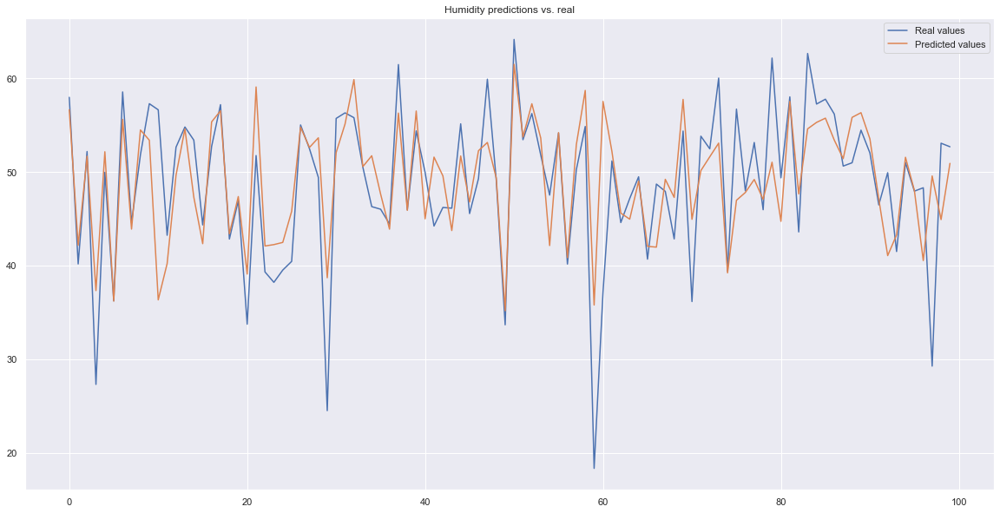

In [648]:
plt.figure(figsize=(20,10))
real, = plt.plot(ytest2_hum.reset_index(drop=True)[0:100].index.tolist(), ytest2_hum.values[0:100].tolist(), label='Real values')
predicted, = plt.plot(ytest2_hum.reset_index(drop=True)[0:100].index.tolist(), ypred_hum[0:100].tolist(), label='Predicted values') 
plt.legend(handles=[real, predicted])
plt.title('Humidity predictions vs. real')
plt.legend()

#### Predicting Temp on the option2 random forrest: it has the best scores 

In [705]:
m_temp = pickle.load(open('option2, temp_rf', 'rb'))
ypred_temp = m_temp.predict(Xtest2)

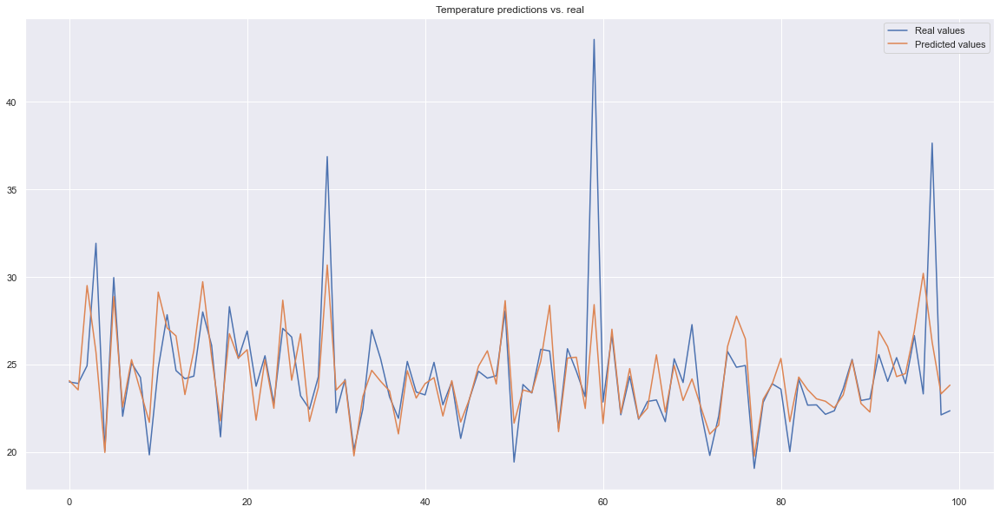

In [706]:
plt.figure(figsize=(20,10))
real, = plt.plot(ytest2_temp.reset_index(drop=True)[0:100].index.tolist(), ytest2_temp.values[0:100].tolist(), label='Real values')
predicted, = plt.plot(ytest2_temp.reset_index(drop=True)[0:100].index.tolist(), ypred_temp[0:100].tolist(), label='Predicted values') 
plt.legend(handles=[real, predicted])
plt.title('Temperature predictions vs. real')
plt.legend()

#### Predicting air on the option2 random forrest: it has the best scores 

In [608]:
m_air = pickle.load(open('option2, air_rf', 'rb'))
ypred_air = m_air.predict(Xtest2)

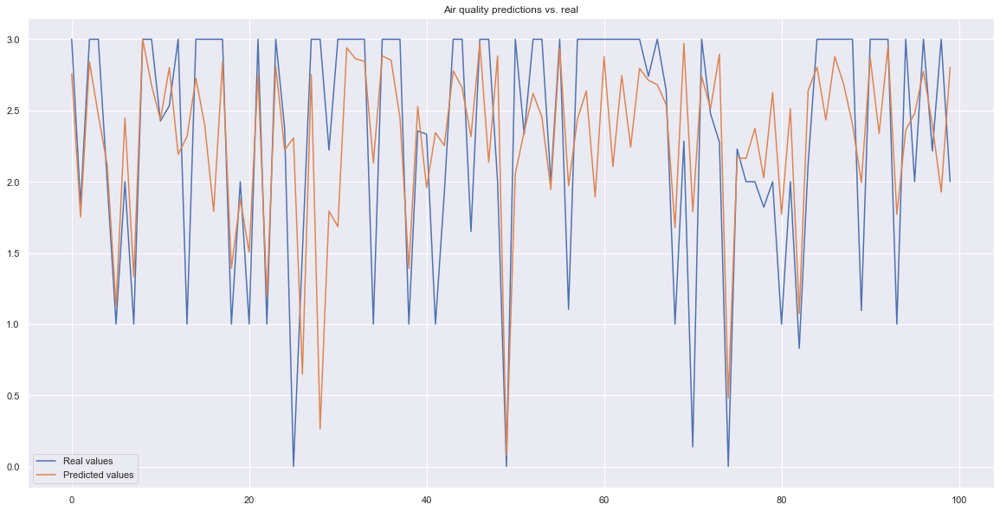

In [650]:
plt.figure(figsize=(20,10))
real, = plt.plot(ytest2_air.reset_index(drop=True)[0:100].index.tolist(), ytest2_air.values[0:100].tolist(), label='Real values')
predicted, = plt.plot(ytest2_air.reset_index(drop=True)[0:100].index.tolist(), ypred_air[0:100].tolist(), label='Predicted values') 
plt.legend(handles=[real, predicted])
plt.title('Air quality predictions vs. real')
plt.legend()

#### Predicting co2 on the option2 random forrest: it has the best scores 

In [614]:
m_co2 = pickle.load(open('option2, co2_rf', 'rb'))
ypred_co2 = m_co2.predict(Xtest2)

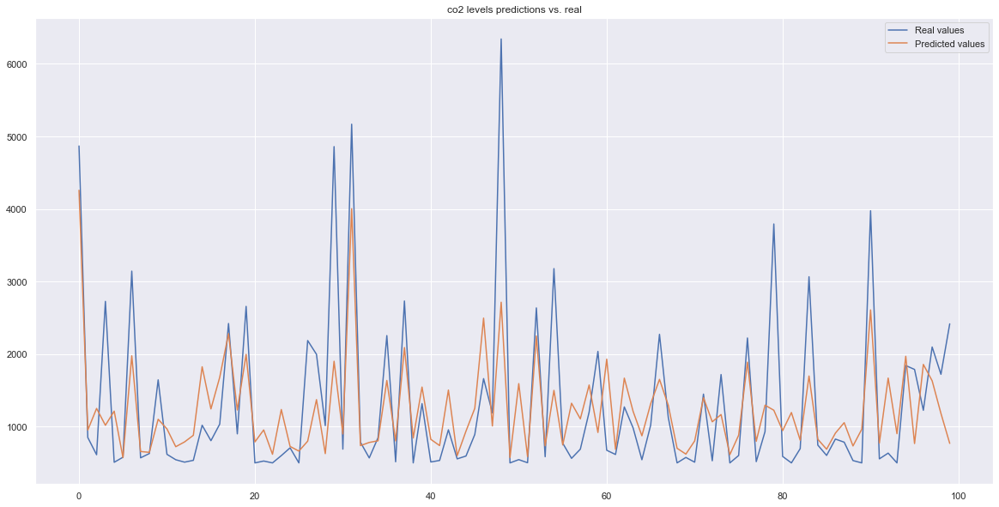

In [651]:
plt.figure(figsize=(20,10))
real, = plt.plot(ytest2_co2.reset_index(drop=True)[0:100].index.tolist(), ytest2_co2.values[0:100].tolist(), label='Real values')
predicted, = plt.plot(ytest2_co2.reset_index(drop=True)[0:100].index.tolist(), ypred_co2[0:100].tolist(), label='Predicted values') 
plt.legend(handles=[real, predicted])
plt.title('co2 levels predictions vs. real')
plt.legend()

#### Predicting light on the option2 random forrest: just for fun because results are useless

In [617]:
m_light = pickle.load(open('option2, light_rf', 'rb'))
ypred_light = m_light.predict(Xtest2)

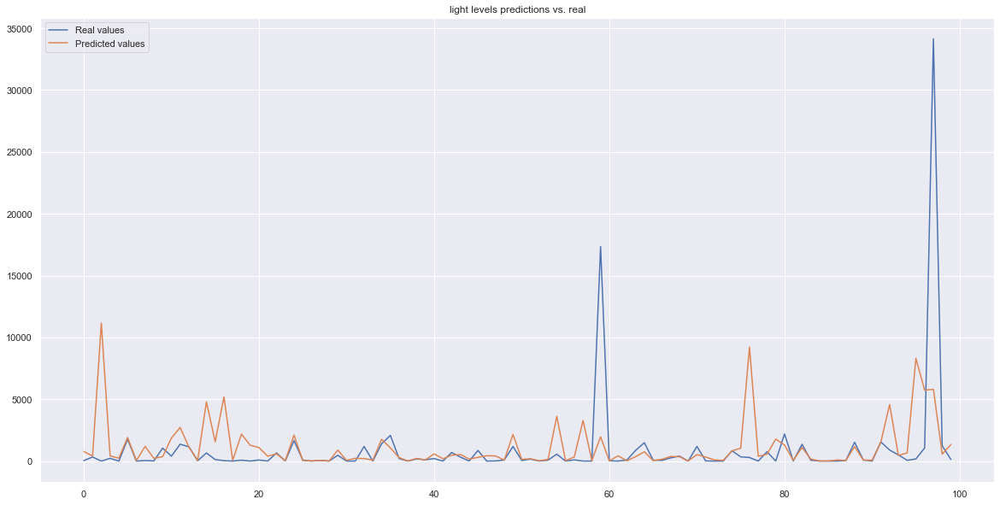

In [652]:
plt.figure(figsize=(20,10))
real, = plt.plot(ytest2_light.reset_index(drop=True)[0:100].index.tolist(), ytest2_light.values[0:100].tolist(), label='Real values')
predicted, = plt.plot(ytest2_light.reset_index(drop=True)[0:100].index.tolist(), ypred_light[0:100].tolist(), label='Predicted values') 
plt.legend(handles=[real, predicted])
plt.title('light levels predictions vs. real')
plt.legend()

## Live prediction

In [757]:
url = 'http://api.openweathermap.org/data/2.5/weather?q=Zurich&appid=bfb5dc512e1a6ed3c45f940161849c06&units=metric'

In [758]:
live = requests.get(url)

In [759]:
data_live = pd.DataFrame(index= [pd.to_datetime(json.loads(live.text)['dt'], unit='s')], columns = ['temp', 'feels_like', 'pressure_y', 'humidity_y', 'wind_speed', 'wind_deg', 'clouds_all'])

In [760]:
temp = json.loads(live.text)['main']['temp']
feels_like = json.loads(live.text)['main']['feels_like']
pressure = json.loads(live.text)['main']['pressure']
humidity = json.loads(live.text)['main']['humidity']
wind_speed = json.loads(live.text)['wind']['speed']
wind_deg = json.loads(live.text)['wind']['deg']
clouds_all = json.loads(live.text)['clouds']['all']
row = [temp, feels_like, pressure, humidity, wind_speed, wind_deg, clouds_all]

In [761]:
data_live.iloc[0] = row 

In [762]:
data_live 

,temp,feels_like,pressure_y,humidity_y,wind_speed,wind_deg,clouds_all
2020-11-02 14:44:31,20.66,19.12,1019,49,2.1,230,0


In [763]:
ypred_hum_live = m_hum.predict(data_live)
ypred_temp_live = m_temp.predict(data_live)
ypred_co2_live = m_co2.predict(data_live)

In [764]:
print('predicted humidity:', ypred_hum_live, '\n predicted temperature:', ypred_temp_live, '\n predicted co2 levels:',ypred_co2_live)

predicted humidity: [40.6258373] 
 predicted temperature: [25.88837927] 
 predicted co2 levels: [649.61984803]
